<a href="https://colab.research.google.com/github/achelousace/Bank-Loan-Approval/blob/main/Bank_Loan_Approval_Project.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Bank Loan Approval (Repayment Prediction) Project**
# **Project By: Mohammad R. Abu Ayyash**

## **About Data-set**

  ## Overview
  This dataset contains 45,000 records of loan applicants, with various attributes related to personal demographics, financial status, and loan details. The dataset can be used for predictive modeling, particularly in credit risk assessment and loan default prediction.

  ## Dataset Content
  The dataset includes 14 columns representing different factors influencing loan approvals and defaults:

  ## Personal Information:

  **person_age:** Age of the applicant (in years).

  **person_gender:** Gender of the applicant (male, female).

  **person_education:** Educational background (High School, Bachelor, Master, etc.).

  **person_income:** Annual income of the applicant (in USD).

  **person_emp_exp:** Years of employment experience.

  **person_home_ownership:** Type of home ownership (RENT, OWN, MORTGAGE).
  Loan Details

  **loan_amnt:** Loan amount requested (in USD).

  **loan_intent:** Purpose of the loan (PERSONAL, EDUCATION, MEDICAL, etc.).

  **loan_int_rate:** Interest rate on the loan (percentage).

  **loan_percent_income:** Ratio of loan amount to income.

  ## Credit & Loan History:

  **cb_person_cred_hist_length:** Length of the applicant's credit history (in years).

  **credit_score:** Credit score of the applicant.

  **previous_loan_defaults_on_file:** Whether the applicant has previous loan
  defaults (Yes or No).

  ## Target Variable:

  **loan_status:** 1 if the loan was repaid successfully, 0 if the applicant defaulted.

# Imports

In [ ]:
import kagglehub

# Download latest version
path = kagglehub.dataset_download("udaymalviya/bank-loan-data")

print("Path to dataset files:", path)

Path to dataset files: /kaggle/input/bank-loan-data


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os
import math

## Custom Imports

In [ ]:
def explore_categorical(df, x, fillna = True, placeholder = 'MISSING', figsize = (6,4), order = None):
  temp_df = df.copy()
  null_count = temp_df[x].isna().sum()
  null_perc = null_count/len(temp_df)* 100
  if fillna == True:
    temp_df[x] = temp_df[x].fillna(placeholder)
  fig, ax = plt.subplots(figsize=figsize)
  sns.countplot(data=temp_df, x=x, ax=ax, order=order)
  ax.set_xticks(ax.get_xticks())
  ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right')
  ax.set_title(f"Column: {x}")
  fig.tight_layout()
  plt.show()
  print(f"- NaN's Found: {null_count} ({round(null_perc,2)}%)")
  nunique = temp_df[x].nunique()
  print(f"- Unique Values: {nunique}")
  val_counts = temp_df[x].value_counts(dropna=False)
  most_common_val = val_counts.index[0]
  freq = val_counts.values[0]
  perc_most_common = freq / len(temp_df) * 100
  print(f"- Most common value: '{most_common_val}' occurs {freq} times ({round(perc_most_common,2)}%)")
  if perc_most_common > 98:
    print(f"\n- [!] Warning: '{x}' is a constant or quasi-constant feature and should be dropped.")
  else:
    print("- Not constant or quasi-constant.")
  return fig, ax

def plot_categorical_vs_target(df, x, y='SalePrice',figsize=(6,4),fillna = True, placeholder = 'MISSING',order = None,target_type='reg',status='percent',hue=None):
  temp_df = df.copy()
  if fillna == True:
    temp_df[x] = temp_df[x].fillna(placeholder)
  else:
    temp_df = temp_df.dropna(subset=[x])
  fig, ax = plt.subplots(figsize=figsize)
  if target_type=='reg':
    sns.barplot(data=temp_df, x=x, y=y, ax=ax, order=order, alpha=0.6,linewidth=1, edgecolor='black', errorbar=None)
    sns.stripplot(data=temp_df, x=x, y=y, hue=hue if hue != None else x, ax=ax, order=order, hue_order=order, legend=False,edgecolor='white', linewidth=0.5,size=3,zorder=0)
  elif target_type=='class':
      ax = sns.histplot(data=temp_df, hue=y, x=x, stat=status,  multiple='fill')
  ax.set_xticks(ax.get_xticks())
  ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right')
  ax.set_title(f"{x} vs. {y}")
  fig.tight_layout()
  return fig, ax

def explore_numeric(df, x, figsize=(6,5) ):
  gridspec = {'height_ratios':[0.7,0.3]}
  fig, axes = plt.subplots(nrows=2, figsize=figsize,sharex=True, gridspec_kw=gridspec)
  sns.histplot(data=df, x=x, ax=axes[0])
  sns.boxplot(data=df, x=x, ax=axes[1])
  axes[0].set_title(f"Column: {x}")
  fig.tight_layout()
  plt.show()
  null_count = df[x].isna().sum()
  null_perc = null_count/len(df)* 100
  print(f"- NaN's Found: {null_count} ({round(null_perc,2)}%)")

def plot_numeric_vs_target(df, x, y, figsize=(6,4),target_type='reg', estimator='mean',errorbar='ci',sorted=False,ascending=False,**kwargs):
  nulls = df[[x,y]].isna().sum()
  if nulls.sum()>0:
    print(f"- Excluding {nulls.sum()} NaN's")
    temp_df = df.dropna(subset=[x,y,])
  else:
    temp_df = df
  fig, ax = plt.subplots(figsize=figsize)
  if 'reg' in target_type:
    corr = df[[x,y]].corr().round(2)
    r = corr.loc[x,y]
    scatter_kws={'ec':'white','linewidths':1,'alpha':0.8}
    sns.regplot(data=temp_df, x=x, y=y, ax=ax, scatter_kws=scatter_kws, **kwargs)
    ax.set_title(f"{x} vs. {y} (r = {r})")
  elif 'class' in target_type:
    if sorted == True:
      if estimator == 'median':
        group_vals = temp_df.groupby(y)[x].median()
      elif estimator =='mean':
        group_vals = temp_df.groupby(y)[x].mean()
      group_vals = group_vals.sort_values(ascending=ascending)
      order = group_vals.index
    else:
      order = None
    sns.barplot(data=temp_df, x=y, y=x, order=order,  estimator=estimator,errorbar=errorbar, ax=ax, **kwargs)
    ax.set_title(f"{x} vs. {y}")
    ax.set_xticks(ax.get_xticks())
    ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right')
  fig.tight_layout()
  fig.show()
  return fig, ax

# Load Data

In [ ]:
os.listdir(path)

['loan_data.csv']

In [ ]:
df = pd.read_csv(path + "/loan_data.csv")

# Data Cleaning

In [ ]:
df.head()

,person_age,person_gender,person_education,person_income,person_emp_exp,person_home_ownership,loan_amnt,loan_intent,loan_int_rate,loan_percent_income,cb_person_cred_hist_length,credit_score,previous_loan_defaults_on_file,loan_status
0,22.0,female,Master,71948.0,0,RENT,35000.0,PERSONAL,16.02,0.49,3.0,561,No,1
1,21.0,female,High School,12282.0,0,OWN,1000.0,EDUCATION,11.14,0.08,2.0,504,Yes,0
2,25.0,female,High School,12438.0,3,MORTGAGE,5500.0,MEDICAL,12.87,0.44,3.0,635,No,1
3,23.0,female,Bachelor,79753.0,0,RENT,35000.0,MEDICAL,15.23,0.44,2.0,675,No,1
4,24.0,male,Master,66135.0,1,RENT,35000.0,MEDICAL,14.27,0.53,4.0,586,No,1


In [ ]:
df = df.rename(columns={
    'person_age': 'age',
    'person_gender': 'gender',
    'person_education': 'education_level',
    'person_income': 'yearly_income',
    'person_emp_exp': 'years_of_employment',
    'person_home_ownership': 'home_ownership_stauts',
    'loan_amnt': 'loan_amount',
    'loan_intent': 'loan_purpose',
    'loan_int_rate': 'loan_interest_rate',
    'loan_percent_income': 'loan_percentage_income',
    'cb_person_cred_hist_length': 'credit_history',
    'previous_loan_defaults_on_file': 'previous_loan'
})


In [ ]:
df.head()

,age,gender,education_level,yearly_income,years_of_employment,home_ownership_stauts,loan_amount,loan_purpose,loan_interest_rate,loan_percentage_income,credit_history,credit_score,previous_loan,loan_status
0,22.0,female,Master,71948.0,0,RENT,35000.0,PERSONAL,16.02,0.49,3.0,561,No,1
1,21.0,female,High School,12282.0,0,OWN,1000.0,EDUCATION,11.14,0.08,2.0,504,Yes,0
2,25.0,female,High School,12438.0,3,MORTGAGE,5500.0,MEDICAL,12.87,0.44,3.0,635,No,1
3,23.0,female,Bachelor,79753.0,0,RENT,35000.0,MEDICAL,15.23,0.44,2.0,675,No,1
4,24.0,male,Master,66135.0,1,RENT,35000.0,MEDICAL,14.27,0.53,4.0,586,No,1


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 45000 entries, 0 to 44999
Data columns (total 14 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   age                     45000 non-null  float64
 1   gender                  45000 non-null  object 
 2   education_level         45000 non-null  object 
 3   yearly_income           45000 non-null  float64
 4   years_of_employment     45000 non-null  int64  
 5   home_ownership_stauts   45000 non-null  object 
 6   loan_amount             45000 non-null  float64
 7   loan_purpose            45000 non-null  object 
 8   loan_interest_rate      45000 non-null  float64
 9   loan_percentage_income  45000 non-null  float64
 10  credit_history          45000 non-null  float64
 11  credit_score            45000 non-null  int64  
 12  previous_loan           45000 non-null  object 
 13  loan_status             45000 non-null  int64  
dtypes: float64(6), int64(3), object(5)
mem

In [ ]:
df.describe()

,age,yearly_income,years_of_employment,loan_amount,loan_interest_rate,loan_percentage_income,credit_history,credit_score,loan_status
count,45000.000000,4.500000e+04,45000.000000,45000.000000,45000.000000,45000.000000,45000.000000,45000.000000,45000.000000
mean,27.764178,8.031905e+04,5.410333,9583.157556,11.006606,0.139725,5.867489,632.608756,0.222222
std,6.045108,8.042250e+04,6.063532,6314.886691,2.978808,0.087212,3.879702,50.435865,0.415744
min,20.000000,8.000000e+03,0.000000,500.000000,5.420000,0.000000,2.000000,390.000000,0.000000
25%,24.000000,4.720400e+04,1.000000,5000.000000,8.590000,0.070000,3.000000,601.000000,0.000000
50%,26.000000,6.704800e+04,4.000000,8000.000000,11.010000,0.120000,4.000000,640.000000,0.000000
75%,30.000000,9.578925e+04,8.000000,12237.250000,12.990000,0.190000,8.000000,670.000000,0.000000
max,144.000000,7.200766e+06,125.000000,35000.000000,20.000000,0.660000,30.000000,850.000000,1.000000


In [ ]:
df[df['age']>100]

,age,gender,education_level,yearly_income,years_of_employment,home_ownership_stauts,loan_amount,loan_purpose,loan_interest_rate,loan_percentage_income,credit_history,credit_score,previous_loan,loan_status
81,144.0,male,Bachelor,300616.0,125,RENT,4800.0,VENTURE,13.57,0.02,3.0,789,No,0
183,144.0,male,Associate,241424.0,121,MORTGAGE,6000.0,EDUCATION,11.86,0.02,2.0,807,No,0
575,123.0,female,High School,97140.0,101,RENT,20400.0,EDUCATION,10.25,0.21,3.0,805,Yes,0
747,123.0,male,Bachelor,94723.0,100,RENT,20000.0,VENTURE,11.01,0.21,4.0,714,Yes,0
32297,144.0,female,Associate,7200766.0,124,MORTGAGE,5000.0,PERSONAL,12.73,0.00,25.0,850,No,0
37930,116.0,male,Bachelor,5545545.0,93,MORTGAGE,3823.0,VENTURE,12.15,0.00,24.0,708,No,0
38113,109.0,male,High School,5556399.0,85,MORTGAGE,6195.0,VENTURE,12.58,0.00,22.0,792,No,0


In [ ]:
df['age'].min()

20.0

In [ ]:
df = df[df['age'] <= 100]
df['age'].max()

94.0

In [ ]:
df['loan_amount'].describe()

,loan_amount
count,44993.000000
mean,9583.176761
std,6314.802655
min,500.000000
25%,5000.000000
50%,8000.000000
75%,12237.000000
max,35000.000000


In [ ]:
for col in ['age', 'yearly_income', 'loan_amount','credit_history']:
    df[col] = df[col].astype(int)

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 44993 entries, 0 to 44999
Data columns (total 14 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   age                     44993 non-null  int64  
 1   gender                  44993 non-null  object 
 2   education_level         44993 non-null  object 
 3   yearly_income           44993 non-null  int64  
 4   years_of_employment     44993 non-null  int64  
 5   home_ownership_stauts   44993 non-null  object 
 6   loan_amount             44993 non-null  int64  
 7   loan_purpose            44993 non-null  object 
 8   loan_interest_rate      44993 non-null  float64
 9   loan_percentage_income  44993 non-null  float64
 10  credit_history          44993 non-null  int64  
 11  credit_score            44993 non-null  int64  
 12  previous_loan           44993 non-null  object 
 13  loan_status             44993 non-null  int64  
dtypes: float64(2), int64(7), object(5)
memory u

In [ ]:
df.describe()

,age,yearly_income,years_of_employment,loan_amount,loan_interest_rate,loan_percentage_income,credit_history,credit_score,loan_status
count,44993.000000,4.499300e+04,44993.000000,44993.000000,44993.000000,44993.000000,44993.000000,44993.000000,44993.000000
mean,27.748428,7.990845e+04,5.394528,9583.176761,11.006448,0.139736,5.866557,632.585713,0.222257
std,5.909737,6.332213e+04,5.927159,6314.802655,2.978985,0.087207,3.877167,50.402411,0.415767
min,20.000000,8.000000e+03,0.000000,500.000000,5.420000,0.000000,2.000000,390.000000,0.000000
25%,24.000000,4.719500e+04,1.000000,5000.000000,8.590000,0.070000,3.000000,601.000000,0.000000
50%,26.000000,6.704600e+04,4.000000,8000.000000,11.010000,0.120000,4.000000,640.000000,0.000000
75%,30.000000,9.577800e+04,8.000000,12237.000000,12.990000,0.190000,8.000000,670.000000,0.000000
max,94.000000,2.448661e+06,76.000000,35000.000000,20.000000,0.660000,30.000000,784.000000,1.000000


In [ ]:
df['yearly_income'].max()

2448661

In [ ]:
df['loan_percentage_income'] = df['loan_percentage_income'].apply(lambda x: x*100)

In [ ]:
df['loan_percentage_income'].describe()

,loan_percentage_income
count,44993.000000
mean,13.973640
std,8.720672
min,0.000000
25%,7.000000
50%,12.000000
75%,19.000000
max,66.000000


In [ ]:
df['loan_percentage_income'] = df['loan_percentage_income'].astype(int)

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 44993 entries, 0 to 44999
Data columns (total 14 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   age                     44993 non-null  int64  
 1   gender                  44993 non-null  object 
 2   education_level         44993 non-null  object 
 3   yearly_income           44993 non-null  int64  
 4   years_of_employment     44993 non-null  int64  
 5   home_ownership_stauts   44993 non-null  object 
 6   loan_amount             44993 non-null  int64  
 7   loan_purpose            44993 non-null  object 
 8   loan_interest_rate      44993 non-null  float64
 9   loan_percentage_income  44993 non-null  int64  
 10  credit_history          44993 non-null  int64  
 11  credit_score            44993 non-null  int64  
 12  previous_loan           44993 non-null  object 
 13  loan_status             44993 non-null  int64  
dtypes: float64(1), int64(8), object(5)
memory u

In [ ]:
df.duplicated().sum()

np.int64(0)

In [ ]:
for col in df.select_dtypes(include='object').columns:
    print('='*50)
    print(f'Column Name: {col}')
    print(f'Unique Values: {df[col].unique()}')
    print(f'Number of Unique Values: {df[col].nunique()}')
    print(f'Value Counts: {df[col].value_counts()}')
    print(f'Missing Values: {df[col].isnull().sum()}')
    print('\n')
    print(f'Describe: {df[col].describe()}')
    print('\n')
    print('='*50)
    print('\n')

Column Name: gender
Unique Values: ['female' 'male']
Number of Unique Values: 2
Value Counts: gender
male      24836
female    20157
Name: count, dtype: int64
Missing Values: 0


Describe: count     44993
unique        2
top        male
freq      24836
Name: gender, dtype: object




Column Name: education_level
Unique Values: ['Master' 'High School' 'Bachelor' 'Associate' 'Doctorate']
Number of Unique Values: 5
Value Counts: education_level
Bachelor       13396
Associate      12026
High School    11970
Master          6980
Doctorate        621
Name: count, dtype: int64
Missing Values: 0


Describe: count        44993
unique           5
top       Bachelor
freq         13396
Name: education_level, dtype: object




Column Name: home_ownership_stauts
Unique Values: ['RENT' 'OWN' 'MORTGAGE' 'OTHER']
Number of Unique Values: 4
Value Counts: home_ownership_stauts
RENT        23440
MORTGAGE    18485
OWN          2951
OTHER         117
Name: count, dtype: int64
Missing Values: 0


Describe: c

In [ ]:
df['loan_purpose'].value_counts()

,count
loan_purpose,
EDUCATION,9151
MEDICAL,8548
VENTURE,7815
PERSONAL,7551
DEBTCONSOLIDATION,7145
HOMEIMPROVEMENT,4783


In [ ]:
df['loan_purpose'].replace({'DEBTCONSOLIDATION':'DEBT CONSOLIDATION','HOMEIMPROVEMENT':'HOME IMPROVEMENT'}, inplace=True)

<ipython-input-252-c34ab5c9be00>:1: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df['loan_purpose'].replace({'DEBTCONSOLIDATION':'DEBT CONSOLIDATION','HOMEIMPROVEMENT':'HOME IMPROVEMENT'}, inplace=True)


In [ ]:
df['loan_purpose'] = df['loan_purpose'].apply(lambda x: x.lower().title())

In [ ]:
df['loan_purpose'].value_counts()

,count
loan_purpose,
Education,9151
Medical,8548
Venture,7815
Personal,7551
Debt Consolidation,7145
Home Improvement,4783


In [ ]:
df['home_ownership_stauts'].value_counts()

,count
home_ownership_stauts,
RENT,23440
MORTGAGE,18485
OWN,2951
OTHER,117


In [ ]:
df['home_ownership_stauts'] = df['home_ownership_stauts'].apply(lambda x: x.lower().capitalize())

In [ ]:
df['home_ownership_stauts'].value_counts()

,count
home_ownership_stauts,
Rent,23440
Mortgage,18485
Own,2951
Other,117


In [ ]:
df['gender'] = df['gender'].apply(lambda x: x.capitalize())

In [ ]:
df['gender'].value_counts()

,count
gender,
Male,24836
Female,20157


In [ ]:
df.columns = df.columns.str.title()

In [ ]:
df.head()

,Age,Gender,Education_Level,Yearly_Income,Years_Of_Employment,Home_Ownership_Stauts,Loan_Amount,Loan_Purpose,Loan_Interest_Rate,Loan_Percentage_Income,Credit_History,Credit_Score,Previous_Loan,Loan_Status
0,22,Female,Master,71948,0,Rent,35000,Personal,16.02,49,3,561,No,1
1,21,Female,High School,12282,0,Own,1000,Education,11.14,8,2,504,Yes,0
2,25,Female,High School,12438,3,Mortgage,5500,Medical,12.87,44,3,635,No,1
3,23,Female,Bachelor,79753,0,Rent,35000,Medical,15.23,44,2,675,No,1
4,24,Male,Master,66135,1,Rent,35000,Medical,14.27,53,4,586,No,1


# EDA

## General Distributions

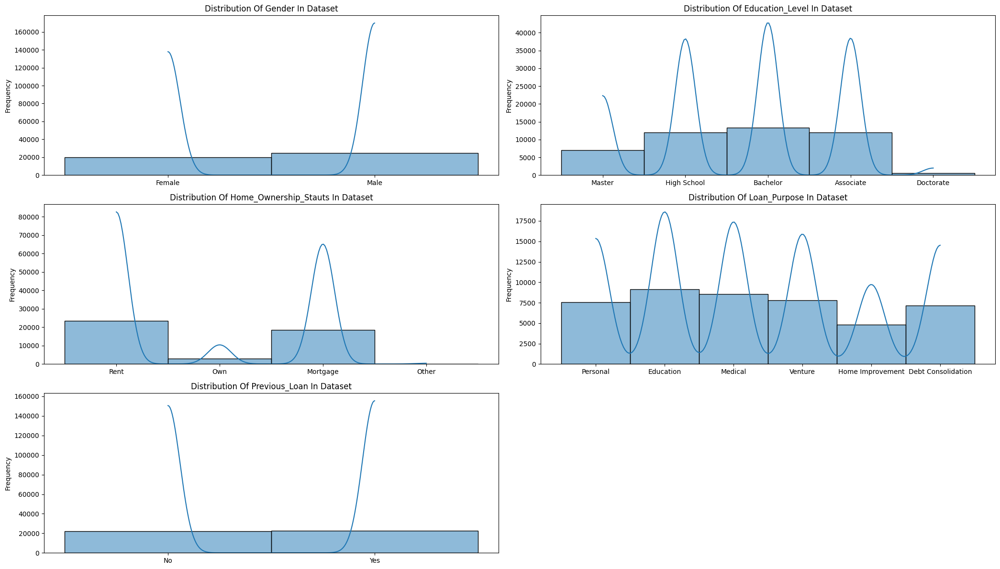

In [ ]:
num_plots = len(df.select_dtypes(include='object').columns)
num_cols = 2
num_rows = math.ceil(num_plots / num_cols)

fig, axes = plt.subplots(num_rows, num_cols, figsize=(21, 4 * num_rows))
axes = axes.flatten()

for i, col in enumerate(df.select_dtypes(include='object').columns):
  sns.histplot(df[col], kde=True, ax=axes[i])
  axes[i].set_title(f'Distribution Of {col} In Dataset')
  axes[i].set_xlabel('')
  axes[i].set_ylabel('Frequency')

for j in range(i + 1, len(axes)):
    axes[j].axis('off')

plt.tight_layout()
plt.show()

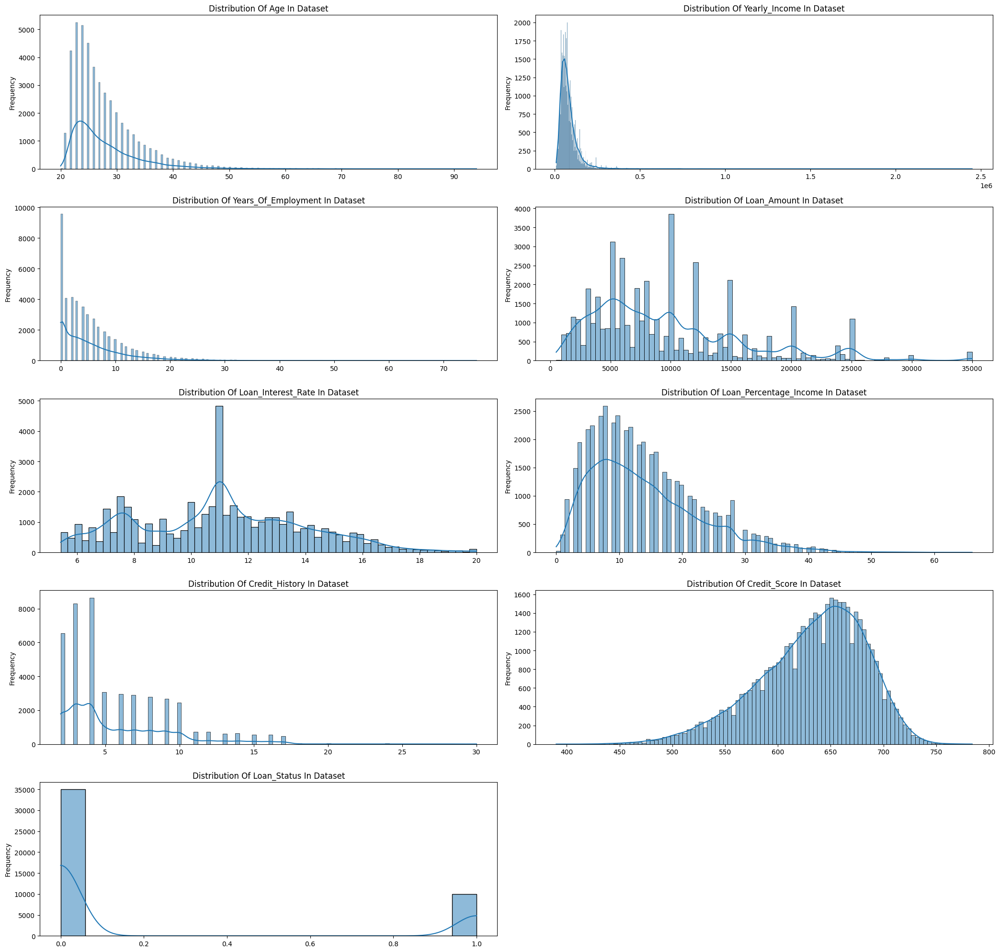

In [ ]:
num_plots = len(df.select_dtypes(include='number').columns)
num_cols = 2
num_rows = math.ceil(num_plots / num_cols)

fig, axes = plt.subplots(num_rows, num_cols, figsize=(21, 4 * num_rows))
axes = axes.flatten()

for i, col in enumerate(df.select_dtypes(include='number').columns):
  sns.histplot(df[col], kde=True, ax=axes[i])
  axes[i].set_title(f'Distribution Of {col} In Dataset')
  axes[i].set_xlabel('')
  axes[i].set_ylabel('Frequency')

for j in range(i + 1, len(axes)):
    axes[j].axis('off')

plt.tight_layout()
plt.show()

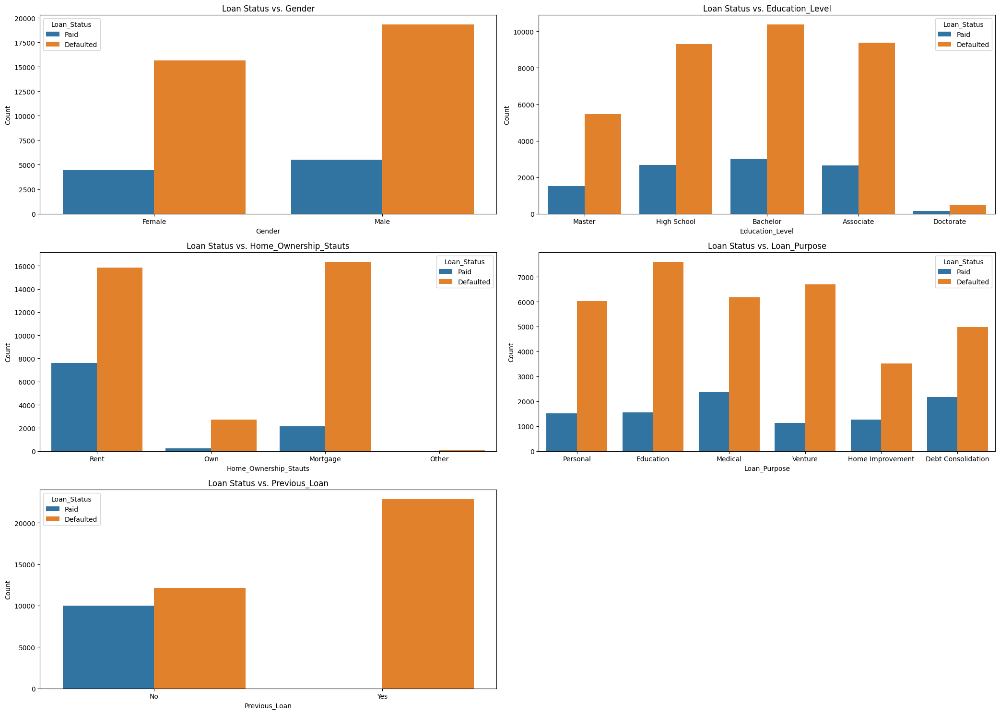

In [ ]:
loan_names = df['Loan_Status'].map({1: 'Paid', 0: 'Defaulted'})

num_plots = len(df.select_dtypes(include='object').columns)
num_cols = 2
num_rows = (num_plots + num_cols - 1) // num_cols
fig, axes = plt.subplots(num_rows, num_cols, figsize=(21, 5 * num_rows))
axes = axes.flatten()

for i, col in enumerate(df.select_dtypes(include='object').columns):
    sns.countplot(x=col, hue=loan_names, data=df, ax=axes[i])
    axes[i].set_title(f'Loan Status vs. {col}')
    axes[i].set_xlabel(col)
    axes[i].set_ylabel('Count')

for j in range(i + 1, len(axes)):
    axes[j].axis('off')

plt.tight_layout()
plt.show()

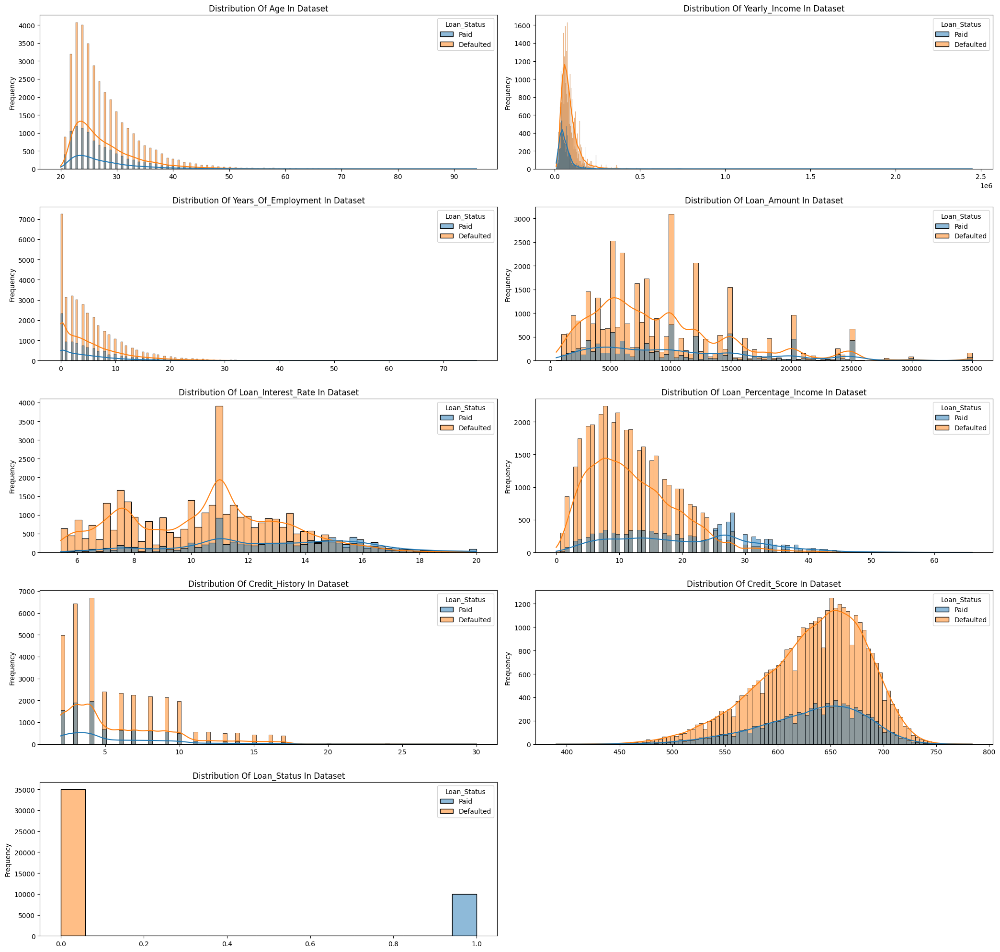

In [ ]:
loan_names = df['Loan_Status'].map({1: 'Paid', 0: 'Defaulted'})

num_plots = len(df.select_dtypes(include='number').columns)
num_cols = 2
num_rows = math.ceil(num_plots / num_cols)
fig, axes = plt.subplots(num_rows, num_cols, figsize=(21, 4 * num_rows))
axes = axes.flatten()

for i, col in enumerate(df.select_dtypes(include='number').columns):
  sns.histplot(x=col, hue=loan_names, data=df, kde=True, ax=axes[i])
  axes[i].set_title(f'Distribution Of {col} In Dataset')
  axes[i].set_xlabel('')
  axes[i].set_ylabel('Frequency')

for j in range(i + 1, len(axes)):
    axes[j].axis('off')

plt.tight_layout()
plt.show()

In [ ]:
df['Loan_Status'].value_counts(normalize=True)

,proportion
Loan_Status,
0,0.777743
1,0.222257


## Features Analysis

In [ ]:
df.select_dtypes(include='object').columns

Index(['Gender', 'Education_Level', 'Home_Ownership_Stauts', 'Loan_Purpose',
       'Previous_Loan'],
      dtype='object')

In [ ]:
df.select_dtypes(include='number').columns

Index(['Age', 'Yearly_Income', 'Years_Of_Employment', 'Loan_Amount',
       'Loan_Interest_Rate', 'Loan_Percentage_Income', 'Credit_History',
       'Credit_Score', 'Loan_Status'],
      dtype='object')

In [ ]:
df.head()

,Age,Gender,Education_Level,Yearly_Income,Years_Of_Employment,Home_Ownership_Stauts,Loan_Amount,Loan_Purpose,Loan_Interest_Rate,Loan_Percentage_Income,Credit_History,Credit_Score,Previous_Loan,Loan_Status
0,22,Female,Master,71948,0,Rent,35000,Personal,16.02,49,3,561,No,1
1,21,Female,High School,12282,0,Own,1000,Education,11.14,8,2,504,Yes,0
2,25,Female,High School,12438,3,Mortgage,5500,Medical,12.87,44,3,635,No,1
3,23,Female,Bachelor,79753,0,Rent,35000,Medical,15.23,44,2,675,No,1
4,24,Male,Master,66135,1,Rent,35000,Medical,14.27,53,4,586,No,1


In [ ]:
df['_LoanStatus'] = df['Loan_Status'].map({1: 'Paid', 0: 'Defaulted'})

### Age

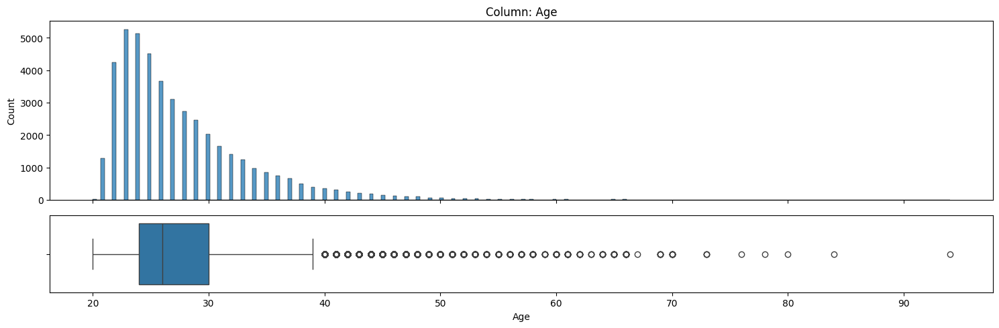

- NaN's Found: 0 (0.0%)


In [ ]:
explore_numeric(df,'Age',figsize=(15,5))

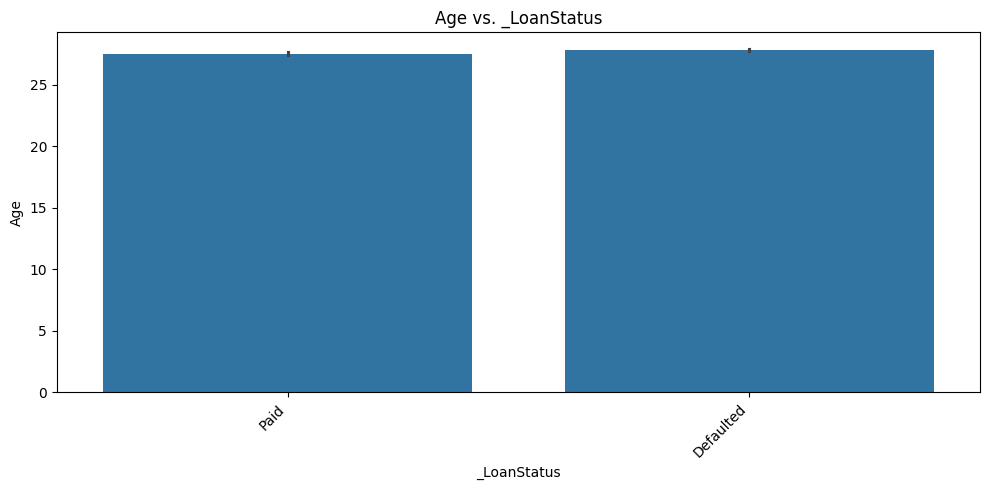

In [ ]:
plot_numeric_vs_target(df,'Age','_LoanStatus' ,figsize=(10,5), target_type='class', estimator='mean',errorbar='ci',sorted=False,ascending=False);

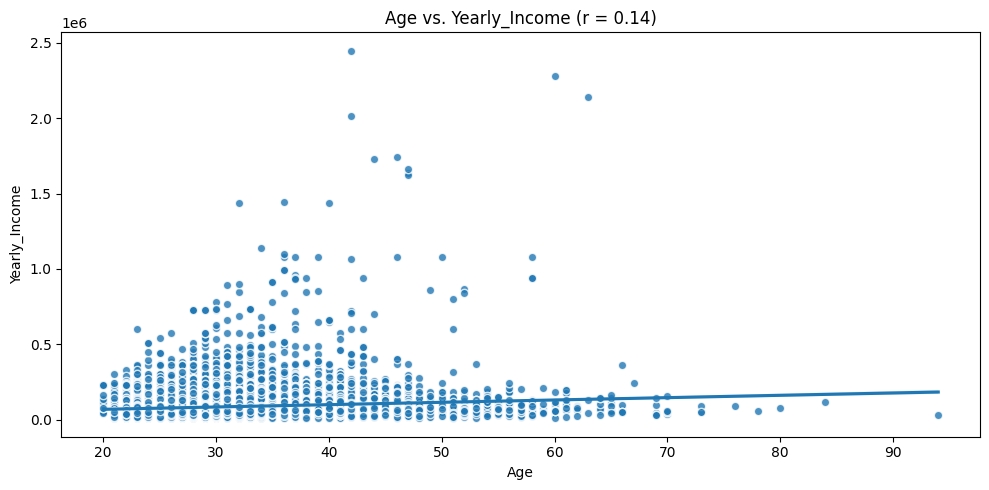

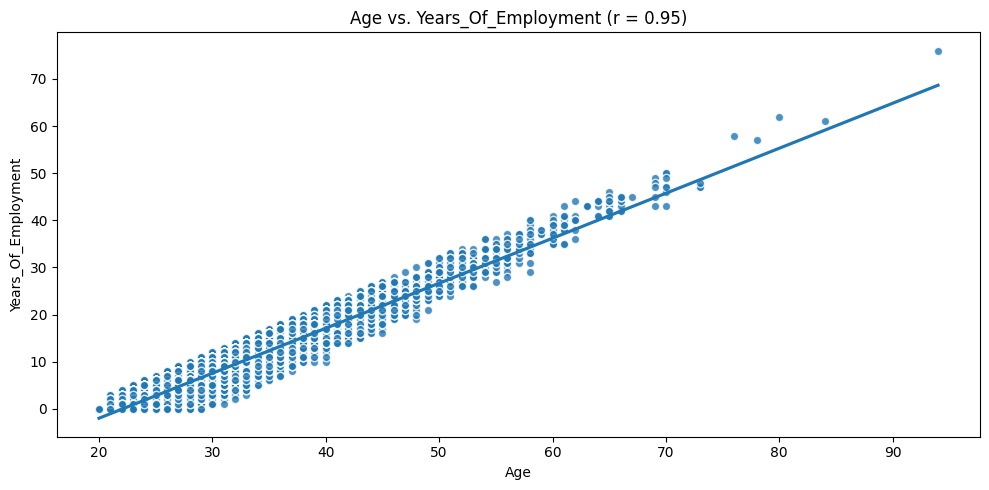

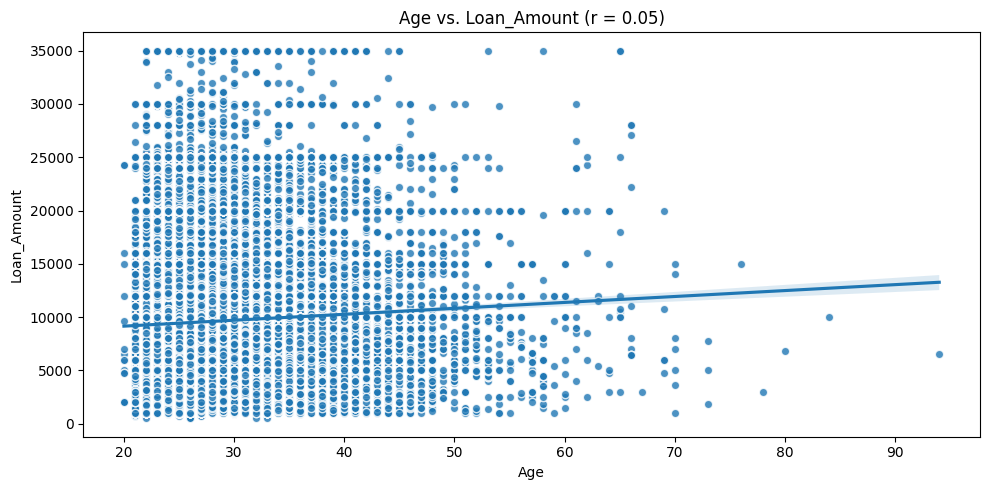

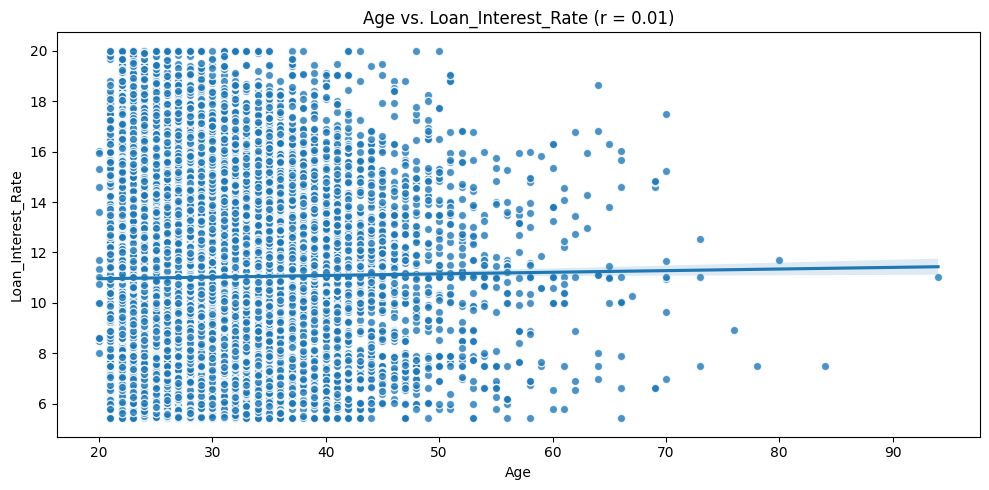

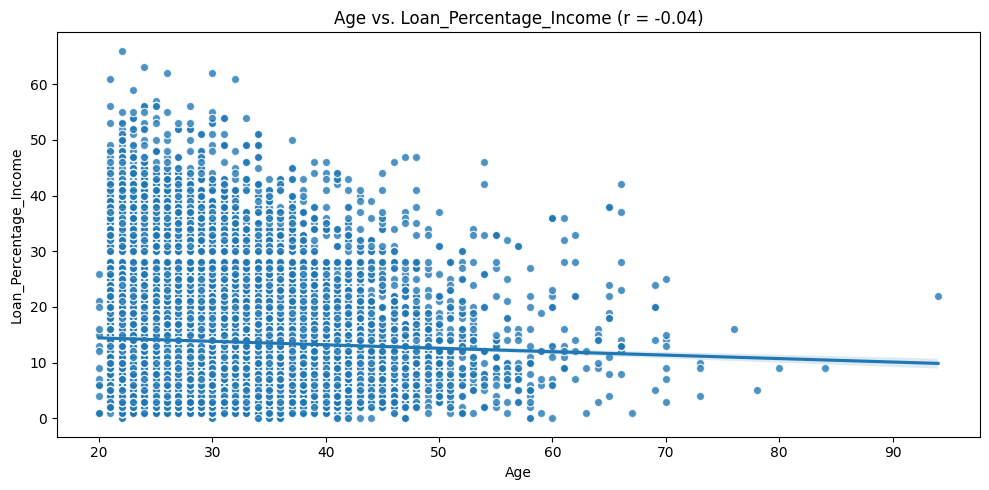

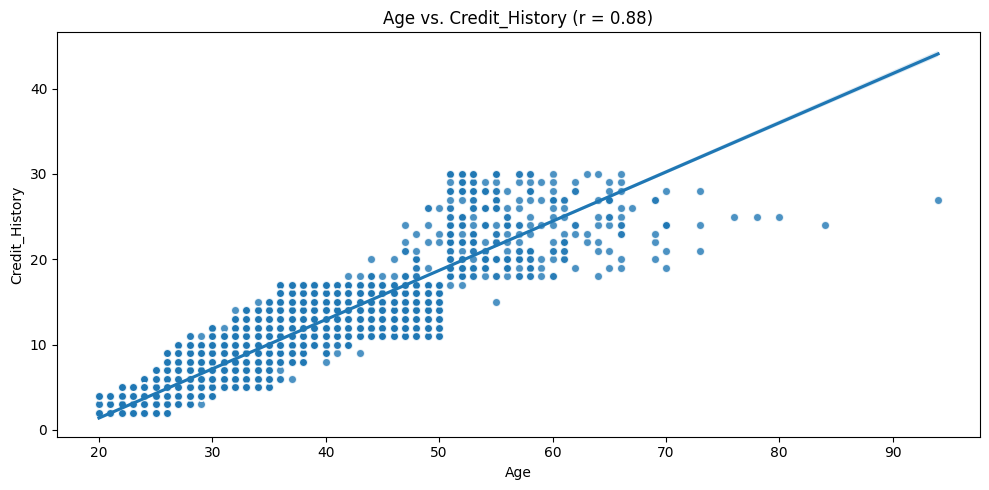

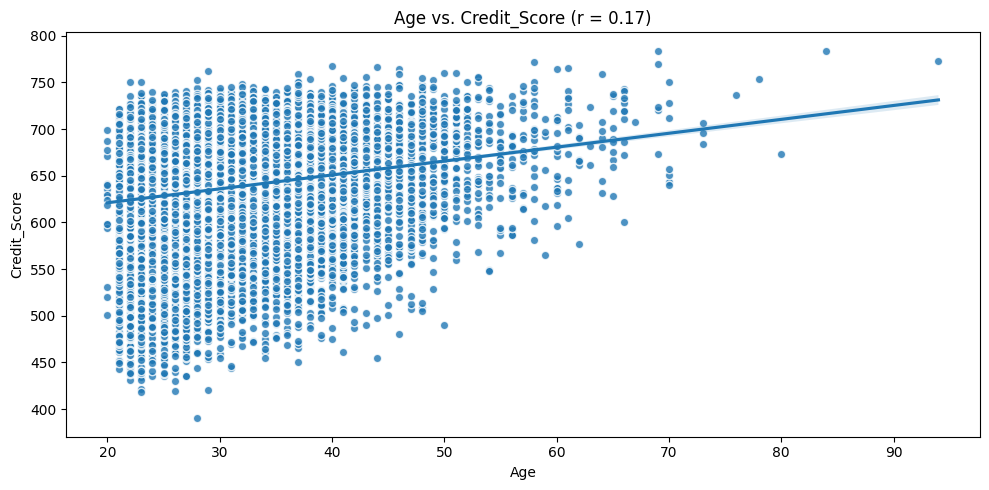

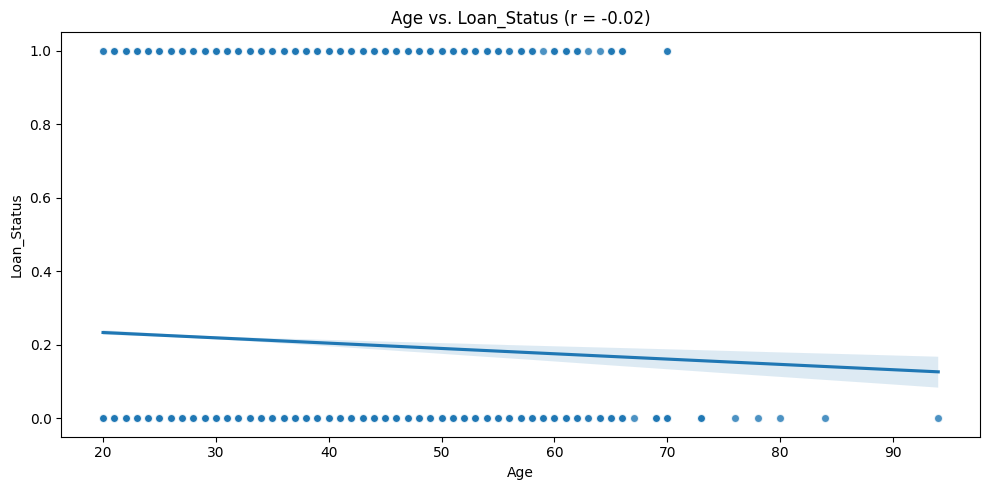

In [ ]:
for col in df.select_dtypes(include='number').columns.drop('Age'):
  plot_numeric_vs_target(df,'Age',col ,figsize=(10,5), target_type='reg');

### Gender

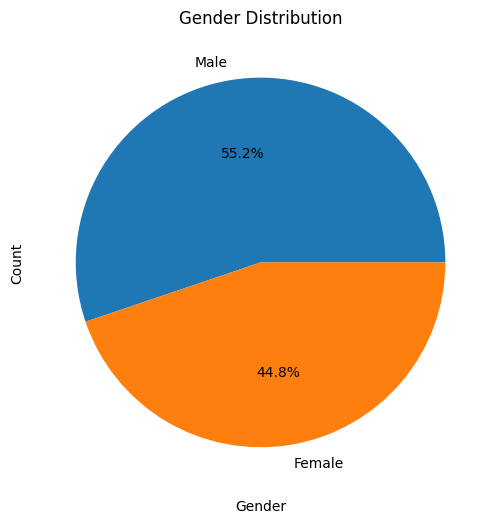

In [ ]:
gender_counts = df['Gender'].value_counts()
gender_percentages = df['Gender'].value_counts(normalize=True) * 100

fig, ax = plt.subplots(figsize=(8, 6))
wedges, texts, autotexts = ax.pie(gender_counts.values, labels=gender_counts.index, autopct='%1.1f%%')

# Add percentage and count labels inside the bars
for i, wedge in enumerate(wedges):
    x, y = wedge.center
    percentage = gender_percentages.iloc[i]
    count = gender_counts.iloc[i]

ax.set_xlabel("Gender")
ax.set_ylabel("Count")
ax.set_title("Gender Distribution")

plt.show()

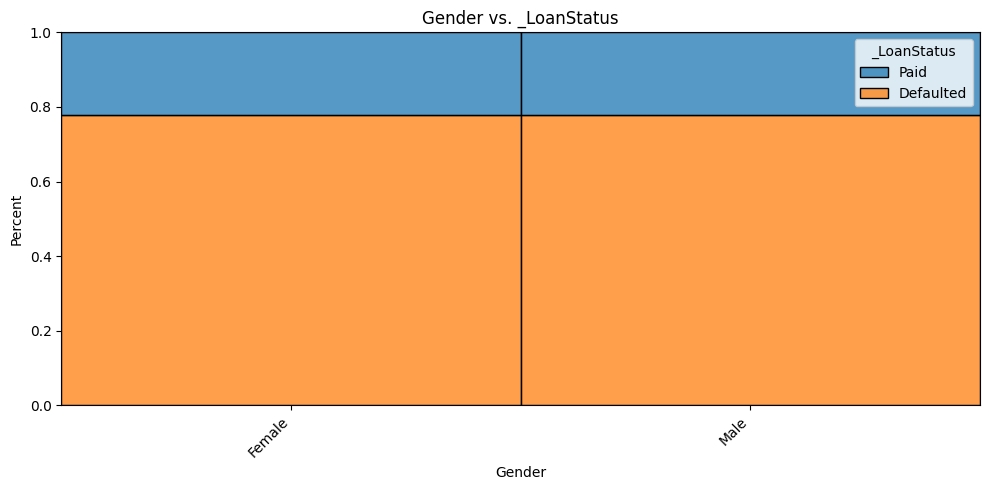

In [ ]:
plot_categorical_vs_target(df,'Gender','_LoanStatus' ,figsize=(10,5), target_type='class');

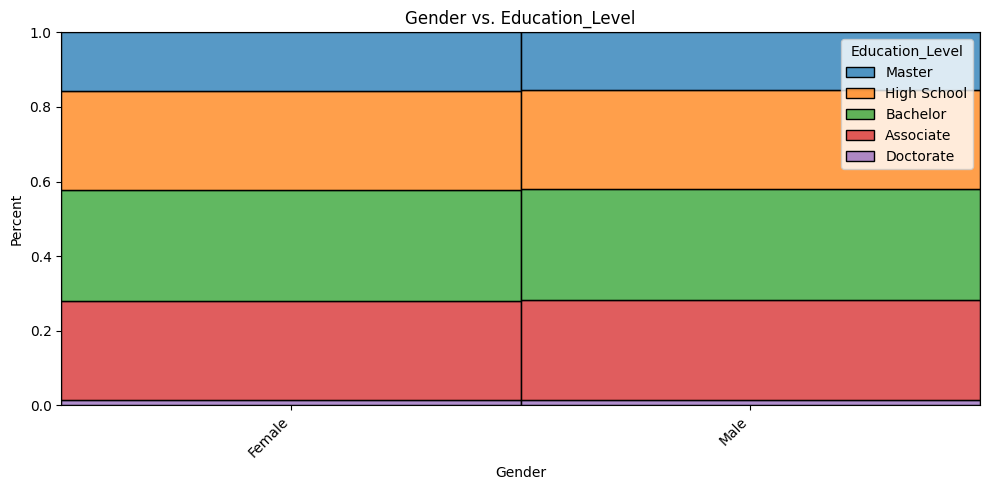

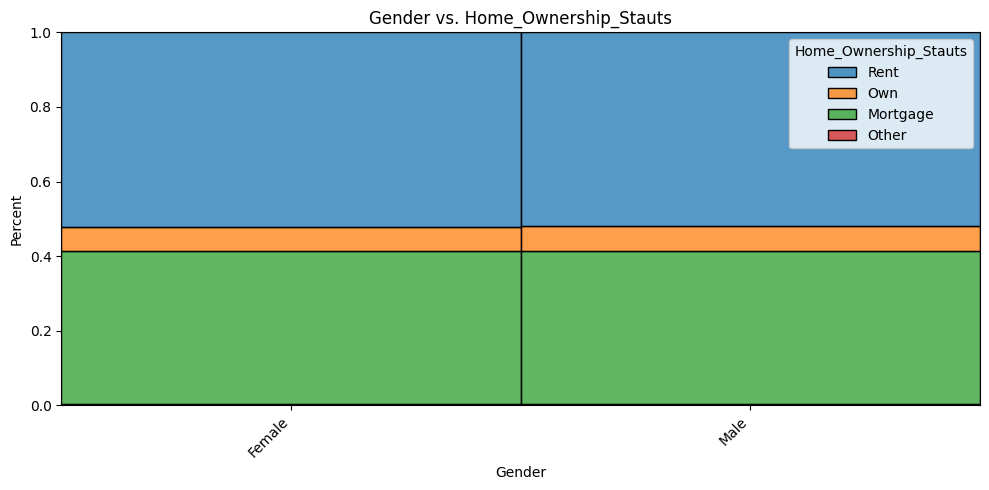

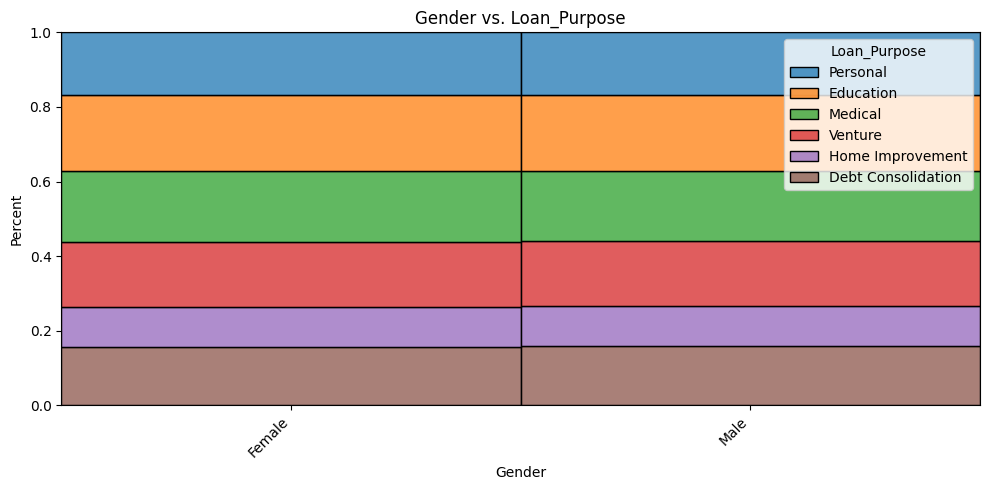

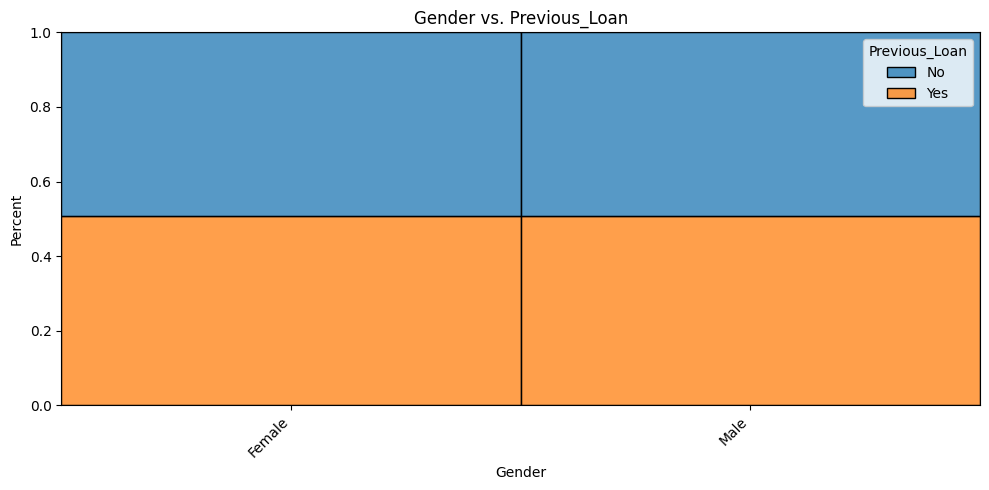

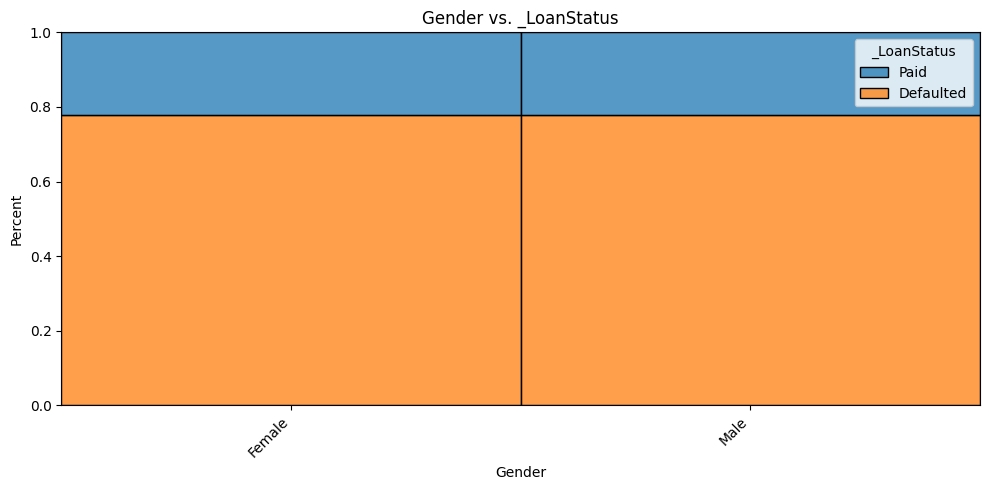

In [ ]:
for col in df.select_dtypes(include='object').columns.drop('Gender'):
  plot_categorical_vs_target(df,'Gender',col ,figsize=(10,5), target_type='class',status='percent');

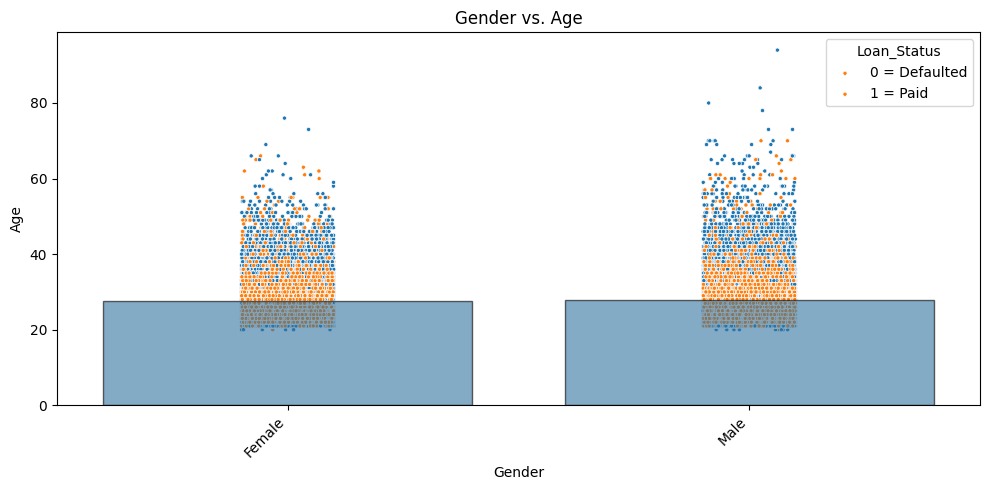

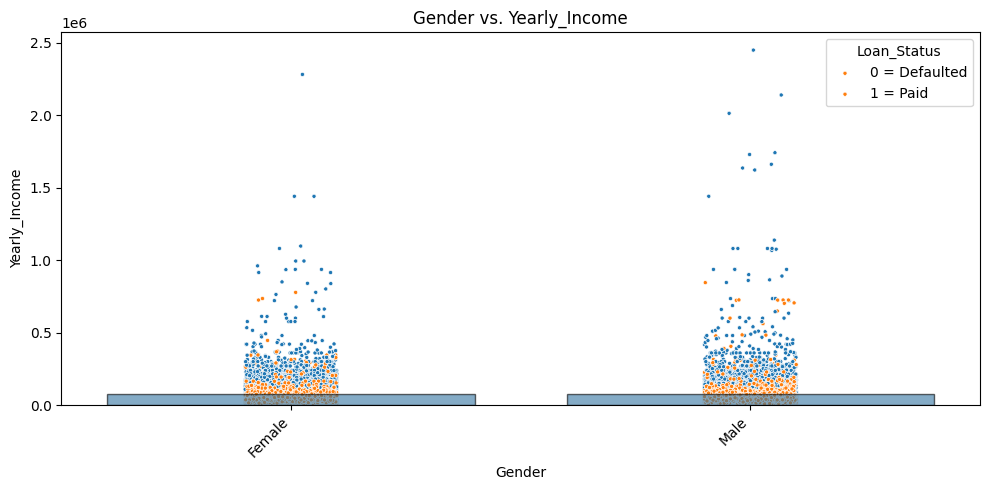

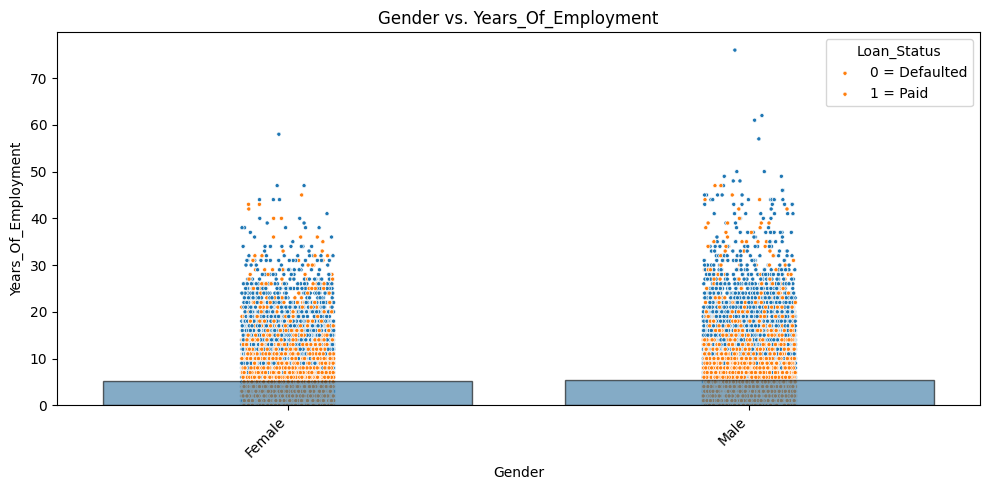

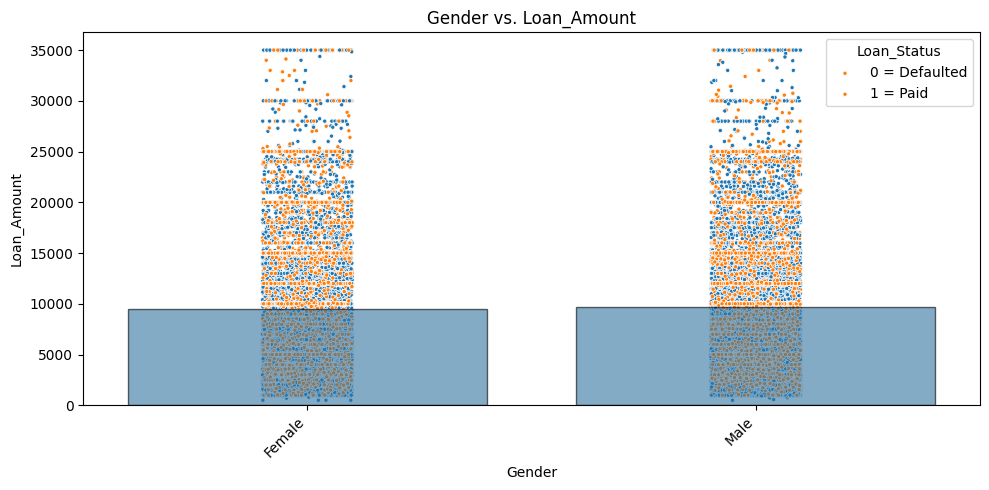

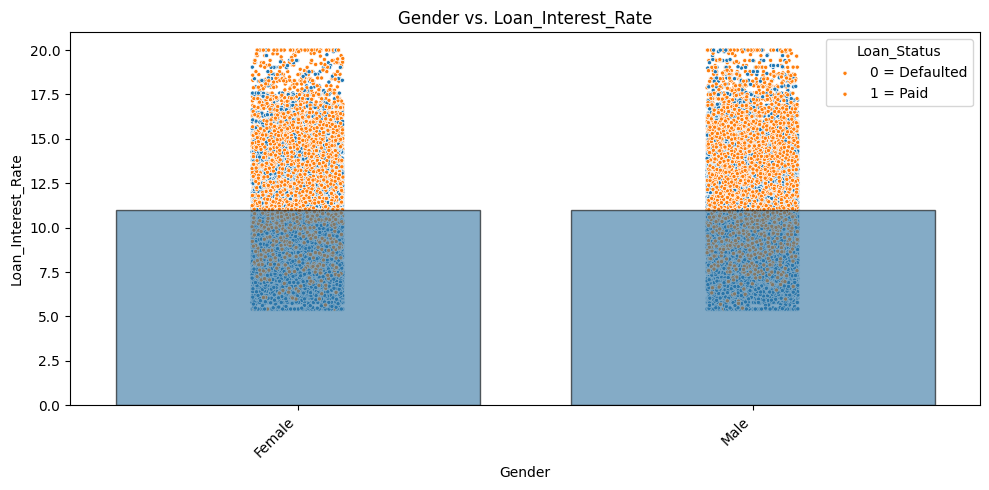

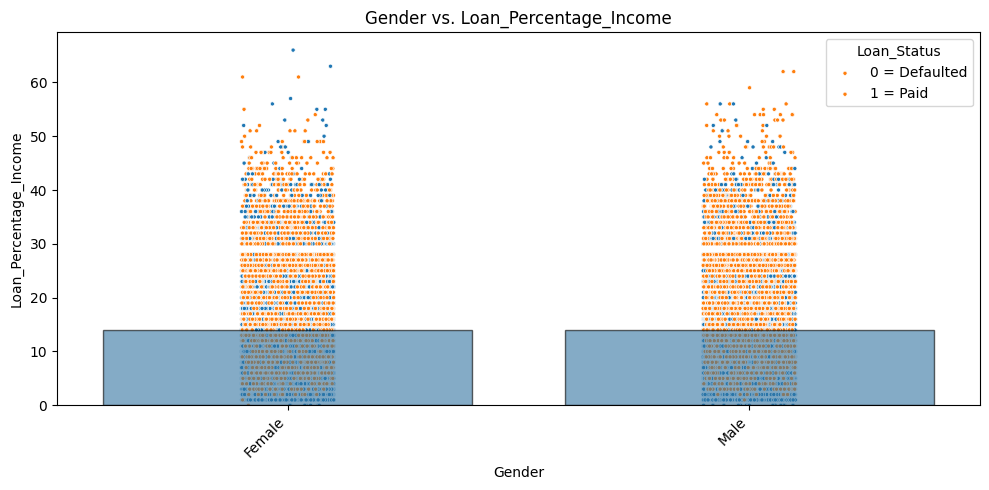

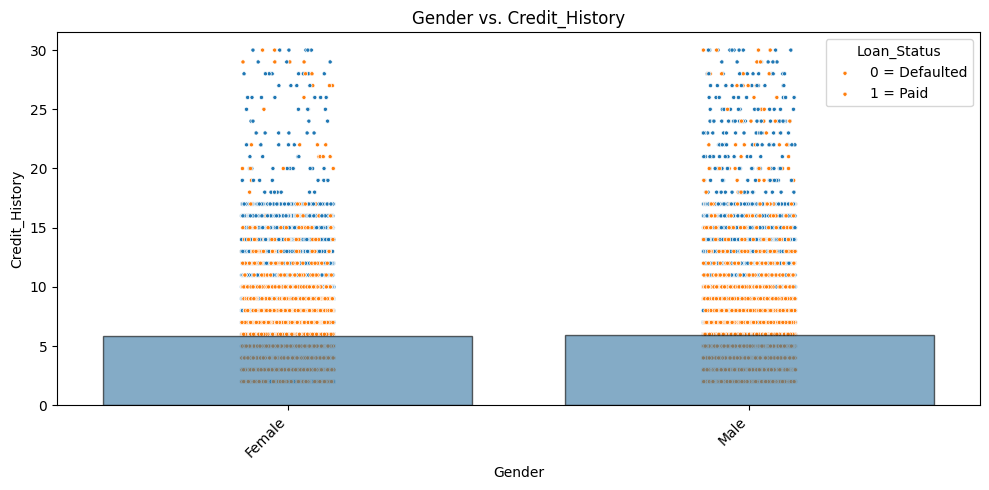

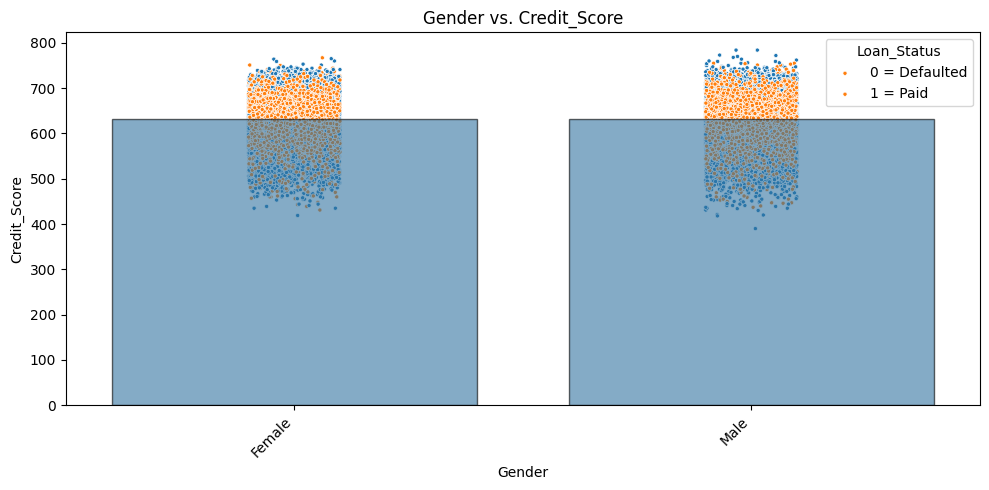

In [ ]:
for col in df.select_dtypes(include='number').columns.drop('Loan_Status'):
  plot_categorical_vs_target(df,'Gender',col ,figsize=(10,5), target_type='reg',status='percent',hue='Loan_Status');
  plt.legend(title='Loan_Status', labels=['0 = Defaulted', '1 = Paid'])

### Education Level

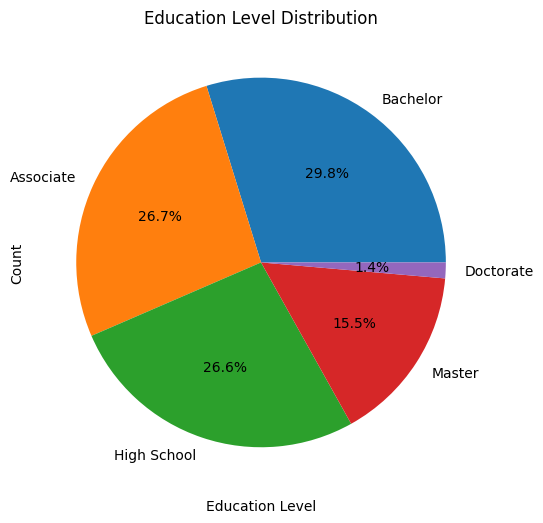

In [ ]:
gender_counts = df['Education_Level'].value_counts()
gender_percentages = df['Education_Level'].value_counts(normalize=True) * 100

fig, ax = plt.subplots(figsize=(8, 6))

wedges, texts, autotexts = ax.pie(gender_counts.values, labels=gender_counts.index, autopct='%1.1f%%')

# Add percentage and count labels inside the bars
for i, wedge in enumerate(wedges):
    x, y = wedge.center
    percentage = gender_percentages.iloc[i]
    count = gender_counts.iloc[i]

ax.set_xlabel("Education Level")
ax.set_ylabel("Count")
ax.set_title("Education Level Distribution")

plt.show()

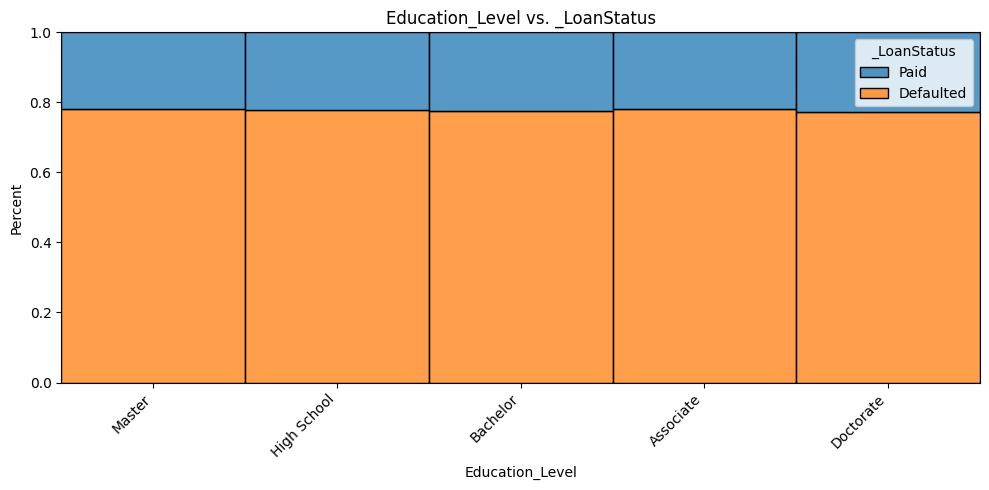

In [ ]:
plot_categorical_vs_target(df,'Education_Level','_LoanStatus' ,figsize=(10,5), target_type='class');

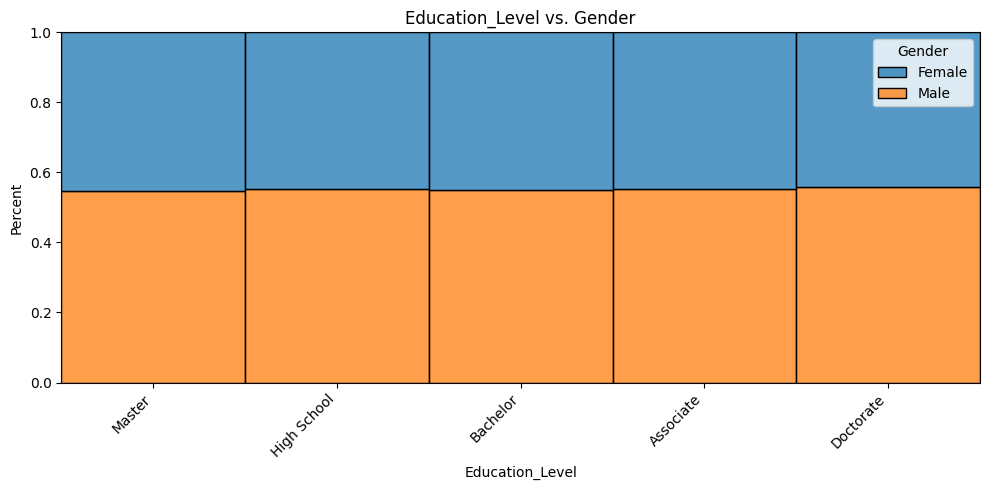

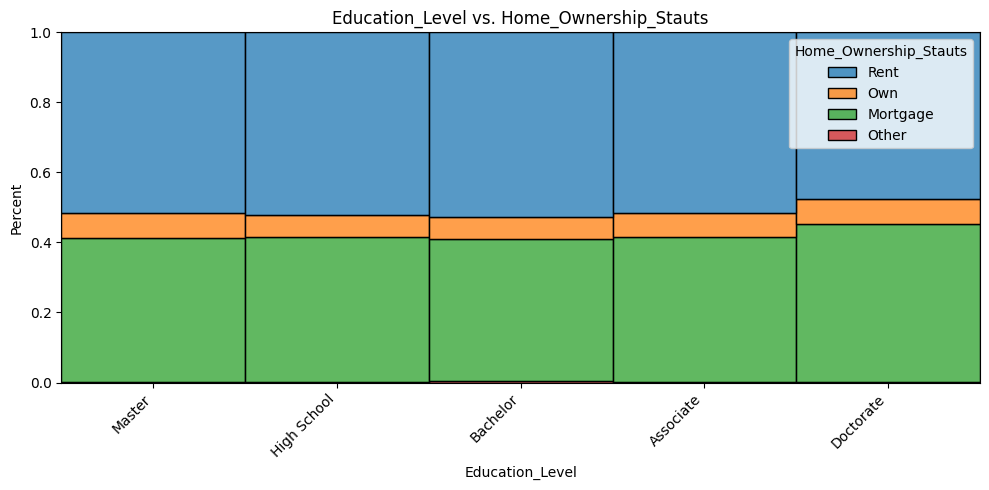

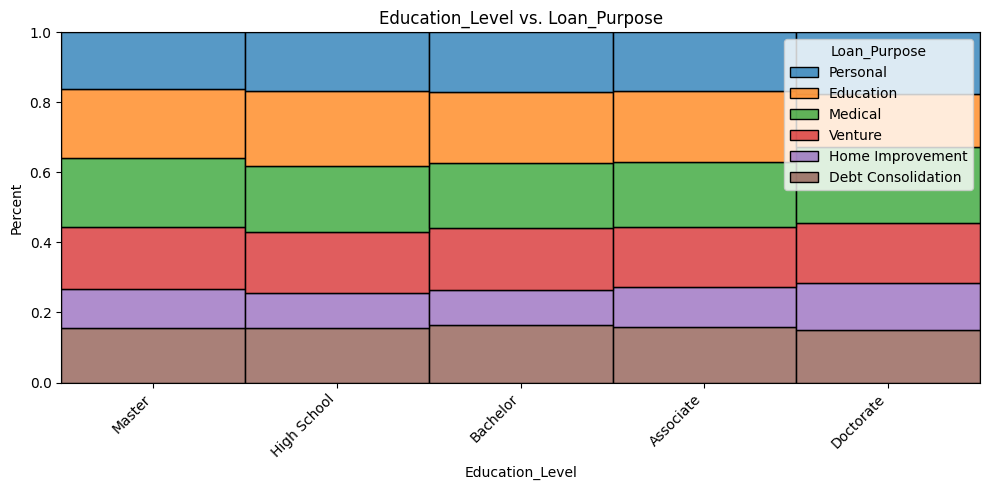

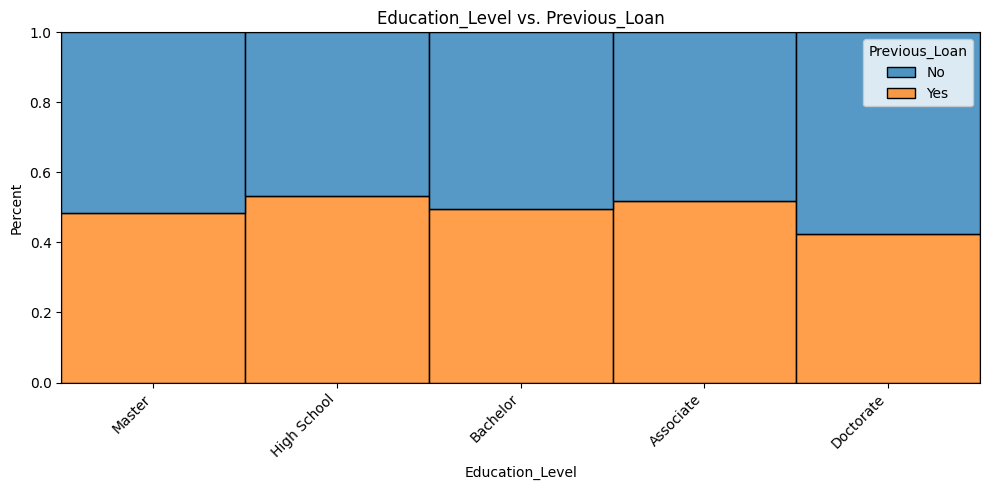

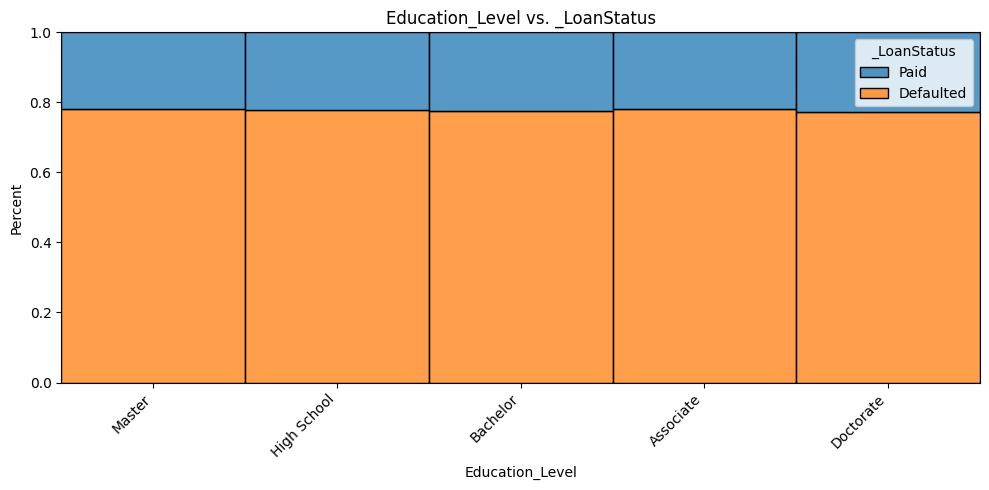

In [ ]:
for col in df.select_dtypes(include='object').columns.drop('Education_Level'):
  plot_categorical_vs_target(df,'Education_Level',col ,figsize=(10,5), target_type='class',status='percent');

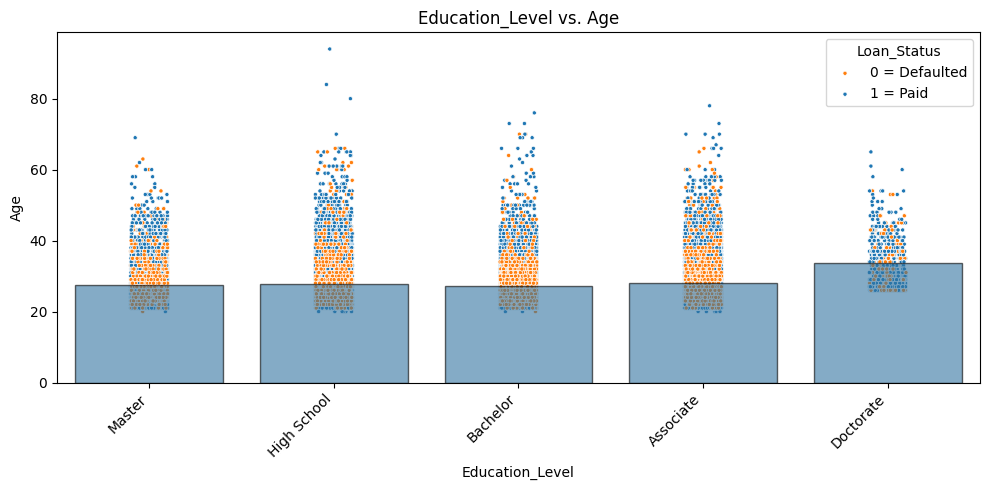

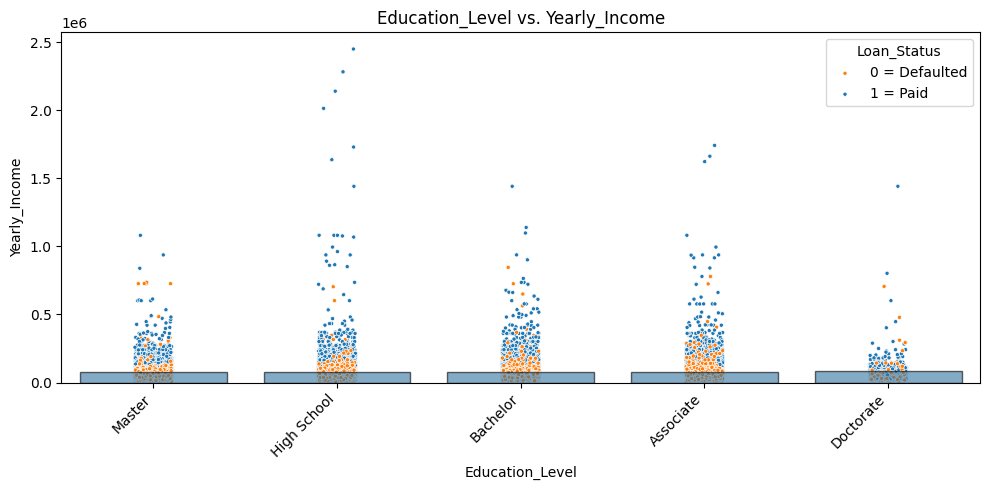

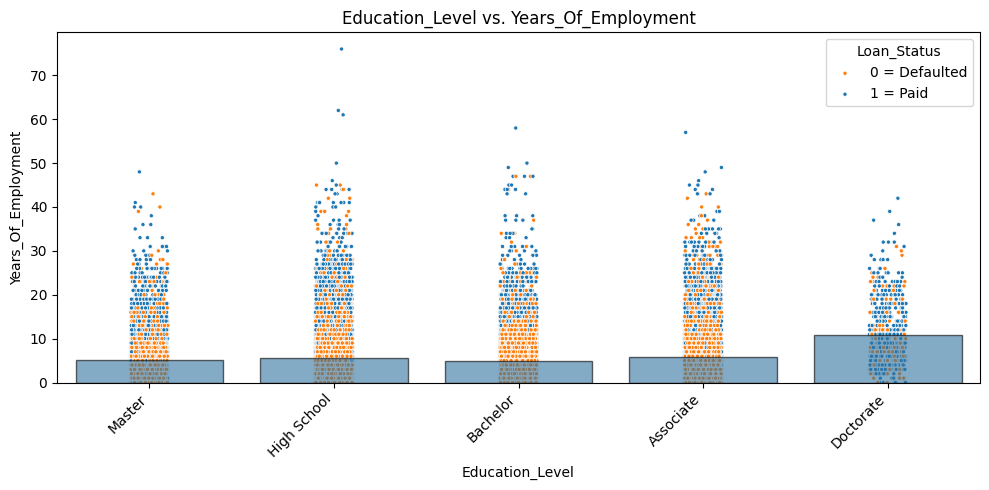

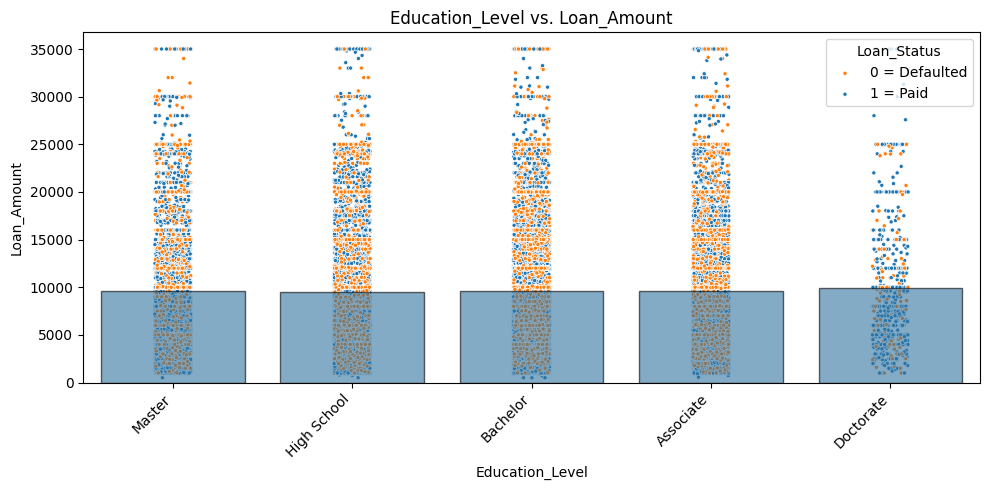

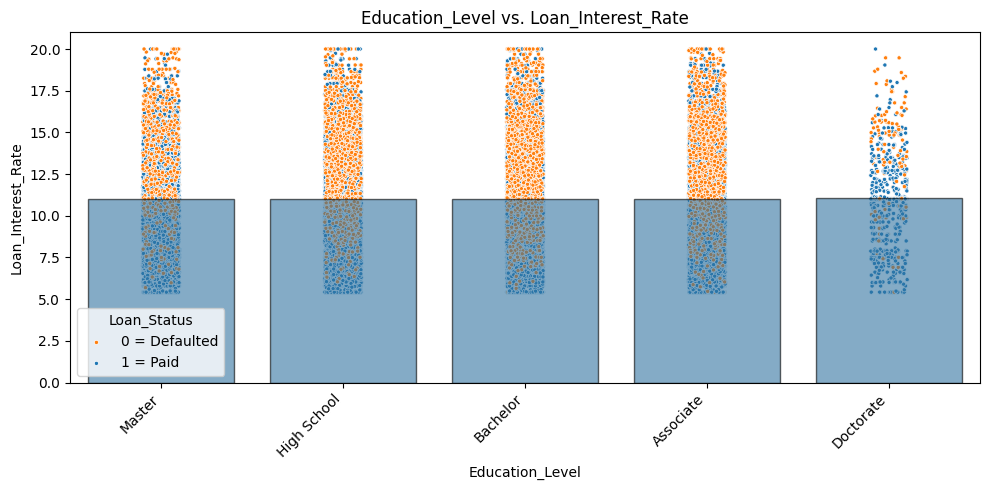

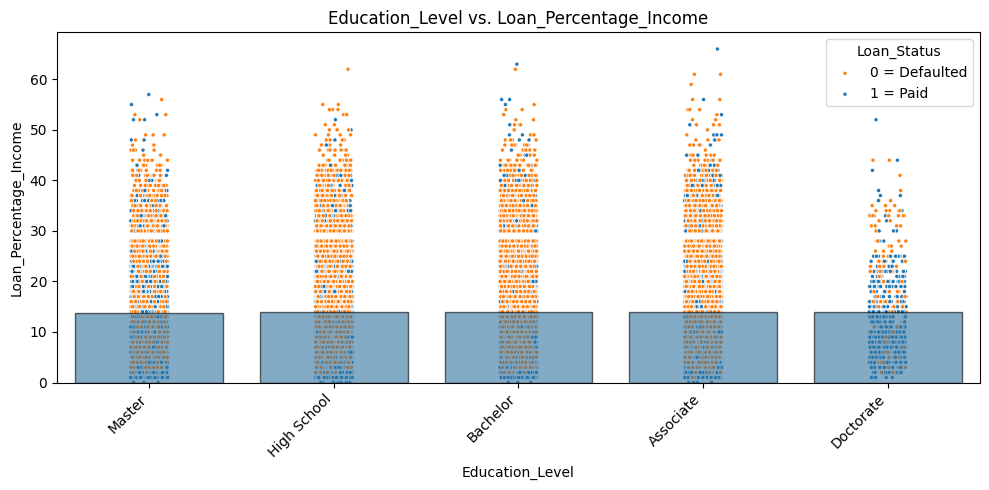

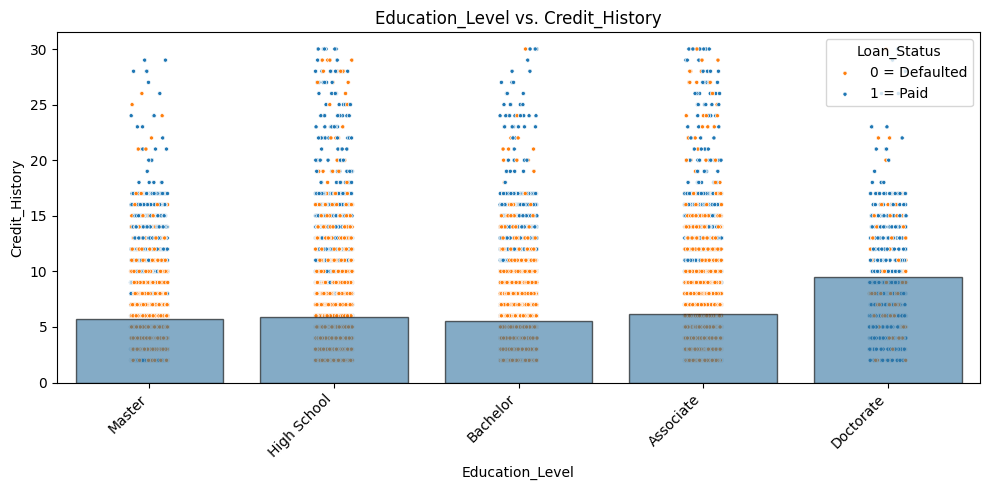

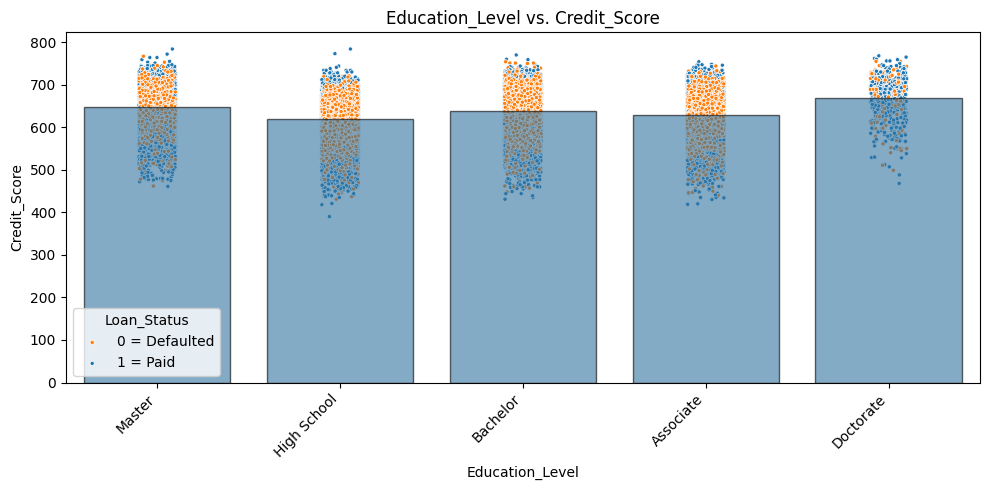

In [ ]:
for col in df.select_dtypes(include='number').columns.drop('Loan_Status'):
  plot_categorical_vs_target(df,'Education_Level',col ,figsize=(10,5), target_type='reg',status='percent',hue='Loan_Status');
  plt.legend(title='Loan_Status', labels=['0 = Defaulted', '1 = Paid'])

### Yearly Income

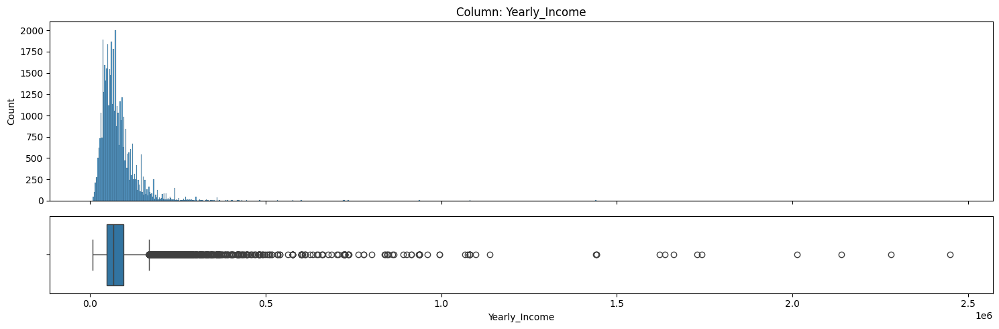

- NaN's Found: 0 (0.0%)


In [ ]:
explore_numeric(df,'Yearly_Income',figsize=(15,5))

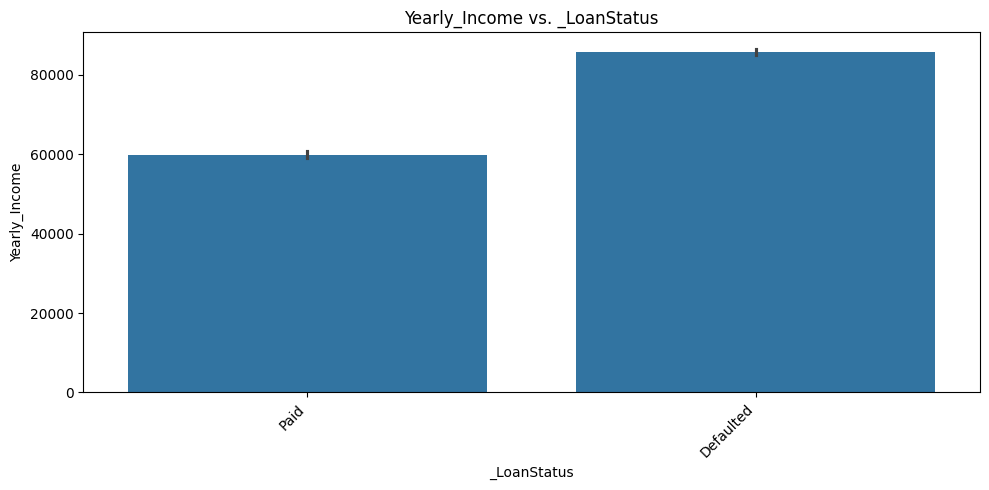

In [ ]:
plot_numeric_vs_target(df,'Yearly_Income','_LoanStatus' ,figsize=(10,5), target_type='class', estimator='mean',errorbar='ci',sorted=False,ascending=False);

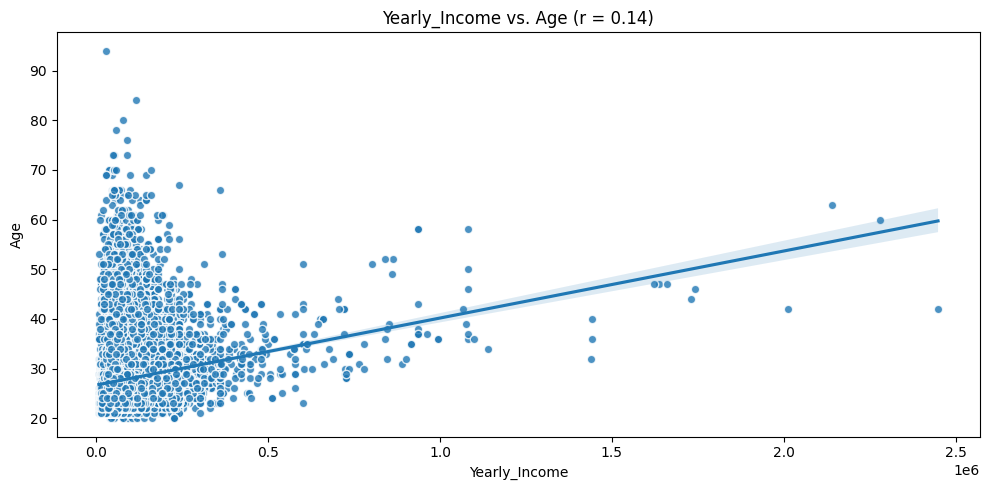

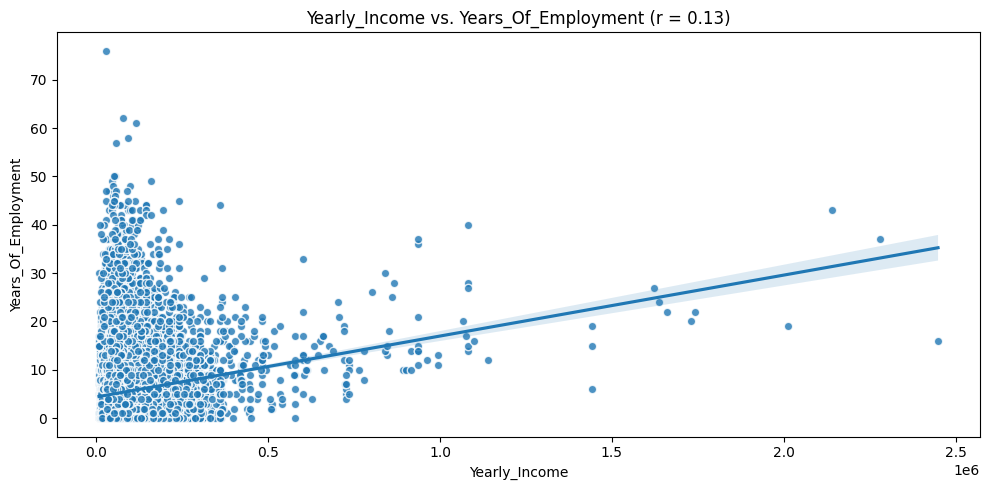

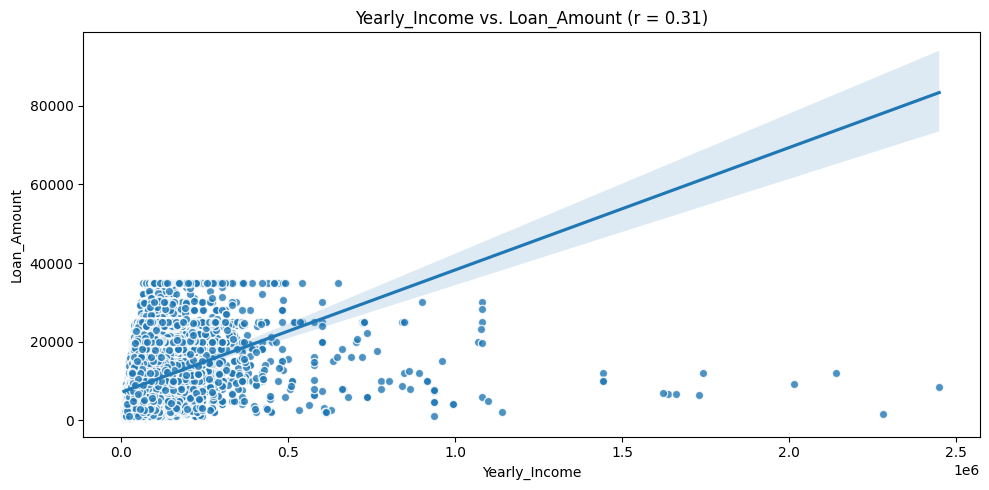

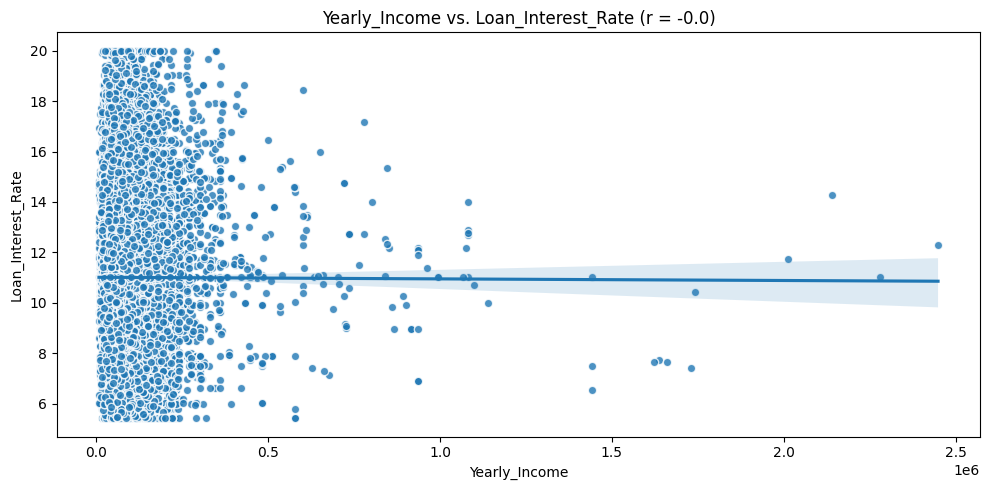

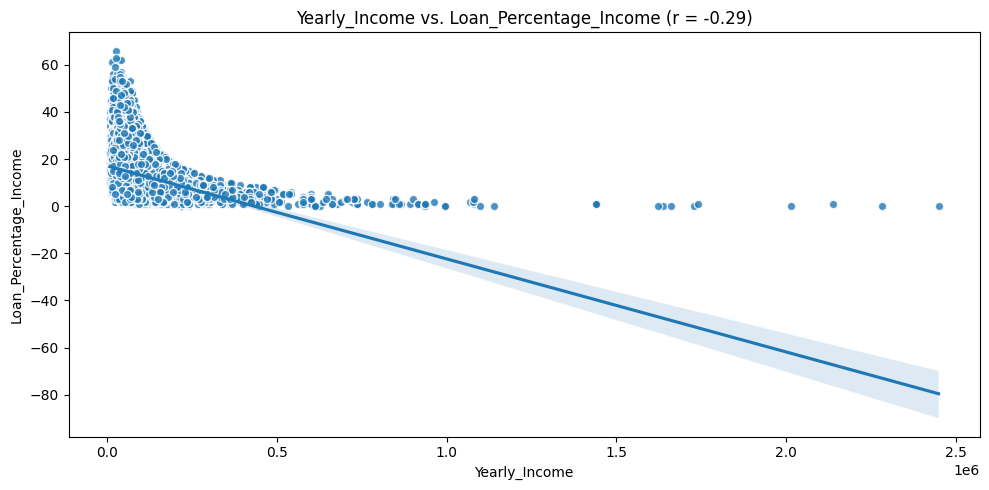

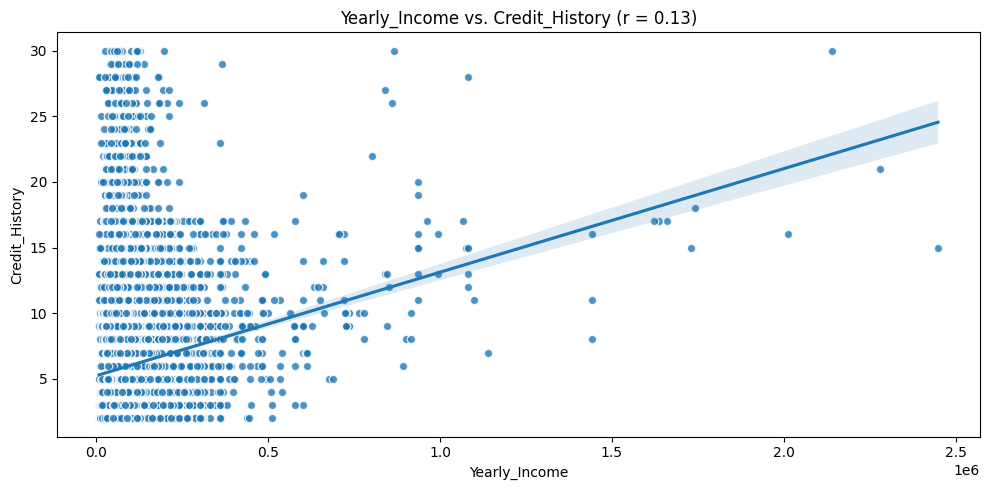

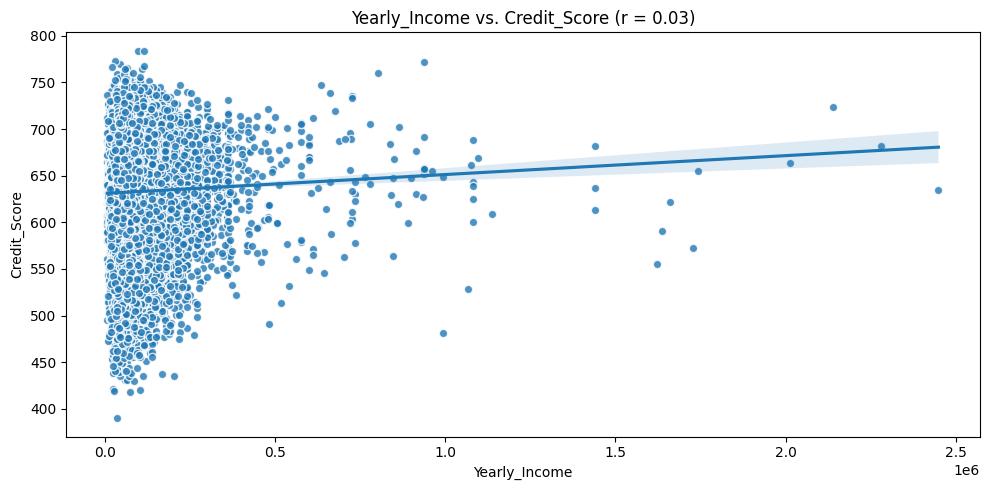

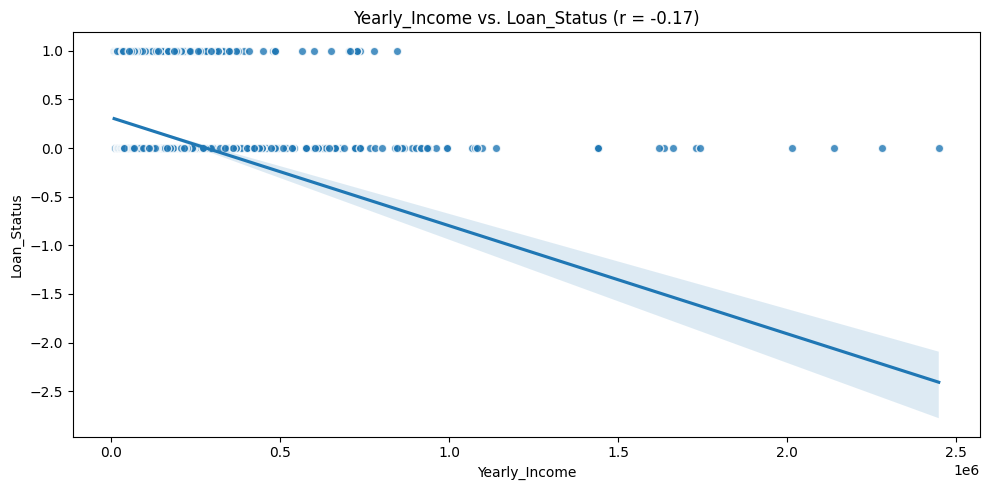

In [ ]:
for col in df.select_dtypes(include='number').columns.drop('Yearly_Income'):
  plot_numeric_vs_target(df,'Yearly_Income',col ,figsize=(10,5), target_type='reg');

### Years Of Employment

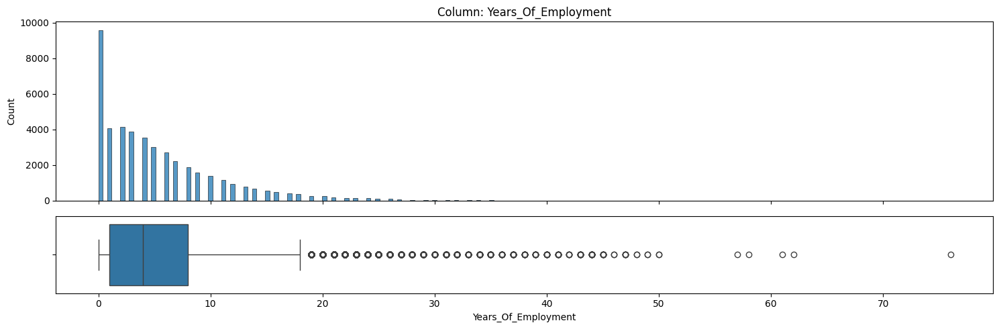

- NaN's Found: 0 (0.0%)


In [ ]:
explore_numeric(df,'Years_Of_Employment',figsize=(15,5))

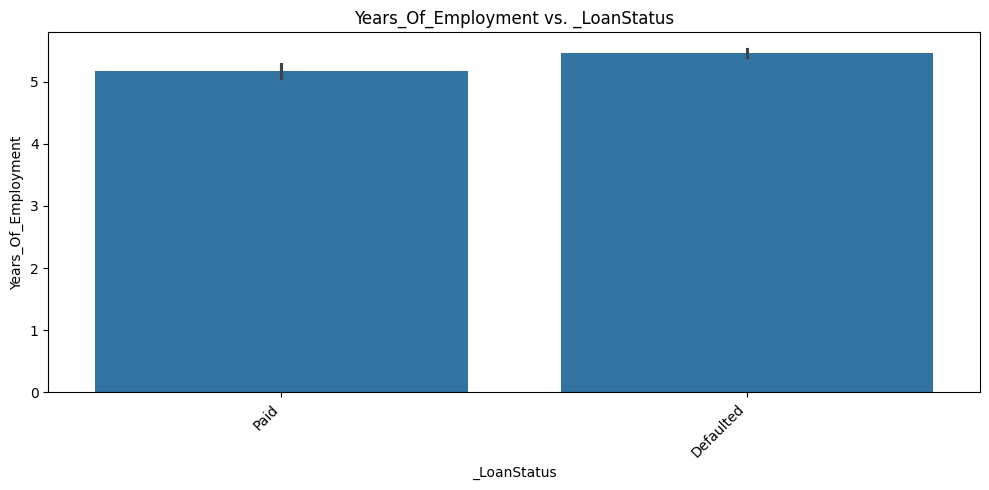

In [ ]:
plot_numeric_vs_target(df,'Years_Of_Employment','_LoanStatus' ,figsize=(10,5), target_type='class', estimator='mean',errorbar='ci',sorted=False,ascending=False);

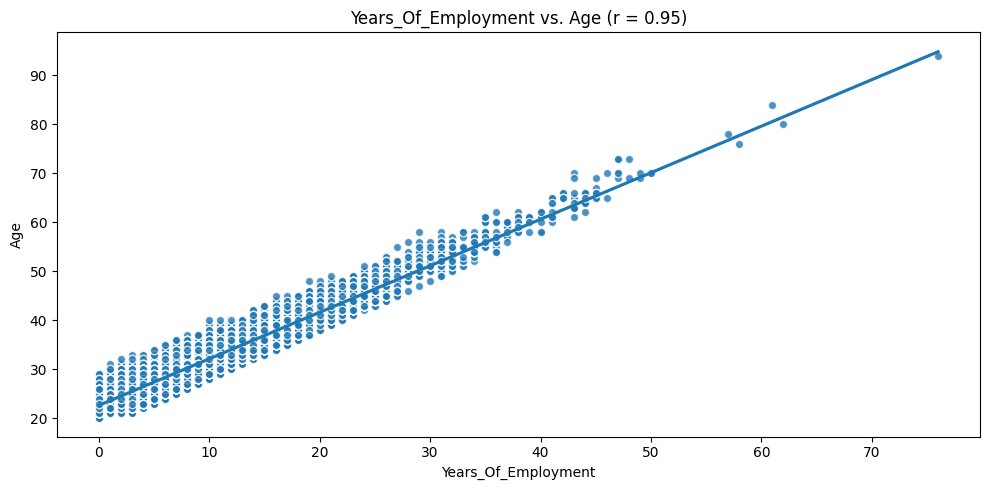

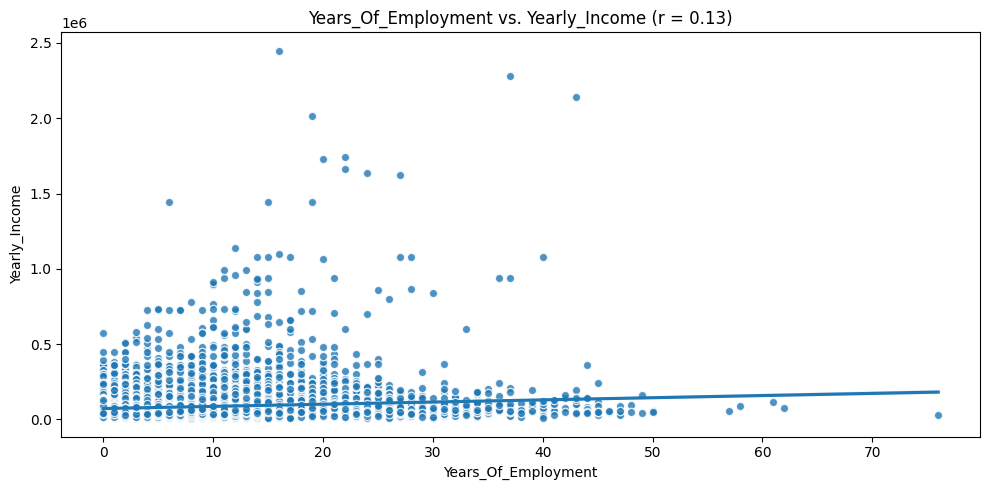

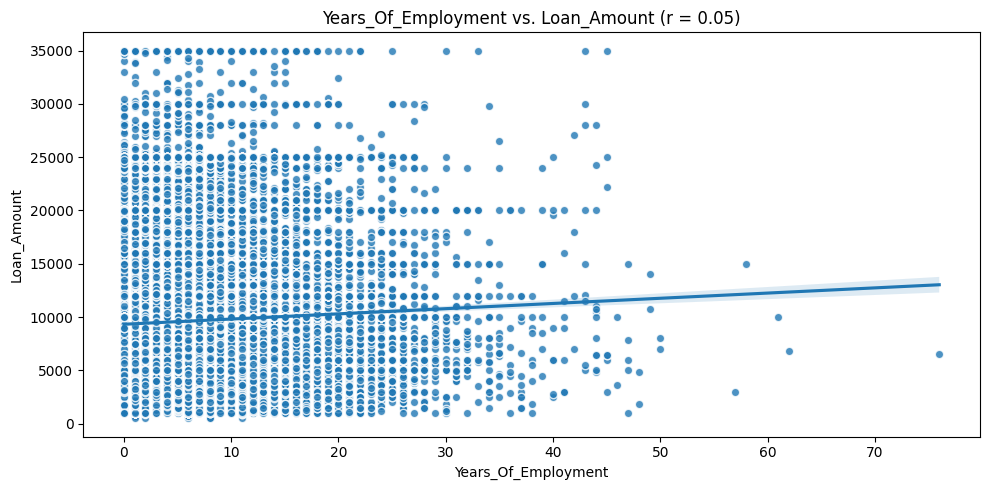

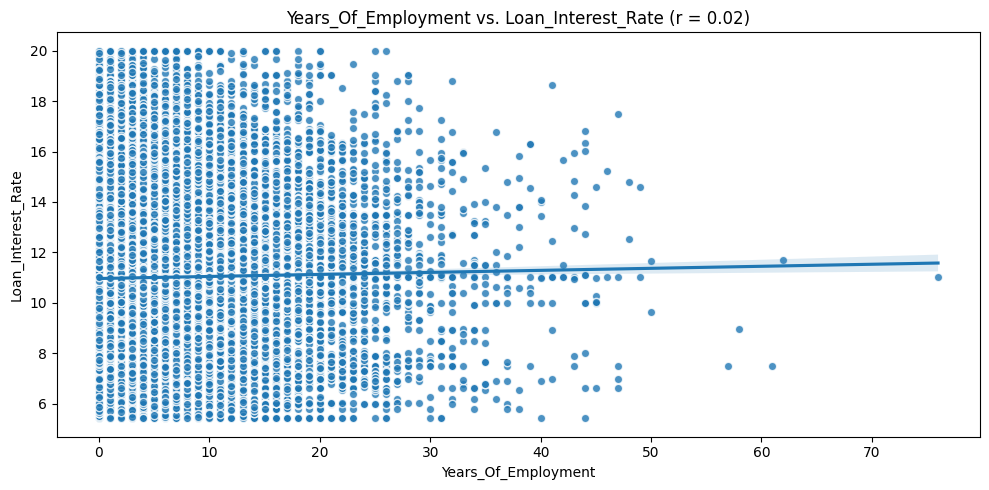

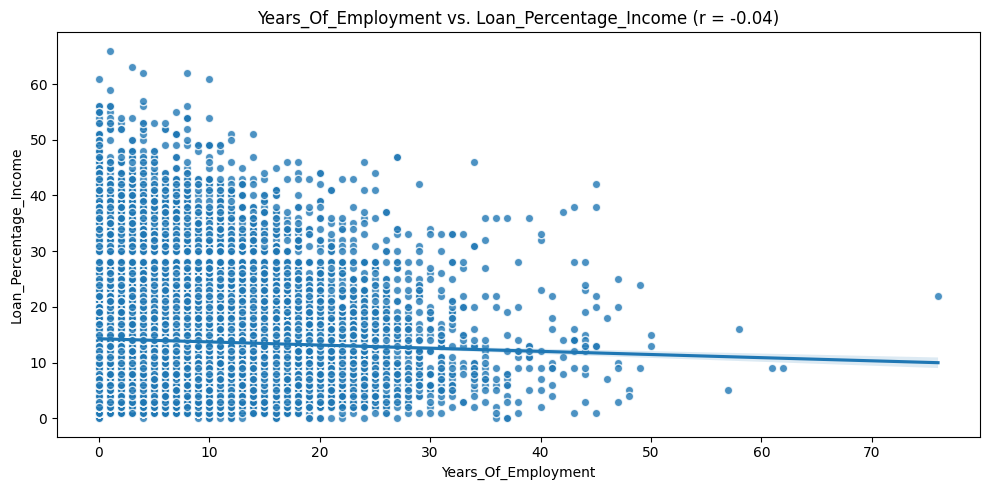

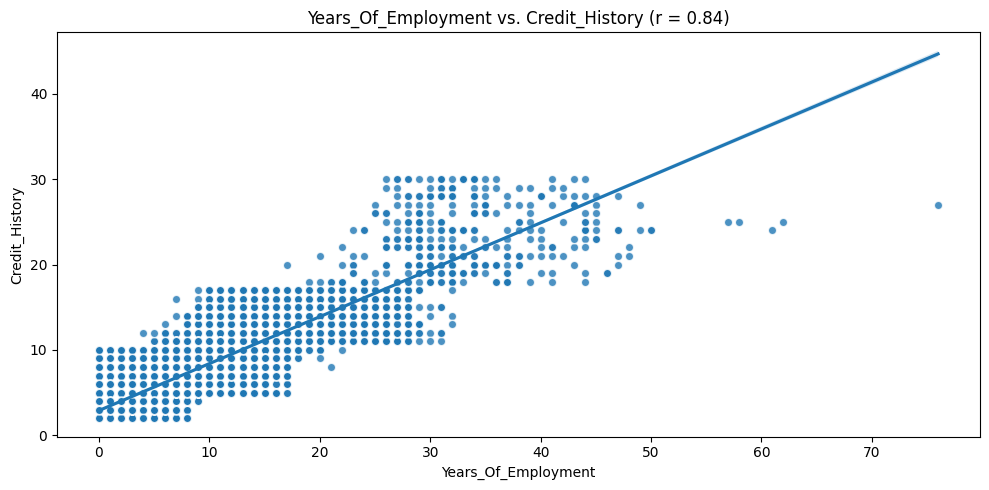

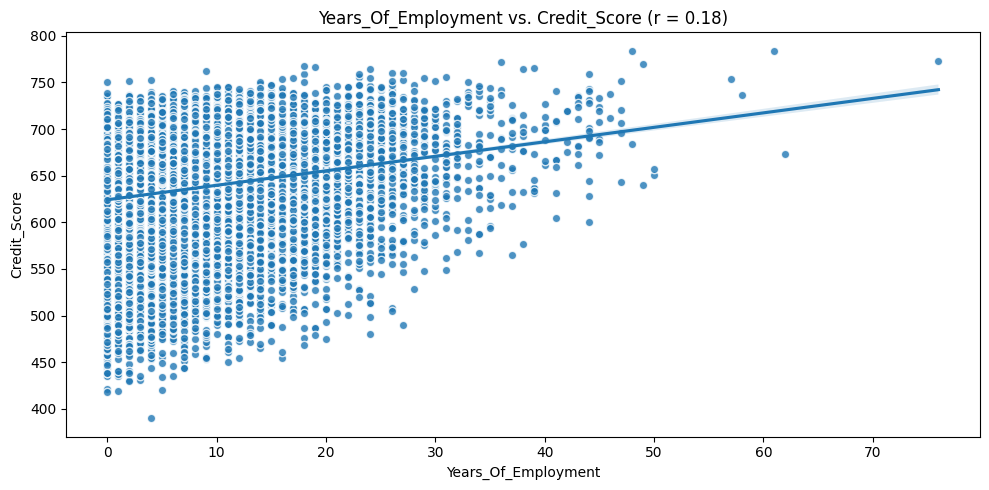

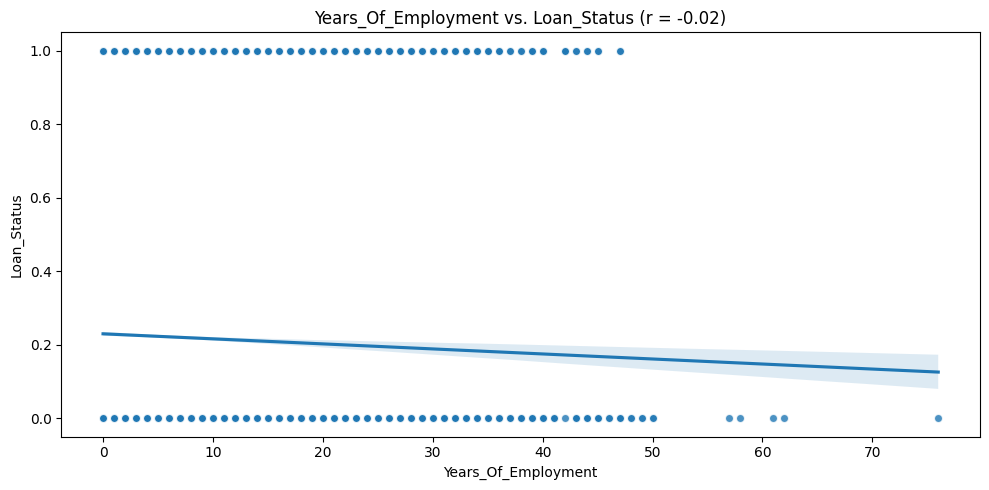

In [ ]:
for col in df.select_dtypes(include='number').columns.drop('Years_Of_Employment'):
  plot_numeric_vs_target(df,'Years_Of_Employment',col ,figsize=(10,5), target_type='reg');

### Home Ownership Stauts

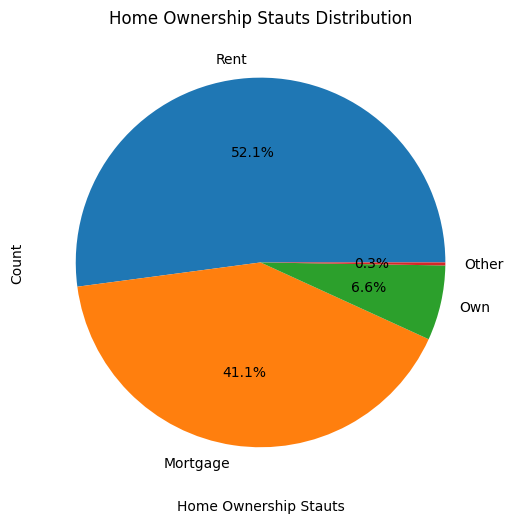

In [ ]:
gender_counts = df['Home_Ownership_Stauts'].value_counts()
gender_percentages = df['Home_Ownership_Stauts'].value_counts(normalize=True) * 100

fig, ax = plt.subplots(figsize=(8, 6))

wedges, texts, autotexts = ax.pie(gender_counts.values, labels=gender_counts.index, autopct='%1.1f%%')

# Add percentage and count labels inside the bars
for i, wedge in enumerate(wedges):
    x, y = wedge.center
    percentage = gender_percentages.iloc[i]
    count = gender_counts.iloc[i]

ax.set_xlabel("Home Ownership Stauts")
ax.set_ylabel("Count")
ax.set_title("Home Ownership Stauts Distribution")

plt.show()

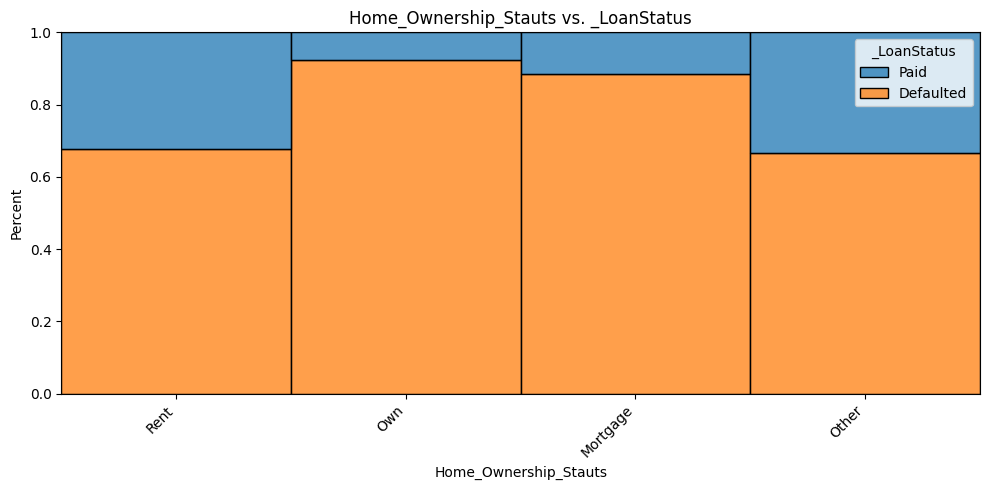

In [ ]:
plot_categorical_vs_target(df,'Home_Ownership_Stauts','_LoanStatus' ,figsize=(10,5), target_type='class');

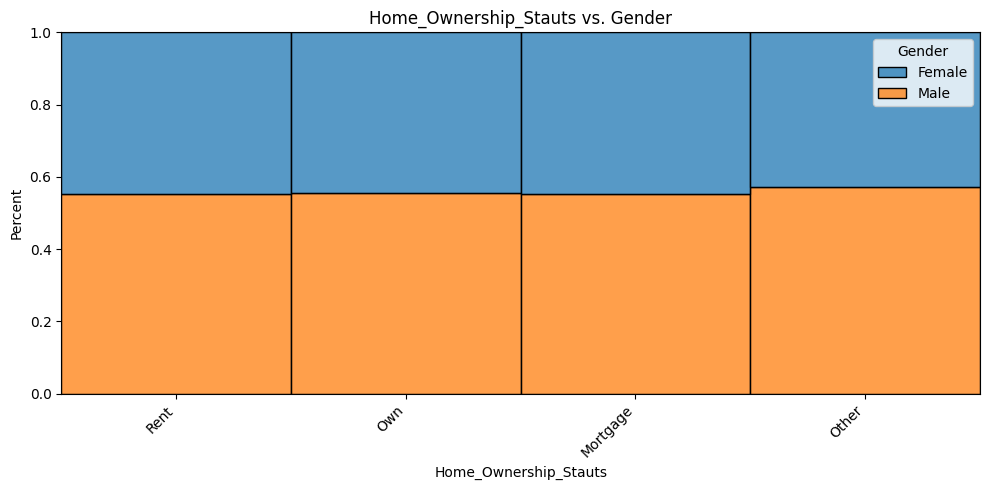

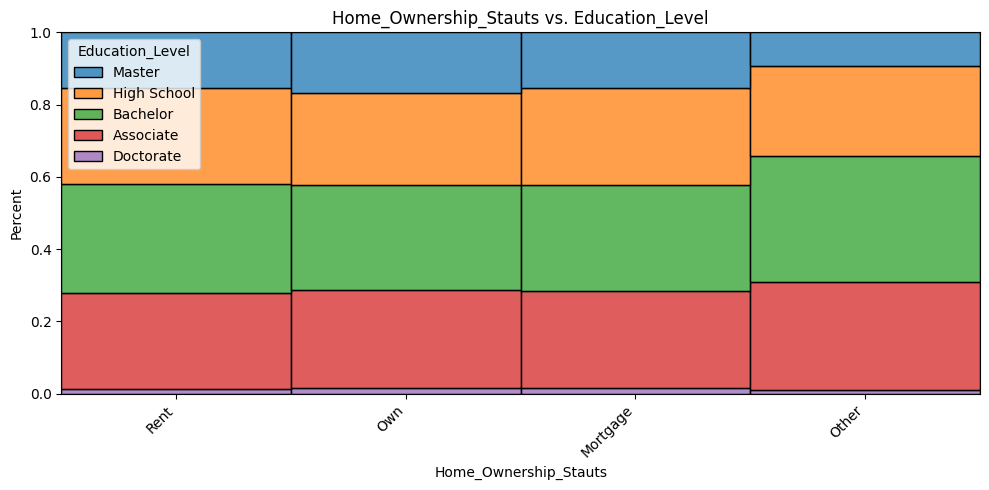

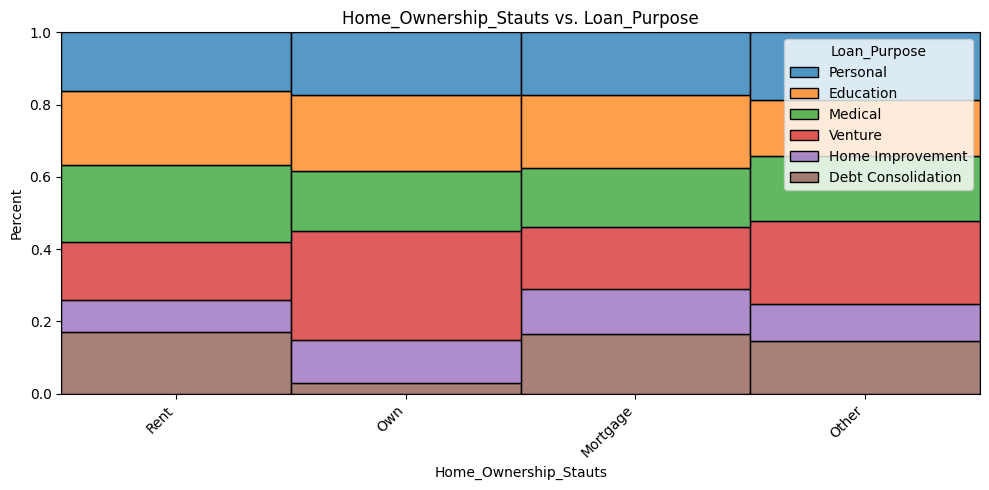

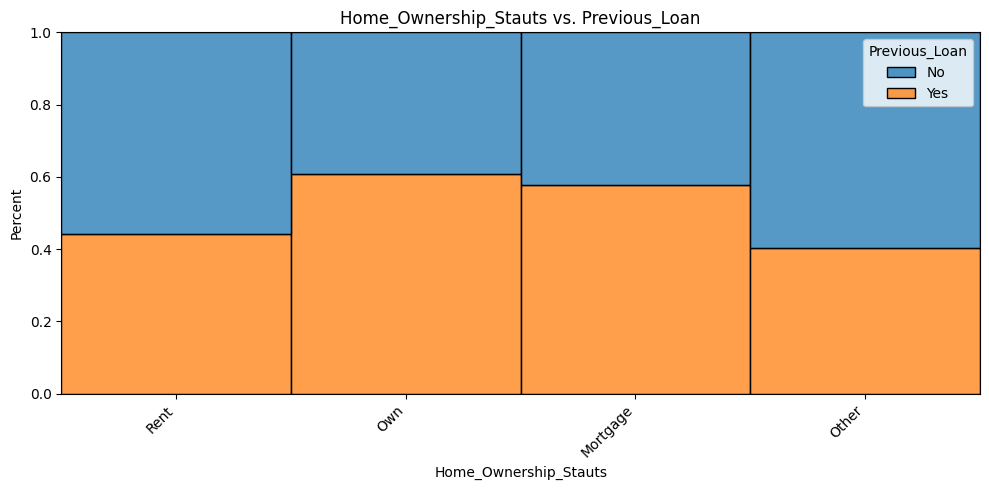

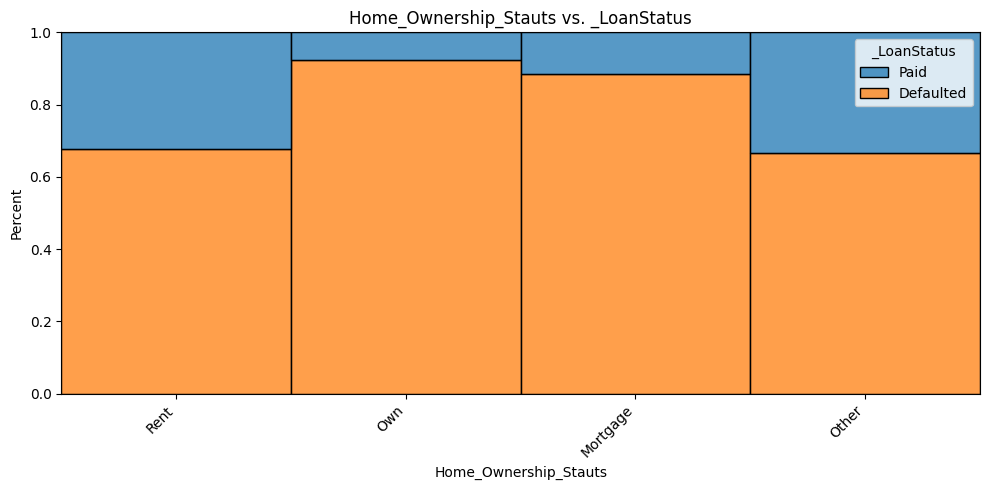

In [ ]:
for col in df.select_dtypes(include='object').columns.drop('Home_Ownership_Stauts'):
  plot_categorical_vs_target(df,'Home_Ownership_Stauts',col ,figsize=(10,5), target_type='class',status='percent');

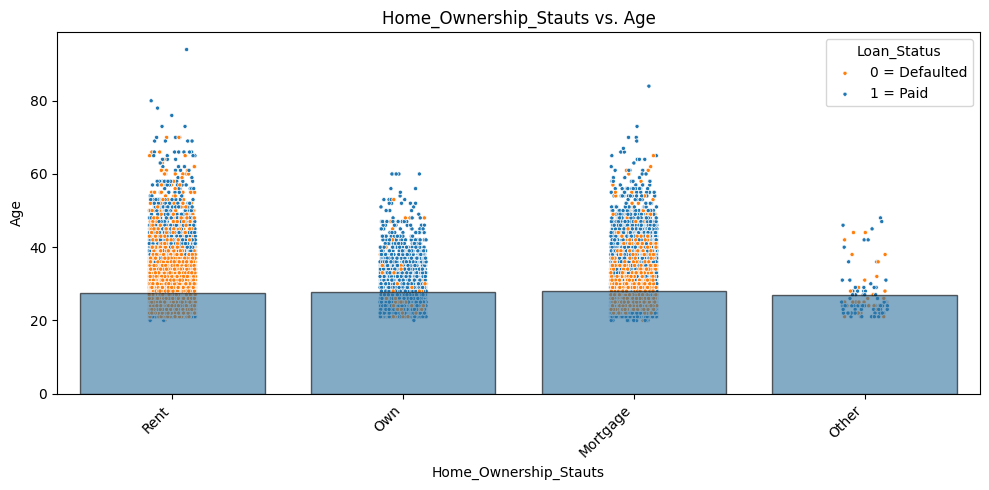

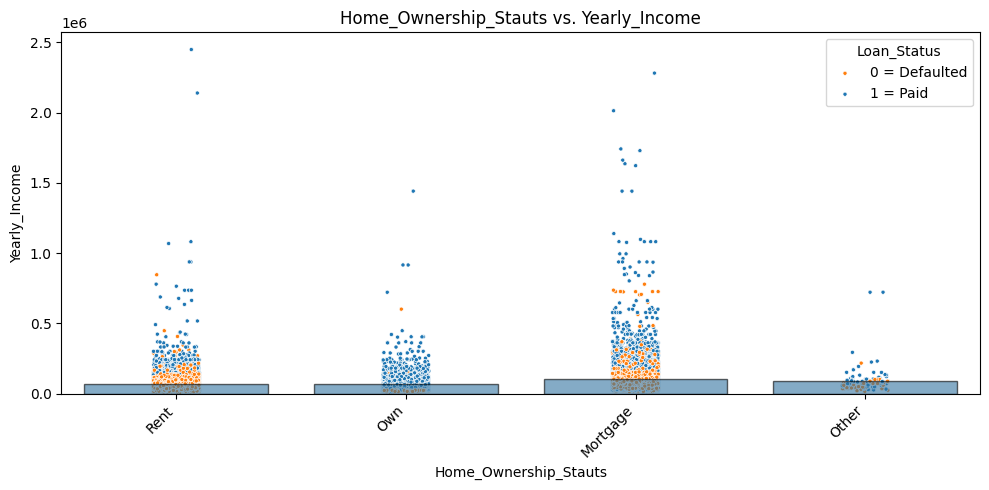

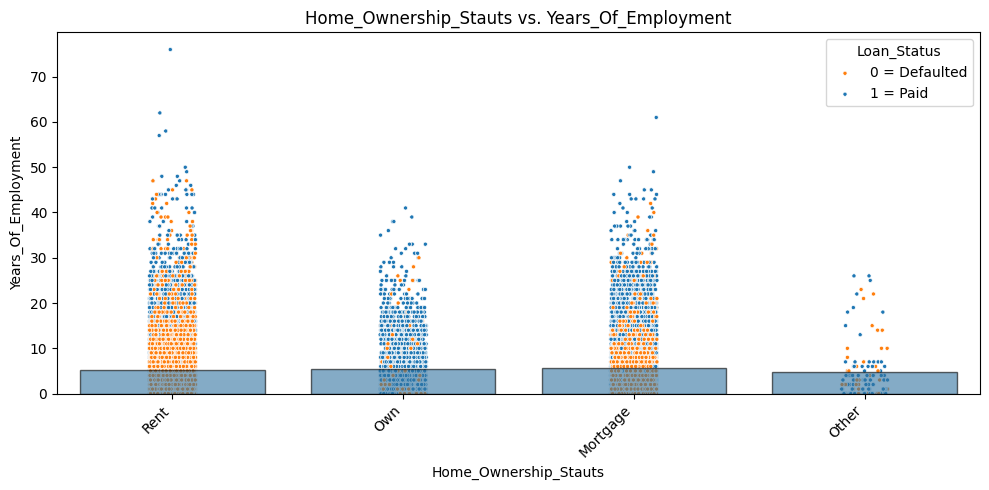

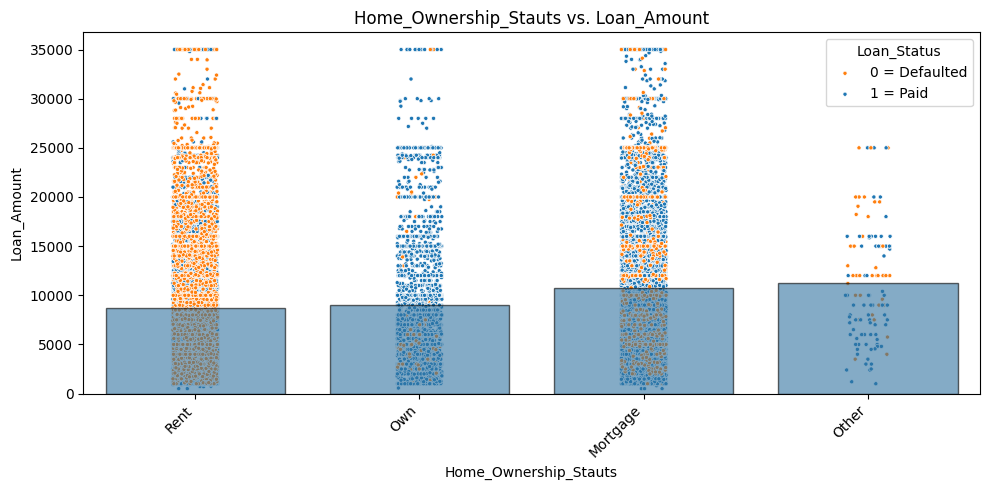

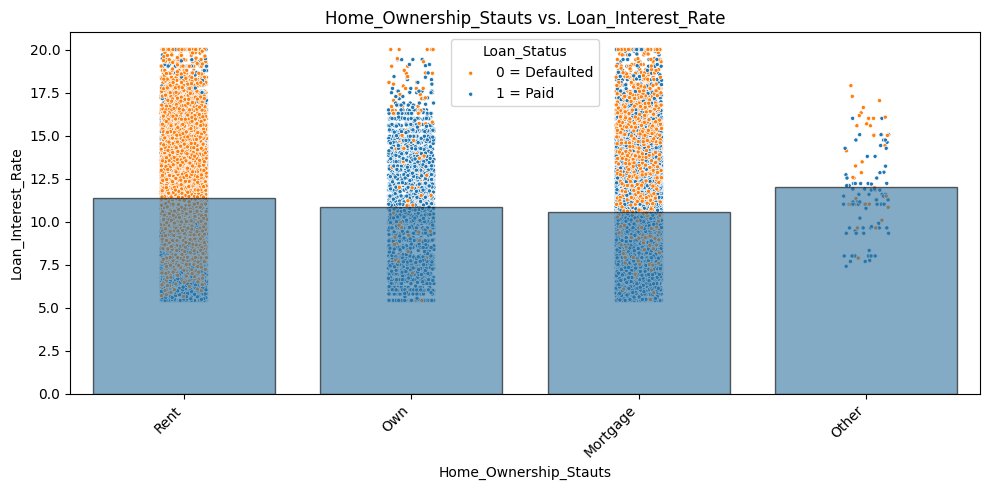

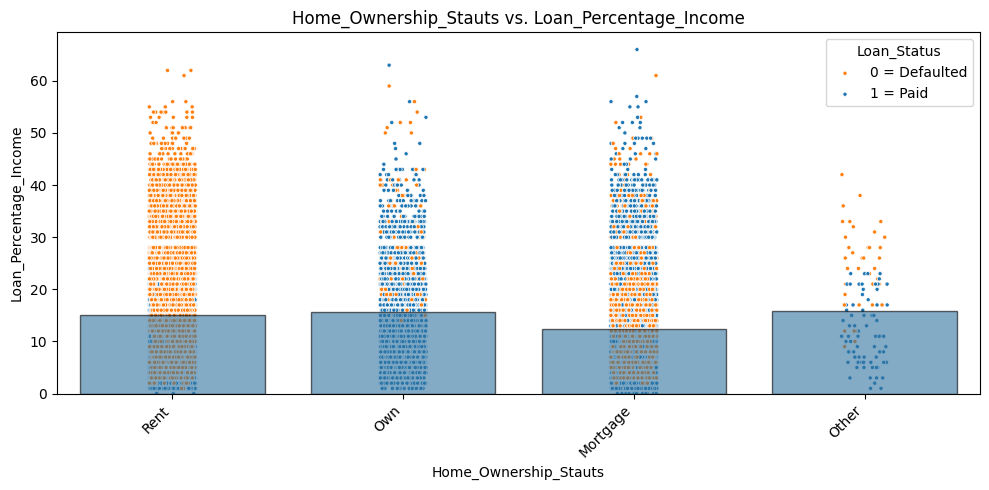

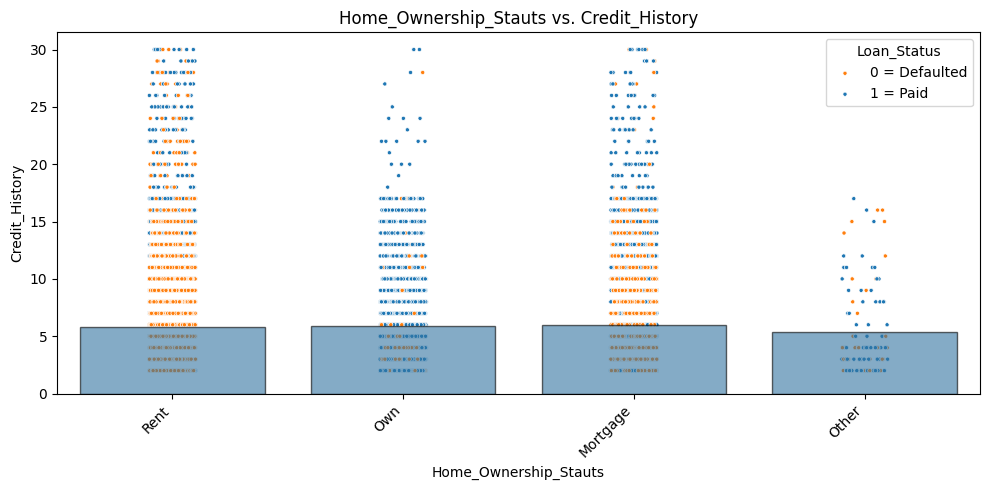

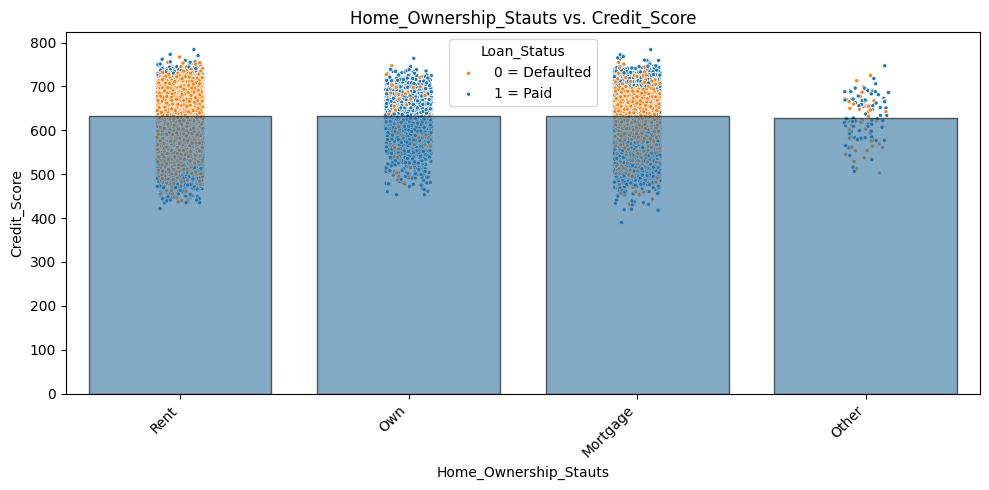

In [ ]:
for col in df.select_dtypes(include='number').columns.drop('Loan_Status'):
  plot_categorical_vs_target(df,'Home_Ownership_Stauts',col ,figsize=(10,5), target_type='reg',status='percent',hue='Loan_Status');
  plt.legend(title='Loan_Status', labels=['0 = Defaulted', '1 = Paid'])

### Loan Amount

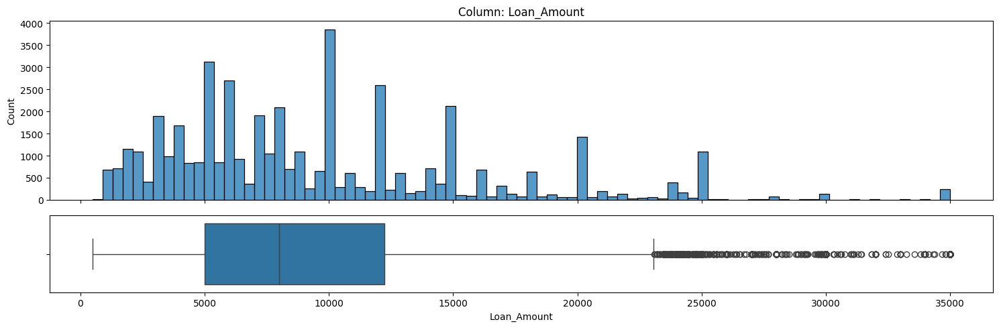

- NaN's Found: 0 (0.0%)


In [ ]:
explore_numeric(df,'Loan_Amount',figsize=(15,5))

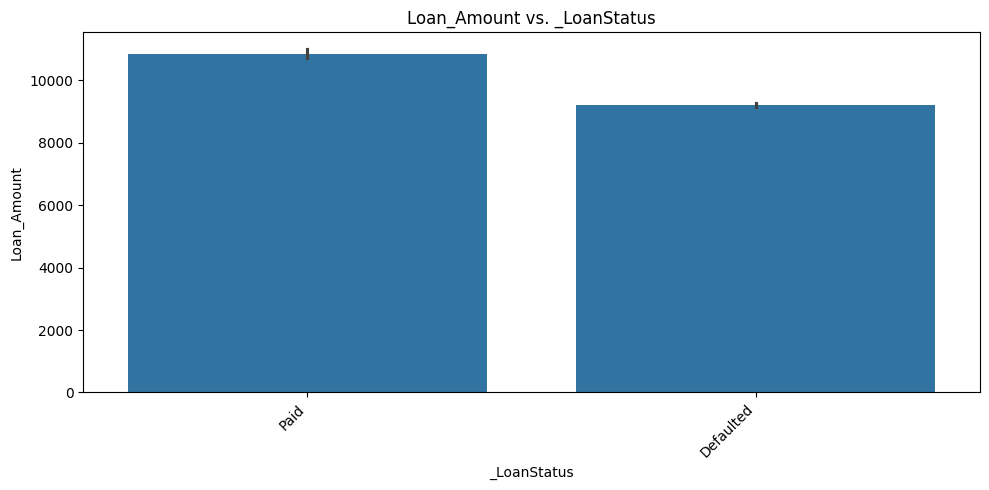

In [ ]:
plot_numeric_vs_target(df,'Loan_Amount','_LoanStatus' ,figsize=(10,5), target_type='class', estimator='mean',errorbar='ci',sorted=False,ascending=False);

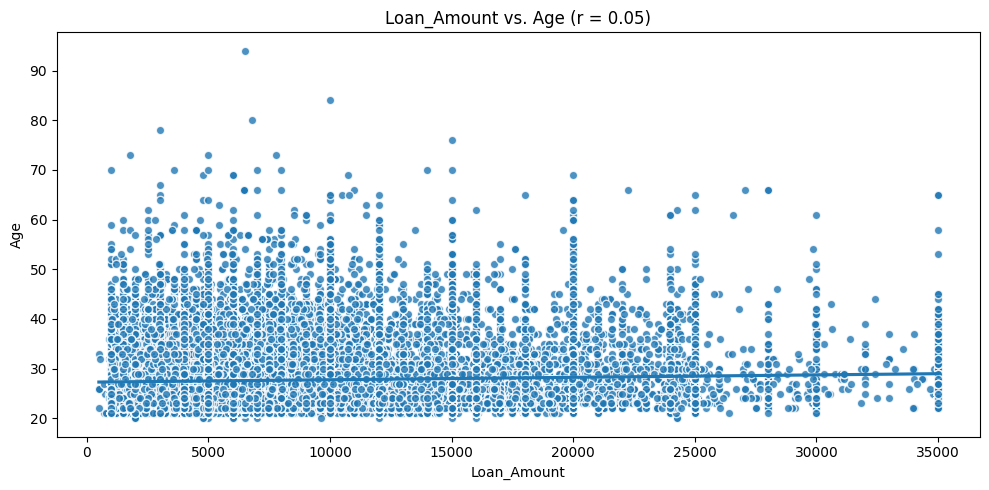

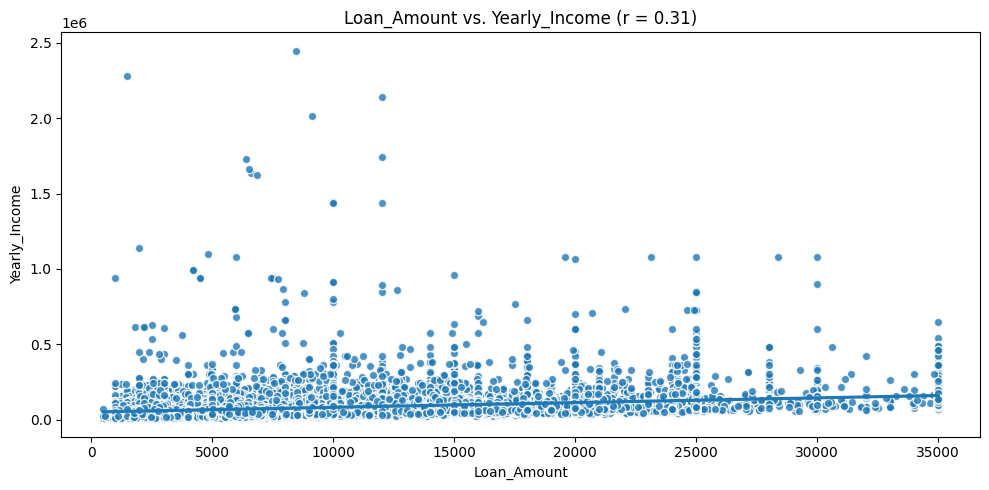

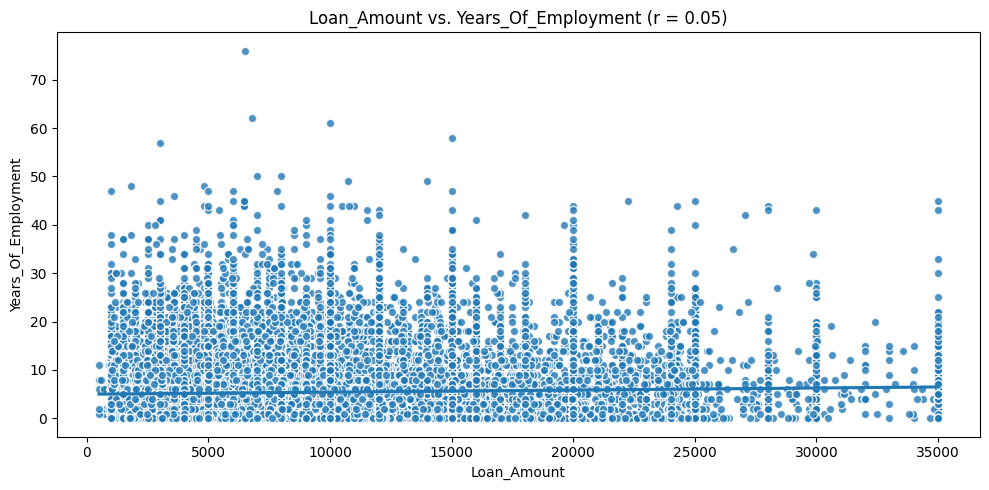

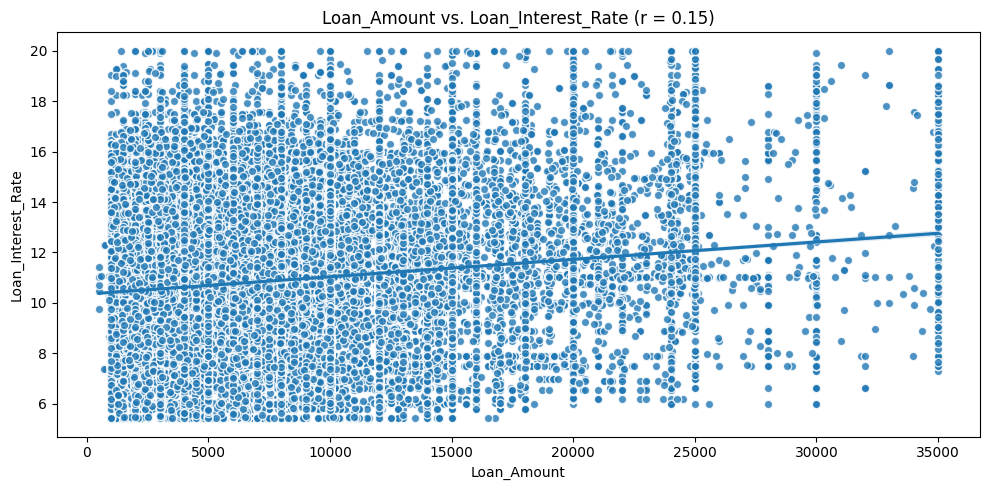

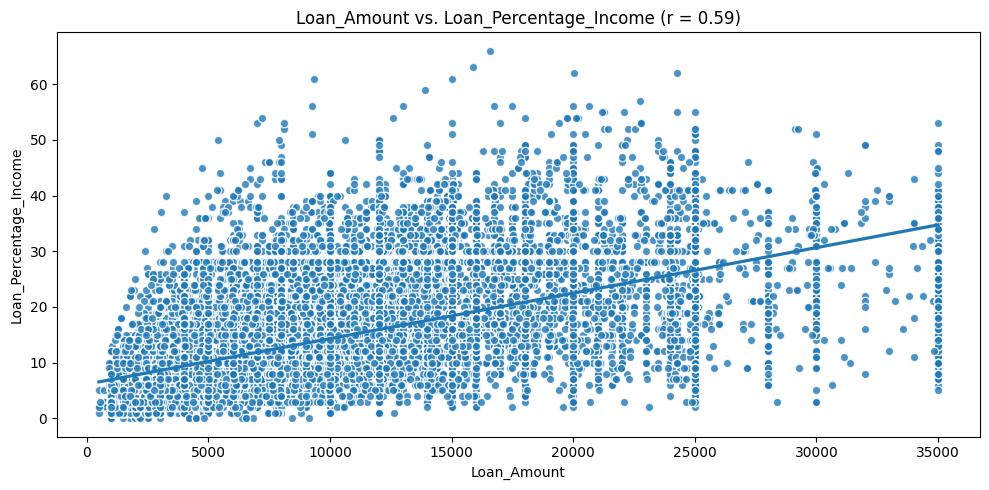

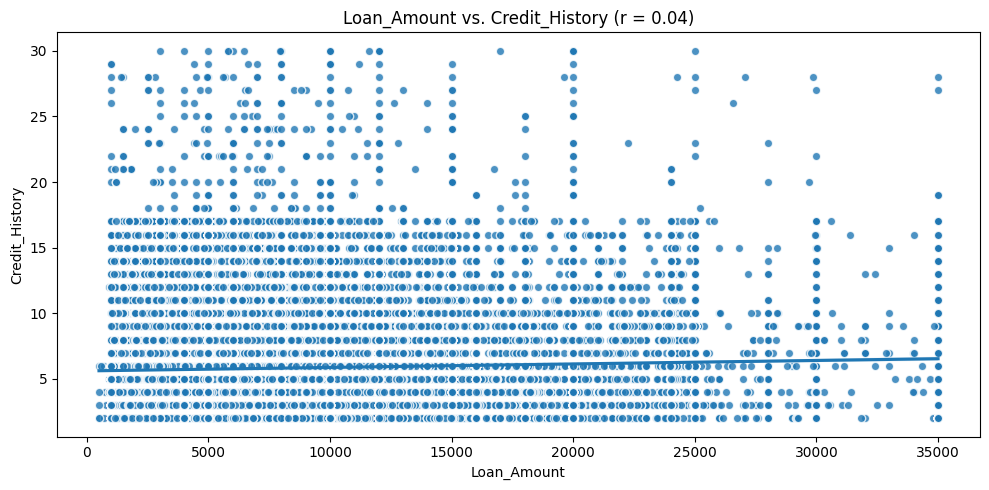

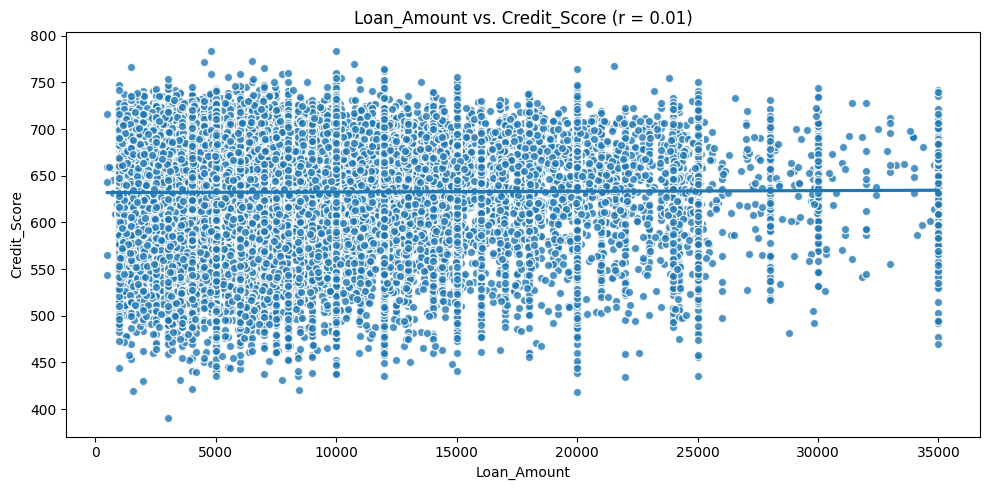

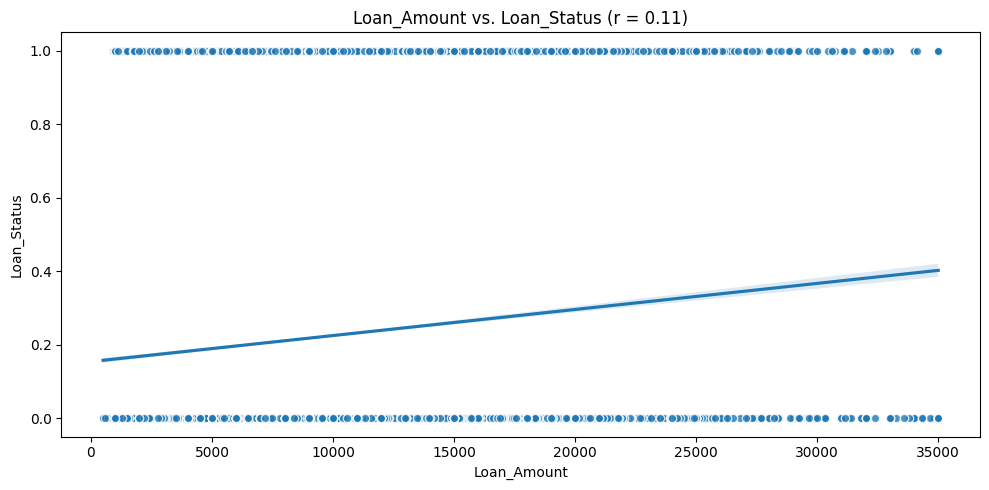

In [ ]:
for col in df.select_dtypes(include='number').columns.drop('Loan_Amount'):
  plot_numeric_vs_target(df,'Loan_Amount',col ,figsize=(10,5), target_type='reg');

### Loan Purpose

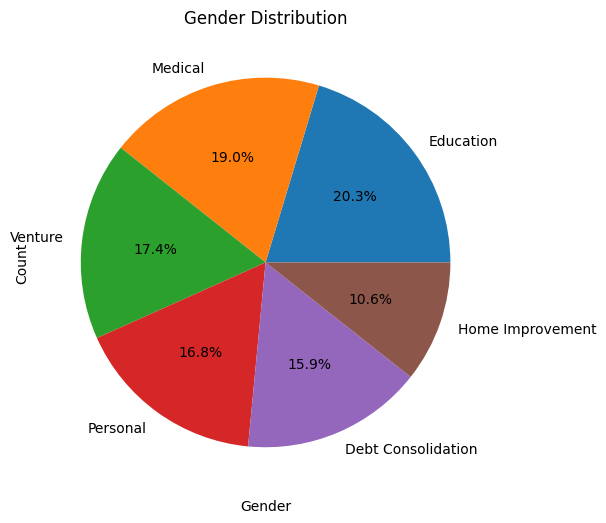

In [ ]:
gender_counts = df['Loan_Purpose'].value_counts()
gender_percentages = df['Loan_Purpose'].value_counts(normalize=True) * 100

fig, ax = plt.subplots(figsize=(8, 6))

wedges, texts, autotexts = ax.pie(gender_counts.values, labels=gender_counts.index, autopct='%1.1f%%')

# Add percentage and count labels inside the bars
for i, wedge in enumerate(wedges):
    x, y = wedge.center
    percentage = gender_percentages.iloc[i]
    count = gender_counts.iloc[i]

ax.set_xlabel("Gender")
ax.set_ylabel("Count")
ax.set_title("Gender Distribution")

plt.show()

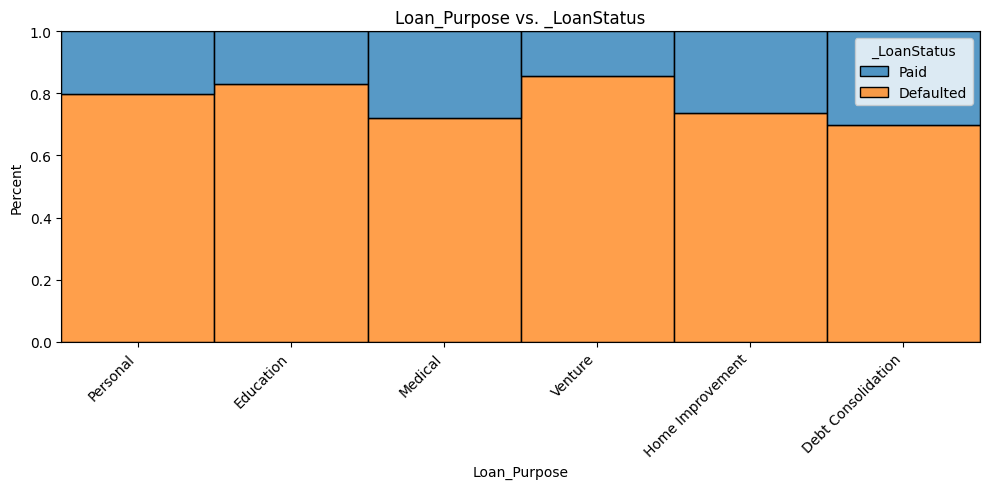

In [ ]:
plot_categorical_vs_target(df,'Loan_Purpose','_LoanStatus' ,figsize=(10,5), target_type='class');

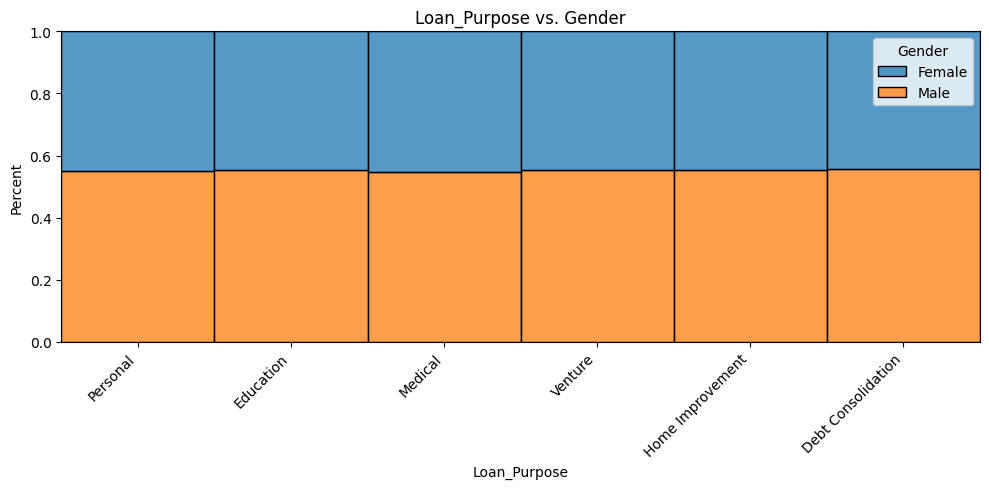

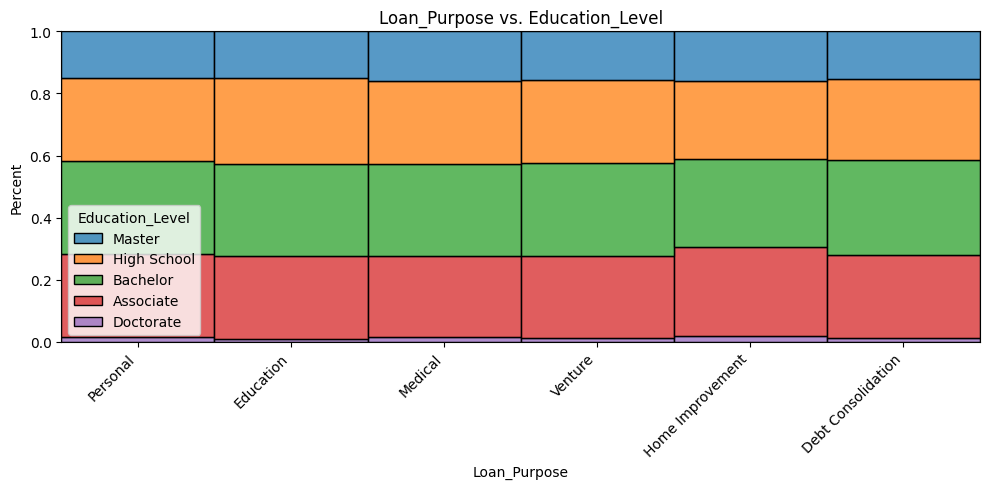

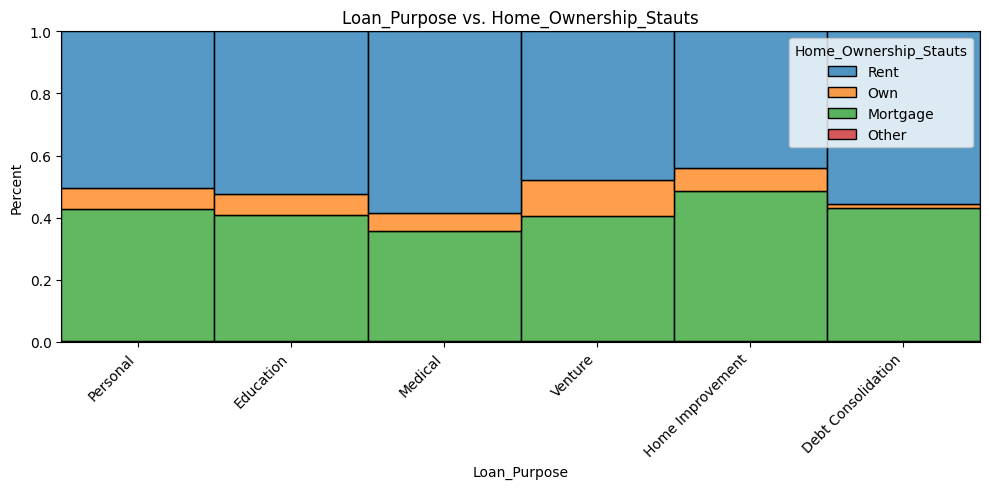

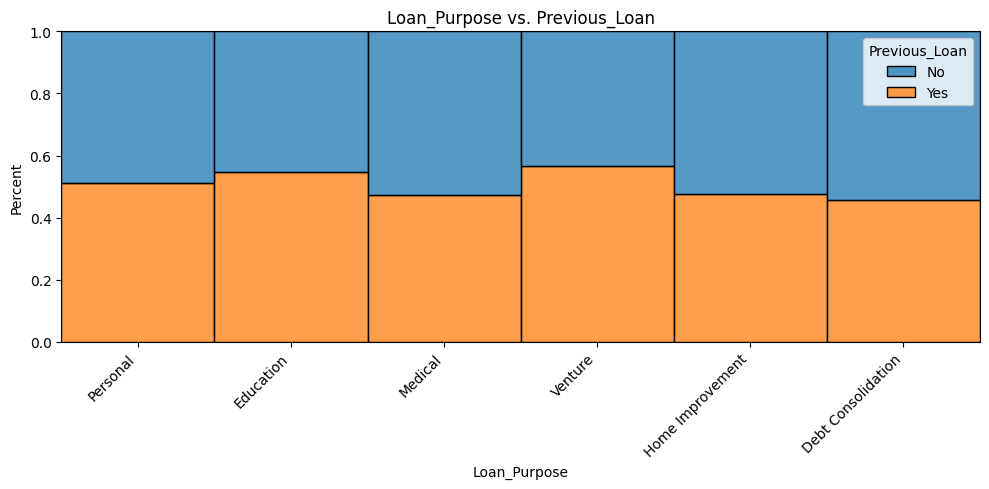

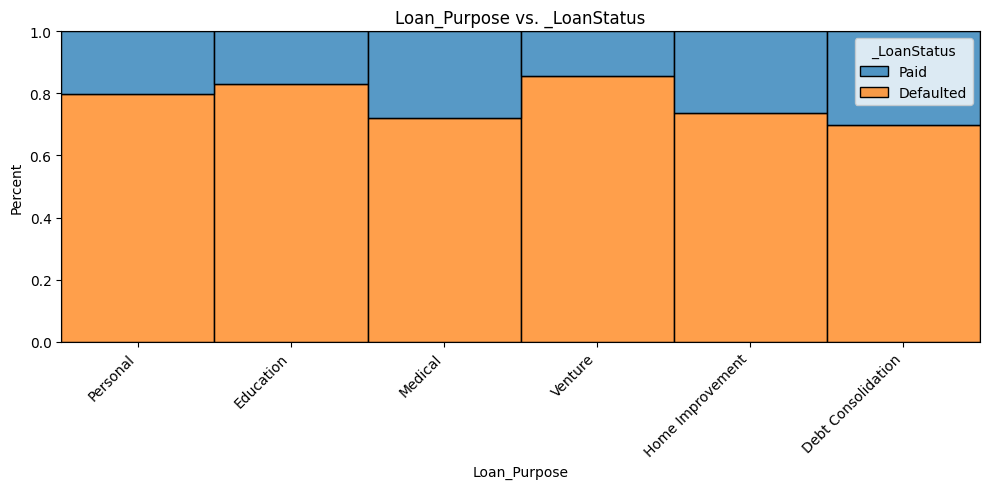

In [ ]:
for col in df.select_dtypes(include='object').columns.drop('Loan_Purpose'):
  plot_categorical_vs_target(df,'Loan_Purpose',col ,figsize=(10,5), target_type='class',status='percent');

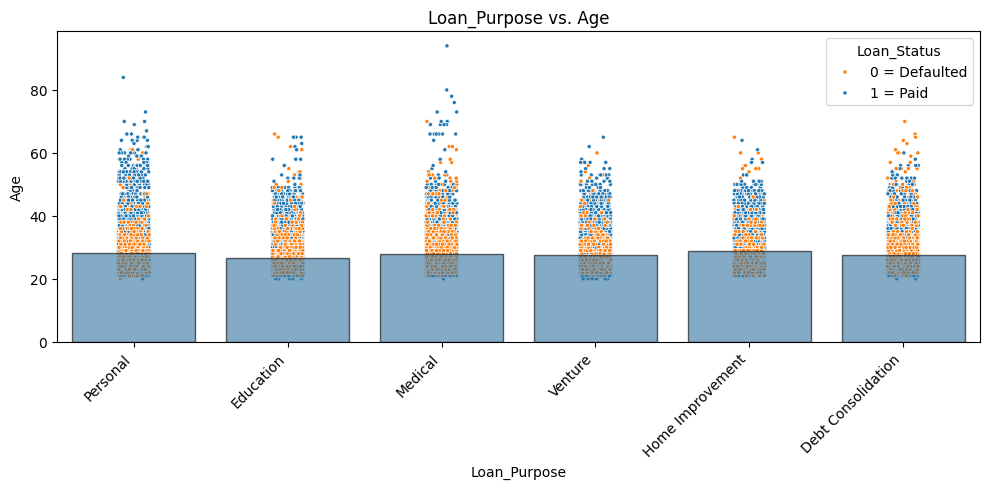

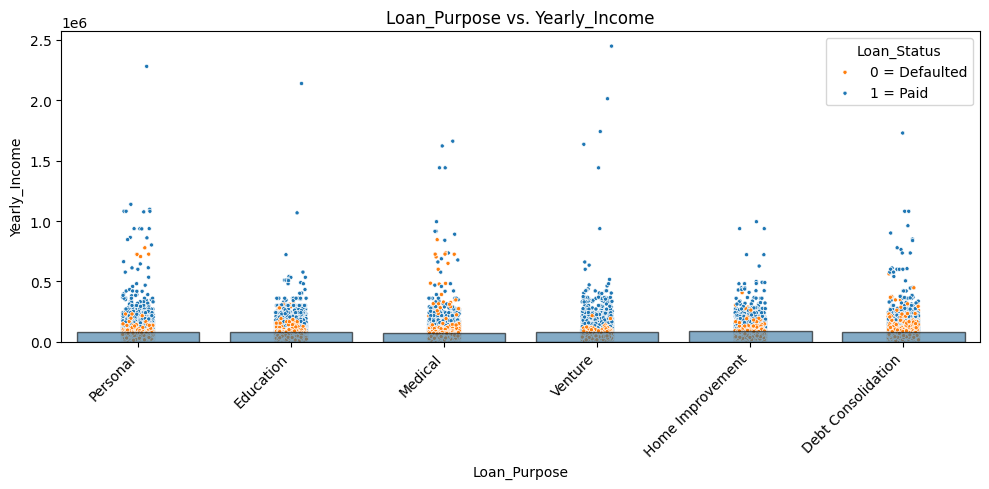

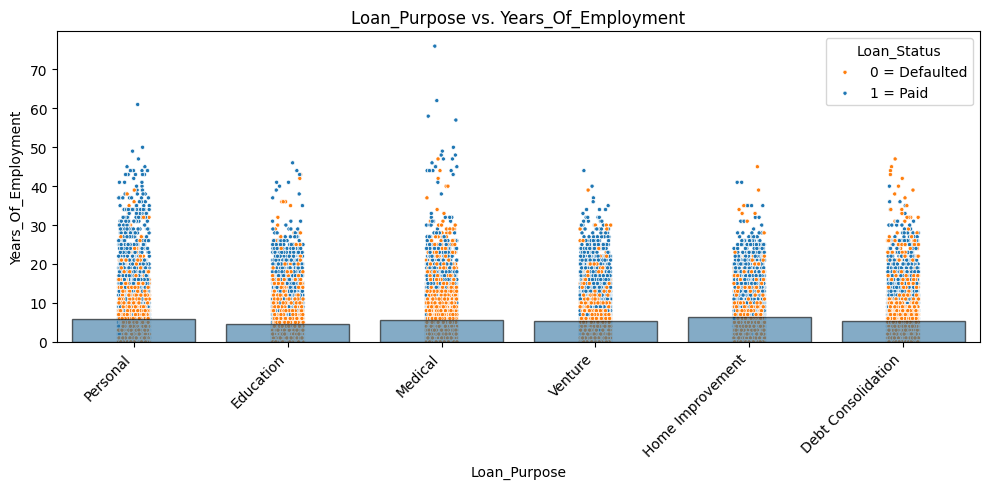

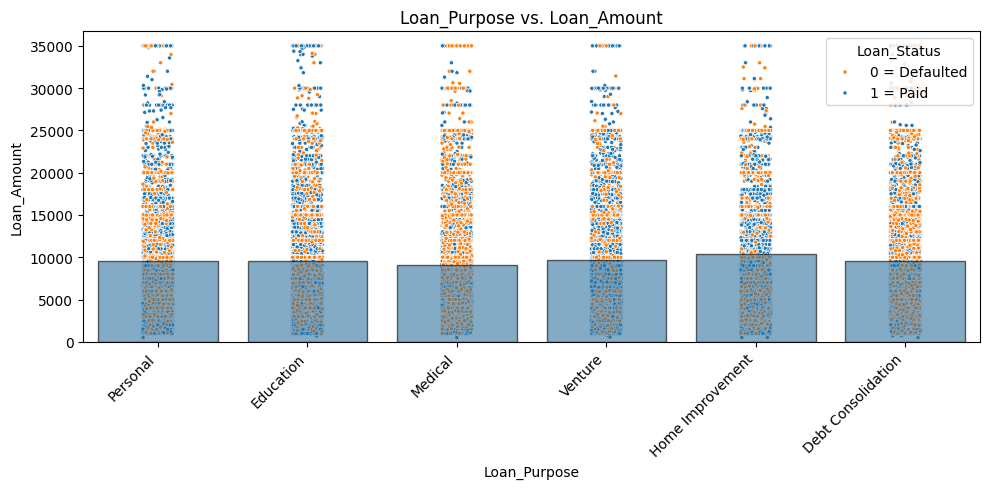

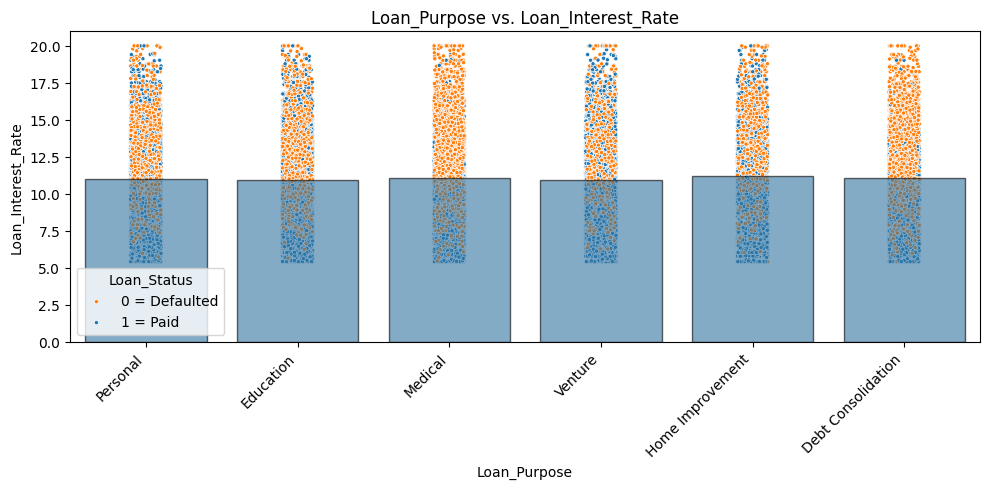

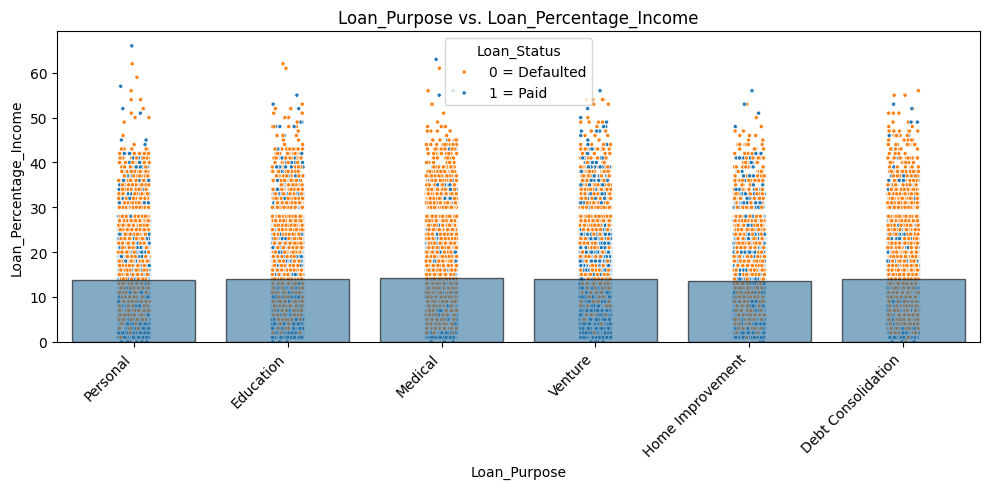

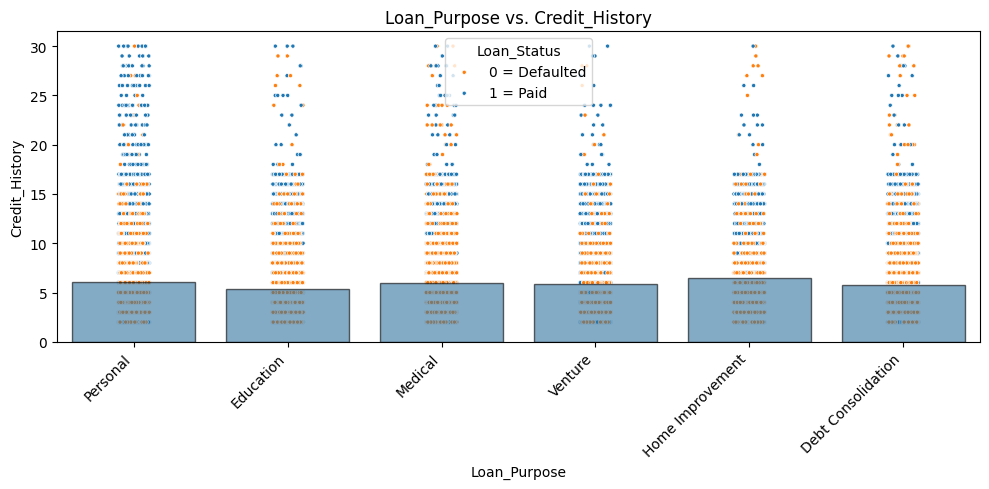

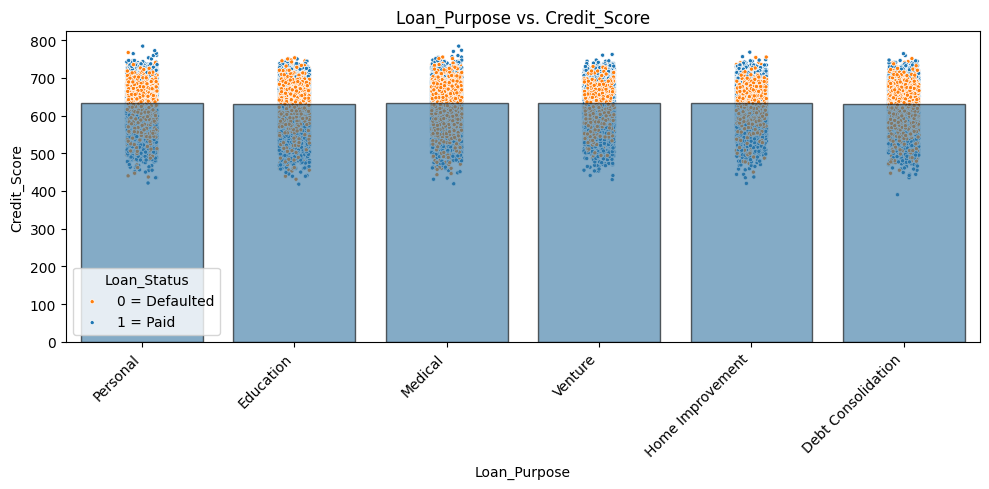

In [ ]:
for col in df.select_dtypes(include='number').columns.drop('Loan_Status'):
  plot_categorical_vs_target(df,'Loan_Purpose',col ,figsize=(10,5), target_type='reg',status='percent',hue='Loan_Status');
  plt.legend(title='Loan_Status', labels=['0 = Defaulted', '1 = Paid'])

### Loan Interest Rate

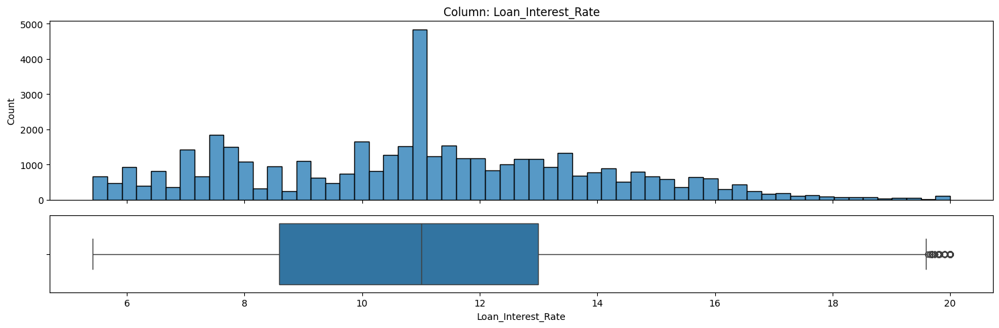

- NaN's Found: 0 (0.0%)


In [ ]:
explore_numeric(df,'Loan_Interest_Rate',figsize=(15,5))

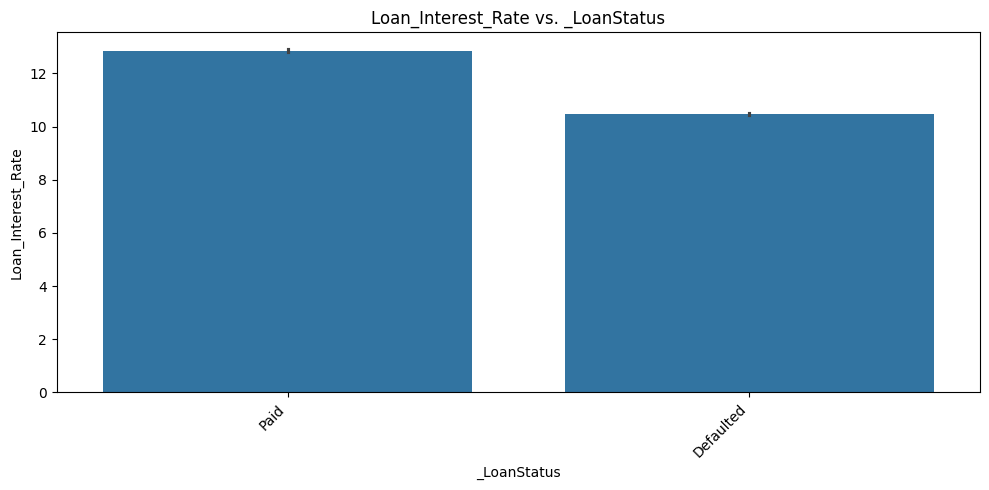

In [ ]:
plot_numeric_vs_target(df,'Loan_Interest_Rate','_LoanStatus' ,figsize=(10,5), target_type='class', estimator='mean',errorbar='ci',sorted=False,ascending=False);

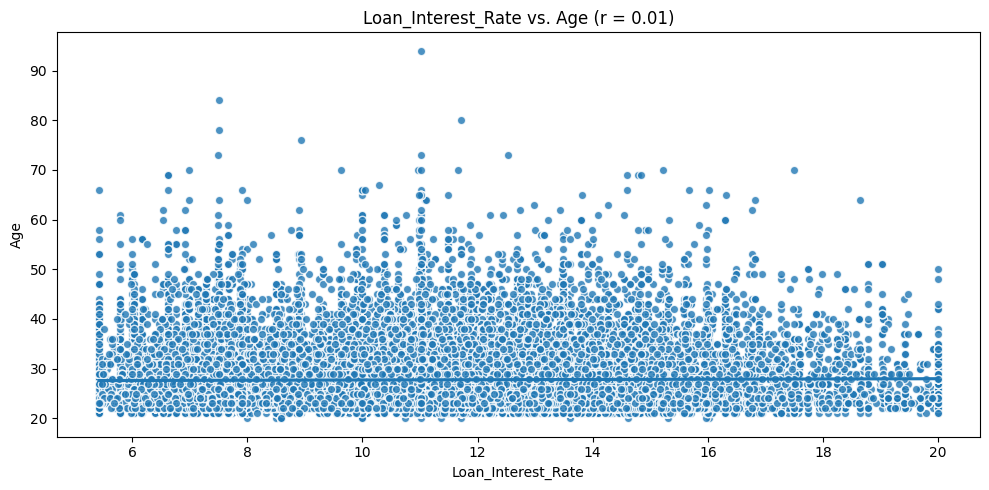

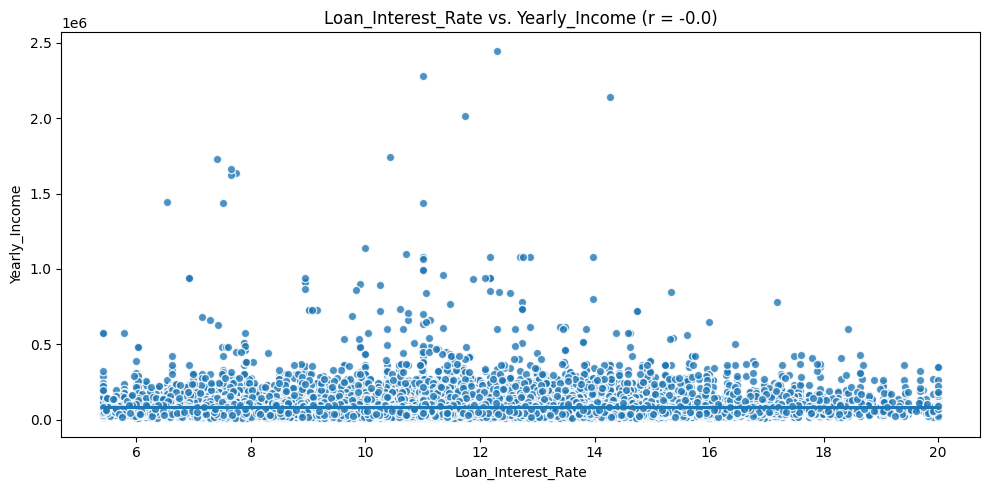

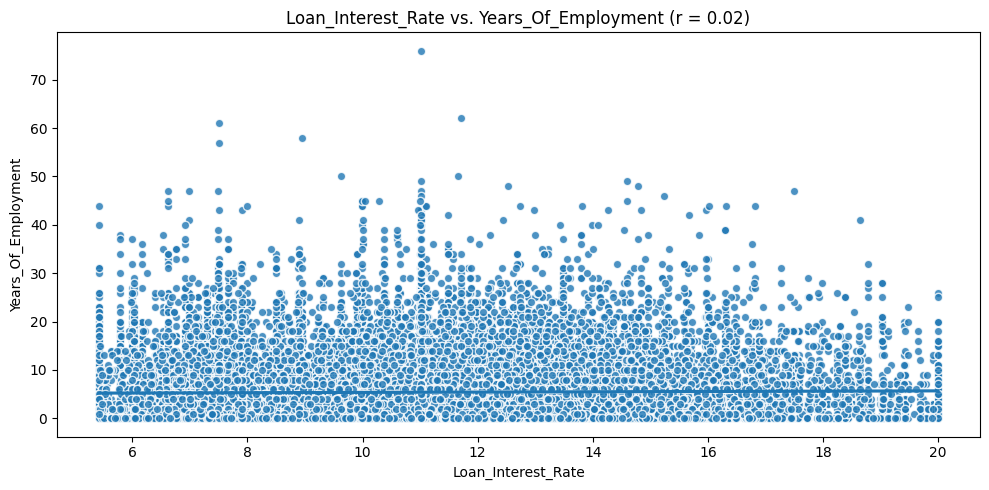

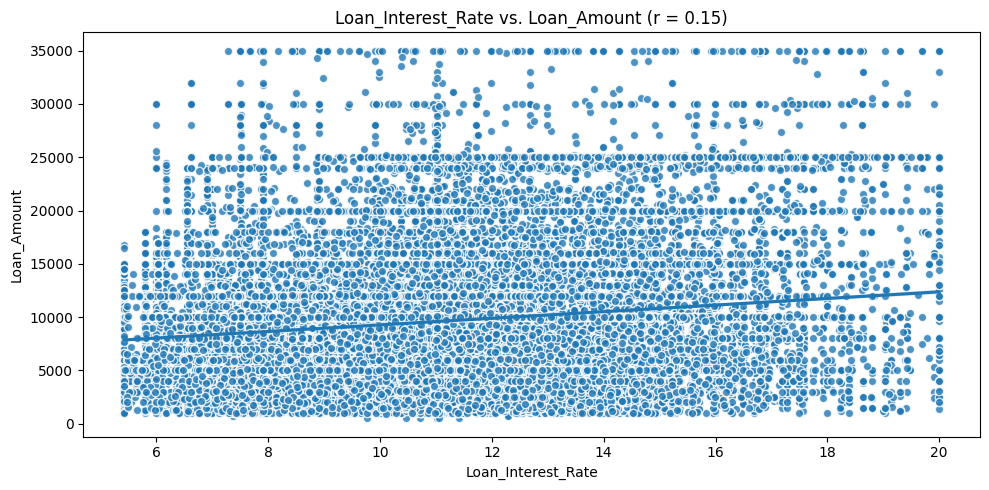

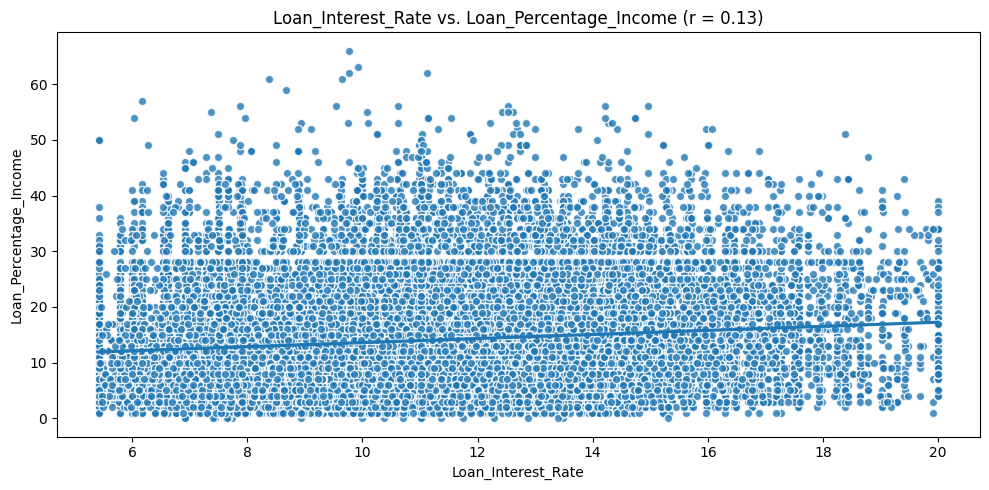

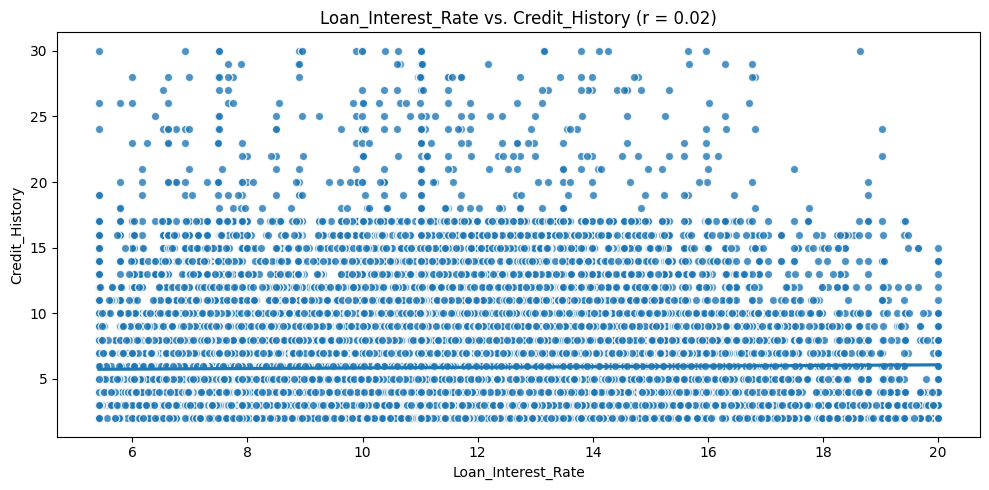

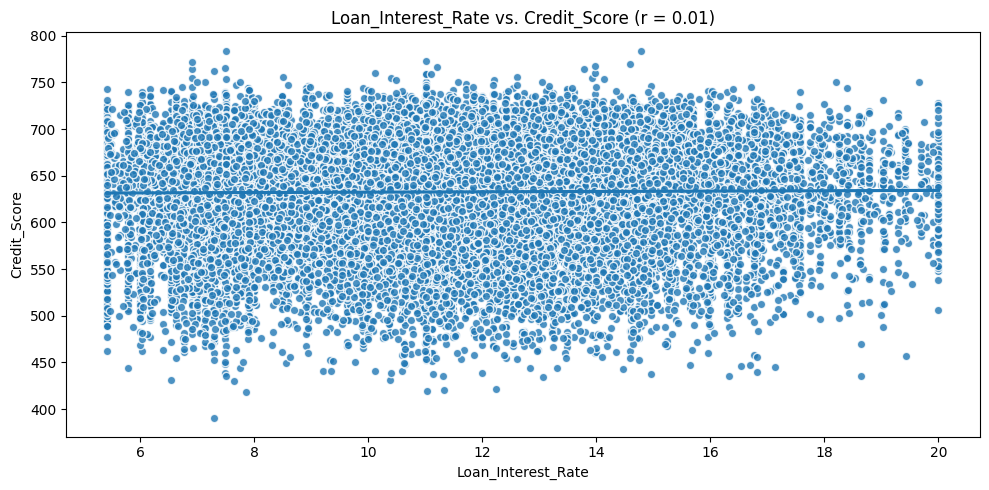

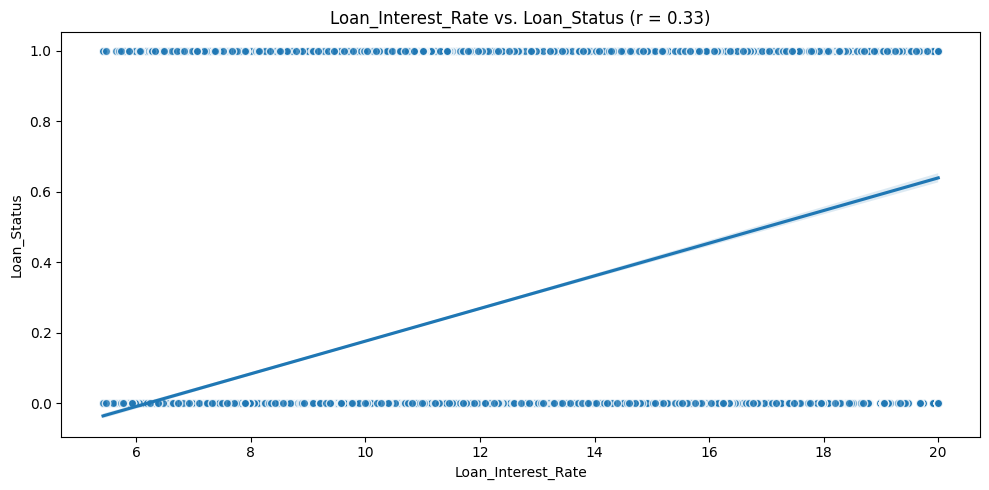

In [ ]:
for col in df.select_dtypes(include='number').columns.drop('Loan_Interest_Rate'):
  plot_numeric_vs_target(df,'Loan_Interest_Rate',col ,figsize=(10,5), target_type='reg');

### Loan Percentage Income

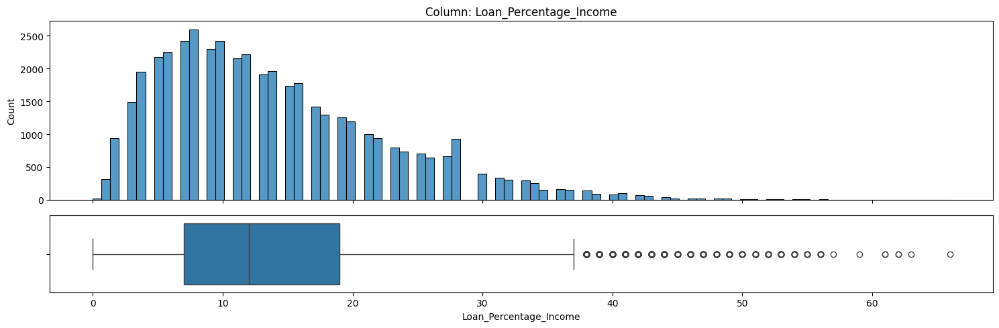

- NaN's Found: 0 (0.0%)


In [ ]:
explore_numeric(df,'Loan_Percentage_Income',figsize=(15,5))

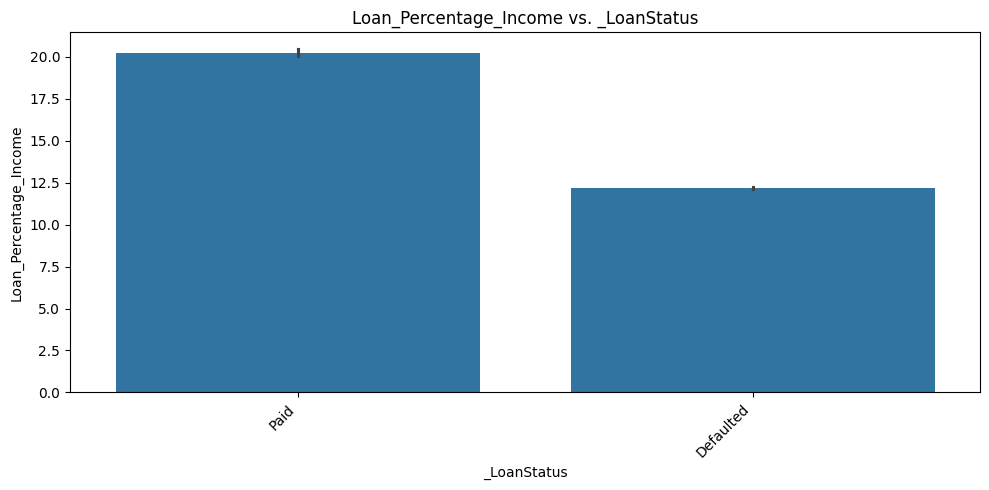

In [ ]:
plot_numeric_vs_target(df,'Loan_Percentage_Income','_LoanStatus' ,figsize=(10,5), target_type='class', estimator='mean',errorbar='ci',sorted=False,ascending=False);

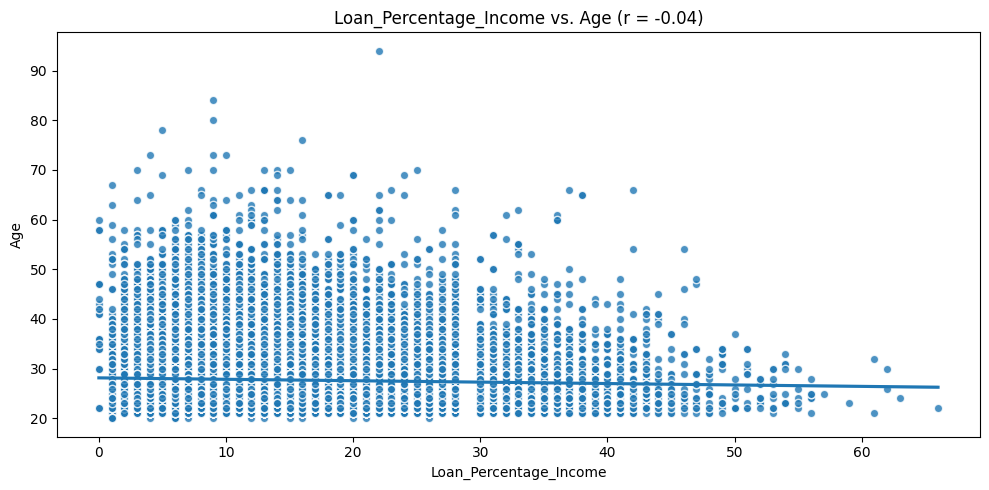

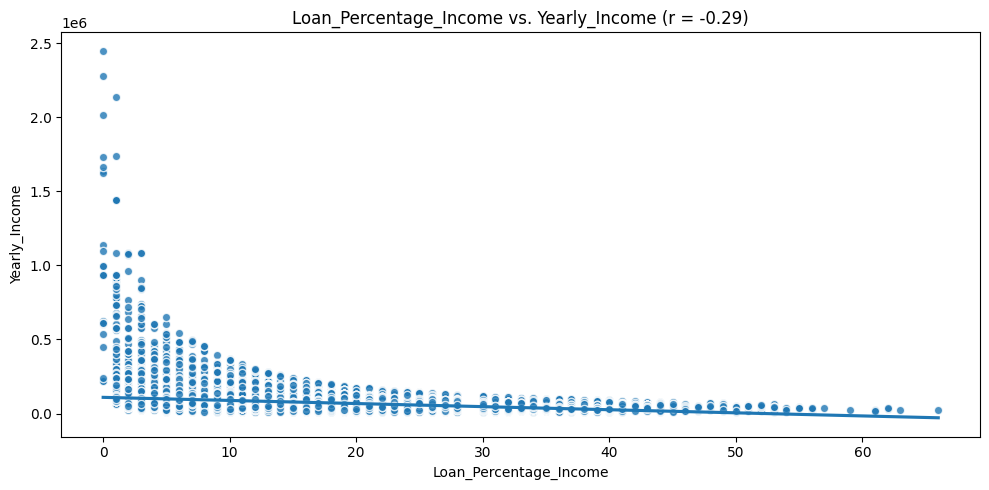

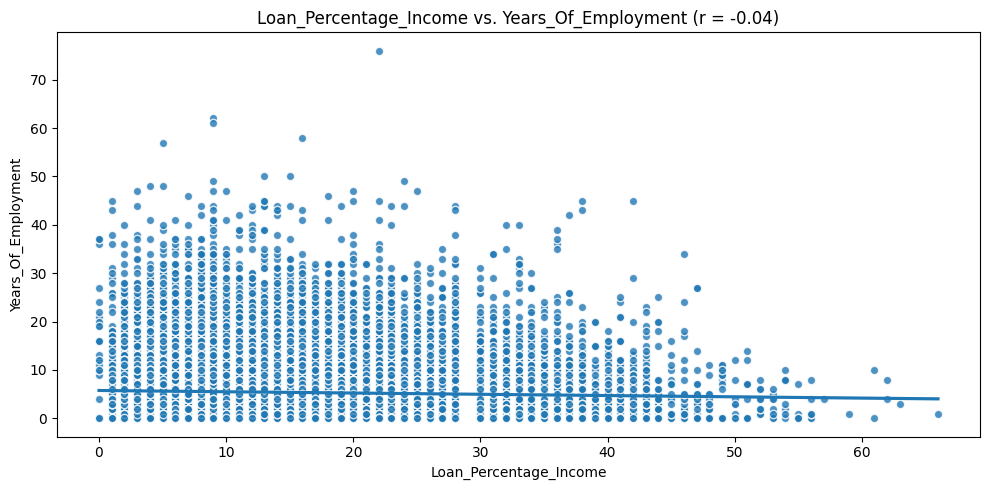

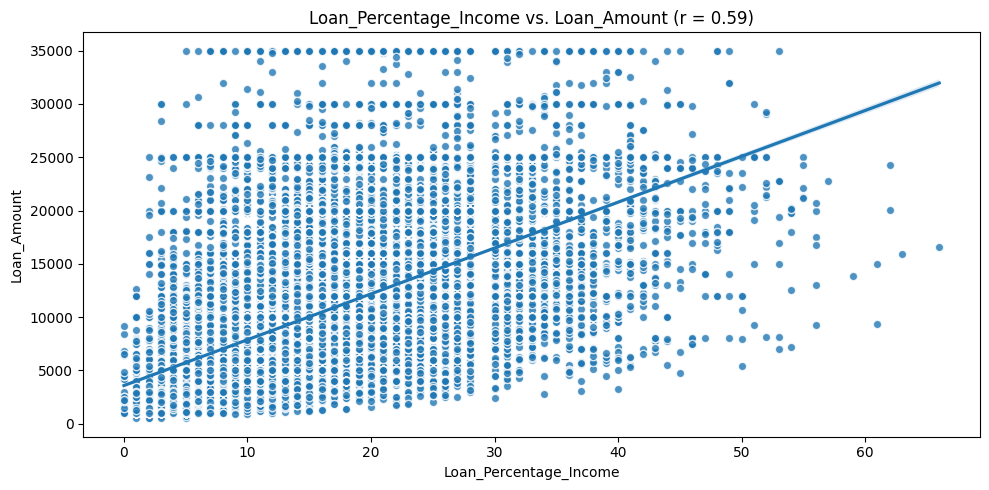

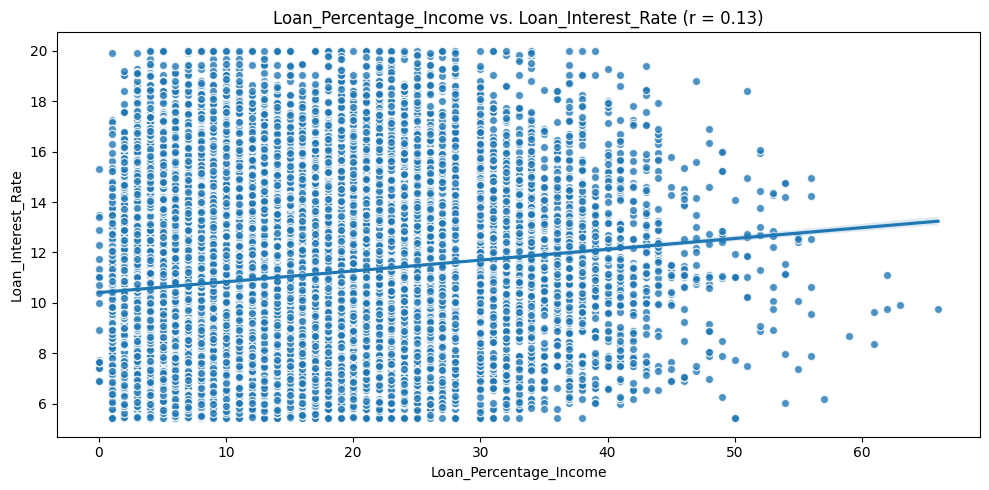

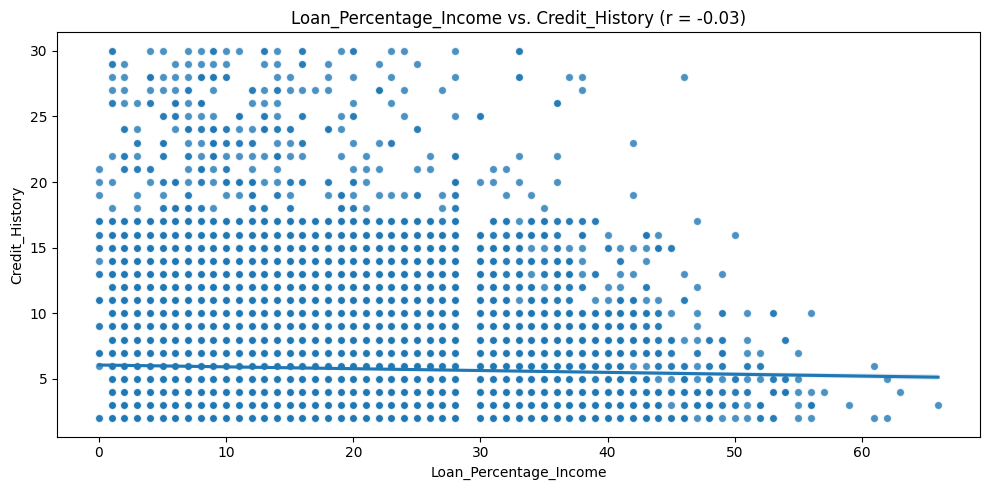

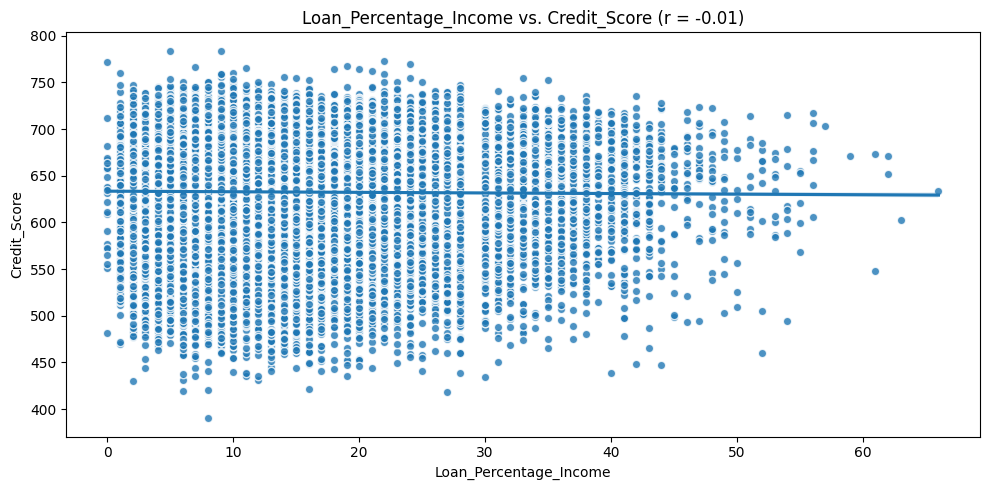

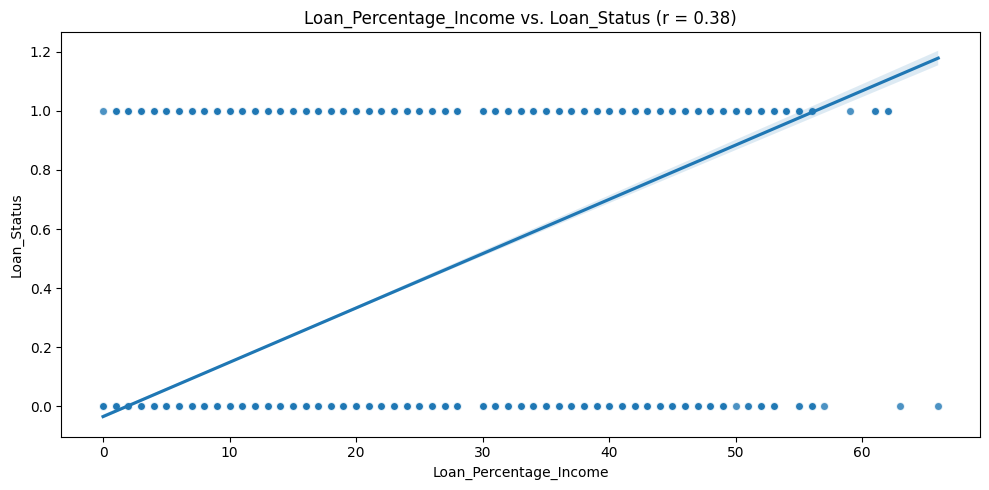

In [ ]:
for col in df.select_dtypes(include='number').columns.drop('Loan_Percentage_Income'):
  plot_numeric_vs_target(df,'Loan_Percentage_Income',col ,figsize=(10,5), target_type='reg');

### Credit History

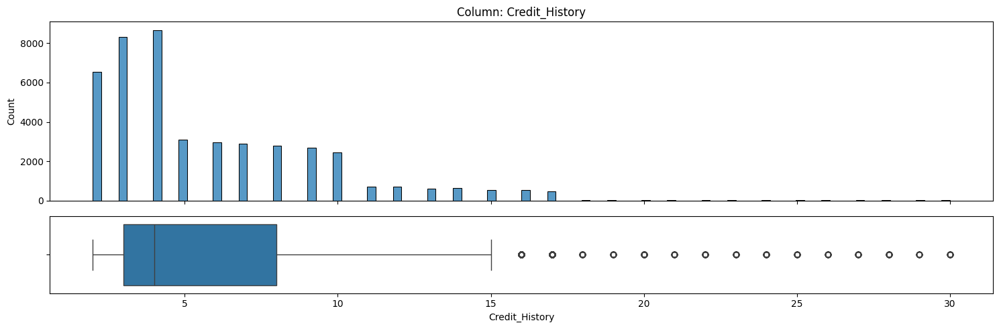

- NaN's Found: 0 (0.0%)


In [ ]:
explore_numeric(df,'Credit_History',figsize=(15,5))

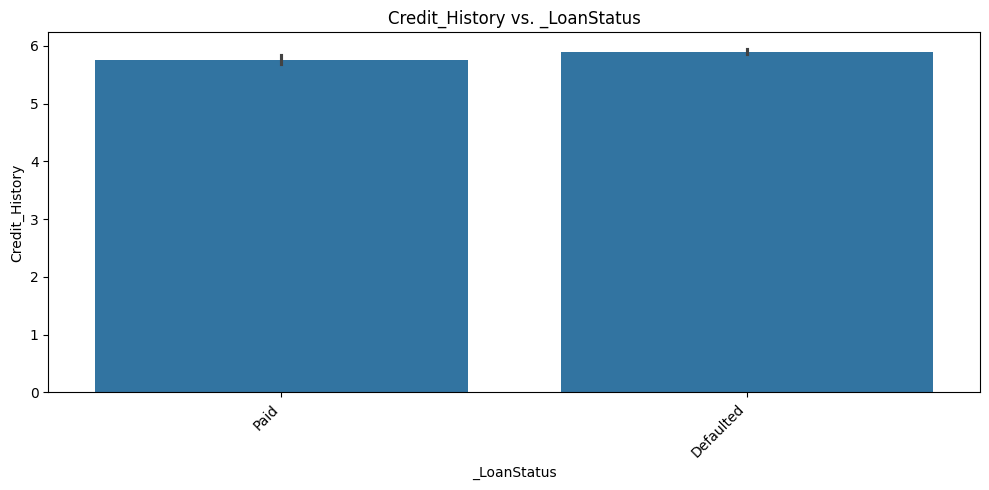

In [ ]:
plot_numeric_vs_target(df,'Credit_History','_LoanStatus' ,figsize=(10,5), target_type='class', estimator='mean',errorbar='ci',sorted=False,ascending=False);

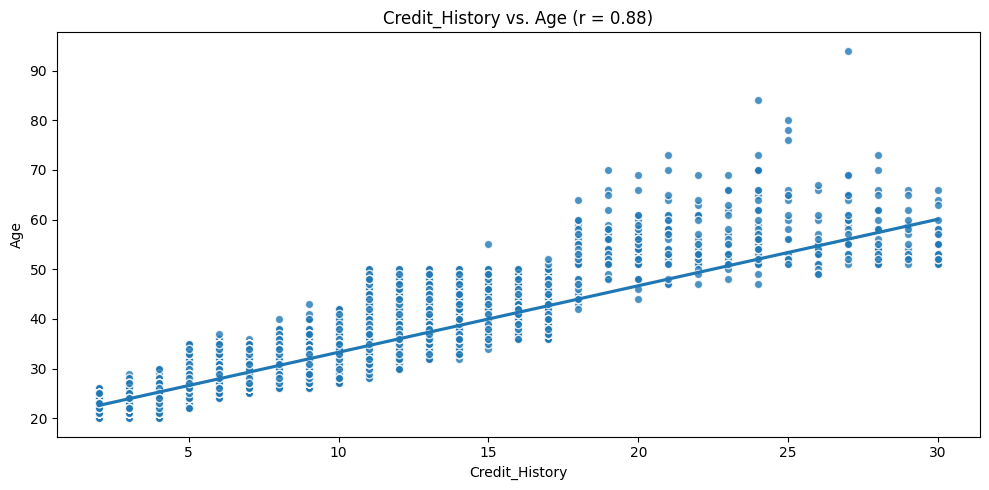

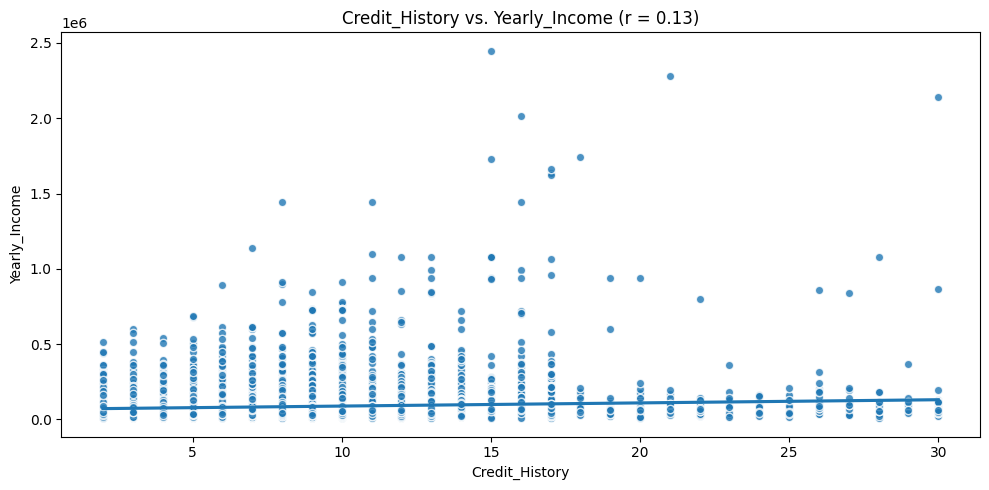

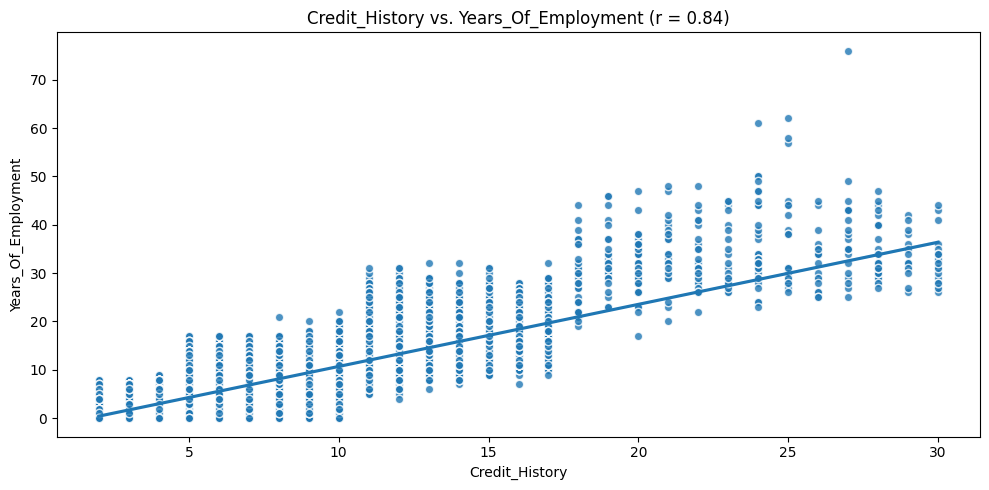

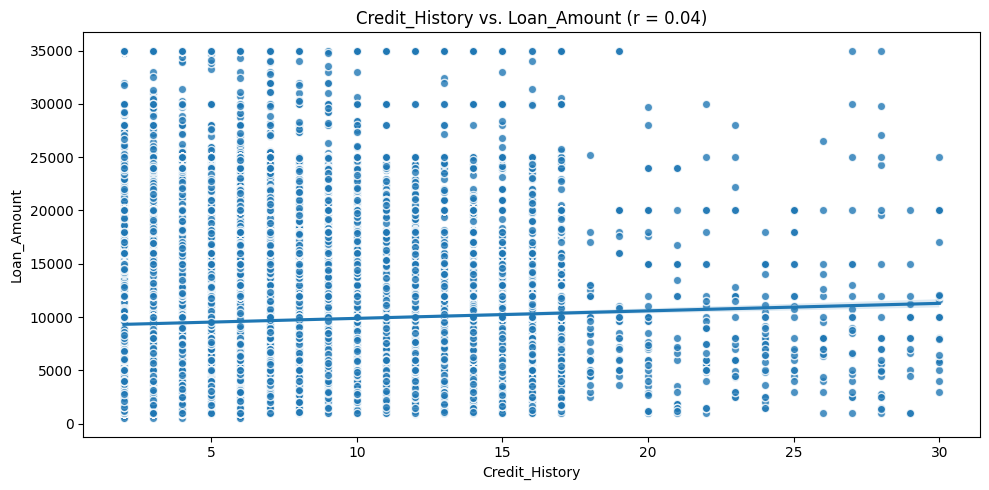

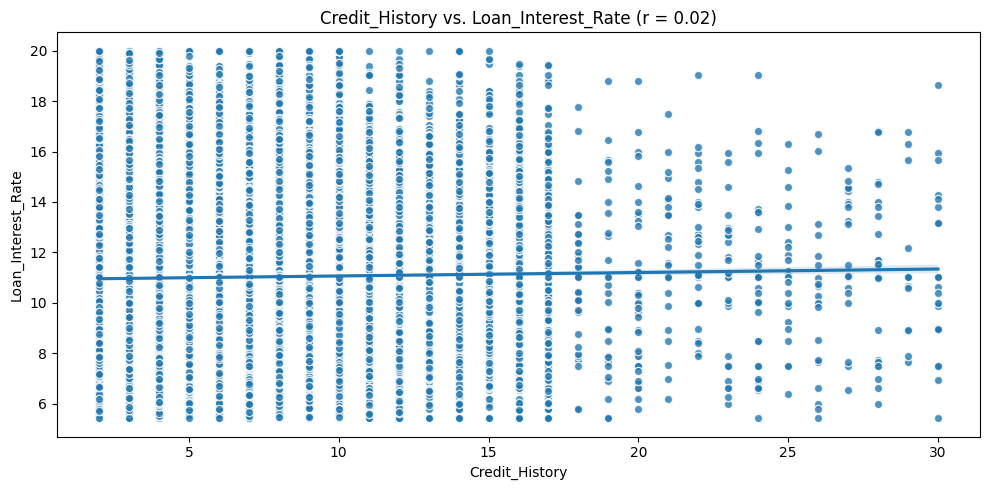

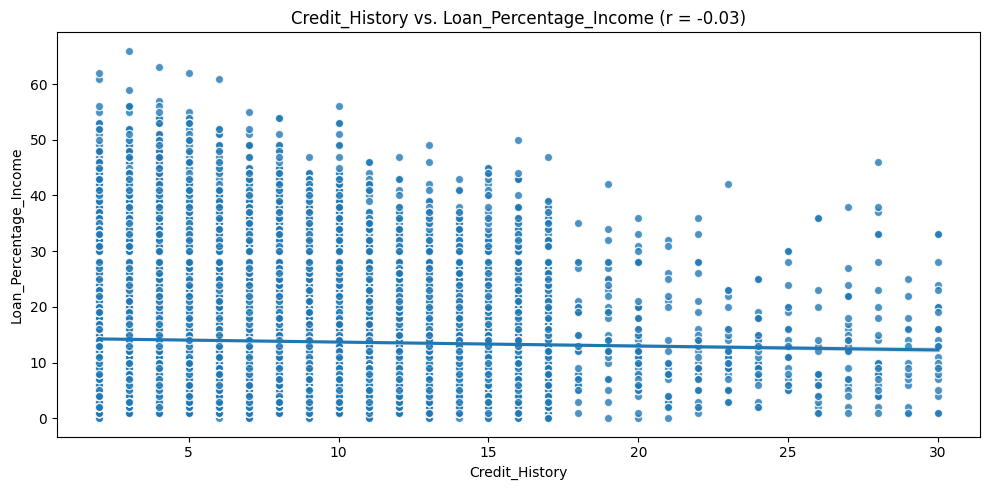

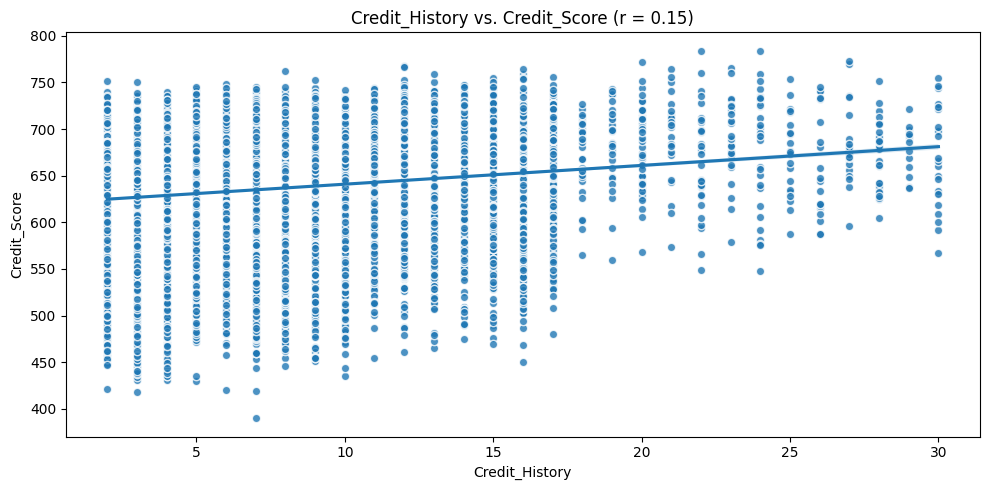

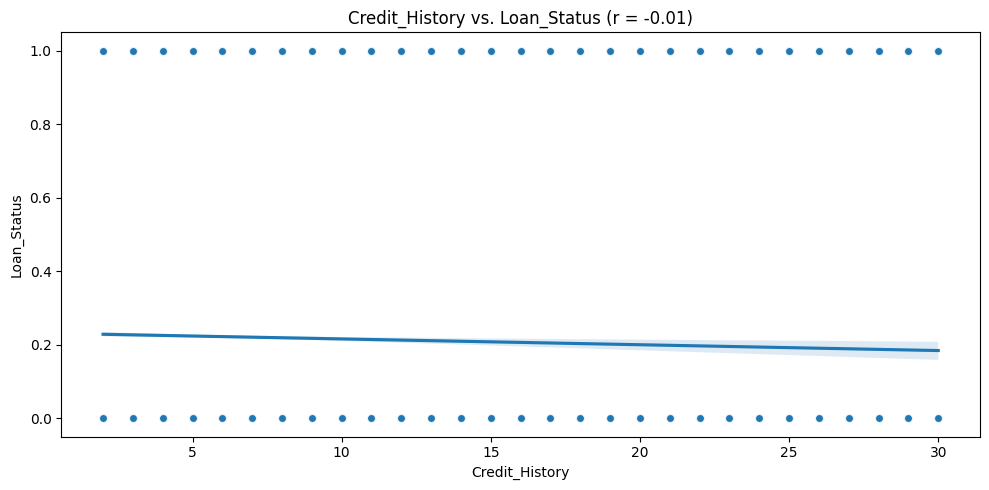

In [ ]:
for col in df.select_dtypes(include='number').columns.drop('Credit_History'):
  plot_numeric_vs_target(df,'Credit_History',col ,figsize=(10,5), target_type='reg');

### Credit Score

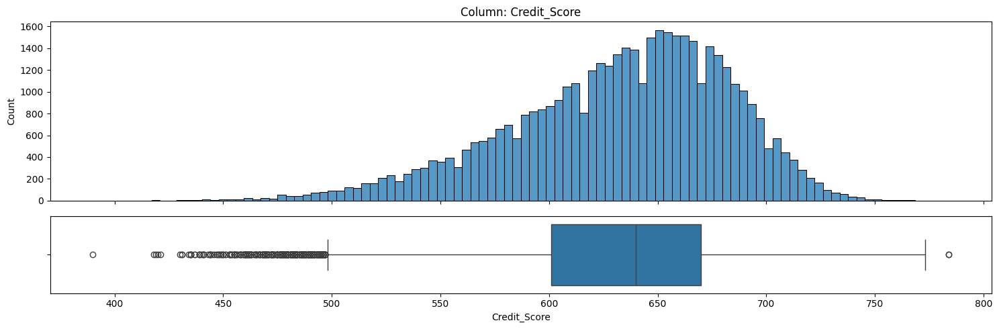

- NaN's Found: 0 (0.0%)


In [ ]:
explore_numeric(df,'Credit_Score',figsize=(15,5))

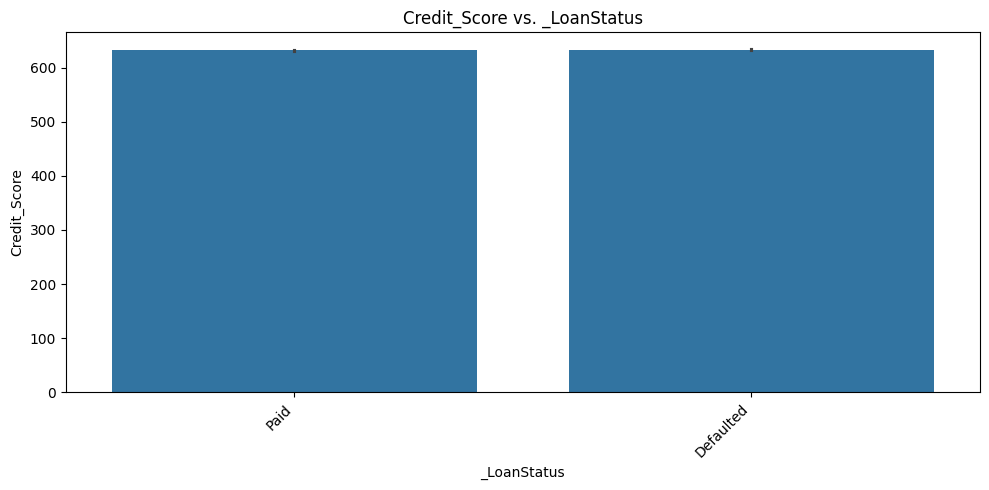

In [ ]:
plot_numeric_vs_target(df,'Credit_Score','_LoanStatus' ,figsize=(10,5), target_type='class', estimator='mean',errorbar='ci',sorted=False,ascending=False);

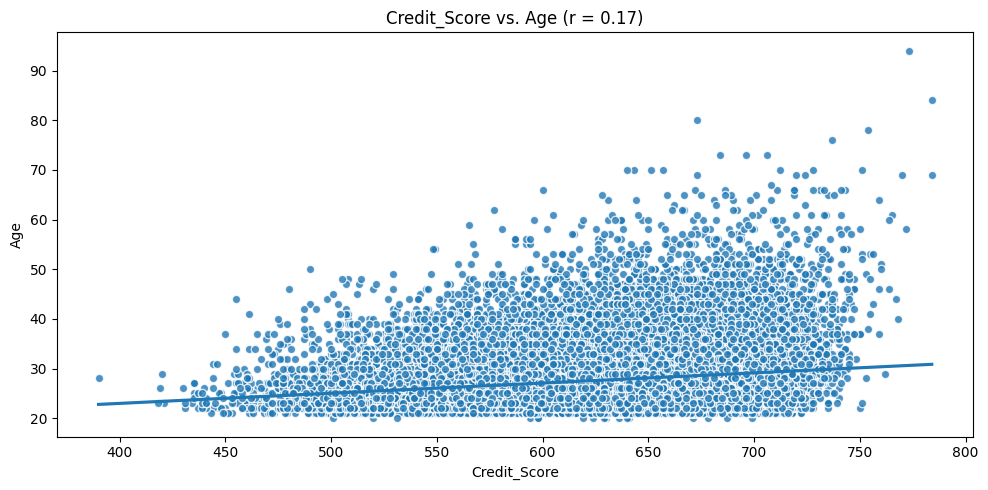

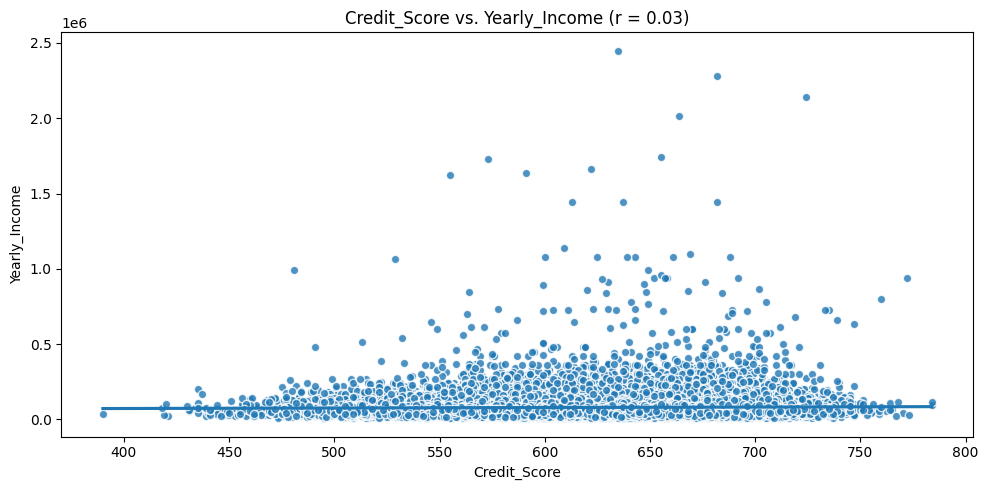

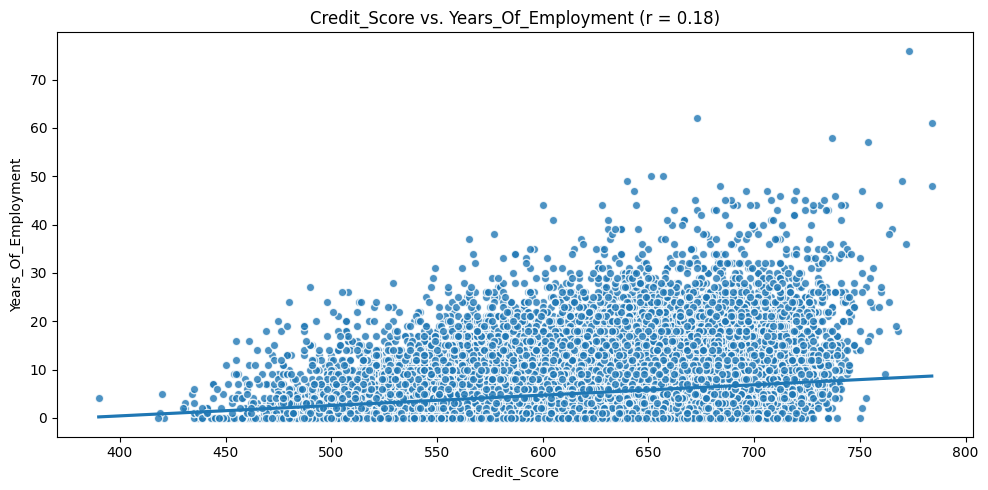

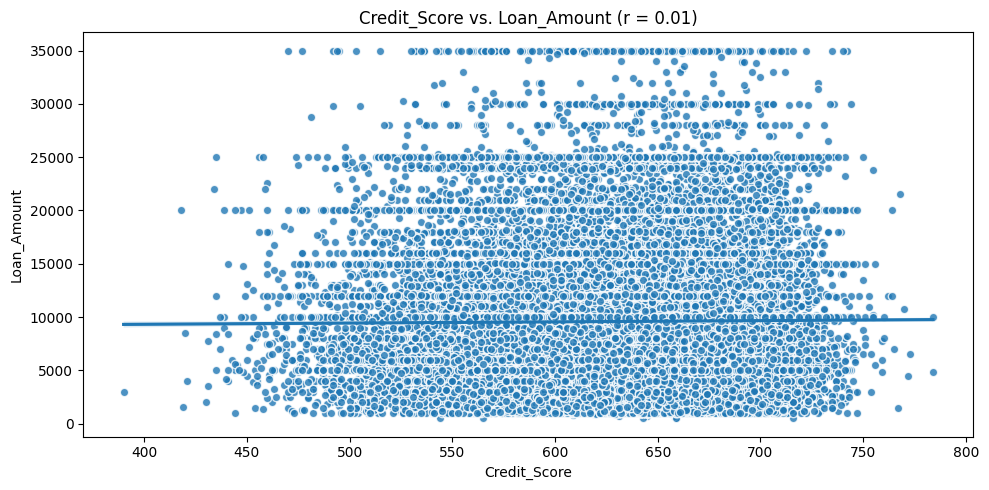

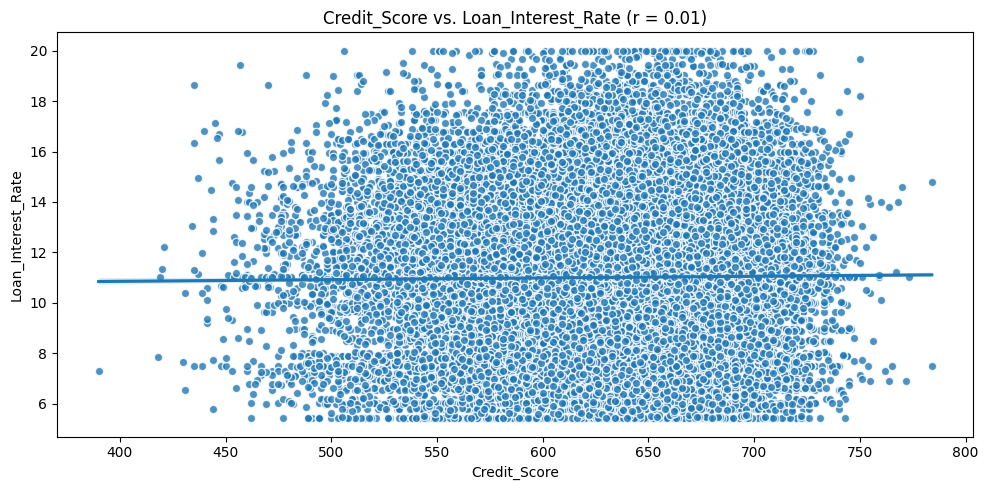

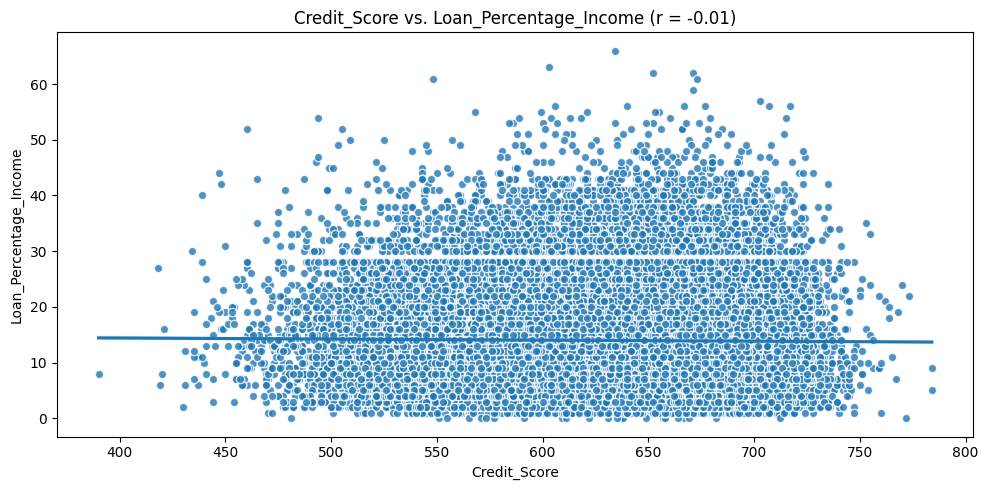

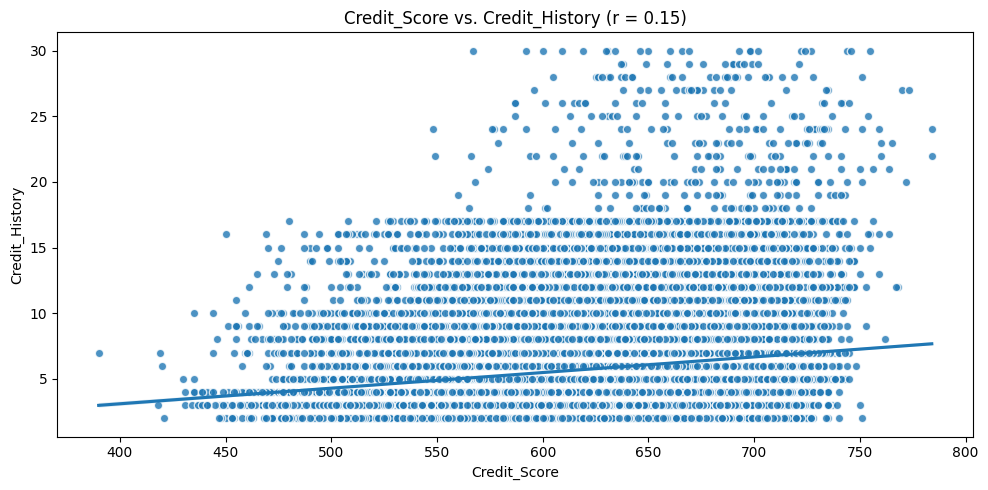

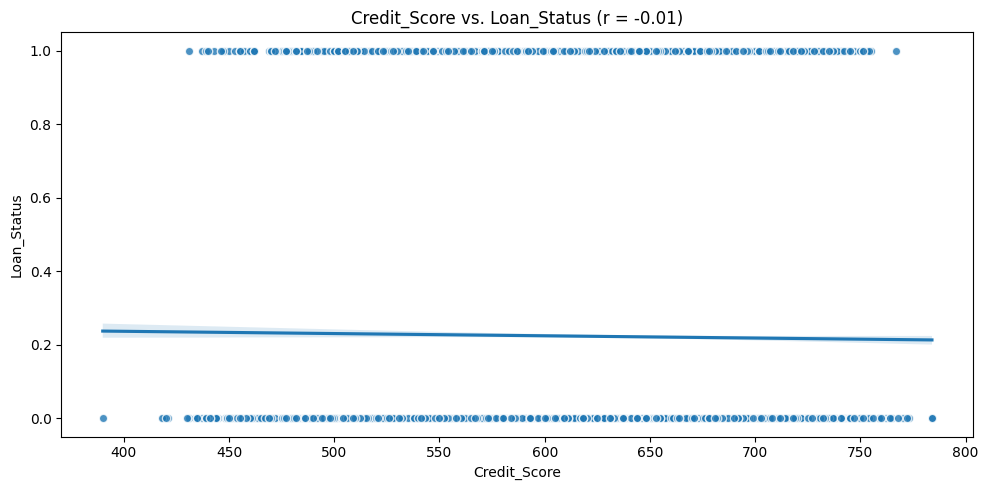

In [ ]:
for col in df.select_dtypes(include='number').columns.drop('Credit_Score'):
  plot_numeric_vs_target(df,'Credit_Score',col ,figsize=(10,5), target_type='reg');

### Previous Loan

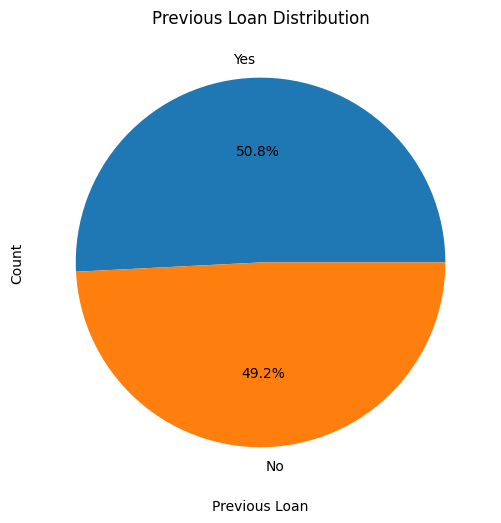

In [ ]:
gender_counts = df['Previous_Loan'].value_counts()
gender_percentages = df['Previous_Loan'].value_counts(normalize=True) * 100

fig, ax = plt.subplots(figsize=(8, 6))

wedges, texts, autotexts = ax.pie(gender_counts.values, labels=gender_counts.index, autopct='%1.1f%%')

# Add percentage and count labels inside the bars
for i, wedge in enumerate(wedges):
    x, y = wedge.center
    percentage = gender_percentages.iloc[i]
    count = gender_counts.iloc[i]

ax.set_xlabel("Previous Loan")
ax.set_ylabel("Count")
ax.set_title("Previous Loan Distribution")

plt.show()

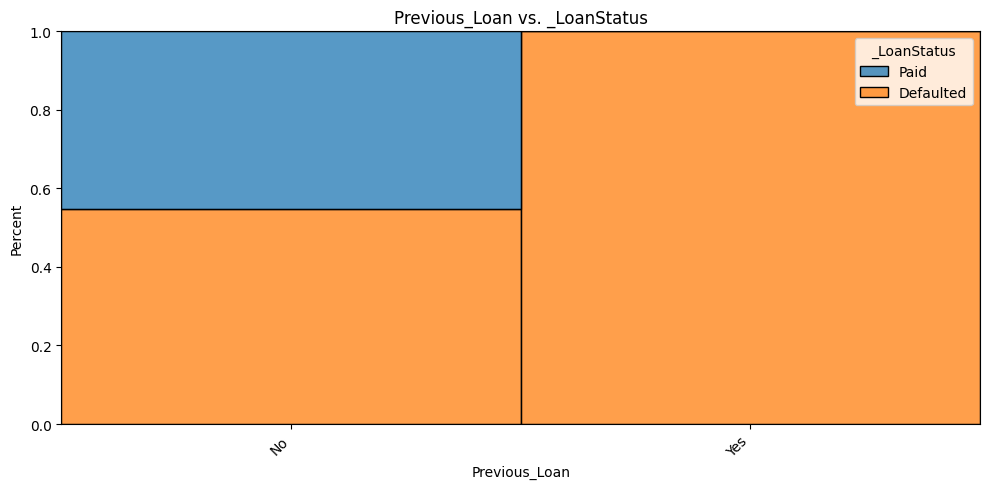

In [ ]:
plot_categorical_vs_target(df,'Previous_Loan','_LoanStatus' ,figsize=(10,5), target_type='class');

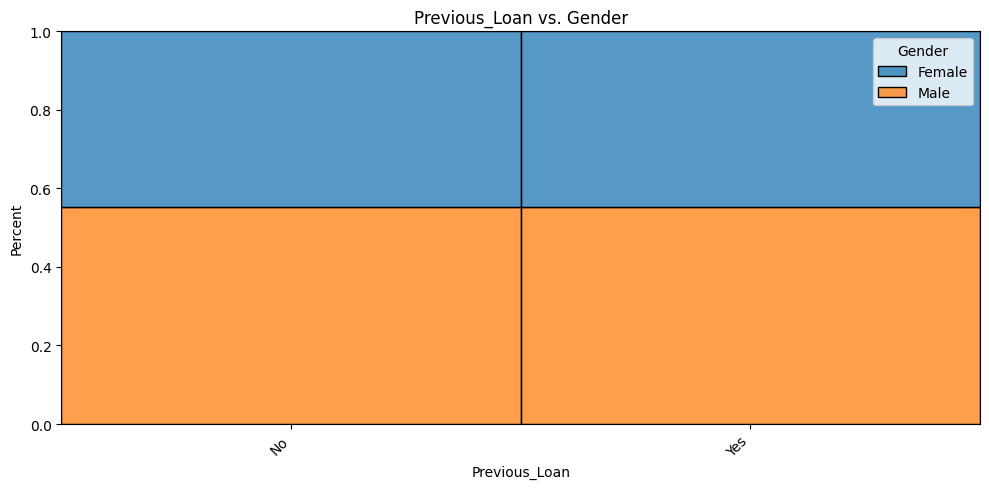

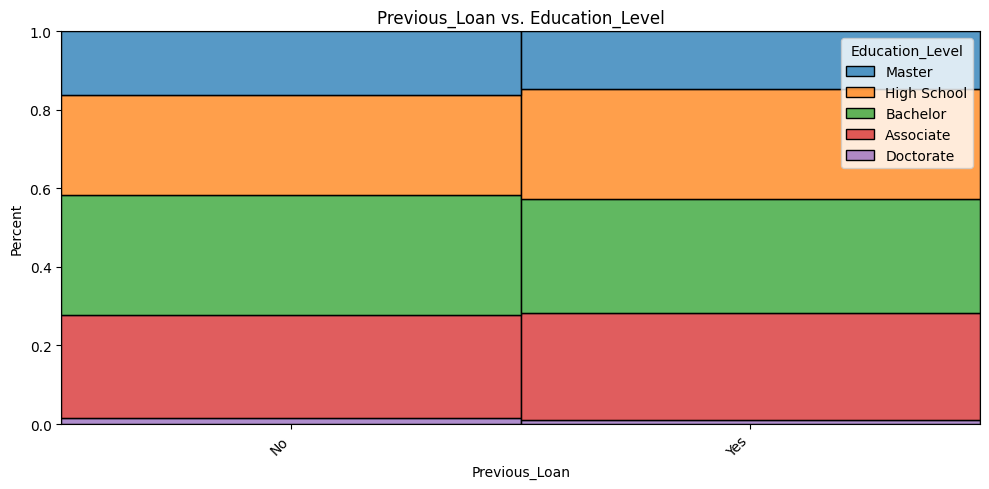

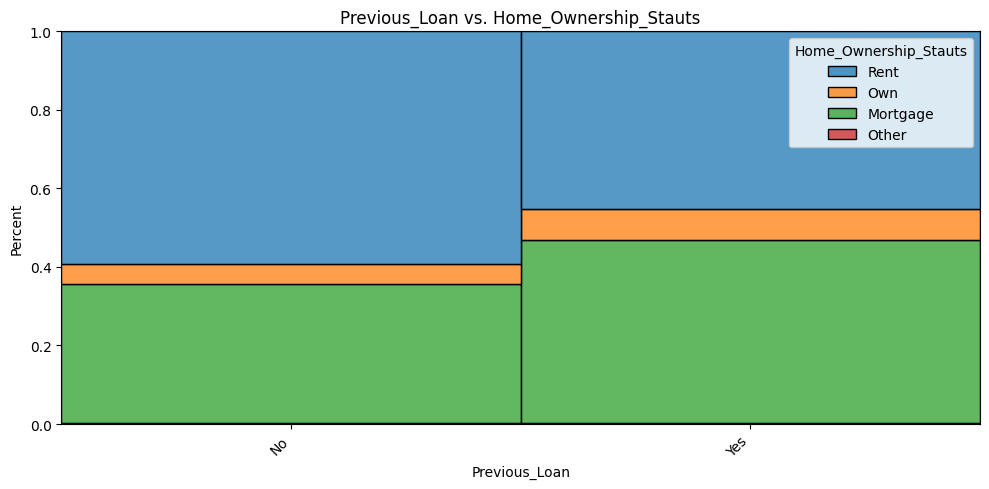

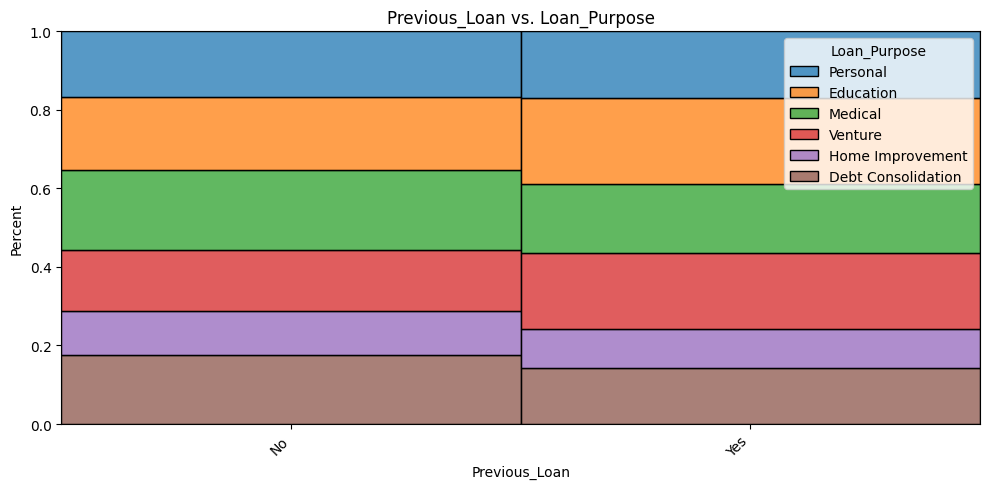

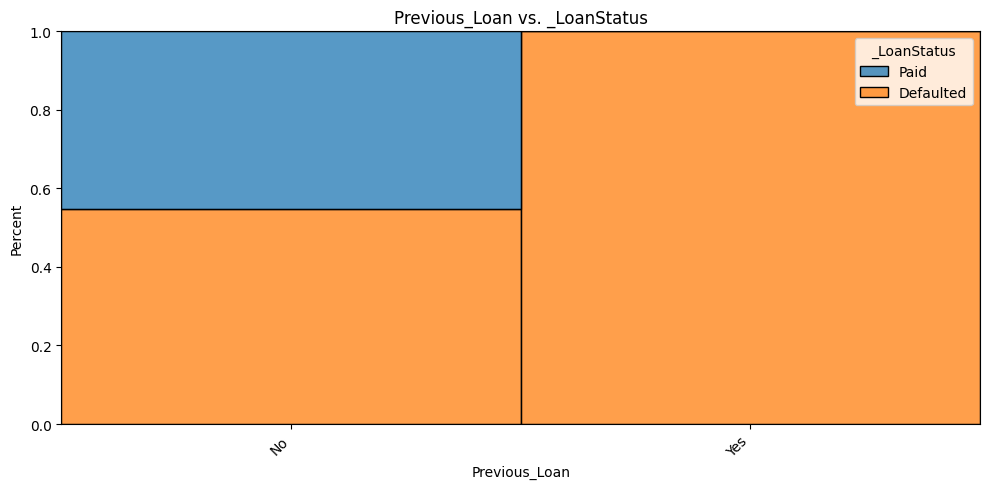

In [ ]:
for col in df.select_dtypes(include='object').columns.drop('Previous_Loan'):
  plot_categorical_vs_target(df,'Previous_Loan',col ,figsize=(10,5), target_type='class',status='percent');

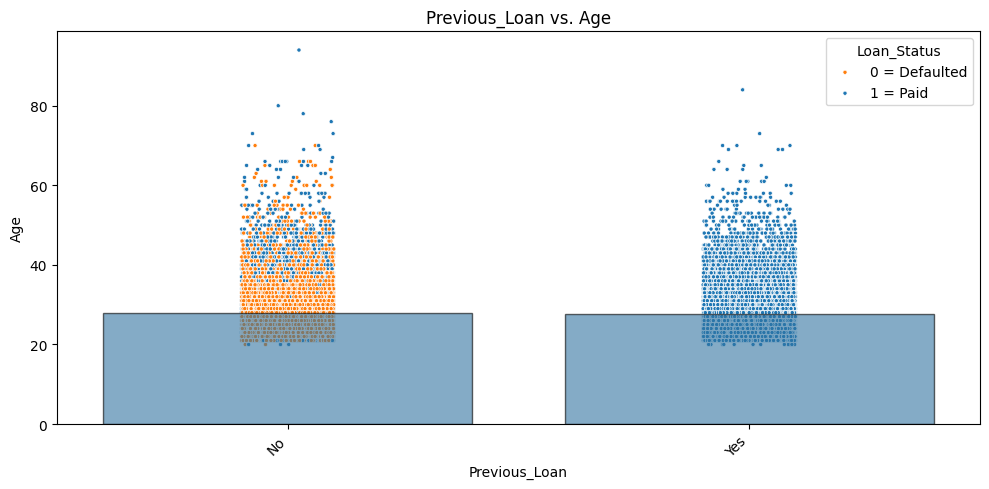

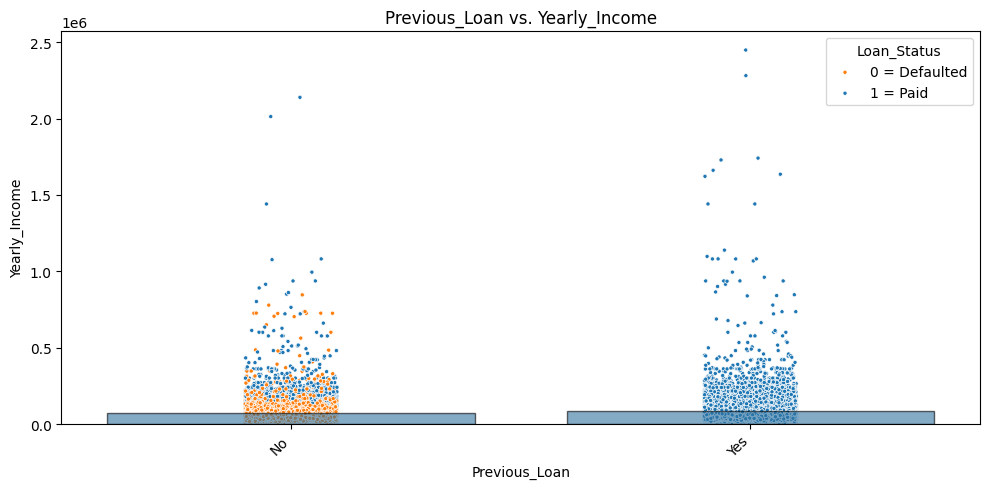

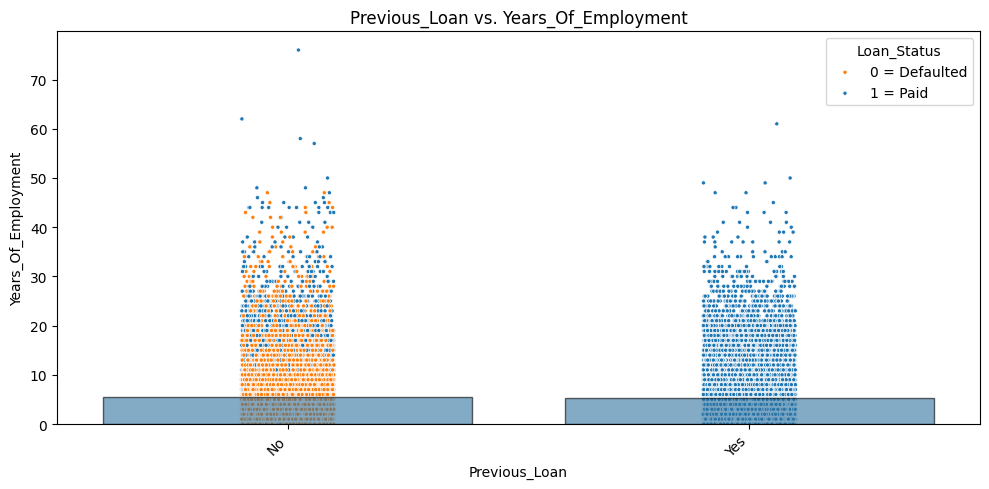

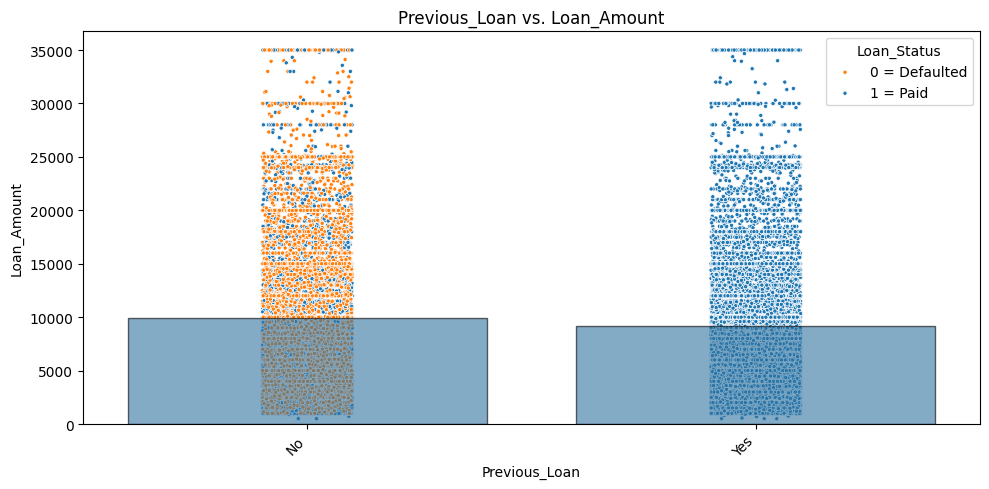

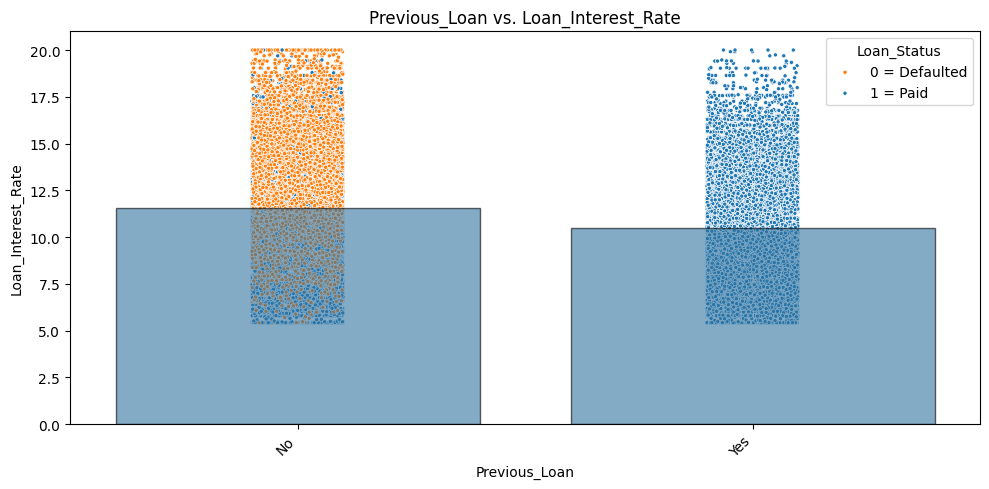

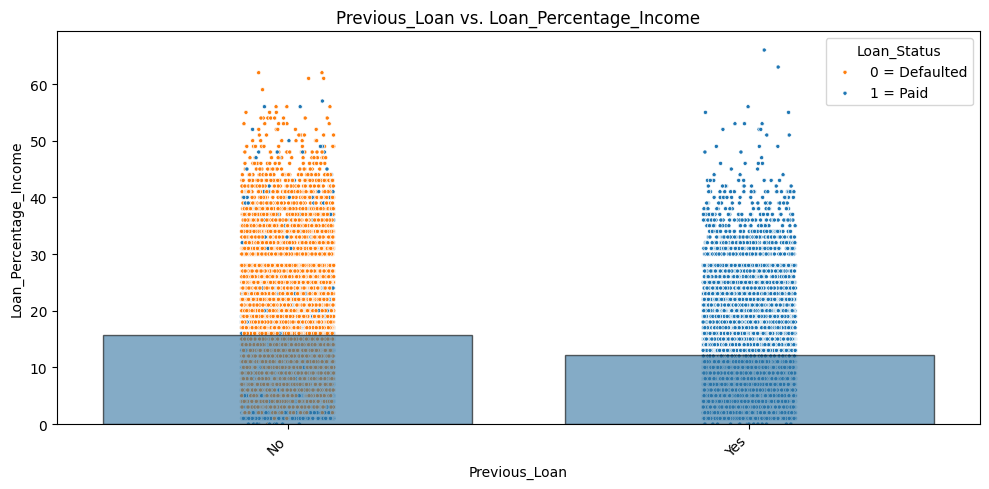

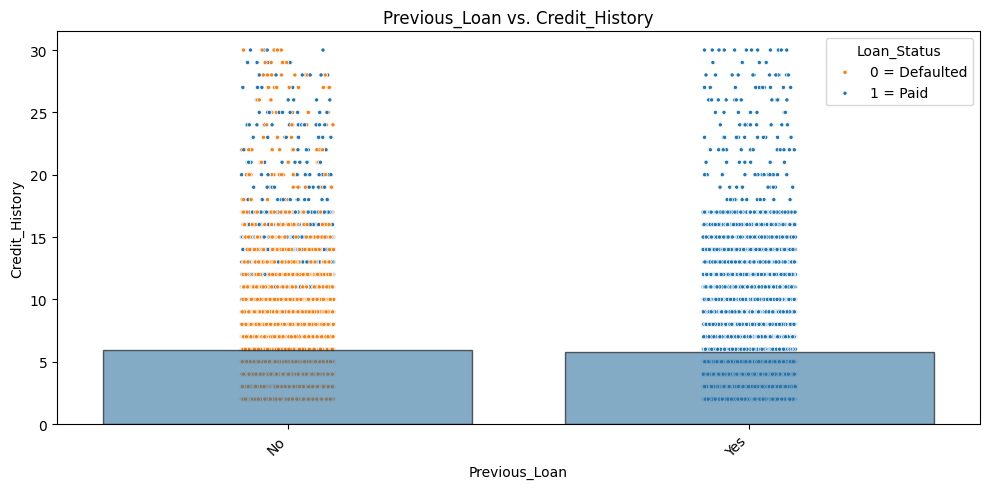

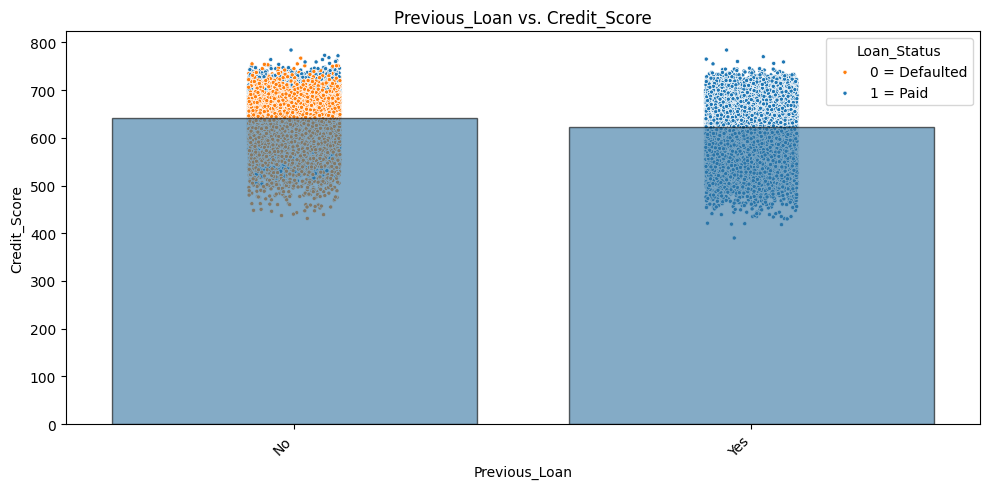

In [ ]:
for col in df.select_dtypes(include='number').columns.drop('Loan_Status'):
  plot_categorical_vs_target(df,'Previous_Loan',col ,figsize=(10,5), target_type='reg',status='percent',hue='Loan_Status');
  plt.legend(title='Loan_Status', labels=['0 = Defaulted', '1 = Paid'])

### Loan Status

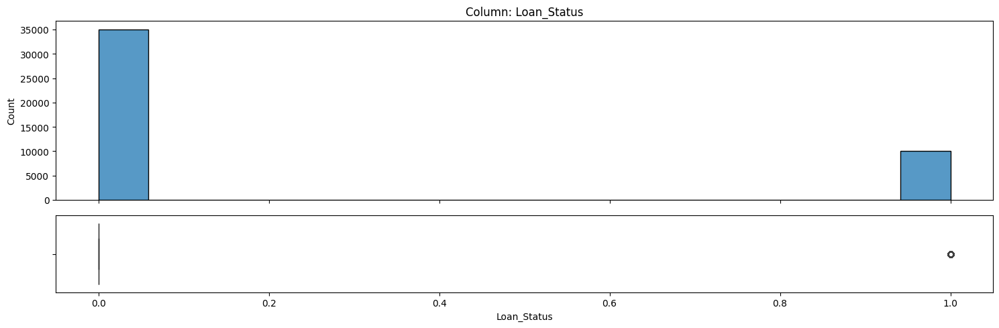

- NaN's Found: 0 (0.0%)


In [ ]:
explore_numeric(df,'Loan_Status',figsize=(15,5))

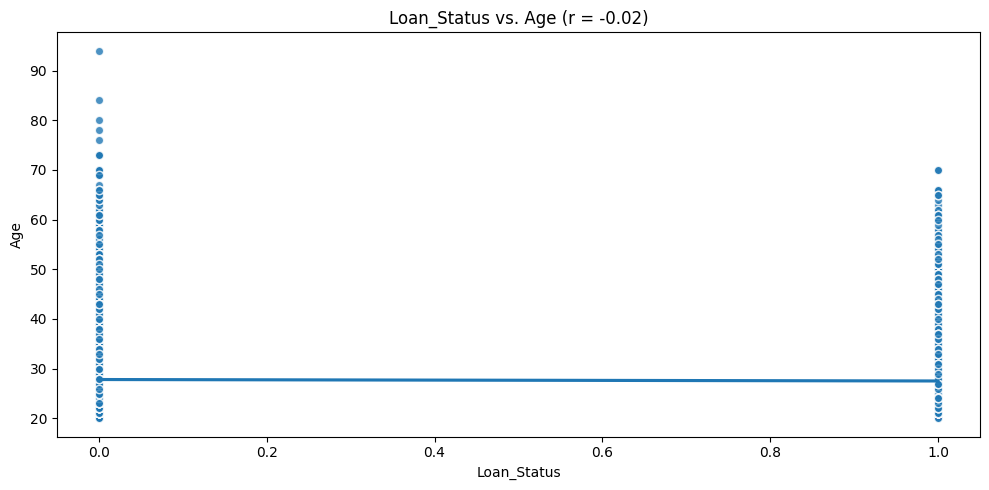

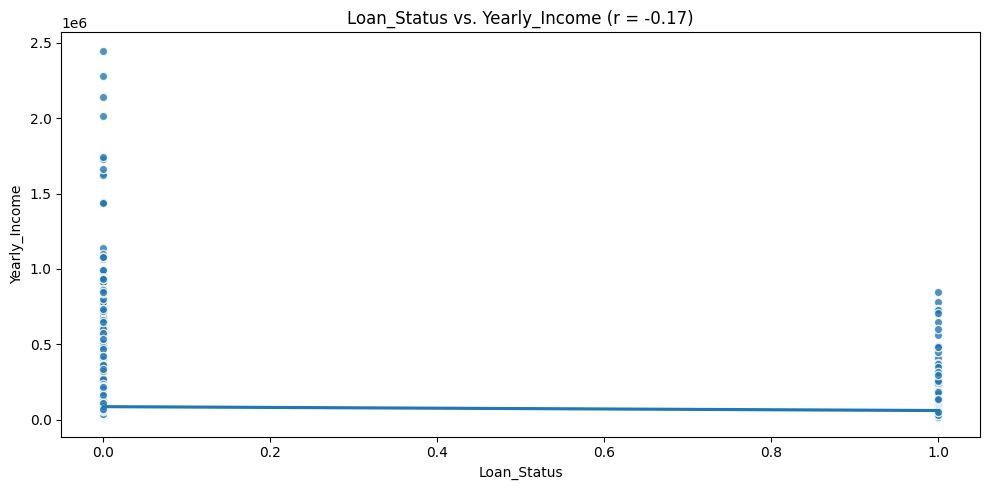

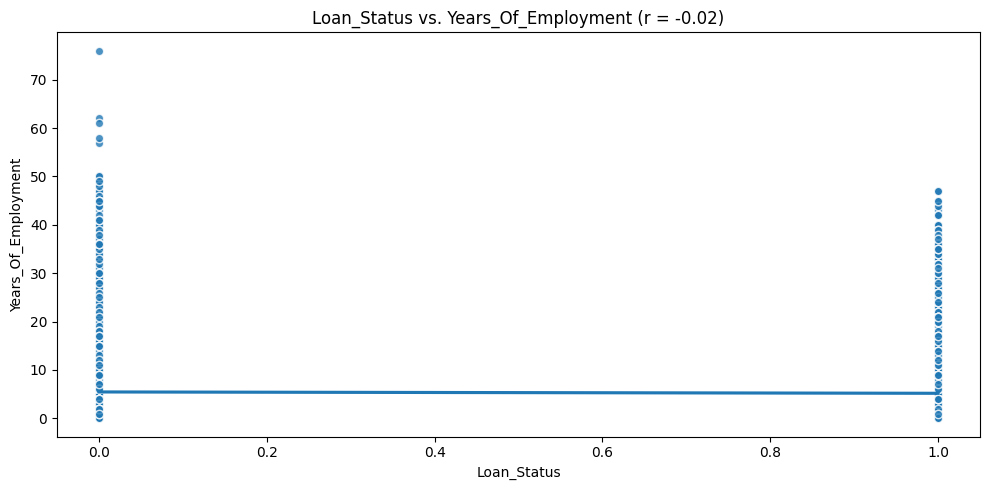

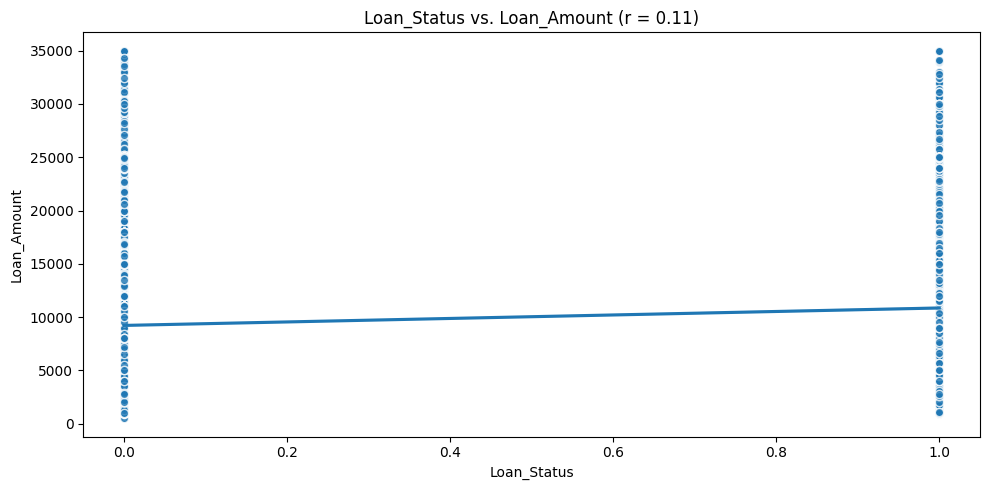

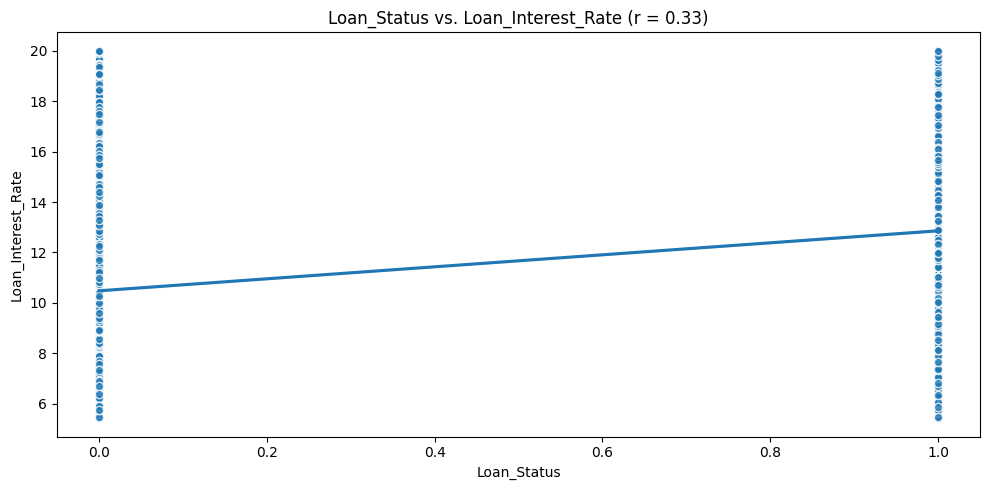

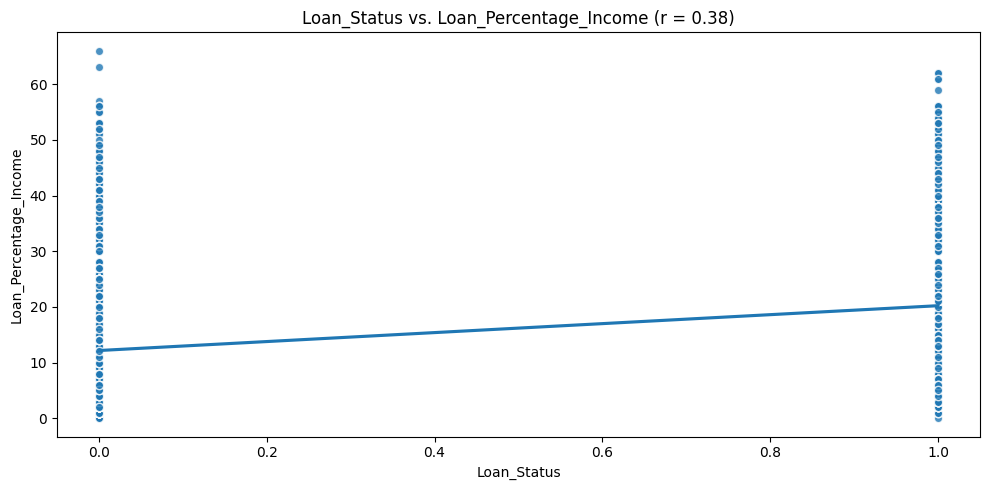

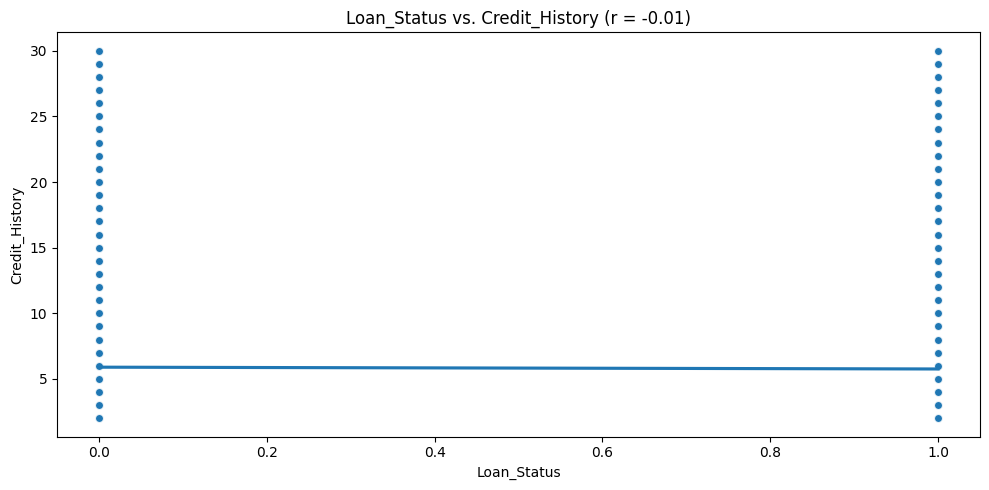

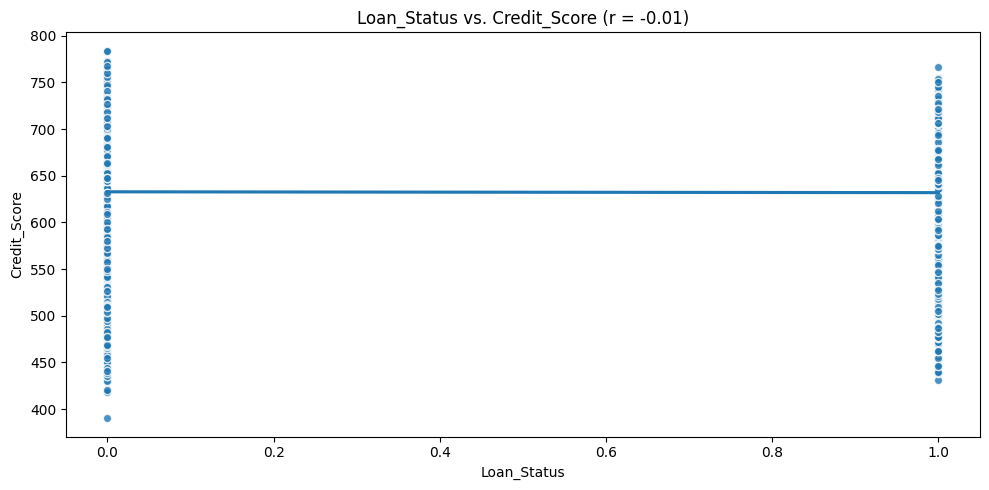

In [ ]:
for col in df.select_dtypes(include='number').columns.drop('Loan_Status','_Loan_Status'):
  plot_numeric_vs_target(df,'Loan_Status',col ,figsize=(10,5), target_type='reg');

### Corrlation

In [ ]:
cor = df.corr(numeric_only=True)
cor.round(2)

,Age,Yearly_Income,Years_Of_Employment,Loan_Amount,Loan_Interest_Rate,Loan_Percentage_Income,Credit_History,Credit_Score,Loan_Status
Age,1.00,0.14,0.95,0.05,0.01,-0.04,0.88,0.17,-0.02
Yearly_Income,0.14,1.00,0.13,0.31,-0.00,-0.29,0.13,0.03,-0.17
Years_Of_Employment,0.95,0.13,1.00,0.05,0.02,-0.04,0.84,0.18,-0.02
Loan_Amount,0.05,0.31,0.05,1.00,0.15,0.59,0.04,0.01,0.11
Loan_Interest_Rate,0.01,-0.00,0.02,0.15,1.00,0.13,0.02,0.01,0.33
Loan_Percentage_Income,-0.04,-0.29,-0.04,0.59,0.13,1.00,-0.03,-0.01,0.38
Credit_History,0.88,0.13,0.84,0.04,0.02,-0.03,1.00,0.15,-0.01
Credit_Score,0.17,0.03,0.18,0.01,0.01,-0.01,0.15,1.00,-0.01
Loan_Status,-0.02,-0.17,-0.02,0.11,0.33,0.38,-0.01,-0.01,1.00


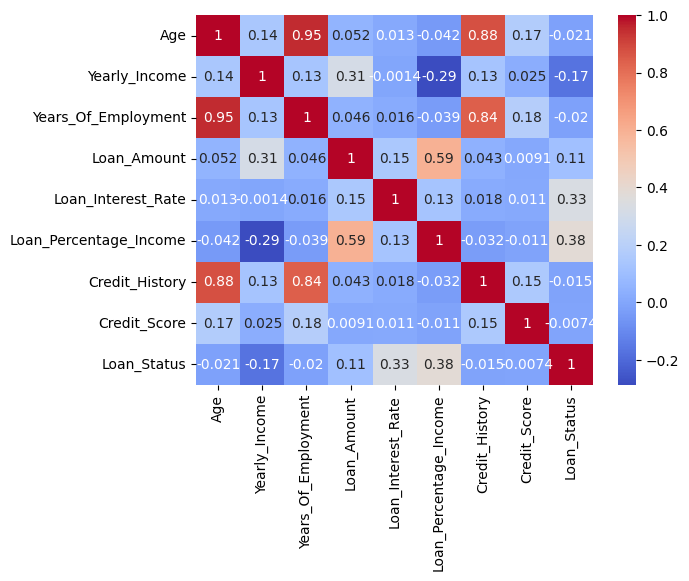

In [ ]:
sns.heatmap(cor,cmap='coolwarm',annot=True);

# ML Data Modeling

## Modeling Imports

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, OneHotEncoder,OrdinalEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline,make_pipeline
from sklearn import set_config
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix, classification_report, ConfusionMatrixDisplay
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier, AdaBoostClassifier, BaggingClassifier, ExtraTreesClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import GradientBoostingClassifier
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier
from sklearn.metrics import classification_report, ConfusionMatrixDisplay
from sklearn import set_config
set_config(transform_output='pandas')

In [ ]:
models = [LogisticRegression(), DecisionTreeClassifier(), RandomForestClassifier(), GradientBoostingClassifier(), AdaBoostClassifier(), BaggingClassifier(), ExtraTreesClassifier(), KNeighborsClassifier(), XGBClassifier(), LGBMClassifier()]

### Custom Import

In [ ]:
def classification_metrics(y_true, y_pred, label='',output_dict=False, figsize=(8,4),
    normalize='true', cmap='Blues',colorbar=False):
  report = classification_report(y_true, y_pred)
  header = "-"*70
  print(header, f" Classification Metrics: {label}", header, sep='\n')
  print(report)
  fig, axes = plt.subplots(ncols=2, figsize=figsize)
  ConfusionMatrixDisplay.from_predictions(y_true, y_pred,normalize=None,
    cmap='gist_gray', colorbar=colorbar,ax = axes[0],);
  axes[0].set_title("Raw Counts")
  ConfusionMatrixDisplay.from_predictions(y_true, y_pred,normalize=normalize,
    cmap=cmap, colorbar=colorbar,ax = axes[1]);
  axes[1].set_title("Normalized Confusion Matrix")
  fig.tight_layout()
  plt.show()
  if output_dict==True:
    report_dict = classification_report(y_true, y_pred, output_dict=True)
    return report_dict
def evaluate_classification(model, X_train, y_train, X_test, y_test,figsize=(6,4), normalize='true',
    output_dict = False,cmap_train='Blues', cmap_test="Reds",colorbar=False):
  y_train_pred = model.predict(X_train)
  results_train = classification_metrics(y_train, y_train_pred, #verbose = verbose,
    output_dict=True, figsize=figsize,colorbar=colorbar, cmap=cmap_train,label='Training Data')
  print()
  y_test_pred = model.predict(X_test)
  results_test = classification_metrics(y_test, y_test_pred, #verbose = verbose,
    output_dict=True,figsize=figsize,colorbar=colorbar, cmap=cmap_test,label='Test Data')
  if output_dict == True:
    results_dict = {'train':results_train,'test': results_test}
    return results_dict

## Split

In [ ]:
df['Loan_Status'].value_counts(normalize=True)*100

,proportion
Loan_Status,
0,77.77432
1,22.22568


In [ ]:
df['_LoanStatus'] = df['Loan_Status'].map({1: 'Paid', 0: 'Defaulted'})

In [ ]:
drop_from_ml = ['Loan_Status',	'_LoanStatus']
X = df.drop(columns = drop_from_ml)
y = df['Loan_Status']

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, random_state = 42)

## Pre 1

In [ ]:
ohe_cols = X_train.select_dtypes('object').columns #.drop(columns=ord_cols).columns
ohe_encoder = OneHotEncoder(drop='first', sparse_output=False)
cat_pipe = make_pipeline(ohe_encoder)
cat_tuple = ('cat',cat_pipe, ohe_cols)
cat_tuple

('cat',
 Pipeline(steps=[('onehotencoder',
                  OneHotEncoder(drop='first', sparse_output=False))]),
 Index(['Gender', 'Education_Level', 'Home_Ownership_Stauts', 'Loan_Purpose',
        'Previous_Loan'],
       dtype='object'))

In [ ]:
num_cols = X_train.select_dtypes('number').columns
scaler = StandardScaler()
num_pipe = make_pipeline(scaler)
num_tuple = ('num',num_pipe, num_cols)
num_tuple

('num',
 Pipeline(steps=[('standardscaler', StandardScaler())]),
 Index(['Age', 'Yearly_Income', 'Years_Of_Employment', 'Loan_Amount',
        'Loan_Interest_Rate', 'Loan_Percentage_Income', 'Credit_History',
        'Credit_Score'],
       dtype='object'))

In [ ]:
preprocessor  = ColumnTransformer([num_tuple,cat_tuple],verbose_feature_names_out=True)

LogisticRegression
----------------------------------------------------------------------
 Classification Metrics: Training Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.93      0.94      0.93     26236
           1       0.78      0.75      0.76      7508

    accuracy                           0.90     33744
   macro avg       0.85      0.84      0.85     33744
weighted avg       0.89      0.90      0.90     33744



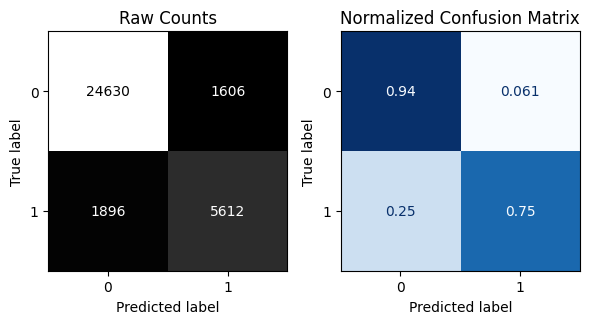


----------------------------------------------------------------------
 Classification Metrics: Test Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.93      0.94      0.94      8757
           1       0.79      0.75      0.77      2492

    accuracy                           0.90     11249
   macro avg       0.86      0.84      0.85     11249
weighted avg       0.90      0.90      0.90     11249



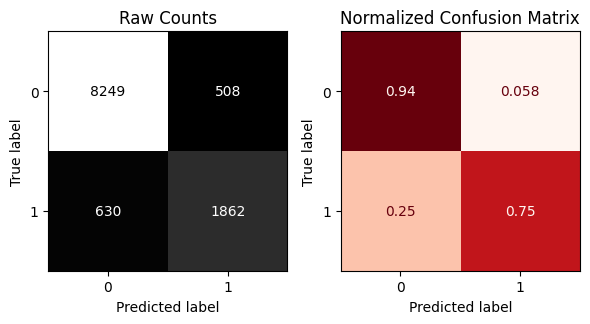

DecisionTreeClassifier
----------------------------------------------------------------------
 Classification Metrics: Training Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     26236
           1       1.00      1.00      1.00      7508

    accuracy                           1.00     33744
   macro avg       1.00      1.00      1.00     33744
weighted avg       1.00      1.00      1.00     33744



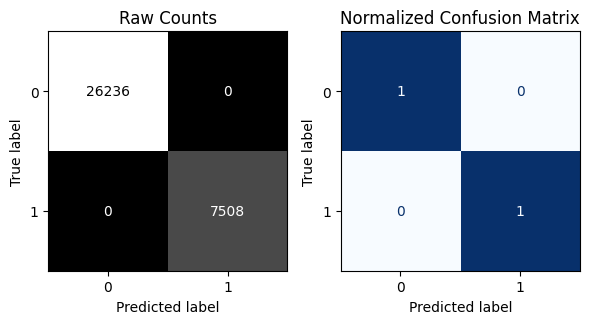


----------------------------------------------------------------------
 Classification Metrics: Test Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.94      0.93      0.94      8757
           1       0.77      0.80      0.78      2492

    accuracy                           0.90     11249
   macro avg       0.86      0.87      0.86     11249
weighted avg       0.90      0.90      0.90     11249



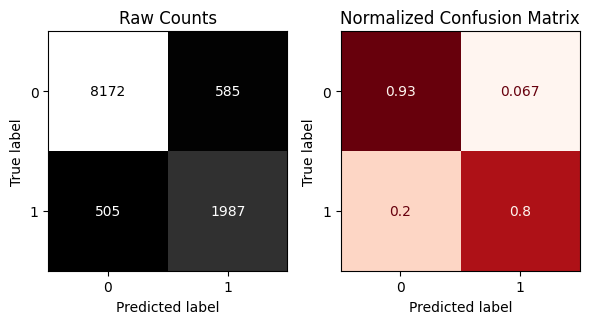

RandomForestClassifier
----------------------------------------------------------------------
 Classification Metrics: Training Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     26236
           1       1.00      1.00      1.00      7508

    accuracy                           1.00     33744
   macro avg       1.00      1.00      1.00     33744
weighted avg       1.00      1.00      1.00     33744



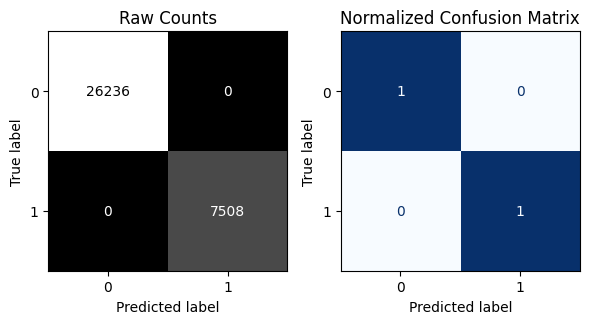


----------------------------------------------------------------------
 Classification Metrics: Test Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.93      0.98      0.95      8757
           1       0.90      0.76      0.82      2492

    accuracy                           0.93     11249
   macro avg       0.92      0.87      0.89     11249
weighted avg       0.93      0.93      0.93     11249



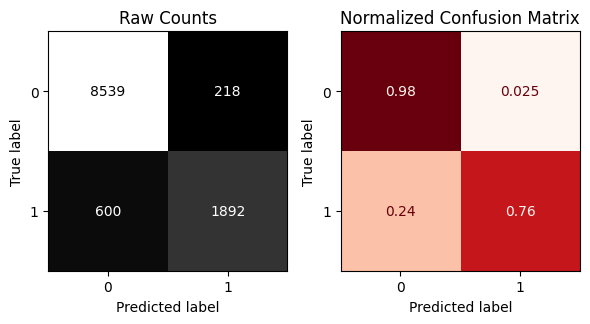

GradientBoostingClassifier
----------------------------------------------------------------------
 Classification Metrics: Training Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.94      0.97      0.95     26236
           1       0.88      0.77      0.82      7508

    accuracy                           0.93     33744
   macro avg       0.91      0.87      0.89     33744
weighted avg       0.92      0.93      0.92     33744



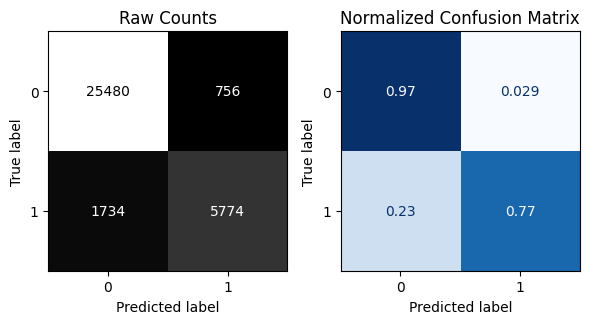


----------------------------------------------------------------------
 Classification Metrics: Test Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.93      0.97      0.95      8757
           1       0.88      0.76      0.81      2492

    accuracy                           0.92     11249
   macro avg       0.90      0.86      0.88     11249
weighted avg       0.92      0.92      0.92     11249



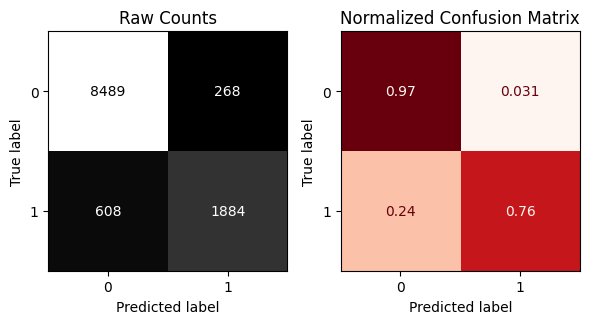

AdaBoostClassifier
----------------------------------------------------------------------
 Classification Metrics: Training Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.94      0.94      0.94     26236
           1       0.80      0.78      0.79      7508

    accuracy                           0.91     33744
   macro avg       0.87      0.86      0.86     33744
weighted avg       0.91      0.91      0.91     33744



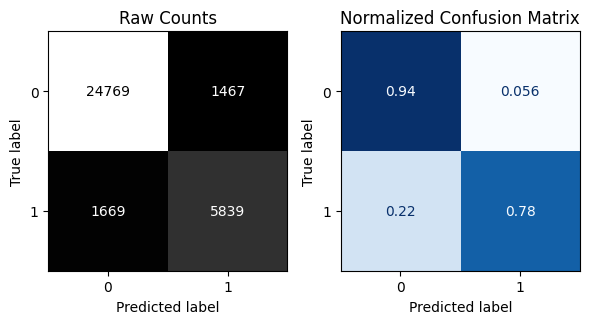


----------------------------------------------------------------------
 Classification Metrics: Test Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.94      0.94      0.94      8757
           1       0.79      0.78      0.79      2492

    accuracy                           0.91     11249
   macro avg       0.86      0.86      0.86     11249
weighted avg       0.91      0.91      0.91     11249



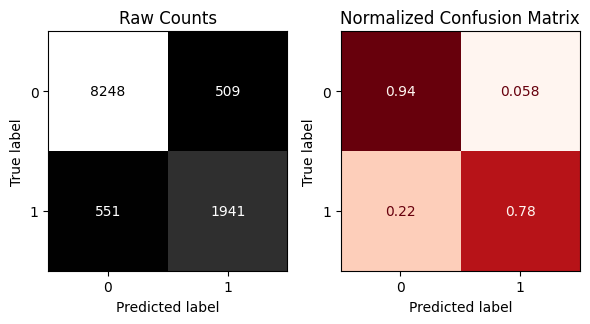

BaggingClassifier
----------------------------------------------------------------------
 Classification Metrics: Training Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.99      1.00      1.00     26236
           1       1.00      0.98      0.99      7508

    accuracy                           0.99     33744
   macro avg       1.00      0.99      0.99     33744
weighted avg       0.99      0.99      0.99     33744



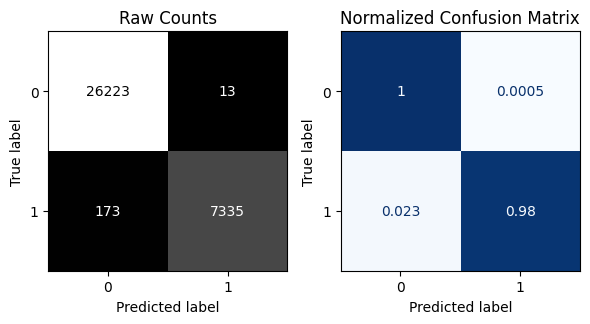


----------------------------------------------------------------------
 Classification Metrics: Test Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.93      0.97      0.95      8757
           1       0.88      0.76      0.82      2492

    accuracy                           0.93     11249
   macro avg       0.91      0.87      0.89     11249
weighted avg       0.92      0.93      0.92     11249



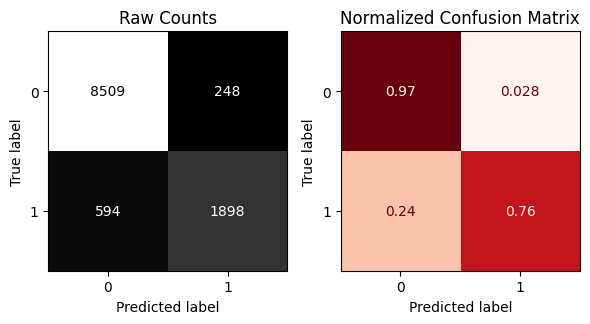

ExtraTreesClassifier
----------------------------------------------------------------------
 Classification Metrics: Training Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     26236
           1       1.00      1.00      1.00      7508

    accuracy                           1.00     33744
   macro avg       1.00      1.00      1.00     33744
weighted avg       1.00      1.00      1.00     33744



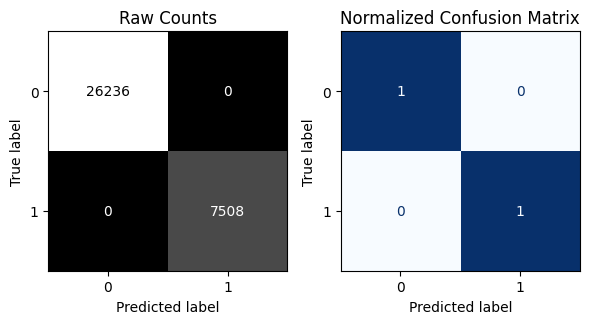


----------------------------------------------------------------------
 Classification Metrics: Test Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.93      0.97      0.95      8757
           1       0.87      0.75      0.81      2492

    accuracy                           0.92     11249
   macro avg       0.90      0.86      0.88     11249
weighted avg       0.92      0.92      0.92     11249



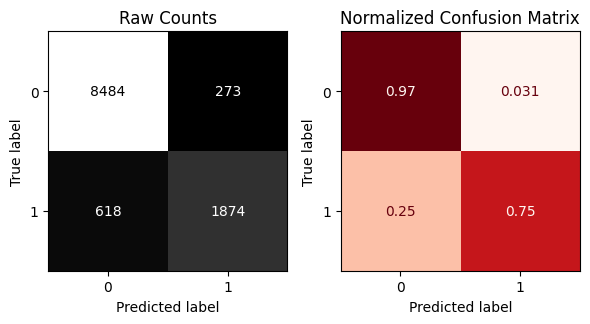

KNeighborsClassifier
----------------------------------------------------------------------
 Classification Metrics: Training Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.94      0.97      0.95     26236
           1       0.88      0.79      0.83      7508

    accuracy                           0.93     33744
   macro avg       0.91      0.88      0.89     33744
weighted avg       0.93      0.93      0.93     33744



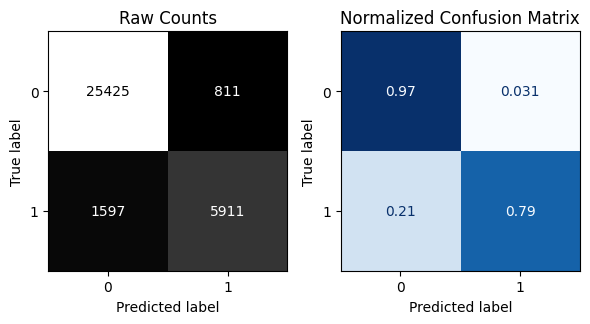


----------------------------------------------------------------------
 Classification Metrics: Test Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.92      0.95      0.94      8757
           1       0.81      0.71      0.76      2492

    accuracy                           0.90     11249
   macro avg       0.87      0.83      0.85     11249
weighted avg       0.90      0.90      0.90     11249



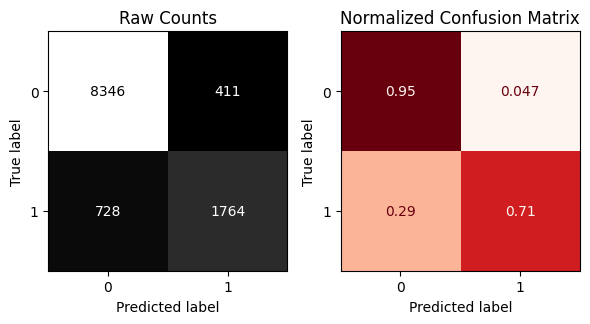

XGBClassifier
----------------------------------------------------------------------
 Classification Metrics: Training Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.97      0.99      0.98     26236
           1       0.97      0.90      0.93      7508

    accuracy                           0.97     33744
   macro avg       0.97      0.94      0.96     33744
weighted avg       0.97      0.97      0.97     33744



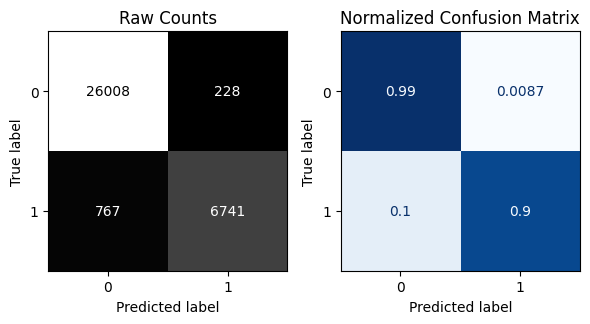


----------------------------------------------------------------------
 Classification Metrics: Test Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.94      0.97      0.96      8757
           1       0.89      0.79      0.84      2492

    accuracy                           0.93     11249
   macro avg       0.91      0.88      0.90     11249
weighted avg       0.93      0.93      0.93     11249



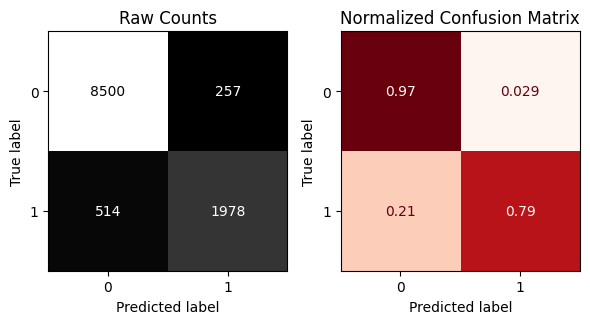

LGBMClassifier
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 7508, number of negative: 26236
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.003565 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1208
[LightGBM] [Info] Number of data points in the train set: 33744, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.222499 -> initscore=-1.251163
[LightGBM] [Info] Start training from score -1.251163
----------------------------------------------------------------------
 Classification Metrics: Training Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.95      0.98      0.97     26236
           1       0.93      0.83      0.88      7508

   

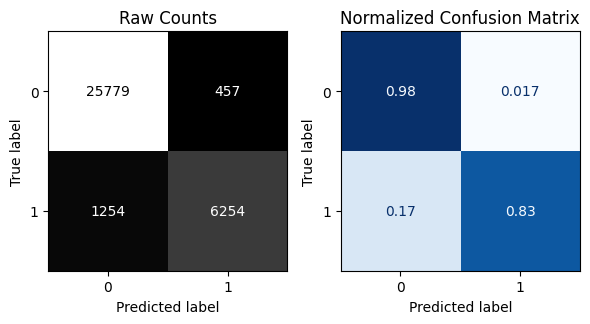


----------------------------------------------------------------------
 Classification Metrics: Test Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.94      0.97      0.96      8757
           1       0.89      0.79      0.84      2492

    accuracy                           0.93     11249
   macro avg       0.92      0.88      0.90     11249
weighted avg       0.93      0.93      0.93     11249



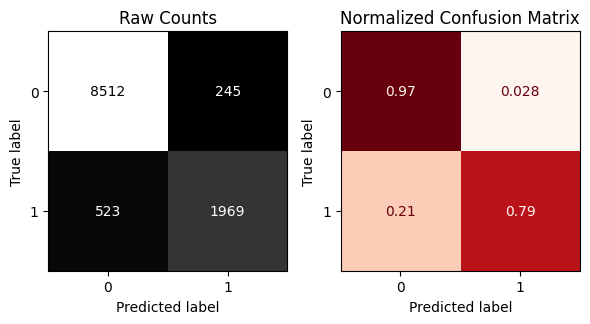

In [ ]:
for model in models:
  print('==='*30)
  print(model.__class__.__name__)
  model_pipe = make_pipeline(preprocessor, model)
  model_pipe.fit(X_train, y_train)
  evaluate_classification(model_pipe, X_train, y_train, X_test, y_test)
  print('==='*30)

## Pre 2

In [ ]:
df['Education_Level'].value_counts()

,count
Education_Level,
Bachelor,13396
Associate,12026
High School,11970
Master,6980
Doctorate,621


In [ ]:
ord_cols = ['Education_Level']

Education = {'High School':0,'Associate':1, 'Bachelor':2, 'Master':3, 'Doctorate':4}

ordinal_category_orders = [list(Education.keys())]

ord_encoder = OrdinalEncoder(categories=ordinal_category_orders)

scaler_ord = StandardScaler()

ord_pipe = make_pipeline(ord_encoder, scaler_ord)

ord_tuple = ('ordinal', ord_pipe, ord_cols)
ord_tuple

('ordinal',
 Pipeline(steps=[('ordinalencoder',
                  OrdinalEncoder(categories=[['High School', 'Associate',
                                              'Bachelor', 'Master',
                                              'Doctorate']])),
                 ('standardscaler', StandardScaler())]),
 ['Education_Level'])

In [ ]:
ohe_cols = X_train.select_dtypes('object').drop(columns=ord_cols).columns
ohe_encoder = OneHotEncoder(drop='first', sparse_output=False)
cat_pipe = make_pipeline(ohe_encoder)
cat_tuple = ('cat',cat_pipe, ohe_cols)
cat_tuple

('cat',
 Pipeline(steps=[('onehotencoder',
                  OneHotEncoder(drop='first', sparse_output=False))]),
 Index(['Gender', 'Home_Ownership_Stauts', 'Loan_Purpose', 'Previous_Loan'], dtype='object'))

In [ ]:
num_cols = X_train.select_dtypes('number').columns
scaler = StandardScaler()
num_pipe = make_pipeline(scaler)
num_tuple = ('num',num_pipe, num_cols)
num_tuple

('num',
 Pipeline(steps=[('standardscaler', StandardScaler())]),
 Index(['Age', 'Yearly_Income', 'Years_Of_Employment', 'Loan_Amount',
        'Loan_Interest_Rate', 'Loan_Percentage_Income', 'Credit_History',
        'Credit_Score'],
       dtype='object'))

In [ ]:
preprocessor  = ColumnTransformer([num_tuple,cat_tuple],verbose_feature_names_out=True)

LogisticRegression
----------------------------------------------------------------------
 Classification Metrics: Training Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.93      0.94      0.93     26236
           1       0.78      0.75      0.76      7508

    accuracy                           0.90     33744
   macro avg       0.85      0.84      0.85     33744
weighted avg       0.90      0.90      0.90     33744



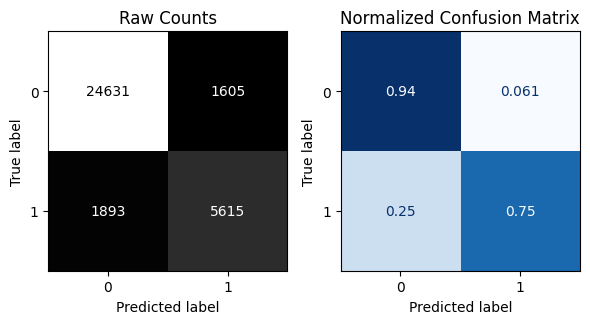


----------------------------------------------------------------------
 Classification Metrics: Test Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.93      0.94      0.94      8757
           1       0.79      0.74      0.76      2492

    accuracy                           0.90     11249
   macro avg       0.86      0.84      0.85     11249
weighted avg       0.90      0.90      0.90     11249



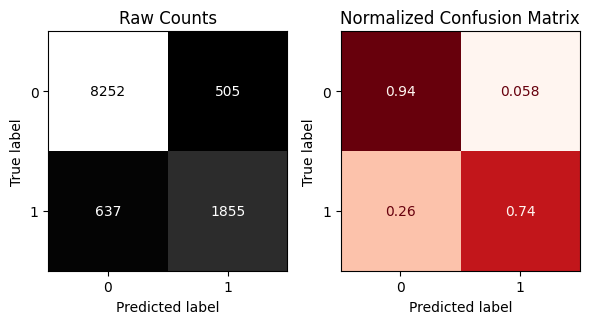

DecisionTreeClassifier
----------------------------------------------------------------------
 Classification Metrics: Training Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     26236
           1       1.00      1.00      1.00      7508

    accuracy                           1.00     33744
   macro avg       1.00      1.00      1.00     33744
weighted avg       1.00      1.00      1.00     33744



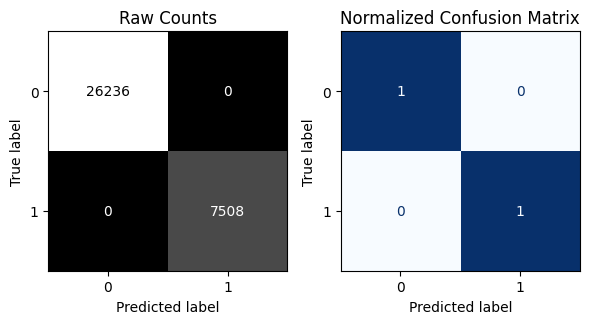


----------------------------------------------------------------------
 Classification Metrics: Test Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.94      0.93      0.94      8757
           1       0.77      0.79      0.78      2492

    accuracy                           0.90     11249
   macro avg       0.86      0.86      0.86     11249
weighted avg       0.90      0.90      0.90     11249



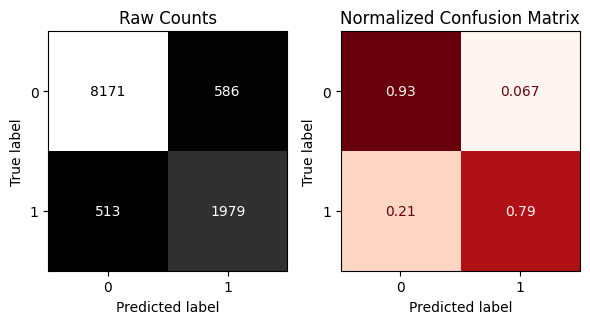

RandomForestClassifier
----------------------------------------------------------------------
 Classification Metrics: Training Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     26236
           1       1.00      1.00      1.00      7508

    accuracy                           1.00     33744
   macro avg       1.00      1.00      1.00     33744
weighted avg       1.00      1.00      1.00     33744



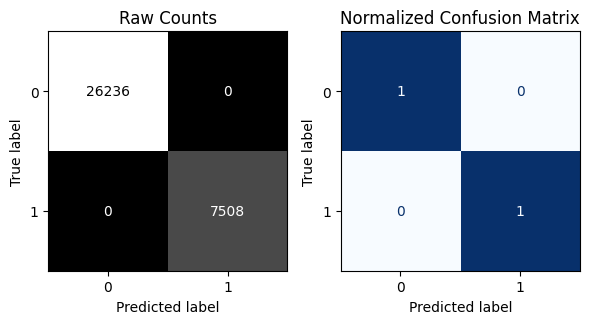


----------------------------------------------------------------------
 Classification Metrics: Test Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.94      0.98      0.96      8757
           1       0.90      0.77      0.83      2492

    accuracy                           0.93     11249
   macro avg       0.92      0.87      0.89     11249
weighted avg       0.93      0.93      0.93     11249



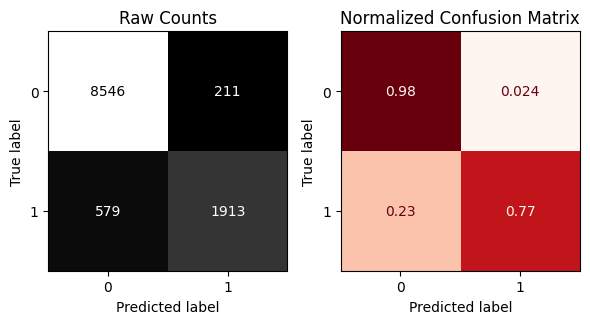

GradientBoostingClassifier
----------------------------------------------------------------------
 Classification Metrics: Training Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.94      0.97      0.95     26236
           1       0.88      0.77      0.82      7508

    accuracy                           0.93     33744
   macro avg       0.91      0.87      0.89     33744
weighted avg       0.92      0.93      0.92     33744



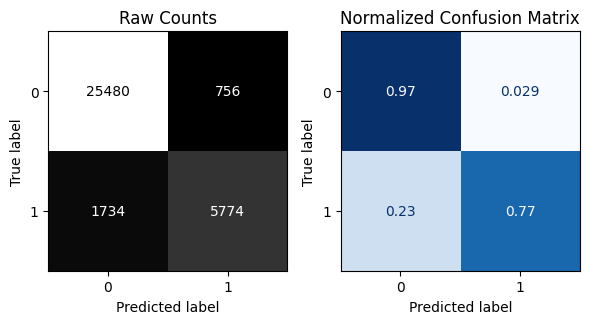


----------------------------------------------------------------------
 Classification Metrics: Test Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.93      0.97      0.95      8757
           1       0.88      0.76      0.81      2492

    accuracy                           0.92     11249
   macro avg       0.90      0.86      0.88     11249
weighted avg       0.92      0.92      0.92     11249



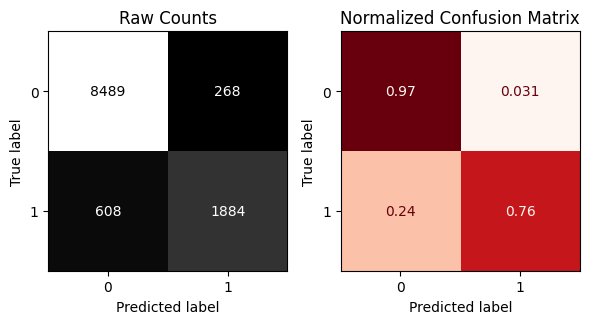

AdaBoostClassifier
----------------------------------------------------------------------
 Classification Metrics: Training Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.94      0.94      0.94     26236
           1       0.80      0.78      0.79      7508

    accuracy                           0.91     33744
   macro avg       0.87      0.86      0.86     33744
weighted avg       0.91      0.91      0.91     33744



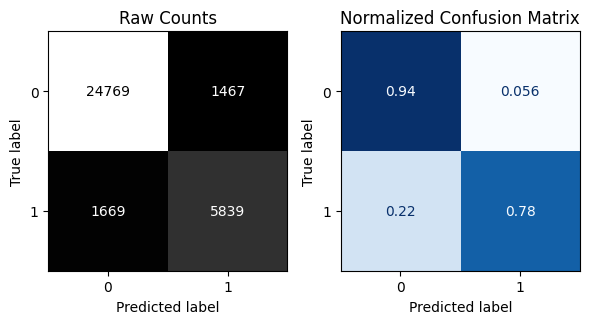


----------------------------------------------------------------------
 Classification Metrics: Test Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.94      0.94      0.94      8757
           1       0.79      0.78      0.79      2492

    accuracy                           0.91     11249
   macro avg       0.86      0.86      0.86     11249
weighted avg       0.91      0.91      0.91     11249



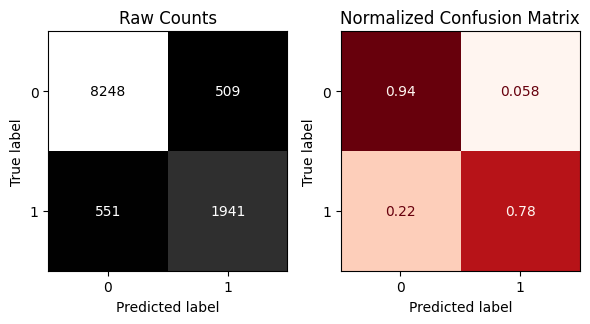

BaggingClassifier
----------------------------------------------------------------------
 Classification Metrics: Training Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.99      1.00      1.00     26236
           1       1.00      0.98      0.99      7508

    accuracy                           0.99     33744
   macro avg       1.00      0.99      0.99     33744
weighted avg       0.99      0.99      0.99     33744



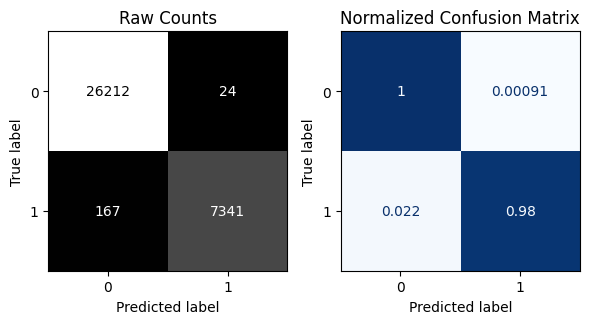


----------------------------------------------------------------------
 Classification Metrics: Test Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.94      0.97      0.95      8757
           1       0.88      0.77      0.82      2492

    accuracy                           0.92     11249
   macro avg       0.91      0.87      0.89     11249
weighted avg       0.92      0.92      0.92     11249



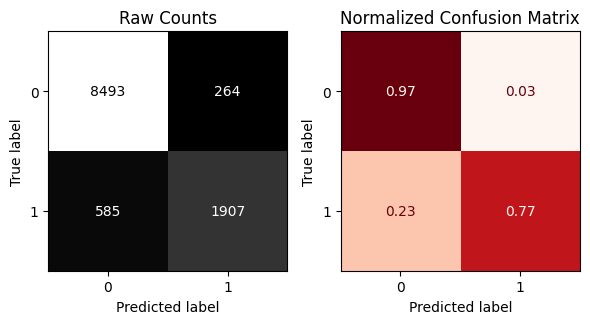

ExtraTreesClassifier
----------------------------------------------------------------------
 Classification Metrics: Training Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     26236
           1       1.00      1.00      1.00      7508

    accuracy                           1.00     33744
   macro avg       1.00      1.00      1.00     33744
weighted avg       1.00      1.00      1.00     33744



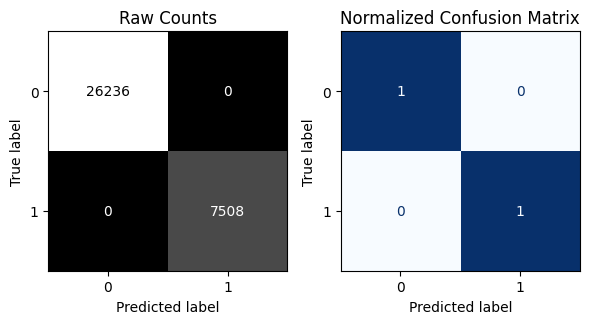


----------------------------------------------------------------------
 Classification Metrics: Test Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.93      0.97      0.95      8757
           1       0.87      0.76      0.81      2492

    accuracy                           0.92     11249
   macro avg       0.90      0.86      0.88     11249
weighted avg       0.92      0.92      0.92     11249



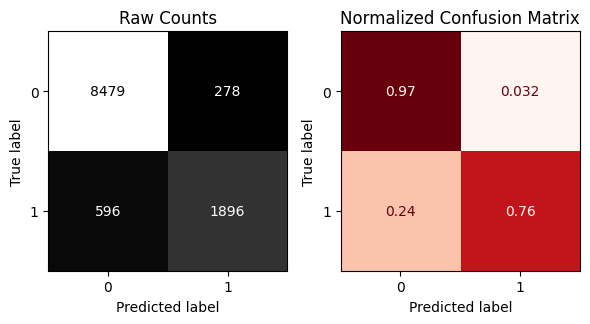

KNeighborsClassifier
----------------------------------------------------------------------
 Classification Metrics: Training Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.94      0.97      0.96     26236
           1       0.88      0.80      0.84      7508

    accuracy                           0.93     33744
   macro avg       0.91      0.88      0.90     33744
weighted avg       0.93      0.93      0.93     33744



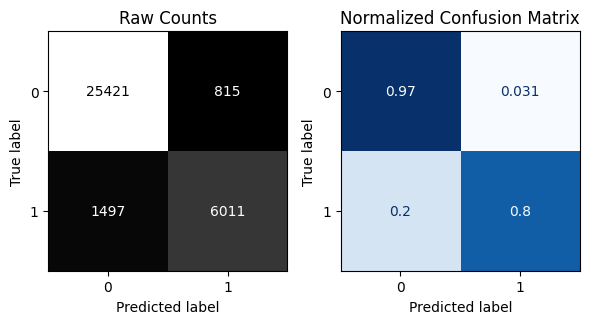


----------------------------------------------------------------------
 Classification Metrics: Test Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.93      0.95      0.94      8757
           1       0.82      0.73      0.77      2492

    accuracy                           0.90     11249
   macro avg       0.87      0.84      0.86     11249
weighted avg       0.90      0.90      0.90     11249



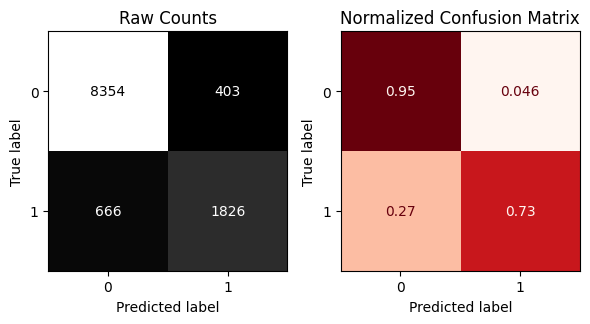

XGBClassifier
----------------------------------------------------------------------
 Classification Metrics: Training Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.97      0.99      0.98     26236
           1       0.97      0.90      0.93      7508

    accuracy                           0.97     33744
   macro avg       0.97      0.95      0.96     33744
weighted avg       0.97      0.97      0.97     33744



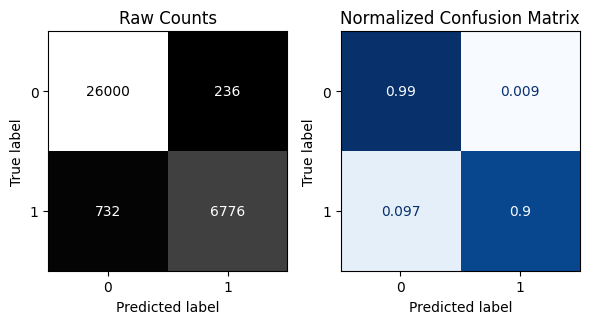


----------------------------------------------------------------------
 Classification Metrics: Test Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.94      0.97      0.96      8757
           1       0.88      0.80      0.84      2492

    accuracy                           0.93     11249
   macro avg       0.91      0.88      0.90     11249
weighted avg       0.93      0.93      0.93     11249



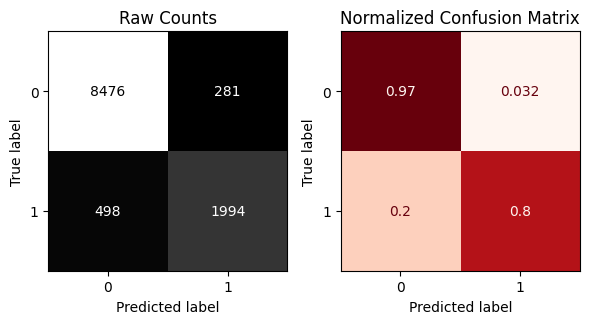

LGBMClassifier
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 7508, number of negative: 26236
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001415 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1200
[LightGBM] [Info] Number of data points in the train set: 33744, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.222499 -> initscore=-1.251163
[LightGBM] [Info] Start training from score -1.251163
----------------------------------------------------------------------
 Classification Metrics: Training Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.95      0.98      0.97     26236
           1       0.93      0.83      0.88      7508

   

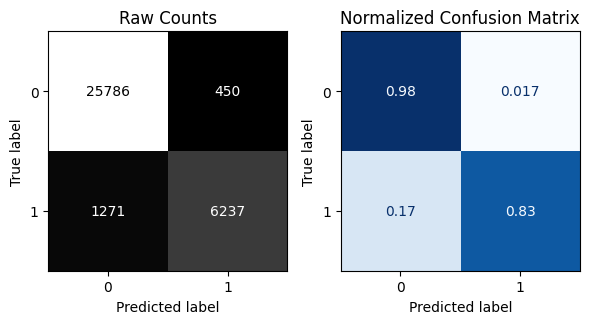


----------------------------------------------------------------------
 Classification Metrics: Test Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.94      0.97      0.96      8757
           1       0.90      0.79      0.84      2492

    accuracy                           0.93     11249
   macro avg       0.92      0.88      0.90     11249
weighted avg       0.93      0.93      0.93     11249



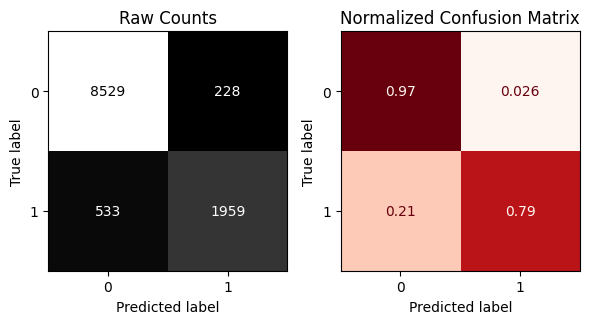

In [ ]:
for model in models:
  print('==='*30)
  print(model.__class__.__name__)
  model_pipe = make_pipeline(preprocessor, model)
  model_pipe.fit(X_train, y_train)
  evaluate_classification(model_pipe, X_train, y_train, X_test, y_test)
  print('==='*30)

## Modeling - Eval

In [ ]:
eval_steatment = f"""LogisticRegression:
pre 1 better on test 1% == 90% acc

DecisionTreeClassifier:
pre 2 better on test 1% == 90% acc

RandomForestClassifier:
pre 1 better on test 1% == 93% acc

GradientBoostingClassifier:
same on both == 92% acc

AdaBoostClassifier:
same on both == 91% acc

BaggingClassifier:
pre 2 better on test 1% == 93% acc

ExtraTreesClassifier:
pre 1 better on test 1% == 92% acc

KNeighborsClassifier:
pre 1 better on test 1% == 90% acc

XGBClassifier:
pre 2 better on test 1% == 93% acc

LGBMClassifier:
per 1 better on test 1% == 93% acc
"""

In [ ]:
print(eval_steatment)

LogisticRegression: 
pre 1 better on test 1% == 90% acc

DecisionTreeClassifier:
pre 2 better on test 1% == 90% acc

RandomForestClassifier:
pre 1 better on test 1% == 93% acc

GradientBoostingClassifier:
same on both == 92% acc

AdaBoostClassifier:
same on both == 91% acc

BaggingClassifier:
pre 2 better on test 1% == 93% acc

ExtraTreesClassifier:
pre 1 better on test 1% == 92% acc

KNeighborsClassifier:
pre 1 better on test 1% == 90% acc

XGBClassifier:
pre 2 better on test 1% == 93% acc

LGBMClassifier:
per 1 better on test 1% == 93% acc



## Stacking

In [ ]:
from sklearn.ensemble import StackingClassifier

In [ ]:
rf = RandomForestClassifier()
bg = BaggingClassifier()
xg = XGBClassifier()
lg = LGBMClassifier()

In [ ]:
estimators = [('rf', rf), ('bg', bg), ('xg', xg), ('lg', lg)]

In [ ]:
stacked = StackingClassifier(estimators=estimators,final_estimator=GradientBoostingClassifier())

stacked_pipe = Pipeline(steps=[('preprocessor', preprocessor), ('stacked', stacked)])

In [ ]:
stacked_pipe.fit(X_train, y_train)

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 7508, number of negative: 26236
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001354 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1200
[LightGBM] [Info] Number of data points in the train set: 33744, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.222499 -> initscore=-1.251163
[LightGBM] [Info] Start training from score -1.251163
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 6007, number of negative: 20988
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001030 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col

Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('num',
                                                  Pipeline(steps=[('standardscaler',
                                                                   StandardScaler())]),
                                                  Index(['Age', 'Yearly_Income', 'Years_Of_Employment', 'Loan_Amount',
       'Loan_Interest_Rate', 'Loan_Percentage_Income', 'Credit_History',
       'Credit_Score'],
      dtype='object')),
                                                 ('cat',
                                                  Pipeline(steps=[('onehotencoder',
                                                                   OneHotEncoder(drop='firs...
                                                               learning_rate=None,
                                                               max_bin=None,
                                                               max_cat_threshold=None,
                                                               max_cat_to_onehot=None,
                                                               max_delta_step=None,
                                                               max_depth=None,
                                                               max_leaves=None,
                                                               min_child_weight=None,
                                                               missing=nan,
                                                               monotone_constraints=None,
                                                               multi_strategy=None,
                                                               n_estimators=None,
                                                               n_jobs=None,
                                                               num_parallel_tree=None,
                                                               random_state=None, ...)),
                                                ('lg', LGBMClassifier())],
                                    final_estimator=GradientBoostingClassifier()))])

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2732: UserWarning: X has feature names, but GradientBoostingClassifier was fitted without feature names
  warnings.warn(


----------------------------------------------------------------------
 Classification Metrics: Training Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.98      0.99      0.98     26236
           1       0.97      0.92      0.94      7508

    accuracy                           0.98     33744
   macro avg       0.97      0.96      0.96     33744
weighted avg       0.97      0.98      0.97     33744



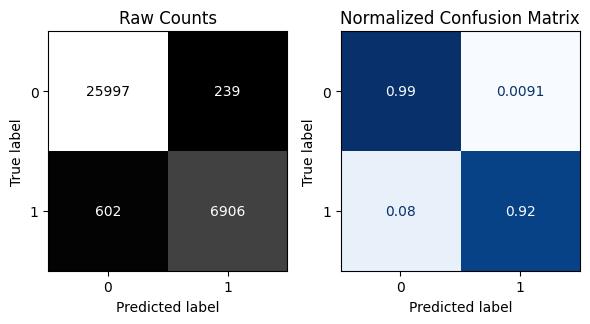


----------------------------------------------------------------------
 Classification Metrics: Test Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.94      0.97      0.96      8757
           1       0.89      0.79      0.84      2492

    accuracy                           0.93     11249
   macro avg       0.92      0.88      0.90     11249
weighted avg       0.93      0.93      0.93     11249



/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2732: UserWarning: X has feature names, but GradientBoostingClassifier was fitted without feature names
  warnings.warn(


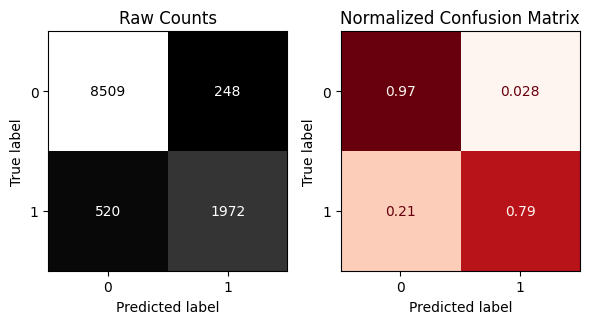

In [ ]:
evaluate_classification(stacked_pipe, X_train, y_train, X_test, y_test)

## Vote

### Soft

In [ ]:
from sklearn.ensemble import VotingClassifier

In [ ]:
vote = VotingClassifier(estimators=estimators,voting='soft')

vote_pipe = Pipeline(steps=[('preprocessor', preprocessor), ('vote', vote)])

vote_pipe.fit(X_train, y_train)

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 7508, number of negative: 26236
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002310 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1200
[LightGBM] [Info] Number of data points in the train set: 33744, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.222499 -> initscore=-1.251163
[LightGBM] [Info] Start training from score -1.251163


Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('num',
                                                  Pipeline(steps=[('standardscaler',
                                                                   StandardScaler())]),
                                                  Index(['Age', 'Yearly_Income', 'Years_Of_Employment', 'Loan_Amount',
       'Loan_Interest_Rate', 'Loan_Percentage_Income', 'Credit_History',
       'Credit_Score'],
      dtype='object')),
                                                 ('cat',
                                                  Pipeline(steps=[('onehotencoder',
                                                                   OneHotEncoder(drop='firs...
                                                             interaction_constraints=None,
                                                             learning_rate=None,
                                                             max_bin=None,
                                                             max_cat_threshold=None,
                                                             max_cat_to_onehot=None,
                                                             max_delta_step=None,
                                                             max_depth=None,
                                                             max_leaves=None,
                                                             min_child_weight=None,
                                                             missing=nan,
                                                             monotone_constraints=None,
                                                             multi_strategy=None,
                                                             n_estimators=None,
                                                             n_jobs=None,
                                                             num_parallel_tree=None,
                                                             random_state=None, ...)),
                                              ('lg', LGBMClassifier())],
                                  voting='soft'))])

----------------------------------------------------------------------
 Classification Metrics: Training Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.99      1.00      0.99     26236
           1       0.99      0.95      0.97      7508

    accuracy                           0.99     33744
   macro avg       0.99      0.98      0.98     33744
weighted avg       0.99      0.99      0.99     33744



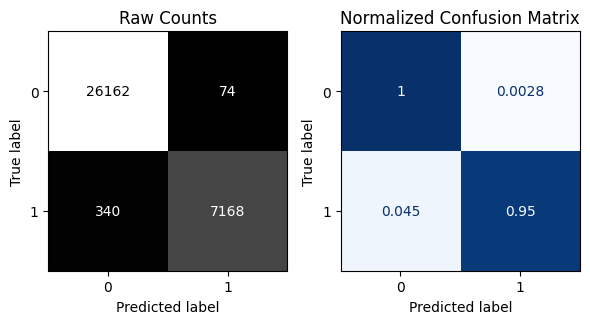


----------------------------------------------------------------------
 Classification Metrics: Test Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.94      0.97      0.96      8757
           1       0.89      0.79      0.84      2492

    accuracy                           0.93     11249
   macro avg       0.92      0.88      0.90     11249
weighted avg       0.93      0.93      0.93     11249



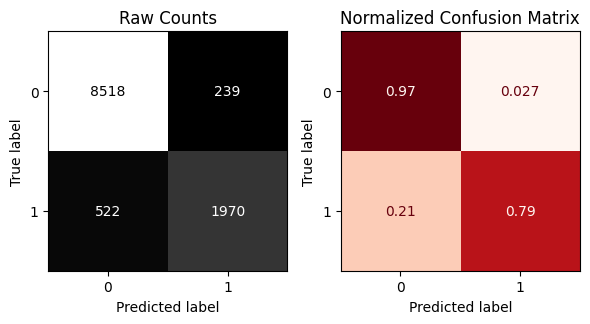

In [ ]:
evaluate_classification(vote_pipe, X_train, y_train, X_test, y_test)

### Hard

In [ ]:
vote = VotingClassifier(estimators=estimators,voting='hard')

vote_pipe = Pipeline(steps=[('preprocessor', preprocessor), ('vote', vote)])

vote_pipe.fit(X_train, y_train)

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 7508, number of negative: 26236
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001307 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1200
[LightGBM] [Info] Number of data points in the train set: 33744, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.222499 -> initscore=-1.251163
[LightGBM] [Info] Start training from score -1.251163


Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('num',
                                                  Pipeline(steps=[('standardscaler',
                                                                   StandardScaler())]),
                                                  Index(['Age', 'Yearly_Income', 'Years_Of_Employment', 'Loan_Amount',
       'Loan_Interest_Rate', 'Loan_Percentage_Income', 'Credit_History',
       'Credit_Score'],
      dtype='object')),
                                                 ('cat',
                                                  Pipeline(steps=[('onehotencoder',
                                                                   OneHotEncoder(drop='firs...
                                                             importance_type=None,
                                                             interaction_constraints=None,
                                                             learning_rate=None,
                                                             max_bin=None,
                                                             max_cat_threshold=None,
                                                             max_cat_to_onehot=None,
                                                             max_delta_step=None,
                                                             max_depth=None,
                                                             max_leaves=None,
                                                             min_child_weight=None,
                                                             missing=nan,
                                                             monotone_constraints=None,
                                                             multi_strategy=None,
                                                             n_estimators=None,
                                                             n_jobs=None,
                                                             num_parallel_tree=None,
                                                             random_state=None, ...)),
                                              ('lg', LGBMClassifier())]))])

----------------------------------------------------------------------
 Classification Metrics: Training Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.97      1.00      0.99     26236
           1       1.00      0.90      0.95      7508

    accuracy                           0.98     33744
   macro avg       0.99      0.95      0.97     33744
weighted avg       0.98      0.98      0.98     33744



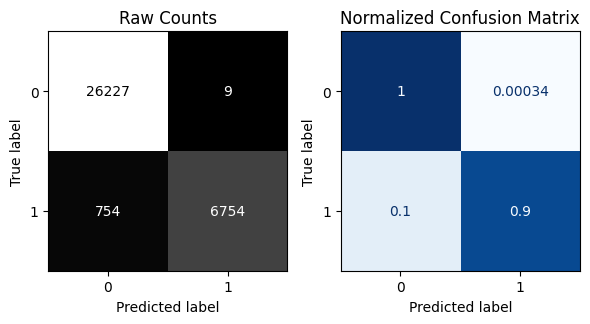


----------------------------------------------------------------------
 Classification Metrics: Test Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.94      0.98      0.96      8757
           1       0.92      0.76      0.83      2492

    accuracy                           0.93     11249
   macro avg       0.93      0.87      0.90     11249
weighted avg       0.93      0.93      0.93     11249



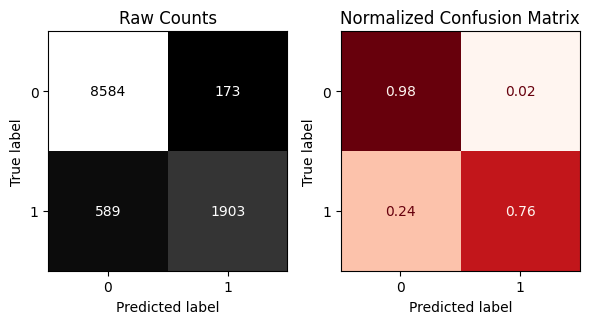

In [ ]:
evaluate_classification(vote_pipe, X_train, y_train, X_test, y_test)

## Tpot

In [ ]:
!pip install tpot==0.12.2

In [ ]:
X_train_TPOT = preprocessor.fit_transform(X_train)
X_test_TPOT = preprocessor.transform(X_test)

is_classifier
is_regressor
is_classifier


/usr/local/lib/python3.11/dist-packages/sklearn/base.py:1230: FutureWarning: passing a class to None is deprecated and will be removed in 1.8. Use an instance of the class instead.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/base.py:1270: FutureWarning: passing a class to None is deprecated and will be removed in 1.8. Use an instance of the class instead.
  warnings.warn(


is_regressor
is_classifier
is_regressor
is_classifier
is_classifier
is_classifier
is_classifier
is_regressor
is_classifier
is_regressor
is_classifier
is_regressor
is_classifier
is_regressor
is_classifier
is_regressor
is_classifier
is_regressor
is_classifier
is_regressor
is_classifier
is_classifier
is_classifier
is_classifier
is_classifier
is_classifier
is_classifier
is_classifier
is_regressor
is_classifier
is_regressor
is_classifier
is_regressor
is_classifier
is_regressor
is_classifier
is_regressor
is_classifier
is_regressor
is_classifier
is_regressor
is_classifier
is_classifier
is_classifier
is_regressor
is_classifier
is_regressor
is_classifier


Version 0.12.2 of tpot is outdated. Version 1.0.0 was released Wednesday February 26, 2025.


Optimization Progress:   0%|          | 0/300 [00:00<?, ?pipeline/s]


Generation 1 - Current best internal CV score: 0.9300318657935491

Generation 2 - Current best internal CV score: 0.9300318657935491

Generation 3 - Current best internal CV score: 0.9311876496577289

Generation 4 - Current best internal CV score: 0.9319877989344928

Generation 5 - Current best internal CV score: 0.932106335013912

Best pipeline: GradientBoostingClassifier(input_matrix, learning_rate=0.5, max_depth=10, max_features=0.35000000000000003, min_samples_leaf=3, min_samples_split=8, n_estimators=100, subsample=1.0)
----------------------------------------------------------------------
 Classification Metrics: Training Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     26236
           1       1.00      1.00      1.00      7508

    accuracy                           1.00     33744
   macro avg       1.00      1.00      1.00     33744
weighted avg   

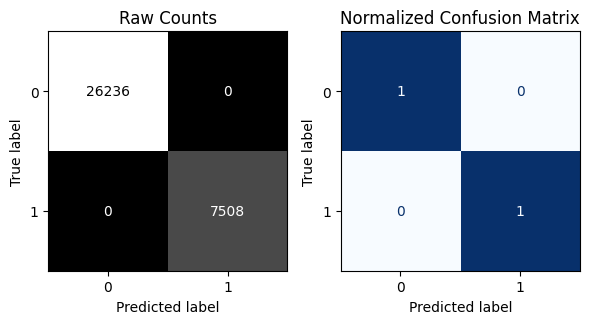


----------------------------------------------------------------------
 Classification Metrics: Test Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.95      0.97      0.96      8757
           1       0.88      0.80      0.84      2492

    accuracy                           0.93     11249
   macro avg       0.91      0.89      0.90     11249
weighted avg       0.93      0.93      0.93     11249



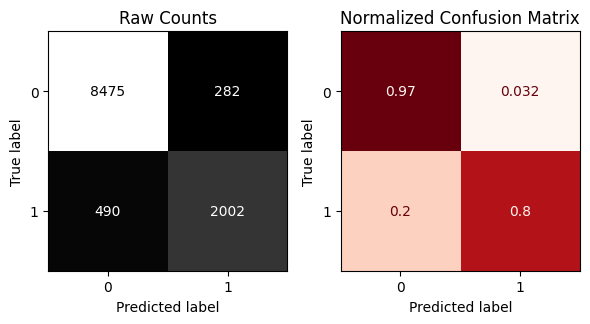

In [ ]:
from tpot import TPOTClassifier

tpot = TPOTClassifier(
    generations=5,
    population_size=50,
    verbosity=2,
    random_state=42
)

tpot.fit(X_train_TPOT, y_train)

evaluate_classification(tpot, X_train_TPOT, y_train, X_test_TPOT, y_test)

* Best pipeline: GradientBoostingClassifier(input_matrix, learning_rate=0.5, max_depth=10, max_features=0.35000000000000003, min_samples_leaf=3, min_samples_split=8, n_estimators=100, subsample=1.0)

# Features Importance

## Xgb Feature Importance

In [ ]:
xgb = XGBClassifier(learning_rate=0.5, max_depth=10, max_features=0.35000000000000003, min_samples_leaf=3, min_samples_split=8, n_estimators=100, subsample=1.0,random_state=42)

/usr/local/lib/python3.11/dist-packages/xgboost/core.py:158: UserWarning: [06:54:39] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "max_features", "min_samples_leaf", "min_samples_split" } are not used.

  warnings.warn(smsg, UserWarning)


----------------------------------------------------------------------
 Classification Metrics: Training Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     26236
           1       1.00      1.00      1.00      7508

    accuracy                           1.00     33744
   macro avg       1.00      1.00      1.00     33744
weighted avg       1.00      1.00      1.00     33744



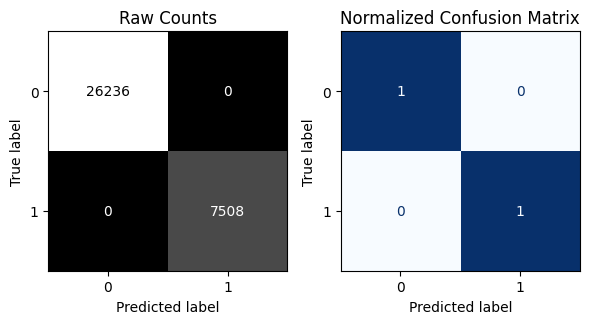


----------------------------------------------------------------------
 Classification Metrics: Test Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.95      0.97      0.96      8757
           1       0.87      0.81      0.84      2492

    accuracy                           0.93     11249
   macro avg       0.91      0.89      0.90     11249
weighted avg       0.93      0.93      0.93     11249



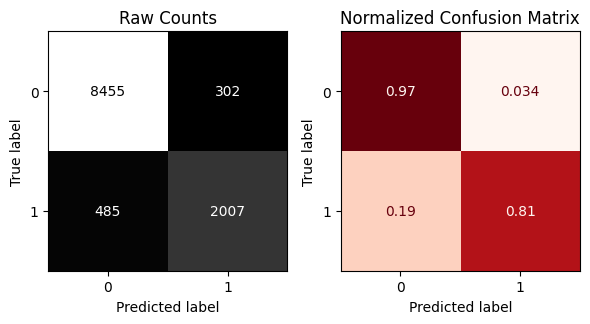

In [ ]:
xgb.fit(X_train_TPOT, y_train)

evaluate_classification(xgb, X_train_TPOT, y_train, X_test_TPOT, y_test)

In [ ]:
xgb.feature_importances_

array([0.00121368, 0.00313492, 0.00109624, 0.00133436, 0.00406706,
       0.00754701, 0.00116354, 0.0013474 , 0.0009573 , 0.00263004,
       0.01465923, 0.00786182, 0.00230508, 0.00649831, 0.0016504 ,
       0.002609  , 0.00679649, 0.9331281 ], dtype=float32)

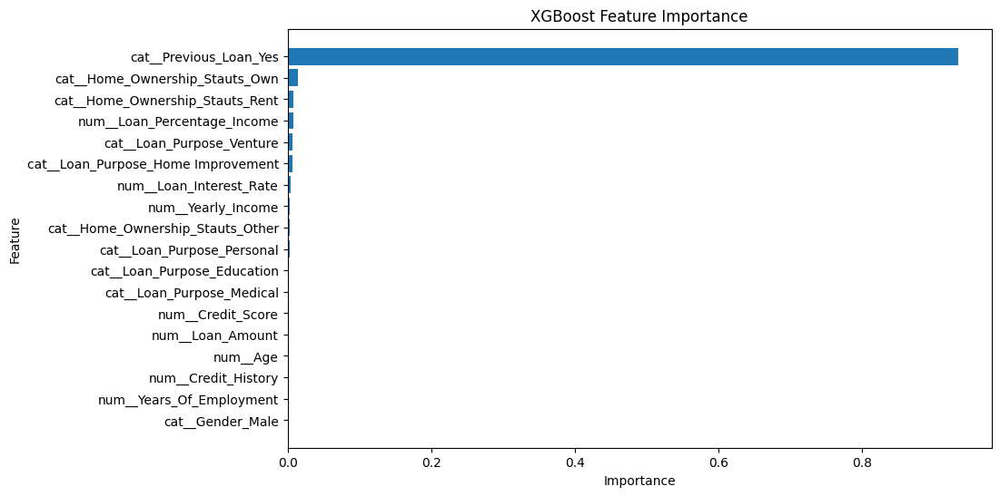

In [ ]:
importances = xgb.feature_importances_
feature_names = preprocessor.get_feature_names_out()

# Create a DataFrame for better visualization
importances_df = pd.DataFrame({'Feature': feature_names, 'Importance': importances})
importances_df = importances_df.sort_values(by='Importance', ascending=False)

# Plotting
plt.figure(figsize=(10, 6))
plt.barh(importances_df['Feature'], importances_df['Importance'])
plt.xlabel('Importance')
plt.ylabel('Feature')
plt.title('XGBoost Feature Importance')
plt.gca().invert_yaxis()
plt.show()

In [ ]:
importances_df

,Feature,Importance
17,cat__Previous_Loan_Yes,0.933128
10,cat__Home_Ownership_Stauts_Own,0.014659
11,cat__Home_Ownership_Stauts_Rent,0.007862
5,num__Loan_Percentage_Income,0.007547
16,cat__Loan_Purpose_Venture,0.006796
13,cat__Loan_Purpose_Home Improvement,0.006498
4,num__Loan_Interest_Rate,0.004067
1,num__Yearly_Income,0.003135
9,cat__Home_Ownership_Stauts_Other,0.002630
15,cat__Loan_Purpose_Personal,0.002609


## Xgb Feature Importance Model

In [ ]:
X_train_fi_test = X_train_TPOT.drop(columns=['cat__Gender_Male'])
X_test_fi_test = X_test_TPOT.drop(columns=['cat__Gender_Male'])

# Reset the indices of y_train and y_test to match the modified X_train and X_test
y_train_fi_test = y_train.reset_index(drop=True)
y_test_fi_test = y_test.reset_index(drop=True)

/usr/local/lib/python3.11/dist-packages/xgboost/core.py:158: UserWarning: [07:17:28] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "max_features", "min_samples_leaf", "min_samples_split" } are not used.

  warnings.warn(smsg, UserWarning)


----------------------------------------------------------------------
 Classification Metrics: Training Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     26236
           1       1.00      1.00      1.00      7508

    accuracy                           1.00     33744
   macro avg       1.00      1.00      1.00     33744
weighted avg       1.00      1.00      1.00     33744



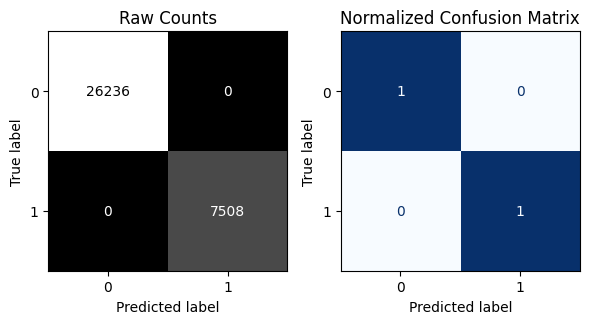


----------------------------------------------------------------------
 Classification Metrics: Test Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.95      0.96      0.95      8757
           1       0.86      0.81      0.83      2492

    accuracy                           0.93     11249
   macro avg       0.90      0.88      0.89     11249
weighted avg       0.93      0.93      0.93     11249



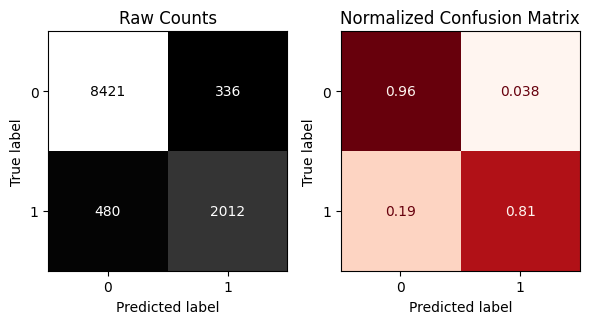

In [ ]:
xgb.fit(X_train_fi_test , y_train_fi_test)

evaluate_classification(xgb, X_train_fi_test, y_train_fi_test, X_test_fi_test, y_test_fi_test)

## Gradiant Bossting Feature Importance

In [ ]:
gb = GradientBoostingClassifier( learning_rate=0.5, max_depth=10, max_features=0.35000000000000003, min_samples_leaf=3, min_samples_split=8, n_estimators=100, subsample=1.0,random_state=42)

----------------------------------------------------------------------
 Classification Metrics: Training Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     26236
           1       1.00      1.00      1.00      7508

    accuracy                           1.00     33744
   macro avg       1.00      1.00      1.00     33744
weighted avg       1.00      1.00      1.00     33744



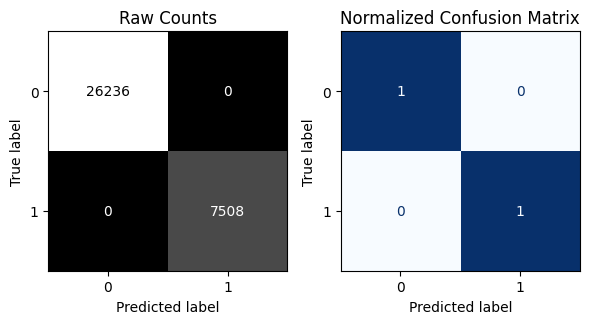


----------------------------------------------------------------------
 Classification Metrics: Test Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.95      0.97      0.96      8757
           1       0.88      0.80      0.84      2492

    accuracy                           0.93     11249
   macro avg       0.91      0.89      0.90     11249
weighted avg       0.93      0.93      0.93     11249



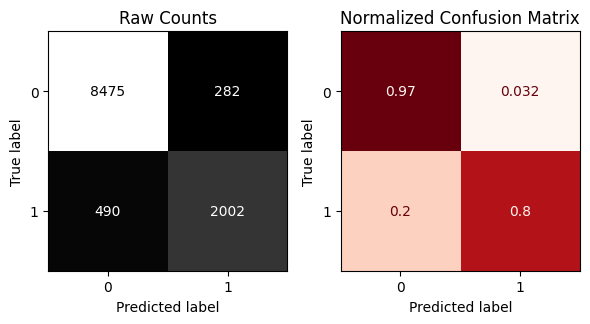

In [ ]:
gb.fit(X_train_TPOT, y_train)

evaluate_classification(gb, X_train_TPOT, y_train, X_test_TPOT, y_test)

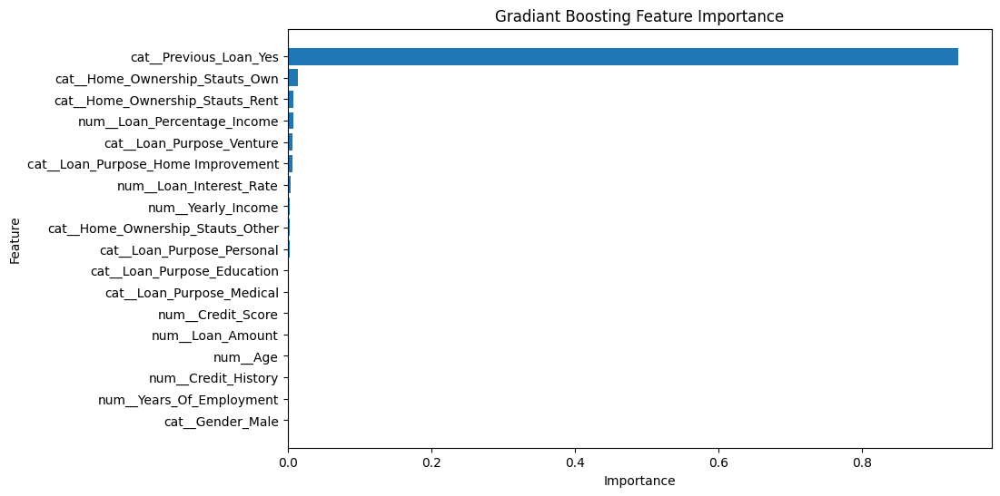

In [ ]:
importances_2 = gb.feature_importances_
feature_names_2 = preprocessor.get_feature_names_out()

# Create a DataFrame for better visualization
importances_df_2 = pd.DataFrame({'Feature': feature_names_2, 'Importance': importances_2})
importances_df_2 = importances_df.sort_values(by='Importance', ascending=False)

# Plotting
plt.figure(figsize=(10, 6))
plt.barh(importances_df_2['Feature'], importances_df_2['Importance'])
plt.xlabel('Importance')
plt.ylabel('Feature')
plt.title('Gradiant Boosting Feature Importance')
plt.gca().invert_yaxis()
plt.show()

## Other Models Features Importances

LogisticRegression
----------------------------------------------------------------------
 Classification Metrics: Training Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.93      0.94      0.93     26236
           1       0.78      0.75      0.76      7508

    accuracy                           0.90     33744
   macro avg       0.85      0.84      0.85     33744
weighted avg       0.90      0.90      0.90     33744



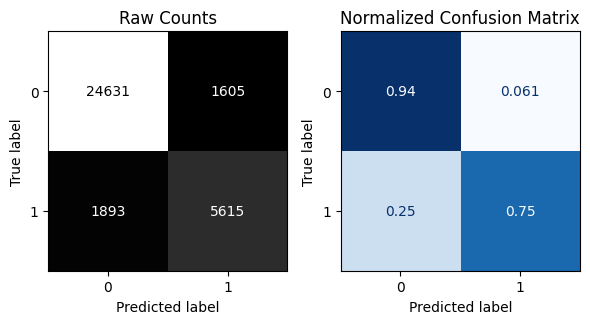


----------------------------------------------------------------------
 Classification Metrics: Test Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.93      0.94      0.94      8757
           1       0.79      0.74      0.76      2492

    accuracy                           0.90     11249
   macro avg       0.86      0.84      0.85     11249
weighted avg       0.90      0.90      0.90     11249



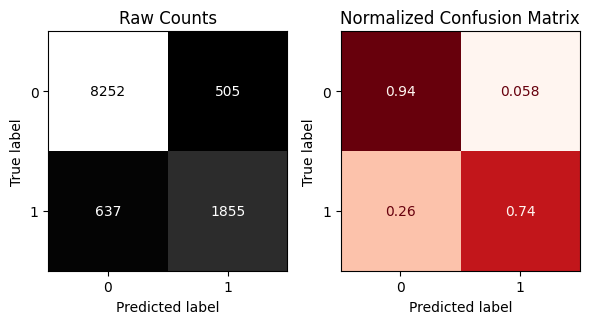

LogisticRegression does not support feature_importances_
DecisionTreeClassifier
----------------------------------------------------------------------
 Classification Metrics: Training Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     26236
           1       1.00      1.00      1.00      7508

    accuracy                           1.00     33744
   macro avg       1.00      1.00      1.00     33744
weighted avg       1.00      1.00      1.00     33744



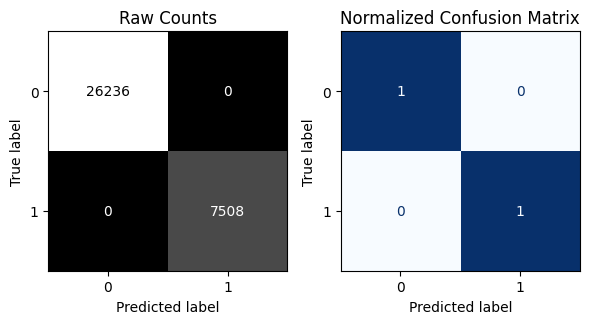


----------------------------------------------------------------------
 Classification Metrics: Test Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.94      0.93      0.94      8757
           1       0.77      0.79      0.78      2492

    accuracy                           0.90     11249
   macro avg       0.86      0.86      0.86     11249
weighted avg       0.90      0.90      0.90     11249



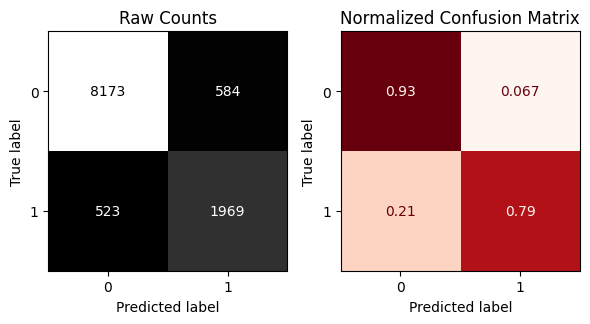

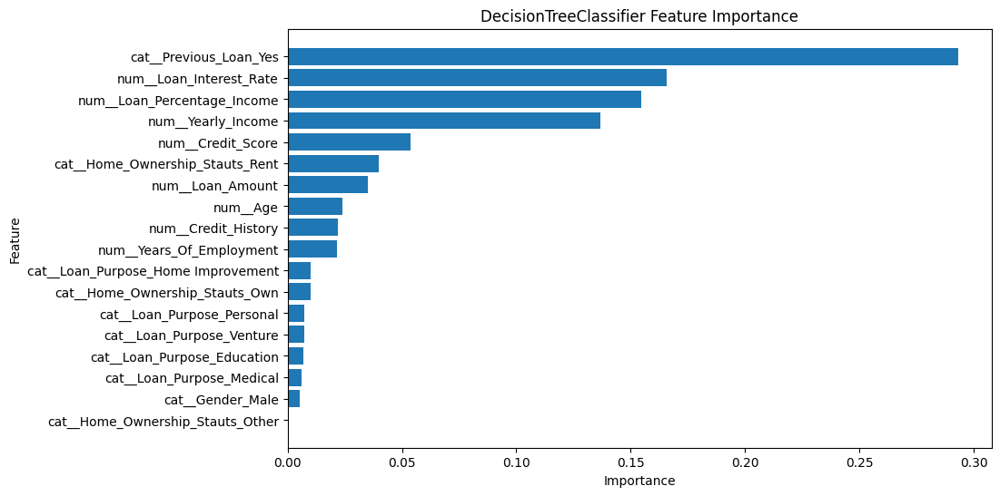

RandomForestClassifier
----------------------------------------------------------------------
 Classification Metrics: Training Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     26236
           1       1.00      1.00      1.00      7508

    accuracy                           1.00     33744
   macro avg       1.00      1.00      1.00     33744
weighted avg       1.00      1.00      1.00     33744



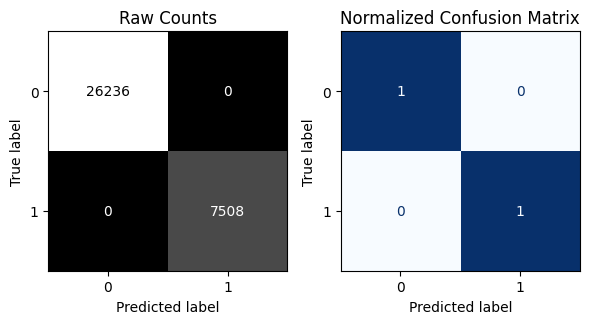


----------------------------------------------------------------------
 Classification Metrics: Test Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.94      0.97      0.96      8757
           1       0.90      0.77      0.83      2492

    accuracy                           0.93     11249
   macro avg       0.92      0.87      0.89     11249
weighted avg       0.93      0.93      0.93     11249



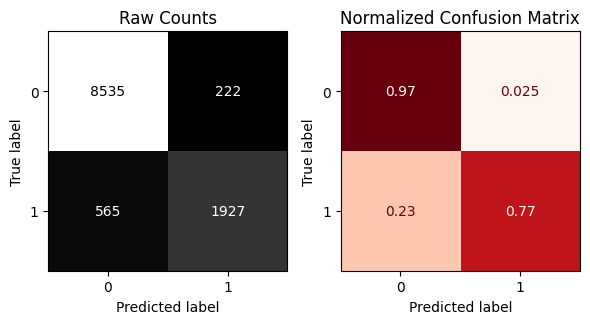

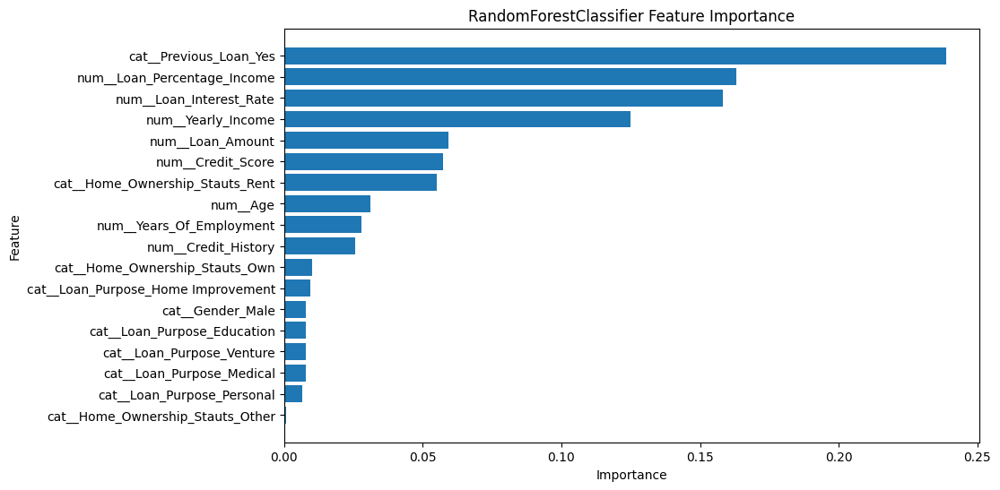

GradientBoostingClassifier
----------------------------------------------------------------------
 Classification Metrics: Training Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.94      0.97      0.95     26236
           1       0.88      0.77      0.82      7508

    accuracy                           0.93     33744
   macro avg       0.91      0.87      0.89     33744
weighted avg       0.92      0.93      0.92     33744



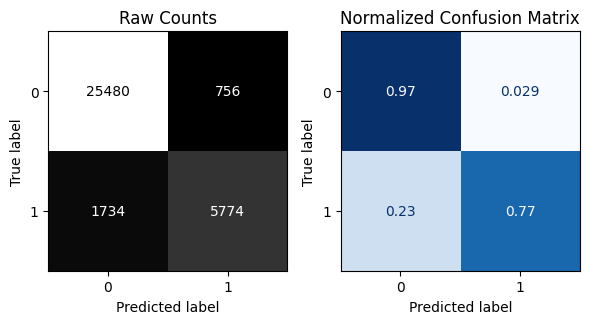


----------------------------------------------------------------------
 Classification Metrics: Test Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.93      0.97      0.95      8757
           1       0.88      0.76      0.81      2492

    accuracy                           0.92     11249
   macro avg       0.90      0.86      0.88     11249
weighted avg       0.92      0.92      0.92     11249



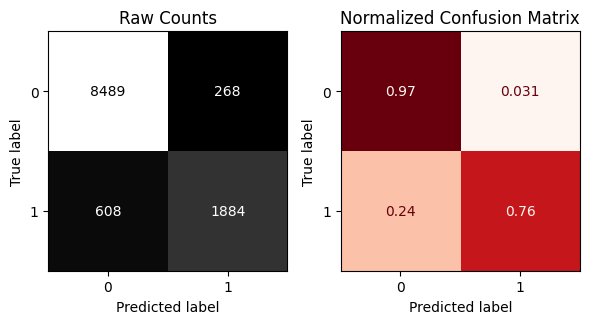

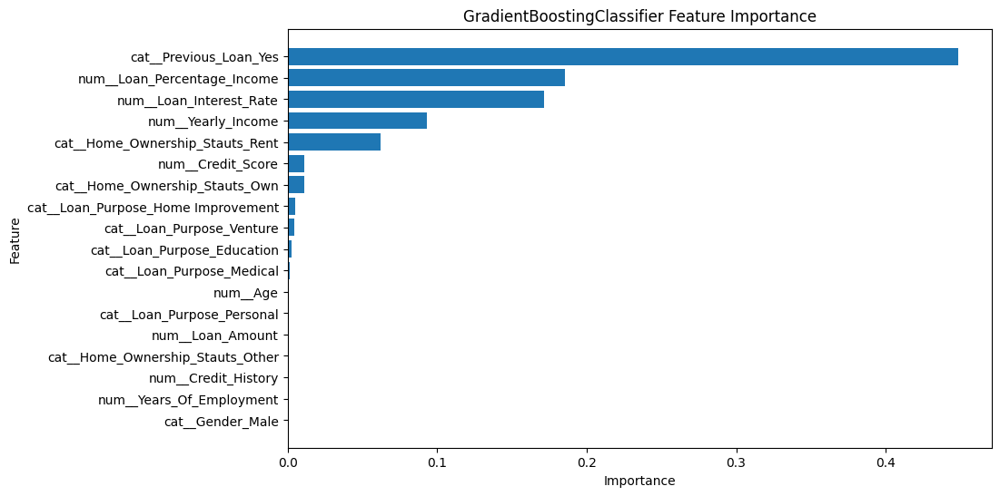

AdaBoostClassifier
----------------------------------------------------------------------
 Classification Metrics: Training Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.94      0.94      0.94     26236
           1       0.80      0.78      0.79      7508

    accuracy                           0.91     33744
   macro avg       0.87      0.86      0.86     33744
weighted avg       0.91      0.91      0.91     33744



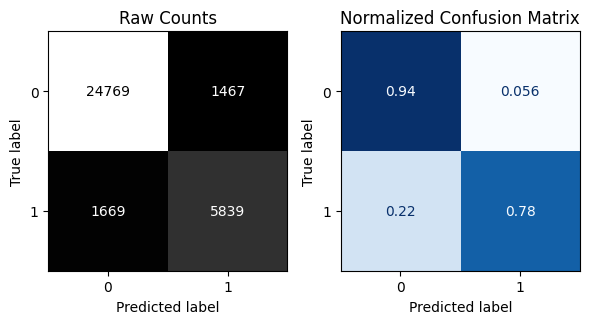


----------------------------------------------------------------------
 Classification Metrics: Test Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.94      0.94      0.94      8757
           1       0.79      0.78      0.79      2492

    accuracy                           0.91     11249
   macro avg       0.86      0.86      0.86     11249
weighted avg       0.91      0.91      0.91     11249



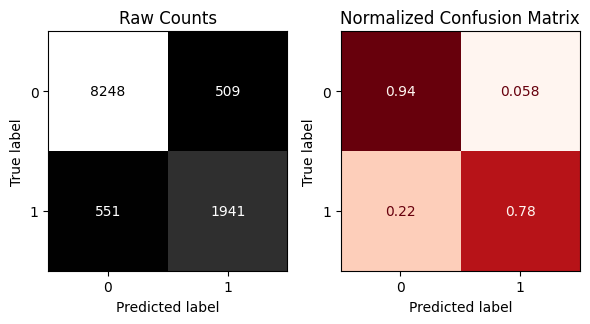

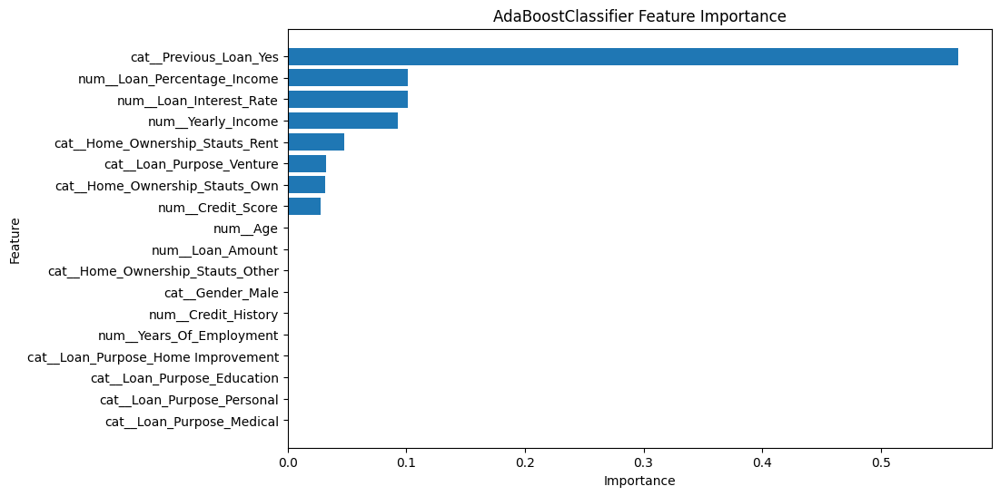

BaggingClassifier
----------------------------------------------------------------------
 Classification Metrics: Training Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.99      1.00      1.00     26236
           1       1.00      0.98      0.99      7508

    accuracy                           0.99     33744
   macro avg       1.00      0.99      0.99     33744
weighted avg       0.99      0.99      0.99     33744



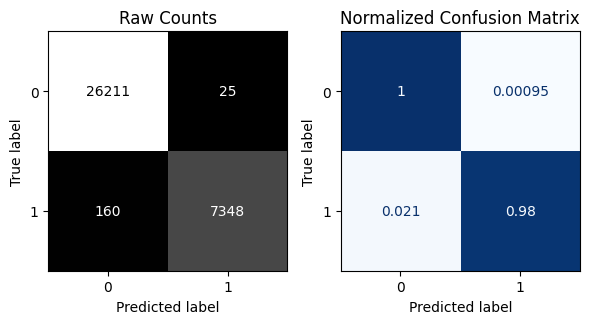


----------------------------------------------------------------------
 Classification Metrics: Test Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.93      0.97      0.95      8757
           1       0.87      0.76      0.81      2492

    accuracy                           0.92     11249
   macro avg       0.90      0.86      0.88     11249
weighted avg       0.92      0.92      0.92     11249



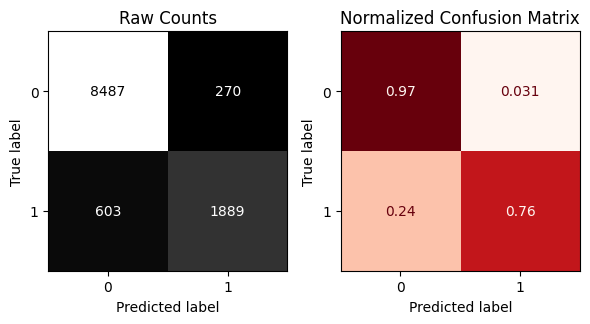

BaggingClassifier does not support feature_importances_
ExtraTreesClassifier
----------------------------------------------------------------------
 Classification Metrics: Training Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     26236
           1       1.00      1.00      1.00      7508

    accuracy                           1.00     33744
   macro avg       1.00      1.00      1.00     33744
weighted avg       1.00      1.00      1.00     33744



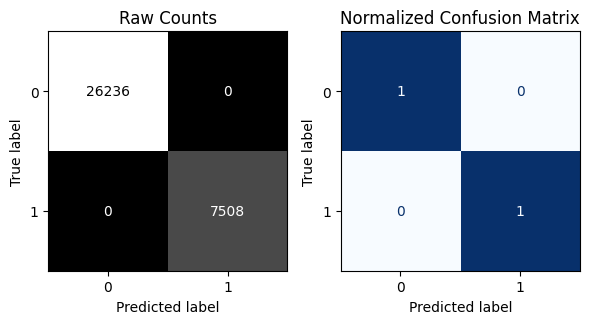


----------------------------------------------------------------------
 Classification Metrics: Test Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.94      0.97      0.95      8757
           1       0.87      0.77      0.82      2492

    accuracy                           0.92     11249
   macro avg       0.90      0.87      0.88     11249
weighted avg       0.92      0.92      0.92     11249



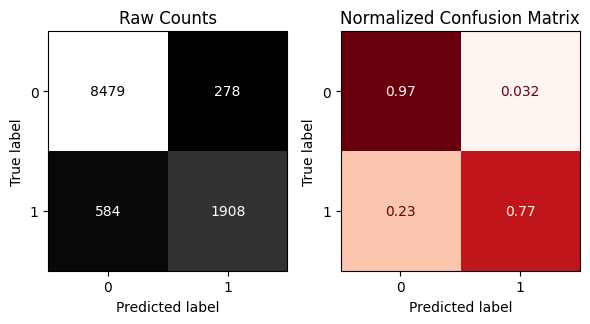

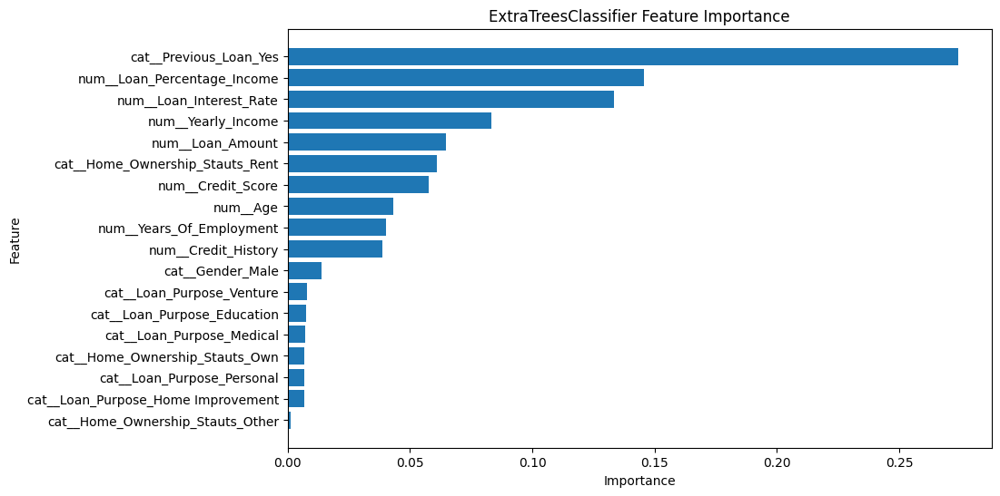

KNeighborsClassifier
----------------------------------------------------------------------
 Classification Metrics: Training Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.94      0.97      0.96     26236
           1       0.88      0.80      0.84      7508

    accuracy                           0.93     33744
   macro avg       0.91      0.88      0.90     33744
weighted avg       0.93      0.93      0.93     33744



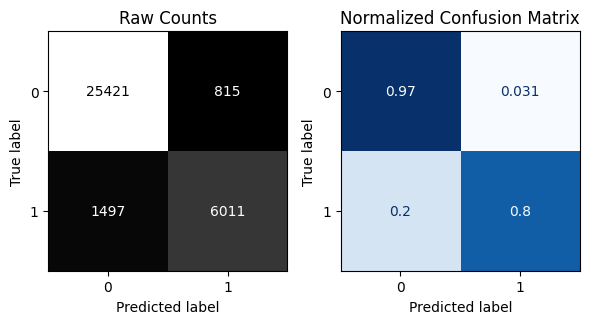


----------------------------------------------------------------------
 Classification Metrics: Test Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.93      0.95      0.94      8757
           1       0.82      0.73      0.77      2492

    accuracy                           0.90     11249
   macro avg       0.87      0.84      0.86     11249
weighted avg       0.90      0.90      0.90     11249



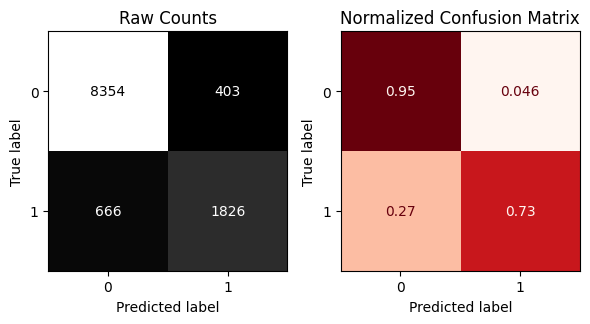

KNeighborsClassifier does not support feature_importances_
XGBClassifier
----------------------------------------------------------------------
 Classification Metrics: Training Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.97      0.99      0.98     26236
           1       0.97      0.90      0.93      7508

    accuracy                           0.97     33744
   macro avg       0.97      0.95      0.96     33744
weighted avg       0.97      0.97      0.97     33744



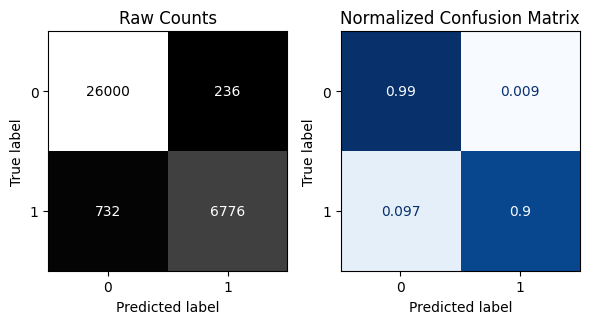


----------------------------------------------------------------------
 Classification Metrics: Test Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.94      0.97      0.96      8757
           1       0.88      0.80      0.84      2492

    accuracy                           0.93     11249
   macro avg       0.91      0.88      0.90     11249
weighted avg       0.93      0.93      0.93     11249



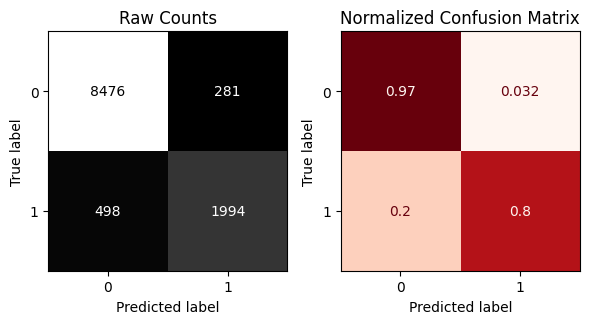

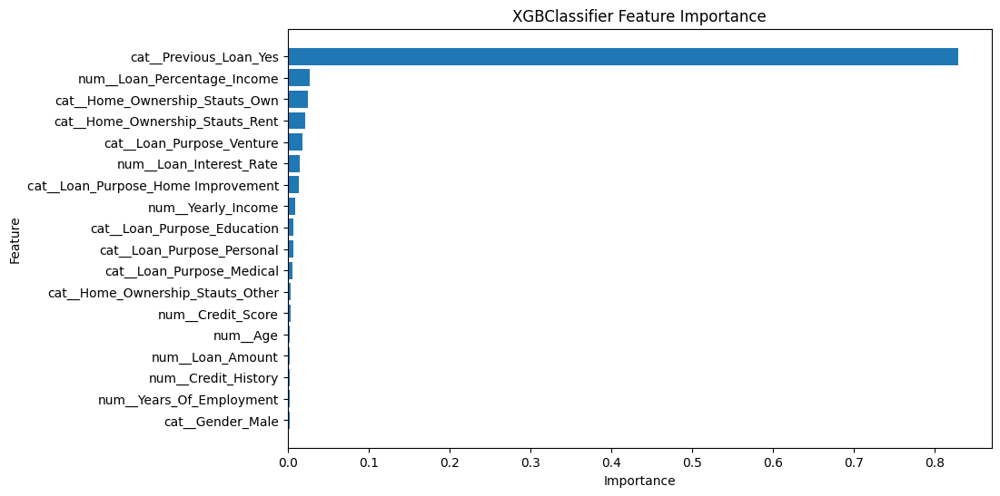

LGBMClassifier
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 7508, number of negative: 26236
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.003025 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1200
[LightGBM] [Info] Number of data points in the train set: 33744, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.222499 -> initscore=-1.251163
[LightGBM] [Info] Start training from score -1.251163
----------------------------------------------------------------------
 Classification Metrics: Training Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.95      0.98      0.97     26236
           1       0.93      0.83      0.88      7508

   

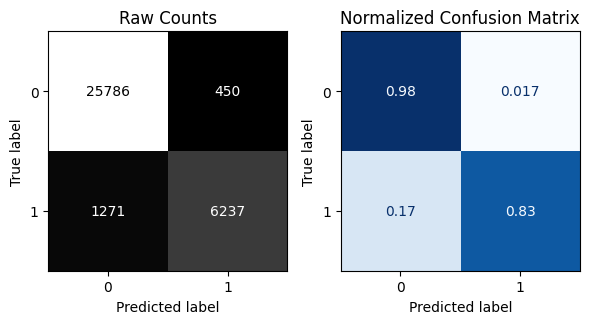


----------------------------------------------------------------------
 Classification Metrics: Test Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.94      0.97      0.96      8757
           1       0.90      0.79      0.84      2492

    accuracy                           0.93     11249
   macro avg       0.92      0.88      0.90     11249
weighted avg       0.93      0.93      0.93     11249



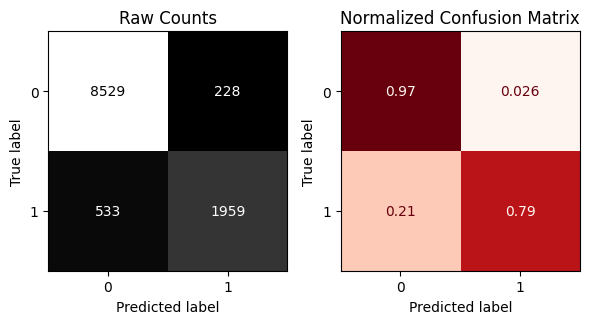

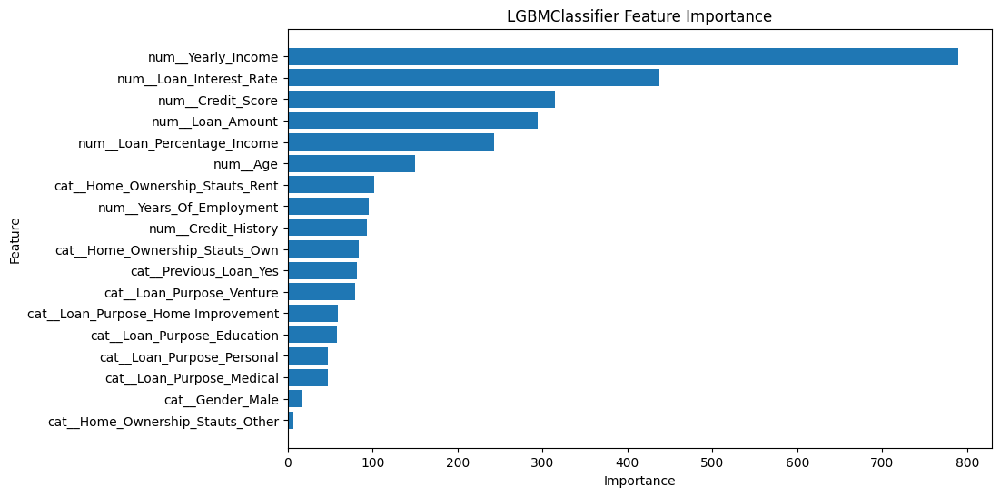

In [ ]:
for model in models:
    print('===' * 30)
    print(model.__class__.__name__)

    model_pipe = make_pipeline(preprocessor, model)
    model_pipe.fit(X_train, y_train)

    evaluate_classification(model_pipe, X_train, y_train, X_test, y_test)

    # Access the actual model after preprocessing
    trained_model = model_pipe.named_steps[model.__class__.__name__.lower()]

    # Ensure the model has feature_importances_
    if hasattr(trained_model, 'feature_importances_'):
        importances = trained_model.feature_importances_
        feature_names = preprocessor.get_feature_names_out()

        # Create and sort the importance DataFrame
        importances_df = pd.DataFrame({
            'Feature': feature_names,
            'Importance': importances
        }).sort_values(by='Importance', ascending=False)

        # Plotting
        plt.figure(figsize=(10, 6))
        plt.barh(importances_df['Feature'], importances_df['Importance'])
        plt.xlabel('Importance')
        plt.ylabel('Feature')
        plt.title(f'{model.__class__.__name__} Feature Importance')
        plt.gca().invert_yaxis()
        plt.show()
    else:
        print(f'{model.__class__.__name__} does not support feature_importances_')

    print('===' * 30)

# Tunning Decision Threshold

In [ ]:
xgb = XGBClassifier(learning_rate=0.5, max_depth=10, max_features=0.35000000000000003, min_samples_leaf=3, min_samples_split=8, n_estimators=100, subsample=1.0, random_state=42,  probability=True)

In [ ]:
xgb_pipe = make_pipeline(preprocessor,xgb)
xgb_pipe.fit(X_train,y_train)

/usr/local/lib/python3.11/dist-packages/xgboost/core.py:158: UserWarning: [05:21:05] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "max_features", "min_samples_leaf", "min_samples_split", "probability" } are not used.

  warnings.warn(smsg, UserWarning)


Pipeline(steps=[('columntransformer',
                 ColumnTransformer(transformers=[('num',
                                                  Pipeline(steps=[('standardscaler',
                                                                   StandardScaler())]),
                                                  Index(['Age', 'Yearly_Income', 'Years_Of_Employment', 'Loan_Amount',
       'Loan_Interest_Rate', 'Loan_Percentage_Income', 'Credit_History',
       'Credit_Score'],
      dtype='object')),
                                                 ('cat',
                                                  Pipeline(steps=[('onehotencoder',
                                                                   OneHotEncoder(drop=...
                               importance_type=None,
                               interaction_constraints=None, learning_rate=0.5,
                               max_bin=None, max_cat_threshold=None,
                               max_cat_to_onehot=None, max_delta_step=None,
                               max_depth=10, max_features=0.35000000000000003,
                               max_leaves=None, min_child_weight=None,
                               min_samples_leaf=3, min_samples_split=8,
                               missing=nan, monotone_constraints=None,
                               multi_strategy=None, n_estimators=100, ...))])

In [ ]:
test_preds = xgb_pipe.predict(X_test)

In [ ]:
test_probs = xgb_pipe.predict_proba(X_test)

In [ ]:
df['_LoanStatus'].unique()

array(['Paid', 'Defaulted'], dtype=object)

In [ ]:
def convert_probs_to_preds(probabilities, threshold, pos_class=1, classes=['Defaulted','Paid']):
  predictions = [classes[1] if prob[pos_class] > threshold else classes[0] for prob in probabilities]
  return predictions

In [ ]:
thresholds = np.arange(start=0, stop=1.05, step=.05)

In [ ]:
recalls = []
precisions = []
accuracies = []

In [ ]:
for thresh in thresholds:
  preds = convert_probs_to_preds(test_probs, thresh, classes=np.unique(y_test))
  recalls.append(recall_score(y_test, preds, pos_label=1))
  precisions.append(precision_score(y_test, preds, pos_label=0))
  accuracies.append(accuracy_score(y_test, preds))

/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


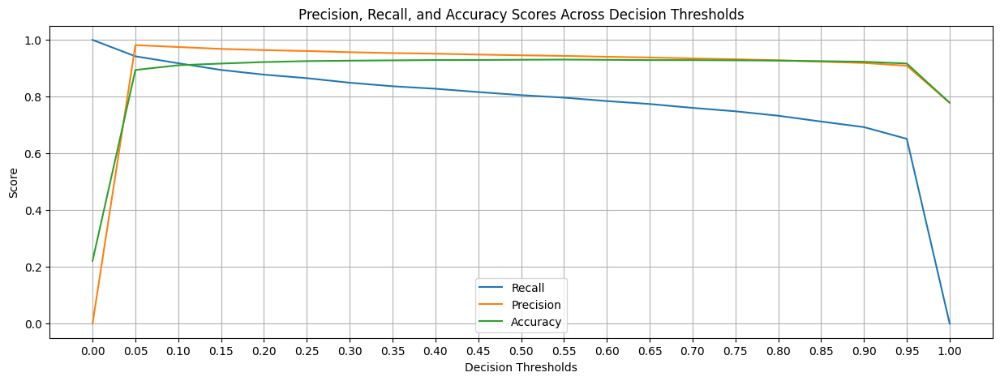

In [ ]:
plt.figure(figsize=(15,5))
plt.plot(thresholds, recalls, label='Recall')
plt.plot(thresholds, precisions, label='Precision')
plt.plot(thresholds, accuracies, label='Accuracy')
plt.legend()
plt.title('Precision, Recall, and Accuracy Scores Across Decision Thresholds')
plt.xlabel('Decision Thresholds')
plt.ylabel('Score')
plt.grid()
plt.xticks(thresholds)
plt.show()

In [ ]:
test_preds = convert_probs_to_preds(test_probs, .25)

              precision    recall  f1-score   support

           0       0.96      0.94      0.95      8757
           1       0.81      0.87      0.84      2492

    accuracy                           0.93     11249
   macro avg       0.89      0.90      0.89     11249
weighted avg       0.93      0.93      0.93     11249



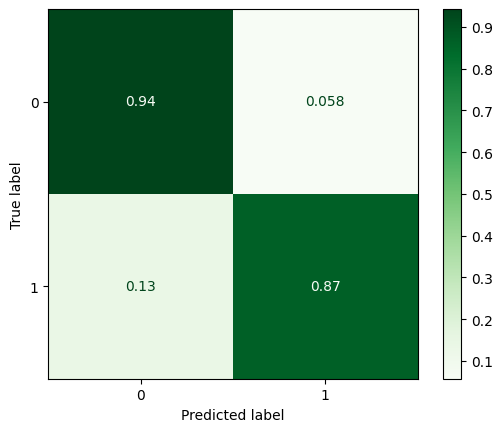

In [ ]:
test_preds_numeric = [1 if pred == 'Paid' else 0 for pred in test_preds]
ConfusionMatrixDisplay.from_predictions(y_test, test_preds_numeric, normalize='true',cmap='Greens')
print(classification_report(y_test, test_preds_numeric))

In [ ]:
xgb.get_params()

{'objective': 'binary:logistic',
 'base_score': None,
 'booster': None,
 'callbacks': None,
 'colsample_bylevel': None,
 'colsample_bynode': None,
 'colsample_bytree': None,
 'device': None,
 'early_stopping_rounds': None,
 'enable_categorical': False,
 'eval_metric': None,
 'feature_types': None,
 'gamma': None,
 'grow_policy': None,
 'importance_type': None,
 'interaction_constraints': None,
 'learning_rate': 0.5,
 'max_bin': None,
 'max_cat_threshold': None,
 'max_cat_to_onehot': None,
 'max_delta_step': None,
 'max_depth': 10,
 'max_leaves': None,
 'min_child_weight': None,
 'missing': nan,
 'monotone_constraints': None,
 'multi_strategy': None,
 'n_estimators': 100,
 'n_jobs': None,
 'num_parallel_tree': None,
 'random_state': 42,
 'reg_alpha': None,
 'reg_lambda': None,
 'sampling_method': None,
 'scale_pos_weight': None,
 'subsample': 1.0,
 'tree_method': None,
 'validate_parameters': None,
 'verbosity': None,
 'max_features': 0.35000000000000003,
 'min_samples_leaf': 3,
 'min_s

In [ ]:
from sklearn.base import BaseEstimator, ClassifierMixin

class ThresholdedClassifier(BaseEstimator, ClassifierMixin):
    def __init__(self, model, threshold=0.50):
        self.model = model
        self.threshold = threshold

    def fit(self, X, y):
        self.model.fit(X, y)
        return self

    def predict(self, X):
        proba = self.model.predict_proba(X)[:, 1]
        return (proba >= self.threshold).astype(int)

    def predict_proba(self, X):
        return self.model.predict_proba(X)

    def score(self, X, y):
        return self.model.score(X, y)

In [ ]:
xgb_model = XGBClassifier(learning_rate=0.5, max_depth=10, max_features=0.35000000000000003, min_samples_leaf=3, min_samples_split=8, n_estimators=100, subsample=1.0, random_state=42,  probability=True)
pipeline = make_pipeline(preprocessor, xgb_model)

In [ ]:
thresholded_model = ThresholdedClassifier(model=pipeline, threshold=0.25)
thresholded_model.fit(X_train, y_train)

/usr/local/lib/python3.11/dist-packages/xgboost/core.py:158: UserWarning: [05:21:19] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "max_features", "min_samples_leaf", "min_samples_split", "probability" } are not used.

  warnings.warn(smsg, UserWarning)


ThresholdedClassifier(model=Pipeline(steps=[('columntransformer',
                                             ColumnTransformer(transformers=[('num',
                                                                              Pipeline(steps=[('standardscaler',
                                                                                               StandardScaler())]),
                                                                              Index(['Age', 'Yearly_Income', 'Years_Of_Employment', 'Loan_Amount',
       'Loan_Interest_Rate', 'Loan_Percentage_Income', 'Credit_History',
       'Credit_Score'],
      dtype='object')),
                                                                             ('cat',
                                                                              Pipeline(steps=[('onehot...
                                                           importance_type=None,
                                                           interaction_constraints=None,
                                                           learning_rate=0.5,
                                                           max_bin=None,
                                                           max_cat_threshold=None,
                                                           max_cat_to_onehot=None,
                                                           max_delta_step=None,
                                                           max_depth=10,
                                                           max_features=0.35000000000000003,
                                                           max_leaves=None,
                                                           min_child_weight=None,
                                                           min_samples_leaf=3,
                                                           min_samples_split=8,
                                                           missing=nan,
                                                           monotone_constraints=None,
                                                           multi_strategy=None,
                                                           n_estimators=100, ...))]),
                      threshold=0.25)

----------------------------------------------------------------------
 Classification Metrics: Training Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     26236
           1       1.00      1.00      1.00      7508

    accuracy                           1.00     33744
   macro avg       1.00      1.00      1.00     33744
weighted avg       1.00      1.00      1.00     33744



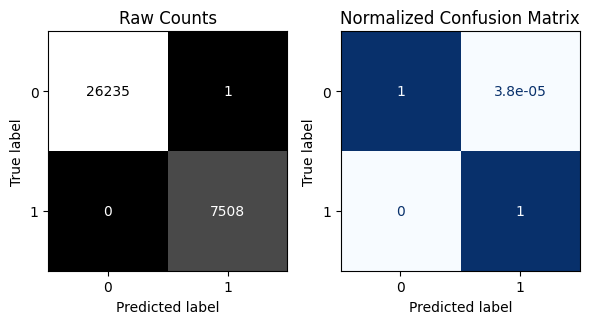


----------------------------------------------------------------------
 Classification Metrics: Test Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.96      0.94      0.95      8757
           1       0.81      0.87      0.84      2492

    accuracy                           0.93     11249
   macro avg       0.89      0.90      0.89     11249
weighted avg       0.93      0.93      0.93     11249



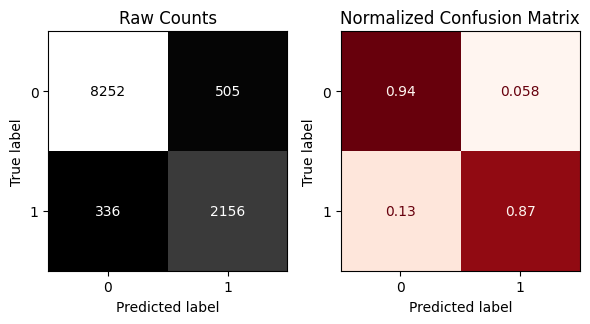

In [ ]:
evaluate_classification(thresholded_model, X_train, y_train, X_test, y_test)

# Permutation Importance

## Imports

In [ ]:
def get_color_dict(importances, color_rest='#006ba4' , color_top='green',top_n=7):
    ## color -coding top 5 bars
    highlight_feats = importances.sort_values(ascending=True).tail(top_n).index
    colors_dict = {col: color_top if col in highlight_feats else color_rest for col in importances.index}
    return colors_dict
def plot_importance_color(importances, top_n=None,  figsize=(8,6), color_dict=None):
    # sorting with asc=false for correct order of bars
    if top_n==None:
        ## sort all features and set title
        plot_vals = importances.sort_values()
        title = "All Features - Ranked by Importance"
    else:
        ## sort features and keep top_n and set title
        plot_vals = importances.sort_values().tail(top_n)
        title = f"Top {top_n} Most Important Features"
    ## create plot with colors, if provided
    if color_dict is not None:
        ## Getting color list and saving to plot_kws
        colors = plot_vals.index.map(color_dict)
        ax = plot_vals.plot(kind='barh', figsize=figsize, color=colors)
    else:
        ## create plot without colors, if not provided
        ax = plot_vals.plot(kind='barh', figsize=figsize)

    # set titles and axis labels
    ax.set(xlabel='Importance',
           ylabel='Feature Names',
           title=title)
    ## return ax in case want to continue to update/modify figure
    return ax

from sklearn.inspection import permutation_importance
def get_importances(model, feature_names=None,name='Feature Importance',sort=False, ascending=True):
    ## checking for feature names
    if feature_names == None:
        feature_names = model.feature_names_in_
    ## Saving the feature importances
    importances = pd.Series(model.feature_importances_, index= feature_names,name=name)
    # sort importances
    if sort == True:
        importances = importances.sort_values(ascending=ascending)
    return importances
def plot_importance(importances, top_n=None,  figsize=(8,6)):
    # sorting with asc=false for correct order of bars
    if top_n==None:
        ## sort all features and set title
        plot_vals = importances.sort_values()
        title = "All Features - Ranked by Importance"
    else:
        ## sort features and keep top_n and set title
        plot_vals = importances.sort_values().tail(top_n)
        title = f"Top {top_n} Most Important Features"
    ## plotting top N importances
    ax = plot_vals.plot(kind='barh', figsize=figsize)
    ax.set(xlabel='Importance',ylabel='Feature Names',title=title)
    ## return ax in case want to continue to update/modify figure
    return ax

## Plot

In [ ]:
r = permutation_importance(thresholded_model,X_test,y_test,n_jobs=-1,n_repeats=5)
r.keys()

dict_keys(['importances_mean', 'importances_std', 'importances'])

In [ ]:
permutation_importances = pd.Series(r['importances_mean'],index=X_test.columns,name = 'permutation importance')
permutation_importances = permutation_importances.sort_values(ascending=False)
permutation_importances

,permutation importance
Previous_Loan,1.117966e-01
Loan_Interest_Rate,5.106232e-02
Loan_Percentage_Income,5.097342e-02
Yearly_Income,3.897235e-02
Home_Ownership_Stauts,3.127389e-02
Loan_Purpose,1.937950e-02
Credit_Score,6.044982e-03
Loan_Amount,5.458263e-03
Age,3.520313e-03
Years_Of_Employment,1.137879e-03


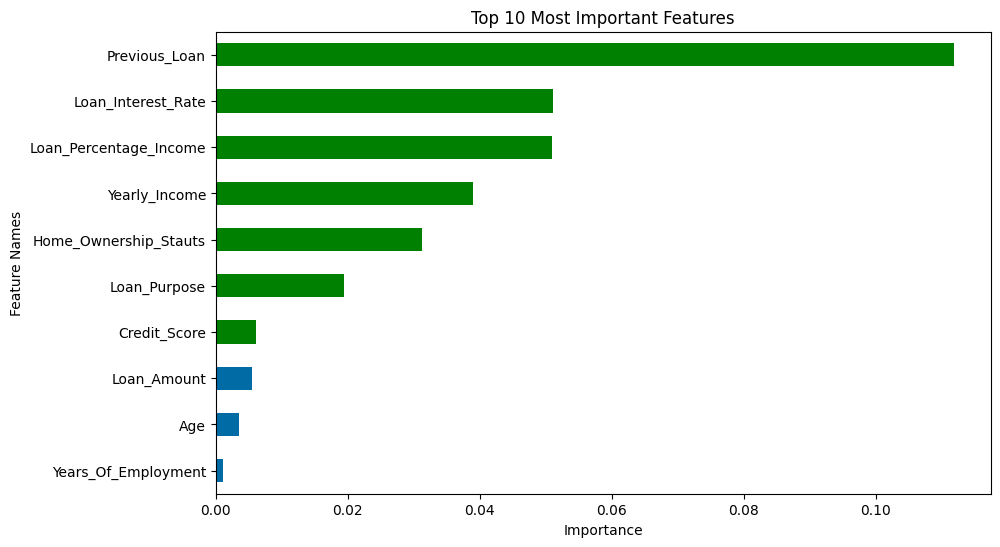

In [ ]:
plot_importance_color(permutation_importances,top_n=10,figsize=(10,6),color_dict=get_color_dict(permutation_importances));

# Grid Search

In [ ]:
thresholded_model.get_params()

{'model__memory': None,
 'model__steps': [('columntransformer',
   ColumnTransformer(transformers=[('num',
                                    Pipeline(steps=[('standardscaler',
                                                     StandardScaler())]),
                                    Index(['Age', 'Yearly_Income', 'Years_Of_Employment', 'Loan_Amount',
          'Loan_Interest_Rate', 'Loan_Percentage_Income', 'Credit_History',
          'Credit_Score'],
         dtype='object')),
                                   ('cat',
                                    Pipeline(steps=[('onehotencoder',
                                                     OneHotEncoder(drop='first',
                                                                   sparse_output=False))]),
                                    Index(['Gender', 'Home_Ownership_Stauts', 'Loan_Purpose', 'Previous_Loan'], dtype='object'))])),
  ('xgbclassifier',
   XGBClassifier(base_score=None, booster=None, callbacks=None,
          

In [ ]:
xgb = XGBClassifier(learning_rate=0.5, max_depth=10, max_features=0.35000000000000003, min_samples_leaf=3, min_samples_split=8, n_estimators=100, subsample=1.0, random_state=42,  probability=True)

In [ ]:
thresholded_model.model.named_steps['xgbclassifier'].objective

'binary:logistic'

In [ ]:
from sklearn.model_selection import GridSearchCV

param_grid = {
    'model__xgbclassifier__max_depth': [9, 11, 12,15],
    'model__xgbclassifier__learning_rate': [0.01, 0.1, 0.5,0.3],
    'model__xgbclassifier__n_estimators': [100, 110, 120,90],
    'model__xgbclassifier__learning_rate': [0.01, 0.1, 0.5],
    'model__xgbclassifier__subsample': [0.8, 1.0,2.0,5.0],
    'model__xgbclassifier__max_features': [0.35, 0.37,0.40,0.50],
    'model__xgbclassifier__min_samples_split': [2, 4,8,10,12],
    'model__xgbclassifier__min_samples_leaf': [2,3,4,5],
    'model__xgbclassifier__probability': [True],
}

In [ ]:
grid_search = GridSearchCV(thresholded_model, param_grid, cv=5, scoring='accuracy', verbose=1)
grid_search.fit(X_train, y_train)

print("Best hyperparameters:", grid_search.best_params_)
print("Best score:", grid_search.best_score_)

* Best hyperparameters: {'model__xgbclassifier__learning_rate': 0.5, 'model__xgbclassifier__max_depth': 15, 'model__xgbclassifier__max_features': 0.35, 'model__xgbclassifier__min_samples_leaf': 2, 'model__xgbclassifier__min_samples_split': 2, 'model__xgbclassifier__n_estimators': 120, 'model__xgbclassifier__probability': True, 'model__xgbclassifier__subsample': 1.0}
* Best score: 0.9261201663896639

----------------------------------------------------------------------
 Classification Metrics: Training Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     26236
           1       1.00      1.00      1.00      7508

    accuracy                           1.00     33744
   macro avg       1.00      1.00      1.00     33744
weighted avg       1.00      1.00      1.00     33744



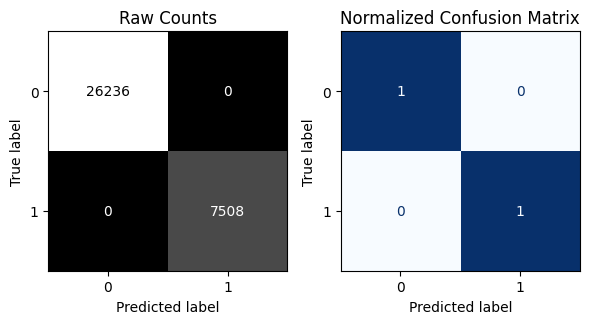


----------------------------------------------------------------------
 Classification Metrics: Test Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.96      0.95      0.95      8757
           1       0.82      0.85      0.84      2492

    accuracy                           0.93     11249
   macro avg       0.89      0.90      0.90     11249
weighted avg       0.93      0.93      0.93     11249



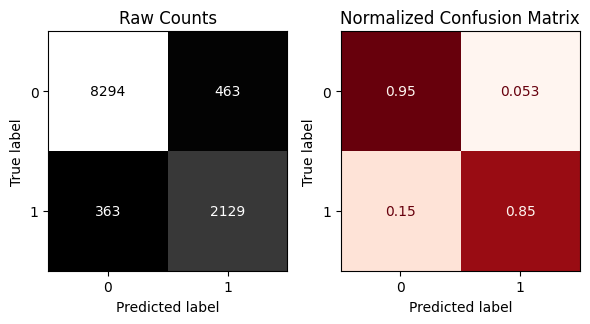

In [ ]:
best_thresholded_model = grid_search.best_estimator_
evaluate_classification(best_thresholded_model, X_train, y_train, X_test, y_test)

# Clustring

In [ ]:
c = df.copy()

In [ ]:
from sklearn.inspection import permutation_importance
from sklearn.linear_model import LogisticRegression
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from sklearn.metrics import f1_score

In [ ]:
df.head()

,Age,Gender,Education_Level,Yearly_Income,Years_Of_Employment,Home_Ownership_Stauts,Loan_Amount,Loan_Purpose,Loan_Interest_Rate,Loan_Percentage_Income,Credit_History,Credit_Score,Previous_Loan,Loan_Status,_LoanStatus
0,22,Female,Master,71948,0,Rent,35000,Personal,16.02,49,3,561,No,1,Paid
1,21,Female,High School,12282,0,Own,1000,Education,11.14,8,2,504,Yes,0,Defaulted
2,25,Female,High School,12438,3,Mortgage,5500,Medical,12.87,44,3,635,No,1,Paid
3,23,Female,Bachelor,79753,0,Rent,35000,Medical,15.23,44,2,675,No,1,Paid
4,24,Male,Master,66135,1,Rent,35000,Medical,14.27,53,4,586,No,1,Paid


In [ ]:
c

,Age,Gender,Education_Level,Yearly_Income,Years_Of_Employment,Home_Ownership_Stauts,Loan_Amount,Loan_Purpose,Loan_Interest_Rate,Loan_Percentage_Income,Credit_History,Credit_Score,Previous_Loan,Loan_Status,_LoanStatus
0,22,Female,Master,71948,0,Rent,35000,Personal,16.02,49,3,561,No,1,Paid
1,21,Female,High School,12282,0,Own,1000,Education,11.14,8,2,504,Yes,0,Defaulted
2,25,Female,High School,12438,3,Mortgage,5500,Medical,12.87,44,3,635,No,1,Paid
3,23,Female,Bachelor,79753,0,Rent,35000,Medical,15.23,44,2,675,No,1,Paid
4,24,Male,Master,66135,1,Rent,35000,Medical,14.27,53,4,586,No,1,Paid
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
44995,27,Male,Associate,47971,6,Rent,15000,Medical,15.66,31,3,645,No,1,Paid
44996,37,Female,Associate,65800,17,Rent,9000,Home Improvement,14.07,14,11,621,No,1,Paid
44997,33,Male,Associate,56942,7,Rent,2771,Debt Consolidation,10.02,5,10,668,No,1,Paid
44998,29,Male,Bachelor,33164,4,Rent,12000,Education,13.23,36,6,604,No,1,Paid


In [ ]:
ohe_cols = c.select_dtypes('object').columns

ohe_encoder = OneHotEncoder(handle_unknown='ignore', sparse_output=False)

encoded_data = ohe_encoder.fit_transform(c[ohe_cols])

encoded_feature_names = ohe_encoder.get_feature_names_out(ohe_cols)

encoded_df = pd.DataFrame(encoded_data, columns=encoded_feature_names)

c_encoded = pd.concat([c.drop(columns=ohe_cols), encoded_df], axis=1)

In [ ]:
c_encoded

,Age,Yearly_Income,Years_Of_Employment,Loan_Amount,Loan_Interest_Rate,Loan_Percentage_Income,Credit_History,Credit_Score,Loan_Status,Gender_Female,...,Loan_Purpose_Debt Consolidation,Loan_Purpose_Education,Loan_Purpose_Home Improvement,Loan_Purpose_Medical,Loan_Purpose_Personal,Loan_Purpose_Venture,Previous_Loan_No,Previous_Loan_Yes,_LoanStatus_Defaulted,_LoanStatus_Paid
0,22,71948,0,35000,16.02,49,3,561,1,1.0,...,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0
1,21,12282,0,1000,11.14,8,2,504,0,1.0,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0
2,25,12438,3,5500,12.87,44,3,635,1,1.0,...,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0
3,23,79753,0,35000,15.23,44,2,675,1,1.0,...,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0
4,24,66135,1,35000,14.27,53,4,586,1,0.0,...,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
44995,27,47971,6,15000,15.66,31,3,645,1,0.0,...,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0
44996,37,65800,17,9000,14.07,14,11,621,1,1.0,...,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0
44997,33,56942,7,2771,10.02,5,10,668,1,0.0,...,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0
44998,29,33164,4,12000,13.23,36,6,604,1,0.0,...,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0


In [ ]:
x = c_encoded.copy()

In [ ]:
scaler = StandardScaler()
X_scaled = pd.DataFrame(scaler.fit_transform(x), columns=x.columns)
X_scaled.head()

,Age,Yearly_Income,Years_Of_Employment,Loan_Amount,Loan_Interest_Rate,Loan_Percentage_Income,Credit_History,Credit_Score,Loan_Status,Gender_Female,...,Loan_Purpose_Debt Consolidation,Loan_Purpose_Education,Loan_Purpose_Home Improvement,Loan_Purpose_Medical,Loan_Purpose_Personal,Loan_Purpose_Venture,Previous_Loan_No,Previous_Loan_Yes,_LoanStatus_Defaulted,_LoanStatus_Paid
0,-0.972715,-0.125715,-0.910147,4.025004,1.682992,4.025572,-0.739351,-1.420299,1.870642,1.110013,...,-0.43449,-0.505287,-0.344892,-0.484299,2.226780,-0.458481,1.016110,-1.016110,-1.870642,1.870642
1,-1.141929,-1.067987,-0.910147,-1.359230,0.044832,-0.685183,-0.997275,-2.551210,-0.534576,1.110013,...,-0.43449,1.979073,-0.344892,-0.484299,-0.449079,-0.458481,-0.984145,0.984145,0.534576,-0.534576
2,-0.465073,-1.065523,-0.403997,-0.646611,0.625573,3.451090,-0.739351,0.047901,1.870642,1.110013,...,-0.43449,-0.505287,-0.344892,2.064842,-0.449079,-0.458481,1.016110,-1.016110,-1.870642,1.870642
3,-0.803501,-0.002455,-0.910147,4.025004,1.417798,3.451090,-0.997275,0.841522,1.870642,1.110013,...,-0.43449,-0.505287,-0.344892,2.064842,-0.449079,-0.458481,1.016110,-1.016110,-1.870642,1.870642
4,-0.634287,-0.217516,-0.741431,4.025004,1.095537,4.485158,-0.481428,-0.924286,1.870642,-0.900891,...,-0.43449,-0.505287,-0.344892,2.064842,-0.449079,-0.458481,1.016110,-1.016110,-1.870642,1.870642


In [ ]:
df.shape

(44993, 15)

In [ ]:
X_scaled.shape

(44993, 30)

In [ ]:
ks = range(2,11)
sils = []
inertias = []
for k in ks:
  kmeans = KMeans(n_clusters=k, n_init = 'auto', random_state=42)
  kmeans.fit(X_scaled)
  sils.append(silhouette_score(X_scaled, kmeans.labels_))
  inertias.append(kmeans.inertia_)

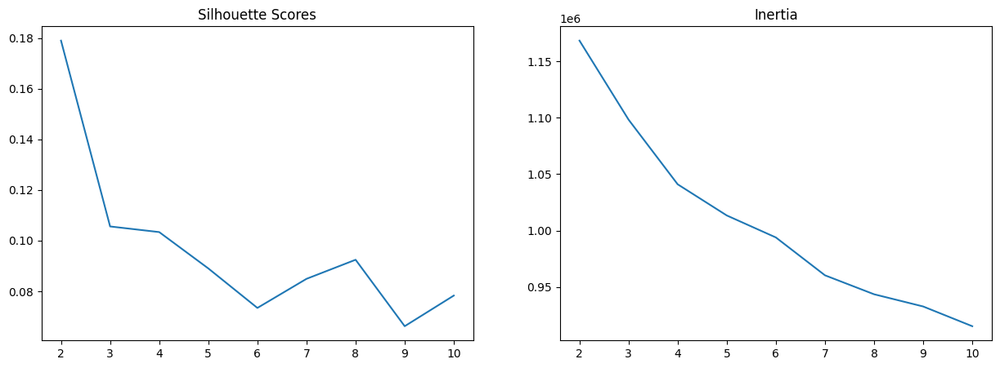

In [ ]:
fig, axes = plt.subplots(1,2, figsize=(15,5))
axes[0].plot(ks, sils)
axes[0].set_title('Silhouette Scores')
axes[0].set_xticks(ks)
axes[1].plot(ks, inertias)
axes[1].set_title('Inertia')
axes[1].set_xticks(ks);

In [ ]:
kmeans = KMeans(n_clusters=3, n_init= 'auto', random_state=42)
kmeans.fit(X_scaled)

KMeans(n_clusters=3, random_state=42)

In [ ]:
X_scaled['cluster'] = kmeans.labels_

In [ ]:
X_scaled.head()

,Age,Yearly_Income,Years_Of_Employment,Loan_Amount,Loan_Interest_Rate,Loan_Percentage_Income,Credit_History,Credit_Score,Loan_Status,Gender_Female,...,Loan_Purpose_Education,Loan_Purpose_Home Improvement,Loan_Purpose_Medical,Loan_Purpose_Personal,Loan_Purpose_Venture,Previous_Loan_No,Previous_Loan_Yes,_LoanStatus_Defaulted,_LoanStatus_Paid,cluster
0,-0.972715,-0.125715,-0.910147,4.025004,1.682992,4.025572,-0.739351,-1.420299,1.870642,1.110013,...,-0.505287,-0.344892,-0.484299,2.226780,-0.458481,1.016110,-1.016110,-1.870642,1.870642,1
1,-1.141929,-1.067987,-0.910147,-1.359230,0.044832,-0.685183,-0.997275,-2.551210,-0.534576,1.110013,...,1.979073,-0.344892,-0.484299,-0.449079,-0.458481,-0.984145,0.984145,0.534576,-0.534576,2
2,-0.465073,-1.065523,-0.403997,-0.646611,0.625573,3.451090,-0.739351,0.047901,1.870642,1.110013,...,-0.505287,-0.344892,2.064842,-0.449079,-0.458481,1.016110,-1.016110,-1.870642,1.870642,1
3,-0.803501,-0.002455,-0.910147,4.025004,1.417798,3.451090,-0.997275,0.841522,1.870642,1.110013,...,-0.505287,-0.344892,2.064842,-0.449079,-0.458481,1.016110,-1.016110,-1.870642,1.870642,1
4,-0.634287,-0.217516,-0.741431,4.025004,1.095537,4.485158,-0.481428,-0.924286,1.870642,-0.900891,...,-0.505287,-0.344892,2.064842,-0.449079,-0.458481,1.016110,-1.016110,-1.870642,1.870642,1


In [ ]:
x['cluster'] = kmeans.labels_
x.head()

,Age,Yearly_Income,Years_Of_Employment,Loan_Amount,Loan_Interest_Rate,Loan_Percentage_Income,Credit_History,Credit_Score,Loan_Status,Gender_Female,...,Loan_Purpose_Education,Loan_Purpose_Home Improvement,Loan_Purpose_Medical,Loan_Purpose_Personal,Loan_Purpose_Venture,Previous_Loan_No,Previous_Loan_Yes,_LoanStatus_Defaulted,_LoanStatus_Paid,cluster
0,22,71948,0,35000,16.02,49,3,561,1,1.0,...,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,1
1,21,12282,0,1000,11.14,8,2,504,0,1.0,...,1.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,2
2,25,12438,3,5500,12.87,44,3,635,1,1.0,...,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,1
3,23,79753,0,35000,15.23,44,2,675,1,1.0,...,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,1
4,24,66135,1,35000,14.27,53,4,586,1,0.0,...,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,1


In [ ]:
df['cluster'] = kmeans.labels_
df.head()

,Age,Gender,Education_Level,Yearly_Income,Years_Of_Employment,Home_Ownership_Stauts,Loan_Amount,Loan_Purpose,Loan_Interest_Rate,Loan_Percentage_Income,Credit_History,Credit_Score,Previous_Loan,Loan_Status,_LoanStatus,cluster
0,22,Female,Master,71948,0,Rent,35000,Personal,16.02,49,3,561,No,1,Paid,1
1,21,Female,High School,12282,0,Own,1000,Education,11.14,8,2,504,Yes,0,Defaulted,2
2,25,Female,High School,12438,3,Mortgage,5500,Medical,12.87,44,3,635,No,1,Paid,1
3,23,Female,Bachelor,79753,0,Rent,35000,Medical,15.23,44,2,675,No,1,Paid,1
4,24,Male,Master,66135,1,Rent,35000,Medical,14.27,53,4,586,No,1,Paid,1


In [ ]:
cluster_groups = x.groupby('cluster', as_index=False).mean()
cluster_groups

,cluster,Age,Yearly_Income,Years_Of_Employment,Loan_Amount,Loan_Interest_Rate,Loan_Percentage_Income,Credit_History,Credit_Score,Loan_Status,...,Loan_Purpose_Debt Consolidation,Loan_Purpose_Education,Loan_Purpose_Home Improvement,Loan_Purpose_Medical,Loan_Purpose_Personal,Loan_Purpose_Venture,Previous_Loan_No,Previous_Loan_Yes,_LoanStatus_Defaulted,_LoanStatus_Paid
0,0,27.912116,86366.324673,5.538223,9292.742456,10.484484,12.167383,5.941152,632.646861,0.0,...,0.143160,0.218156,0.102634,0.174680,0.171730,0.189638,0.346566,0.653434,1.0,0.0
1,1,27.521300,59886.096900,5.178000,10855.689800,12.856794,20.222700,5.759700,631.887200,1.0,...,0.216300,0.155200,0.125800,0.237800,0.152100,0.112800,1.000000,0.000000,0.0,1.0
2,2,27.691552,84722.821210,5.355539,9129.268568,10.469274,12.183895,5.842777,632.956036,0.0,...,0.141399,0.215926,0.098392,0.178344,0.173047,0.192892,0.347180,0.652820,1.0,0.0


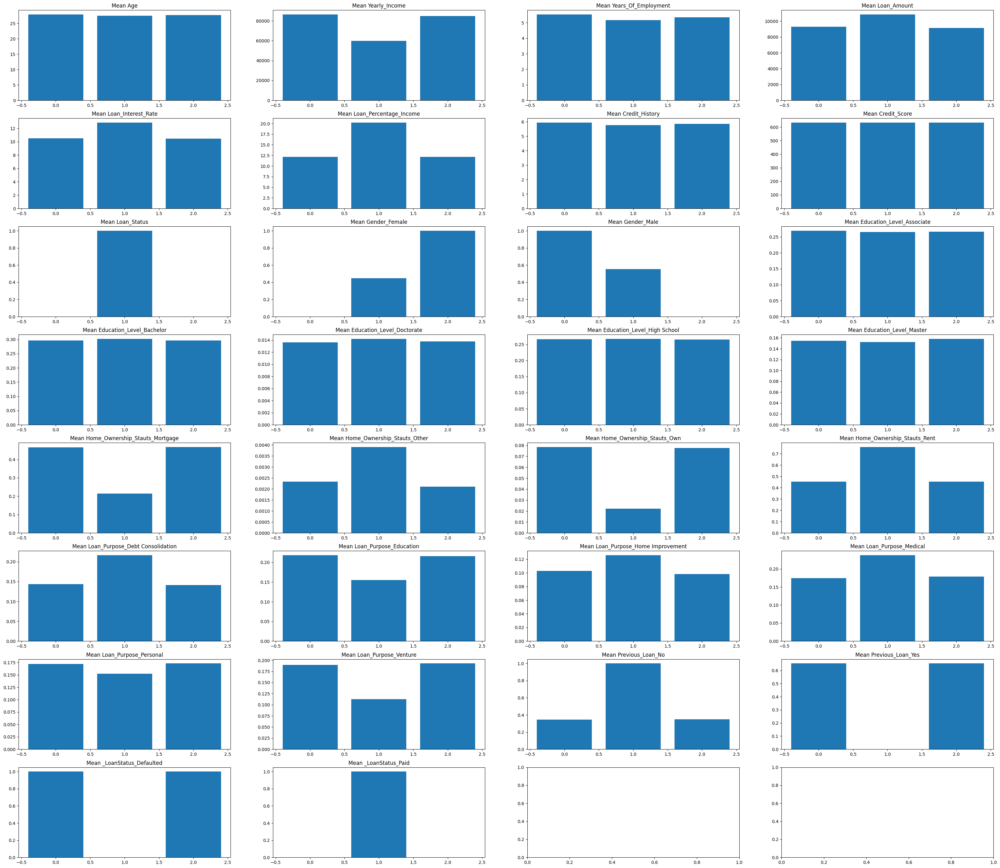

In [ ]:
fig, axes = plt.subplots(8,4, figsize = (40,35))
axes = axes.ravel()
for i, col in enumerate(cluster_groups.columns[1:]):
  axes[i].bar(cluster_groups['cluster'], cluster_groups[col])
  axes[i].set_title(f'Mean {col}')

**Clusters Analysis**

**Group A (Cluster 0):**

The Young Borrowers with Growth Potential
This group is dominated by young individuals (age around mid-20s), with low years of employment but surprisingly moderate to high income, suggesting they are likely early-career professionals or recent graduates entering stable jobs. Most have Bachelor's or Associate degrees, and a good portion live with mortgages, showing early financial commitment. Interestingly, this group also has relatively good credit scores and history, despite having taken out loans for education, home improvement, or debt consolidation. A key insight is that many do not have prior loan history, yet they still show high repayment behavior (i.e., high “Loan_Status: Paid”). This implies that this cluster is likely low-risk, young, and upwardly mobile, making them ideal for banks targeting early lifetime value.

**Group B (Cluster 1):**

The Risk-Weighted Middle Class
This cluster represents a more financially diverse and risk-sensitive population. Members have longer employment years, average income, and a broader mix of education levels—ranging from high school to Master's degrees. Their loan purposes are mixed, with a notable rise in personal and medical loans, often considered higher-risk or reactive borrowing. Despite having prior loans, their repayment behavior is mixed—this cluster shows both paid and defaulted loans. Credit scores are middling, and loan-to-income ratios are higher than Cluster 0. Many in this group rent or live in non-owned residences, and they experience higher interest rates, likely reflecting moderate risk. Overall, this is a working-class, financially stretched group where credit strategies must be finely tuned—good segmentation and tailored risk models are key.

**Group C (Cluster 2):**

The Financially Established but Conservative Borrowers
This group skews older (ages 35+), with long employment histories, stable income, and strong home ownership, often with homes fully owned rather than mortgaged. They have higher education representation (Master’s and Doctorate), and loans taken tend to be strategic, such as for home improvement or ventures, rather than reactive needs. They often have previous loans, but a smaller share of active borrowing compared to Clusters 0 and 1. Interestingly, despite high financial stability, their loan participation and approval rates are lower, likely because of lower need or more conservative borrowing behavior. They exhibit high credit scores, low interest rates, and an almost exclusive “Loan_Status: Paid”, making them very low-risk, high-trust borrowers. Lenders can treat this group as reliable but may need to incentivize them more to engage in new products.

**Cross-Cluster Insight:**

Cluster 0 shows potential but requires careful monitoring due to limited history. Cluster 1 is a balancing act between growth and default risk. Cluster 2 is the safest bet but may not yield volume in borrowing. Combining behavioral data (loan purpose, prior loans) with demographic-economic indicators (age, income, credit) reveals clear segmentation for risk-based pricing, targeted product offerings, and lifecycle-based financial planning.

In [ ]:
group_A = df.loc[df['cluster']==0]

In [ ]:
group_B = df.loc[df['cluster']==1]

In [ ]:
group_C = df.loc[df['cluster']==2]

## Group A

In [ ]:
group_A

,Age,Gender,Education_Level,Yearly_Income,Years_Of_Employment,Home_Ownership_Stauts,Loan_Amount,Loan_Purpose,Loan_Interest_Rate,Loan_Percentage_Income,Credit_History,Credit_Score,Previous_Loan,Loan_Status,_LoanStatus,cluster
16,23,Male,Bachelor,144943,0,Rent,35000,Education,7.90,24,4,663,No,0,Defaulted,0
20,25,Male,Bachelor,195718,0,Rent,35000,Venture,7.49,18,4,684,Yes,0,Defaulted,0
21,25,Male,High School,165792,4,Rent,34800,Personal,16.77,21,2,662,No,0,Defaulted,0
27,23,Male,High School,14293,0,Own,1400,Personal,9.32,10,3,607,No,0,Defaulted,0
31,25,Male,Bachelor,144855,1,Rent,32000,Venture,6.62,22,2,586,Yes,0,Defaulted,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
42098,26,Male,Associate,85414,2,Rent,12000,Education,6.72,14,4,509,Yes,0,Defaulted,0
42099,25,Male,Bachelor,165605,0,Mortgage,9989,Venture,5.92,6,4,648,No,0,Defaulted,0
42100,27,Male,Associate,96196,1,Mortgage,8000,Medical,6.38,8,8,593,Yes,0,Defaulted,0
42103,36,Male,Bachelor,60006,15,Own,2755,Medical,8.92,5,9,609,Yes,0,Defaulted,0


Group Analysis for Age
Column Name: Age


Values Percentage:
Age
23    11.738523
24    11.474561
25     9.782102
22     9.109259
26     8.260442
27     6.987216
28     6.076290
29     5.341338
30     4.399358
31     3.524662
32     3.312458
33     2.727602
21     2.541276
34     2.132395
35     1.842555
36     1.764919
37     1.490606
38     1.226645
41     0.838466
39     0.828114
40     0.719424
42     0.590032
43     0.517572
44     0.465814
46     0.331246
45     0.300192
47     0.269137
48     0.232907
50     0.144920
49     0.139744
51     0.113866
52     0.103514
53     0.082811
58     0.072460
56     0.067284
57     0.051757
54     0.046581
55     0.046581
20     0.041406
65     0.031054
60     0.031054
66     0.031054
64     0.025879
70     0.025879
59     0.020703
61     0.020703
69     0.020703
63     0.010351
73     0.010351
62     0.010351
78     0.005176
80     0.005176
94     0.005176
84     0.005176
67     0.005176
Name: proportion, dtype: float64






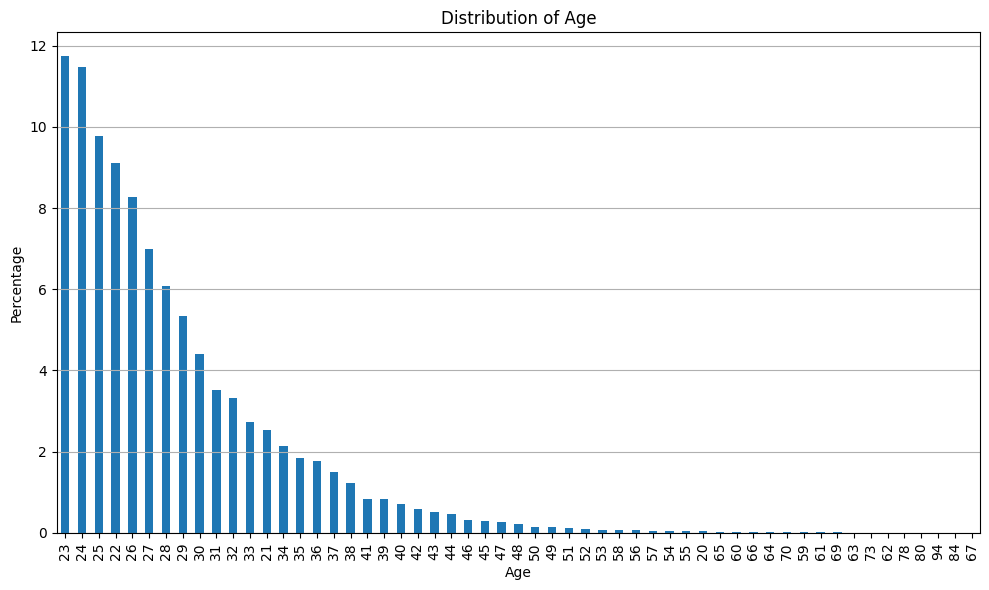



Describe:
count    19321.000000
mean        27.912116
std          6.136174
min         20.000000
25%         24.000000
50%         26.000000
75%         30.000000
max         94.000000
Name: Age, dtype: float64


Group Analysis for Gender
Column Name: Gender


Values Percentage:
Gender
Male    100.0
Name: proportion, dtype: float64






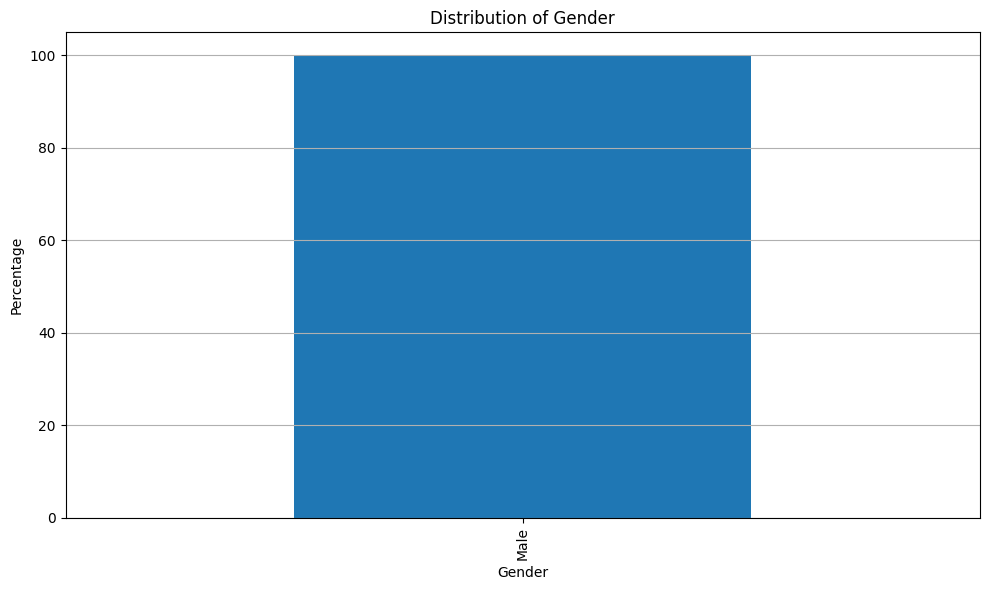



Describe:
count     19321
unique        1
top        Male
freq      19321
Name: Gender, dtype: object


Group Analysis for Education_Level
Column Name: Education_Level


Values Percentage:
Education_Level
Bachelor       29.636147
Associate      26.924072
High School    26.618705
Master         15.459862
Doctorate       1.361213
Name: proportion, dtype: float64






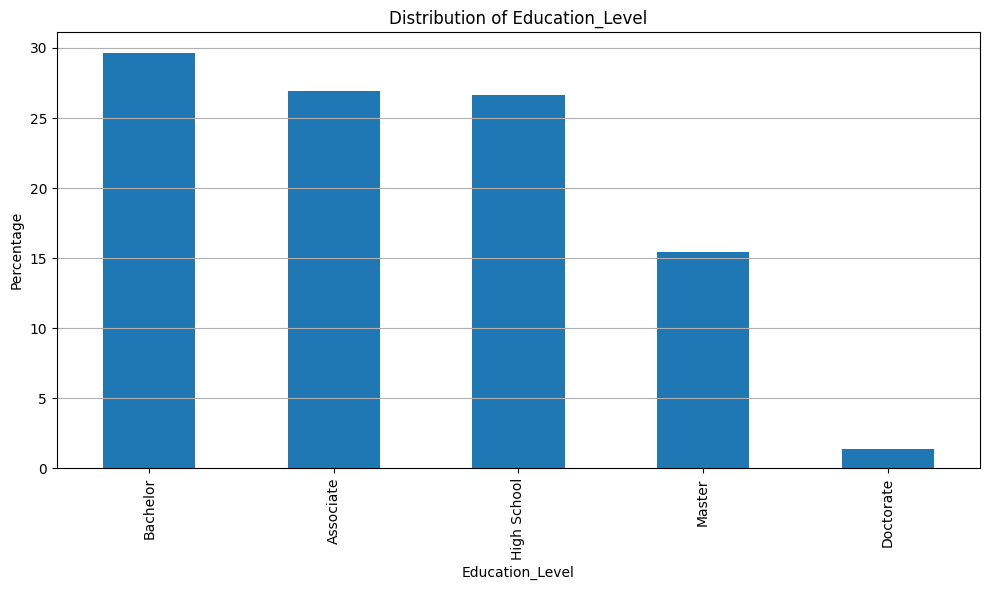



Describe:
count        19321
unique           5
top       Bachelor
freq          5726
Name: Education_Level, dtype: object


Group Analysis for Yearly_Income
Column Name: Yearly_Income


Values Percentage:
Yearly_Income
72949     0.036230
73011     0.031054
78910     0.025879
36995     0.025879
73049     0.025879
            ...   
188323    0.005176
188588    0.005176
189576    0.005176
190643    0.005176
185099    0.005176
Name: proportion, Length: 16707, dtype: float64






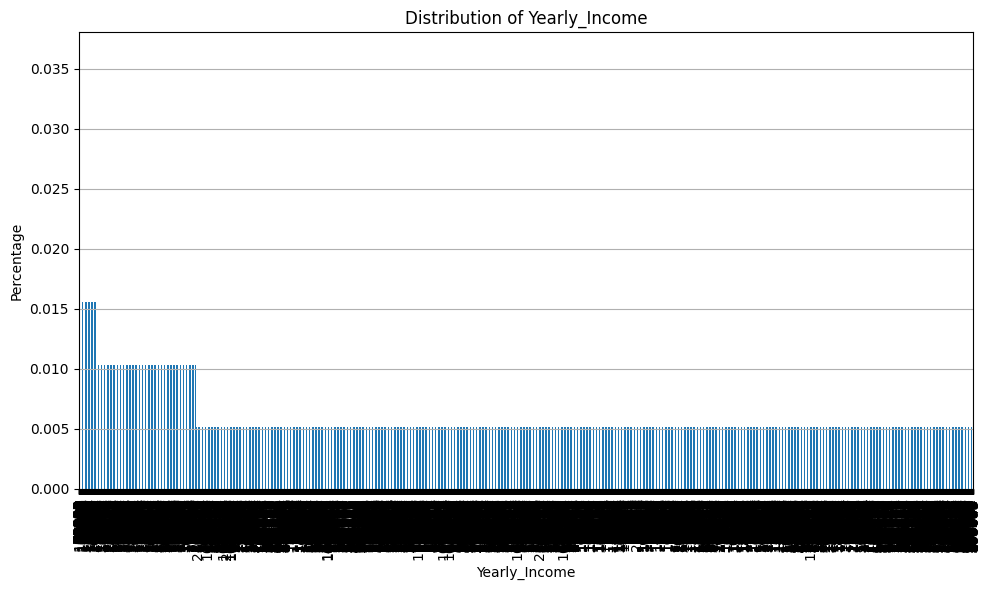



Describe:
count    1.932100e+04
mean     8.636632e+04
std      6.957616e+04
min      9.595000e+03
25%      5.160200e+04
50%      7.299000e+04
75%      1.029230e+05
max      2.448661e+06
Name: Yearly_Income, dtype: float64


Group Analysis for Years_Of_Employment
Column Name: Years_Of_Employment


Values Percentage:
Years_Of_Employment
0     20.796025
1      9.135138
2      9.104084
3      8.627918
4      7.898142
5      6.749133
6      5.822680
7      4.859997
8      4.135397
9      3.509135
10     3.064024
11     2.567155
12     2.070286
13     1.749392
14     1.366389
15     1.283577
16     1.050670
17     0.952332
18     0.900575
20     0.641789
19     0.610734
21     0.491693
22     0.388179
23     0.377827
24     0.320894
25     0.232907
26     0.227731
27     0.155271
28     0.124217
29     0.119041
30     0.072460
32     0.067284
31     0.067284
37     0.051757
34     0.051757
35     0.051757
33     0.041406
43     0.036230
44     0.036230
41     0.036230
45     0.025879
36   

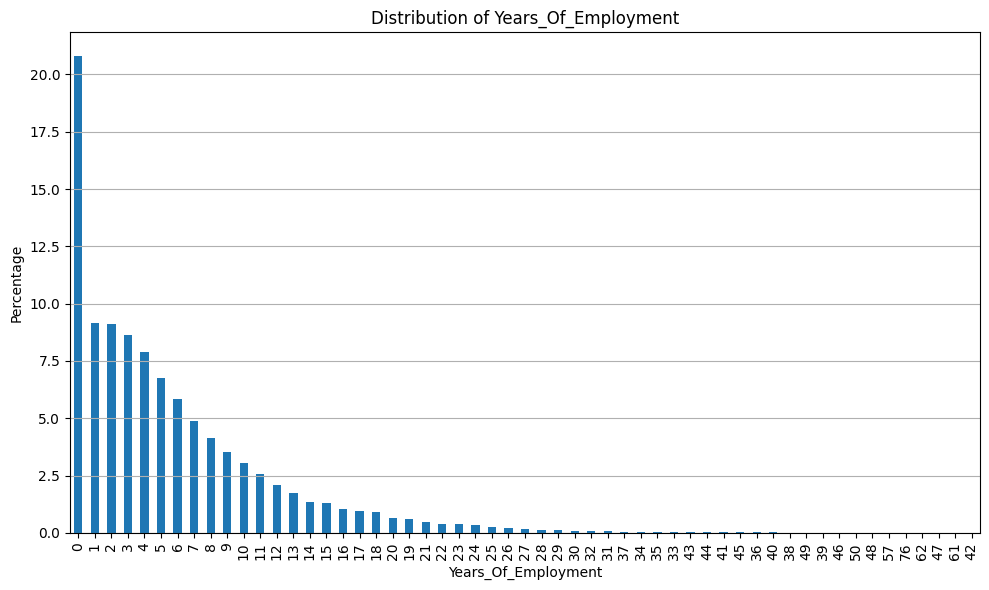



Describe:
count    19321.000000
mean         5.538223
std          6.165917
min          0.000000
25%          1.000000
50%          4.000000
75%          8.000000
max         76.000000
Name: Years_Of_Employment, dtype: float64


Group Analysis for Home_Ownership_Stauts
Column Name: Home_Ownership_Stauts


Values Percentage:
Home_Ownership_Stauts
Mortgage    46.653900
Rent        45.271984
Own          7.841209
Other        0.232907
Name: proportion, dtype: float64






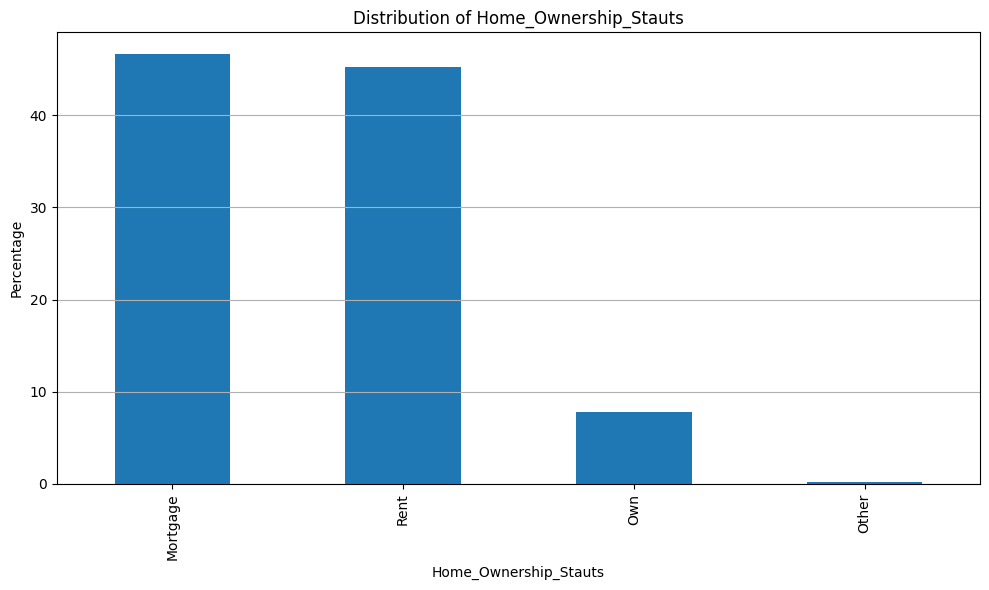



Describe:
count        19321
unique           4
top       Mortgage
freq          9014
Name: Home_Ownership_Stauts, dtype: object


Group Analysis for Loan_Amount
Column Name: Loan_Amount


Values Percentage:
Loan_Amount
10000    8.322551
5000     6.381657
6000     5.946897
12000    5.444853
8000     4.518400
           ...   
5429     0.005176
2984     0.005176
5988     0.005176
21252    0.005176
4374     0.005176
Name: proportion, Length: 2114, dtype: float64






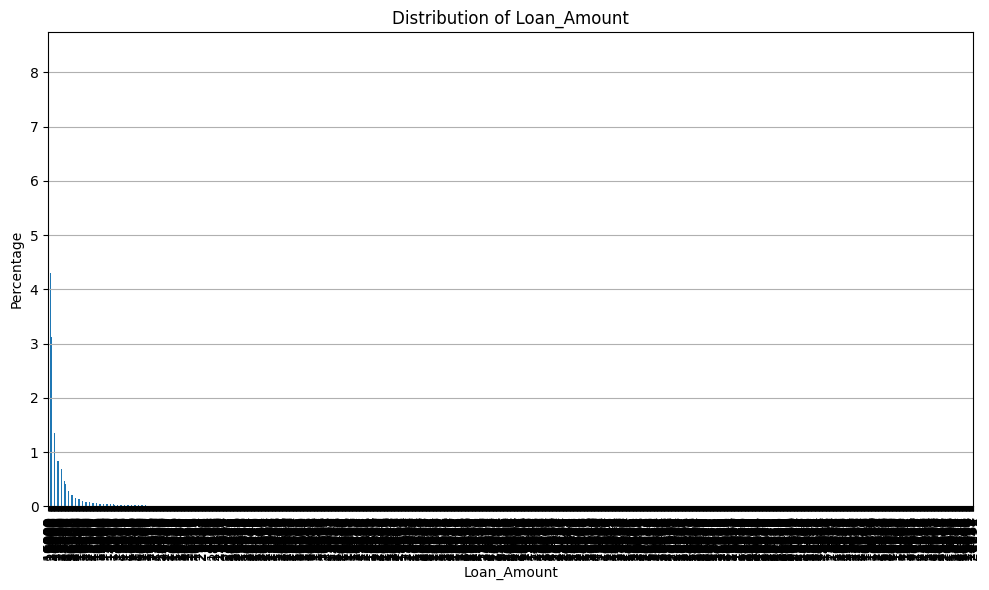



Describe:
count    19321.000000
mean      9292.742456
std       6086.409943
min        500.000000
25%       5000.000000
50%       8000.000000
75%      12000.000000
max      35000.000000
Name: Loan_Amount, dtype: float64


Group Analysis for Loan_Purpose
Column Name: Loan_Purpose


Values Percentage:
Loan_Purpose
Education             21.815641
Venture               18.963822
Medical               17.468040
Personal              17.173024
Debt Consolidation    14.316029
Home Improvement      10.263444
Name: proportion, dtype: float64






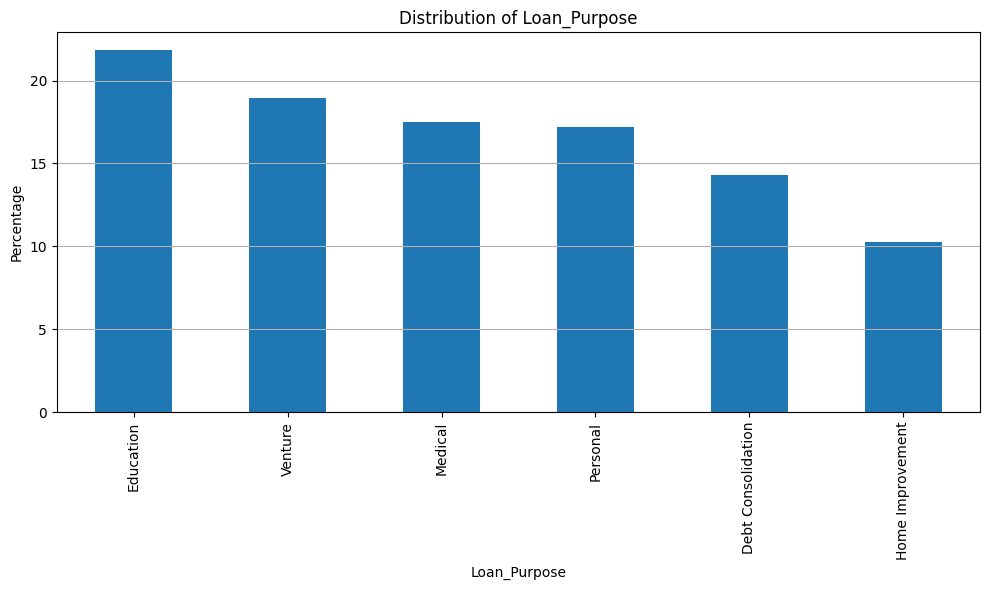



Describe:
count         19321
unique            6
top       Education
freq           4215
Name: Loan_Purpose, dtype: object


Group Analysis for Loan_Interest_Rate
Column Name: Loan_Interest_Rate


Values Percentage:
Loan_Interest_Rate
11.01    7.530666
7.51     2.085813
10.99    1.873609
5.42     1.707986
7.49     1.687283
           ...   
16.31    0.005176
5.76     0.005176
14.08    0.005176
5.47     0.005176
18.44    0.005176
Name: proportion, Length: 1094, dtype: float64






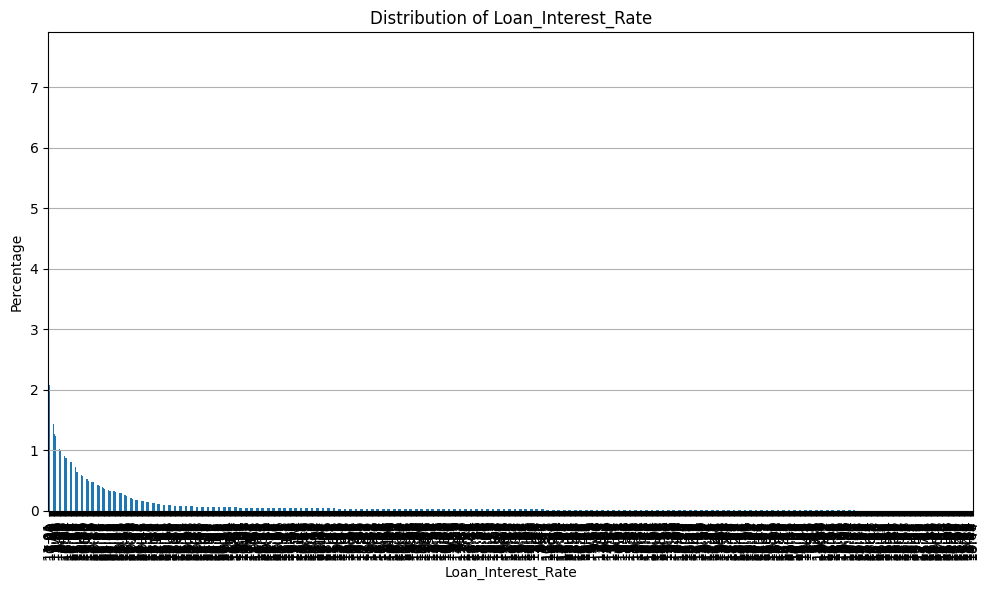



Describe:
count    19321.000000
mean        10.484484
std          2.731219
min          5.420000
25%          7.900000
50%         10.840000
75%         12.330000
max         20.000000
Name: Loan_Interest_Rate, dtype: float64


Group Analysis for Loan_Percentage_Income
Column Name: Loan_Percentage_Income


Values Percentage:
Loan_Percentage_Income
8     6.536929
10    6.309197
7     5.729517
9     5.708814
6     5.605300
5     5.522488
12    5.434501
11    5.299933
4     4.891051
13    4.564981
14    4.528751
16    4.347601
15    3.954247
3     3.674758
17    3.245174
18    2.939806
20    2.841468
19    2.831116
2     2.567155
22    2.049583
21    2.034056
23    1.707986
24    1.573418
25    0.941980
1     0.910926
28    0.869520
26    0.615910
27    0.522747
30    0.320894
31    0.300192
33    0.274313
32    0.248434
34    0.175974
36    0.134569
35    0.108690
37    0.108690
41    0.103514
0     0.077636
38    0.077636
39    0.072460
40    0.062109
43    0.036230
42    0.031054
48

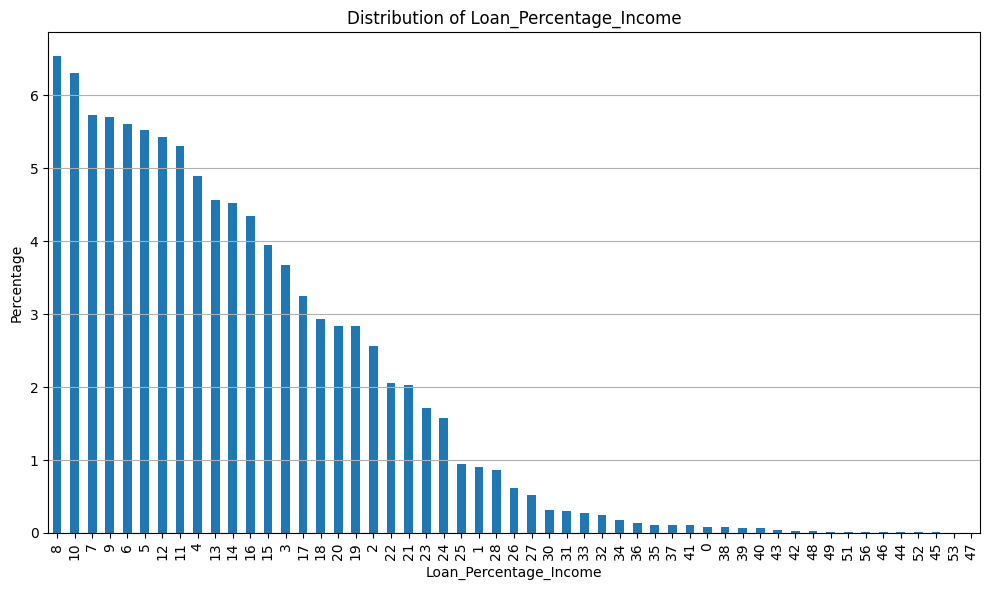



Describe:
count    19321.000000
mean        12.167383
std          7.085746
min          0.000000
25%          7.000000
50%         11.000000
75%         16.000000
max         56.000000
Name: Loan_Percentage_Income, dtype: float64


Group Analysis for Credit_History
Column Name: Credit_History


Values Percentage:
Credit_History
4     18.937943
3     18.311682
2     14.409192
5      6.894053
6      6.593862
7      6.433414
8      6.096993
9      5.936546
10     5.434501
12     1.827028
11     1.614823
14     1.511309
13     1.459552
16     1.309456
15     1.226645
17     1.066197
24     0.113866
18     0.108690
20     0.098339
23     0.082811
22     0.077636
19     0.072460
21     0.067284
25     0.062109
28     0.056933
30     0.056933
27     0.056933
26     0.051757
29     0.031054
Name: proportion, dtype: float64






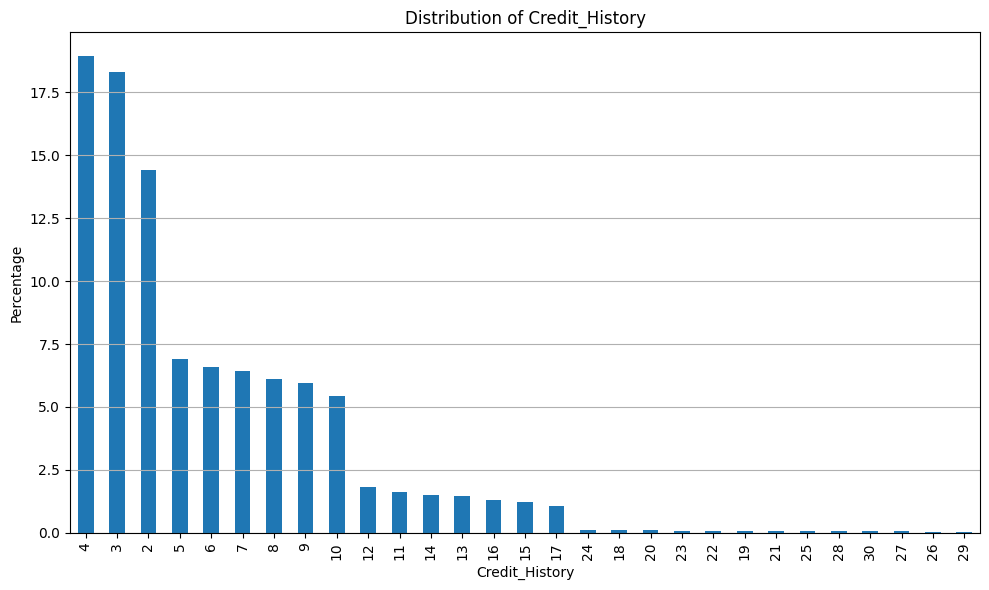



Describe:
count    19321.000000
mean         5.941152
std          3.963146
min          2.000000
25%          3.000000
50%          4.000000
75%          8.000000
max         30.000000
Name: Credit_History, dtype: float64


Group Analysis for Credit_Score
Column Name: Credit_Score


Values Percentage:
Credit_Score
651    0.998913
663    0.952332
654    0.947156
675    0.926453
667    0.921277
         ...   
466    0.005176
390    0.005176
755    0.005176
768    0.005176
455    0.005176
Name: proportion, Length: 322, dtype: float64






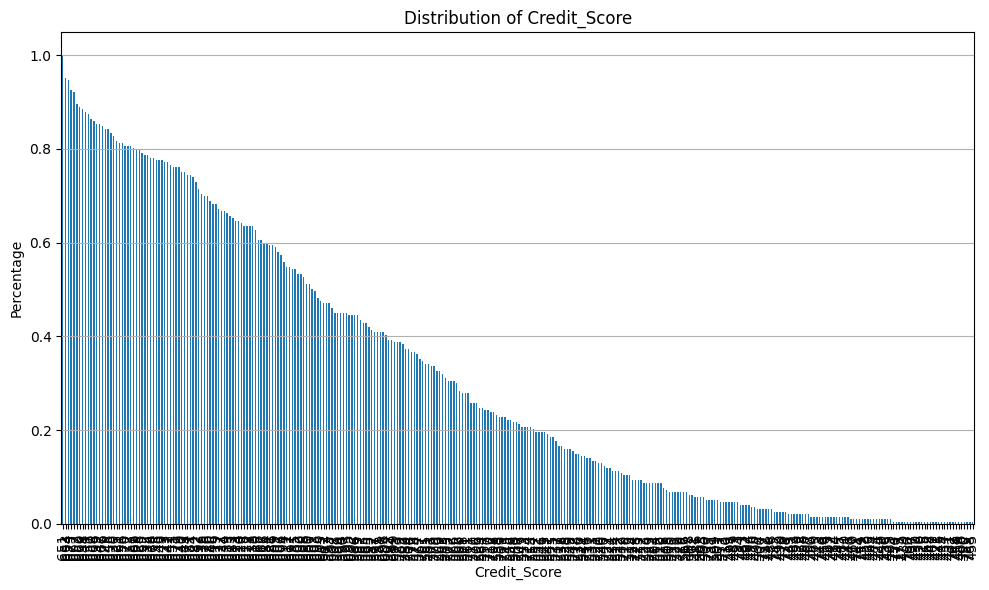



Describe:
count    19321.000000
mean       632.646861
std         50.647135
min        390.000000
25%        601.000000
50%        640.000000
75%        670.000000
max        784.000000
Name: Credit_Score, dtype: float64


Group Analysis for Previous_Loan
Column Name: Previous_Loan


Values Percentage:
Previous_Loan
Yes    65.343409
No     34.656591
Name: proportion, dtype: float64






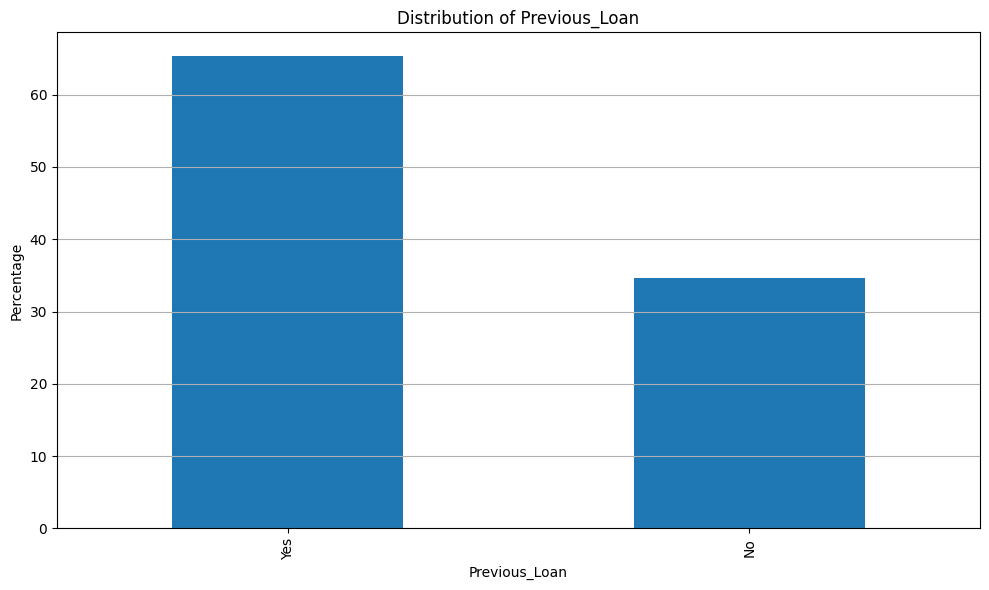



Describe:
count     19321
unique        2
top         Yes
freq      12625
Name: Previous_Loan, dtype: object


Group Analysis for Loan_Status
Column Name: Loan_Status


Values Percentage:
Loan_Status
0    100.0
Name: proportion, dtype: float64






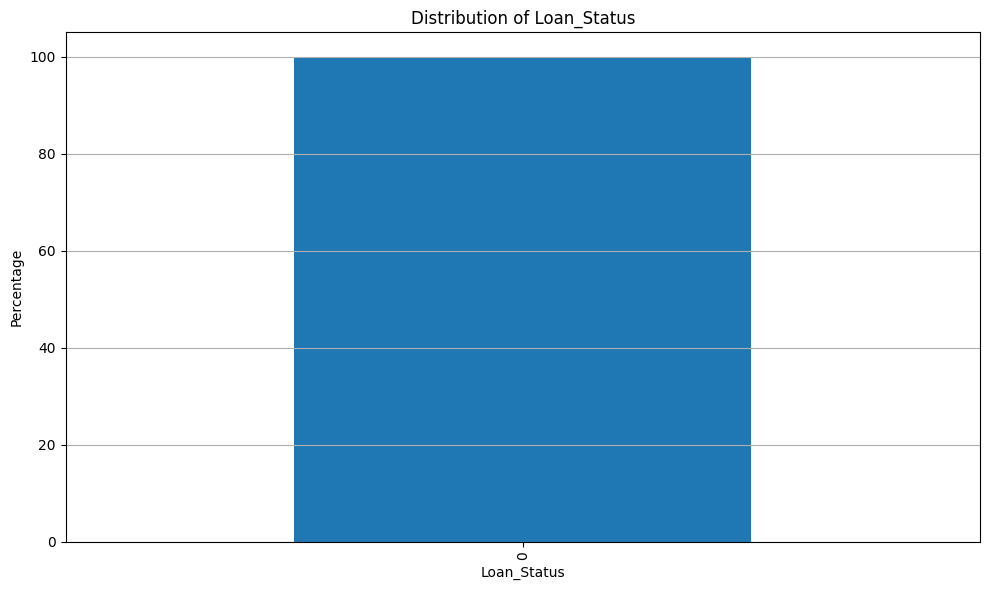



Describe:
count    19321.0
mean         0.0
std          0.0
min          0.0
25%          0.0
50%          0.0
75%          0.0
max          0.0
Name: Loan_Status, dtype: float64


Group Analysis for _LoanStatus
Column Name: _LoanStatus


Values Percentage:
_LoanStatus
Defaulted    100.0
Name: proportion, dtype: float64






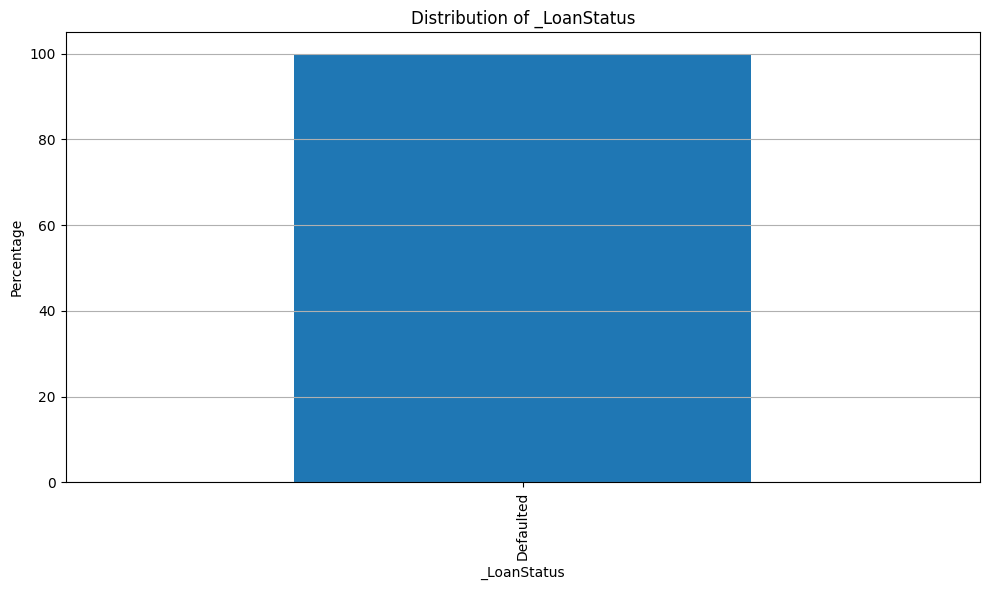



Describe:
count         19321
unique            1
top       Defaulted
freq          19321
Name: _LoanStatus, dtype: object


Group Analysis for cluster
Column Name: cluster


Values Percentage:
cluster
0    100.0
Name: proportion, dtype: float64






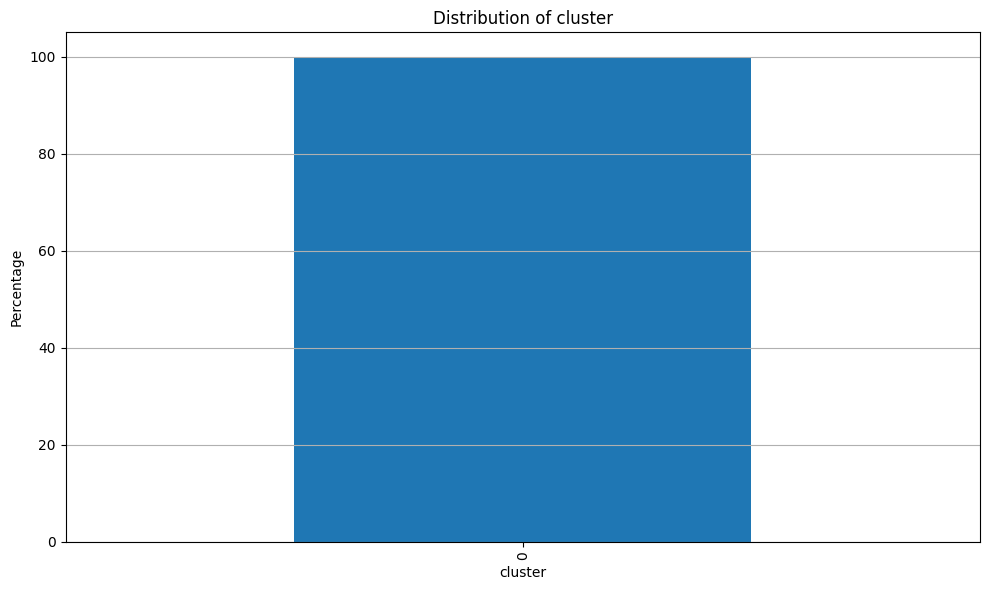



Describe:
count    19321.0
mean         0.0
std          0.0
min          0.0
25%          0.0
50%          0.0
75%          0.0
max          0.0
Name: cluster, dtype: float64




In [ ]:
for col in group_A.columns:
    print(f"Group Analysis for {col}")
    print('='*50)
    print(f'Column Name: {col}')
    print('\n')

    value_counts = group_A[col].value_counts(normalize=True) * 100
    print(f"Values Percentage:\n{value_counts}")
    print('\n')
    print('='*50)
    print('\n')

    plt.figure(figsize=(10, 6))
    value_counts.plot(kind='bar')
    plt.title(f'Distribution of {col}')
    plt.xlabel(col)
    plt.ylabel('Percentage')
    plt.grid(axis='y')
    plt.tight_layout()
    plt.show()

    print('\n')
    print('='*50)
    print(f'Describe:\n{group_A[col].describe()}')
    print('\n')
    print('='*50)

In [ ]:
group_A.describe()

,Age,Yearly_Income,Years_Of_Employment,Loan_Amount,Loan_Interest_Rate,Loan_Percentage_Income,Credit_History,Credit_Score,Loan_Status,cluster
count,19321.000000,1.932100e+04,19321.000000,19321.000000,19321.000000,19321.000000,19321.000000,19321.000000,19321.0,19321.0
mean,27.912116,8.636632e+04,5.538223,9292.742456,10.484484,12.167383,5.941152,632.646861,0.0,0.0
std,6.136174,6.957616e+04,6.165917,6086.409943,2.731219,7.085746,3.963146,50.647135,0.0,0.0
min,20.000000,9.595000e+03,0.000000,500.000000,5.420000,0.000000,2.000000,390.000000,0.0,0.0
25%,24.000000,5.160200e+04,1.000000,5000.000000,7.900000,7.000000,3.000000,601.000000,0.0,0.0
50%,26.000000,7.299000e+04,4.000000,8000.000000,10.840000,11.000000,4.000000,640.000000,0.0,0.0
75%,30.000000,1.029230e+05,8.000000,12000.000000,12.330000,16.000000,8.000000,670.000000,0.0,0.0
max,94.000000,2.448661e+06,76.000000,35000.000000,20.000000,56.000000,30.000000,784.000000,0.0,0.0


## Group B

In [ ]:
group_B

,Age,Gender,Education_Level,Yearly_Income,Years_Of_Employment,Home_Ownership_Stauts,Loan_Amount,Loan_Purpose,Loan_Interest_Rate,Loan_Percentage_Income,Credit_History,Credit_Score,Previous_Loan,Loan_Status,_LoanStatus,cluster
0,22,Female,Master,71948,0,Rent,35000,Personal,16.02,49,3,561,No,1,Paid,1
2,25,Female,High School,12438,3,Mortgage,5500,Medical,12.87,44,3,635,No,1,Paid,1
3,23,Female,Bachelor,79753,0,Rent,35000,Medical,15.23,44,2,675,No,1,Paid,1
4,24,Male,Master,66135,1,Rent,35000,Medical,14.27,53,4,586,No,1,Paid,1
5,21,Female,High School,12951,0,Own,2500,Venture,7.14,19,2,532,No,1,Paid,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
44995,27,Male,Associate,47971,6,Rent,15000,Medical,15.66,31,3,645,No,1,Paid,1
44996,37,Female,Associate,65800,17,Rent,9000,Home Improvement,14.07,14,11,621,No,1,Paid,1
44997,33,Male,Associate,56942,7,Rent,2771,Debt Consolidation,10.02,5,10,668,No,1,Paid,1
44998,29,Male,Bachelor,33164,4,Rent,12000,Education,13.23,36,6,604,No,1,Paid,1


Group Analysis for Age
Column Name: Age


Values Percentage:
Age
23    11.79
24    11.28
22    10.50
25    10.28
26     7.83
27     6.63
28     5.97
29     5.30
30     4.26
21     3.95
31     3.52
32     2.79
33     2.54
34     2.01
35     1.93
36     1.59
37     1.38
39     0.89
38     0.87
40     0.72
42     0.62
41     0.54
43     0.39
45     0.34
44     0.34
48     0.25
47     0.21
46     0.16
49     0.15
52     0.13
50     0.12
51     0.10
55     0.09
60     0.08
53     0.08
54     0.07
61     0.05
57     0.04
62     0.03
65     0.03
58     0.03
66     0.03
20     0.02
70     0.02
56     0.02
63     0.01
64     0.01
59     0.01
Name: proportion, dtype: float64






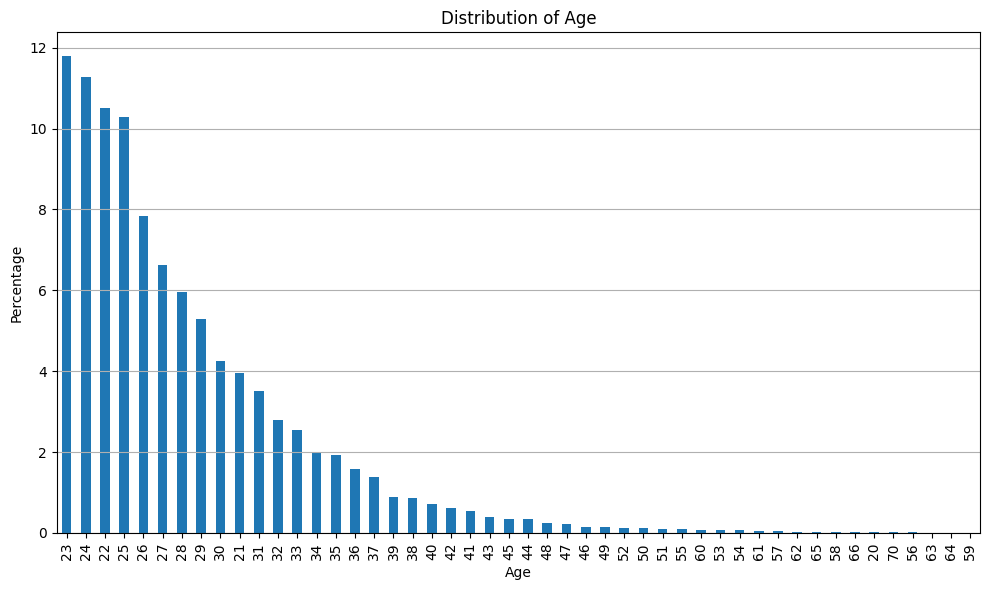



Describe:
count    10000.000000
mean        27.521300
std          5.939063
min         20.000000
25%         23.000000
50%         26.000000
75%         30.000000
max         70.000000
Name: Age, dtype: float64


Group Analysis for Gender
Column Name: Gender


Values Percentage:
Gender
Male      55.15
Female    44.85
Name: proportion, dtype: float64






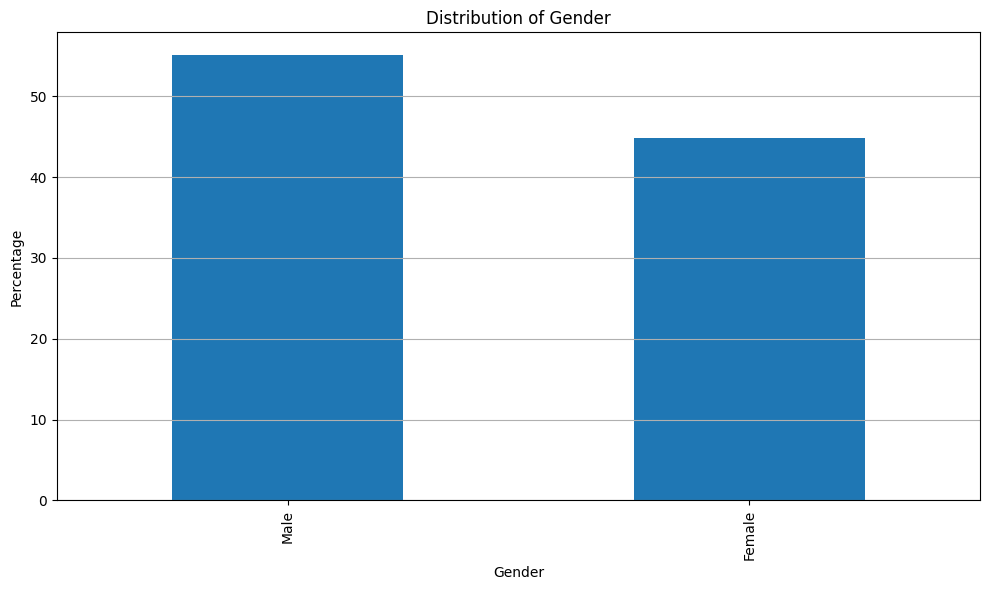



Describe:
count     10000
unique        2
top        Male
freq       5515
Name: Gender, dtype: object


Group Analysis for Education_Level
Column Name: Education_Level


Values Percentage:
Education_Level
Bachelor       30.18
High School    26.71
Associate      26.50
Master         15.19
Doctorate       1.42
Name: proportion, dtype: float64






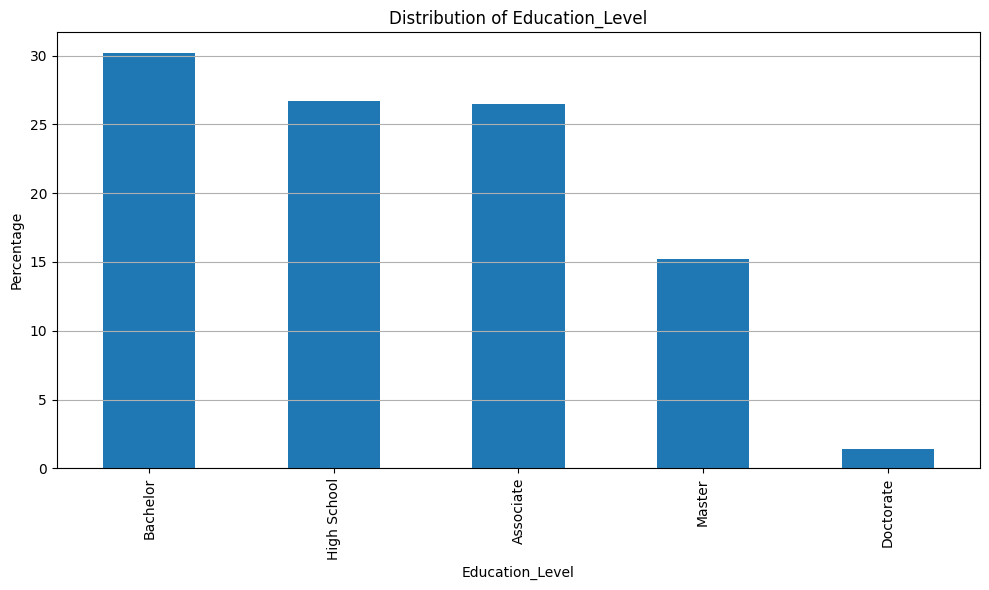



Describe:
count        10000
unique           5
top       Bachelor
freq          3018
Name: Education_Level, dtype: object


Group Analysis for Yearly_Income
Column Name: Yearly_Income


Values Percentage:
Yearly_Income
8000      0.15
53638     0.05
36991     0.04
36986     0.04
41730     0.04
          ... 
47595     0.01
124679    0.01
124462    0.01
54969     0.01
54845     0.01
Name: proportion, Length: 9162, dtype: float64






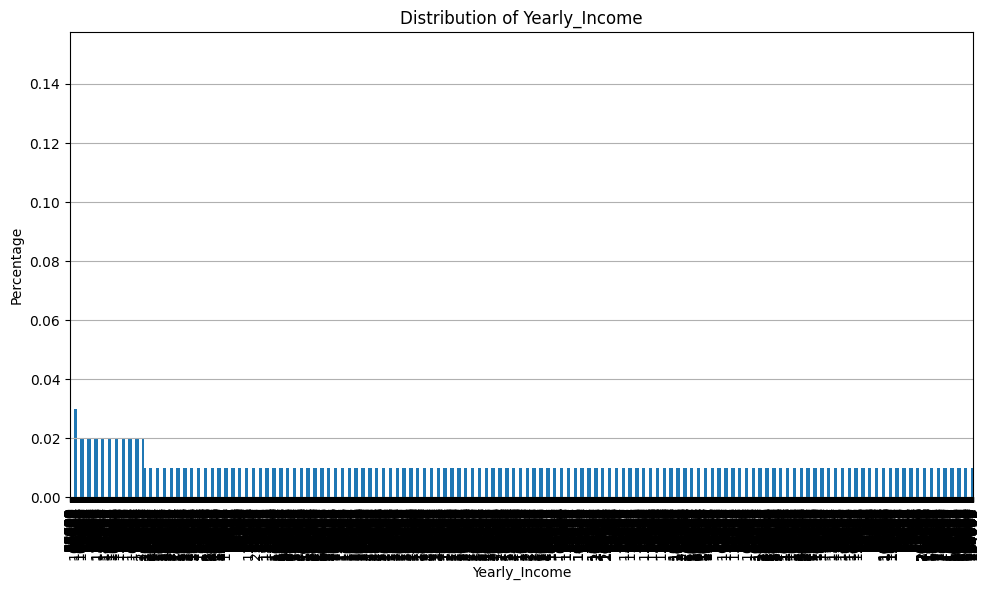



Describe:
count     10000.000000
mean      59886.096900
std       45338.315604
min        8000.000000
25%       36841.750000
50%       50629.000000
75%       71888.250000
max      845636.000000
Name: Yearly_Income, dtype: float64


Group Analysis for Years_Of_Employment
Column Name: Years_Of_Employment


Values Percentage:
Years_Of_Employment
0     23.23
1      9.25
2      9.24
3      8.68
4      7.40
5      6.50
6      5.89
7      4.70
8      4.49
10     3.20
9      2.96
11     2.22
12     1.89
13     1.47
14     1.42
15     1.21
16     1.04
17     0.83
18     0.73
19     0.52
20     0.45
21     0.37
22     0.29
23     0.27
24     0.25
26     0.24
25     0.23
27     0.15
28     0.12
30     0.10
29     0.09
32     0.08
34     0.06
31     0.06
35     0.06
33     0.05
36     0.04
39     0.04
42     0.03
40     0.03
44     0.02
43     0.02
47     0.02
45     0.02
37     0.02
38     0.02
Name: proportion, dtype: float64






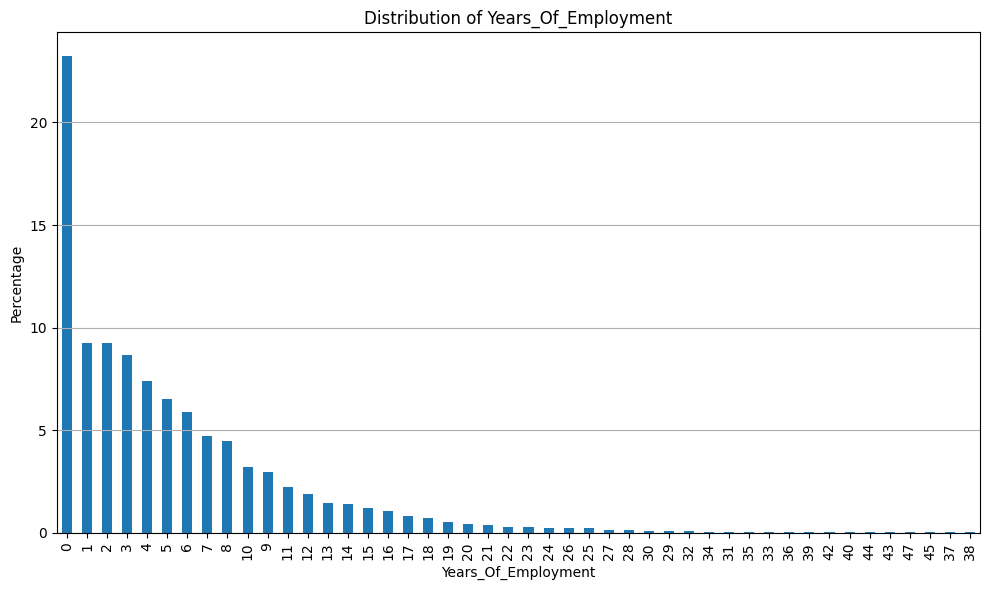



Describe:
count    10000.000000
mean         5.178000
std          5.913207
min          0.000000
25%          1.000000
50%          3.000000
75%          8.000000
max         47.000000
Name: Years_Of_Employment, dtype: float64


Group Analysis for Home_Ownership_Stauts
Column Name: Home_Ownership_Stauts


Values Percentage:
Home_Ownership_Stauts
Rent        75.95
Mortgage    21.44
Own          2.22
Other        0.39
Name: proportion, dtype: float64






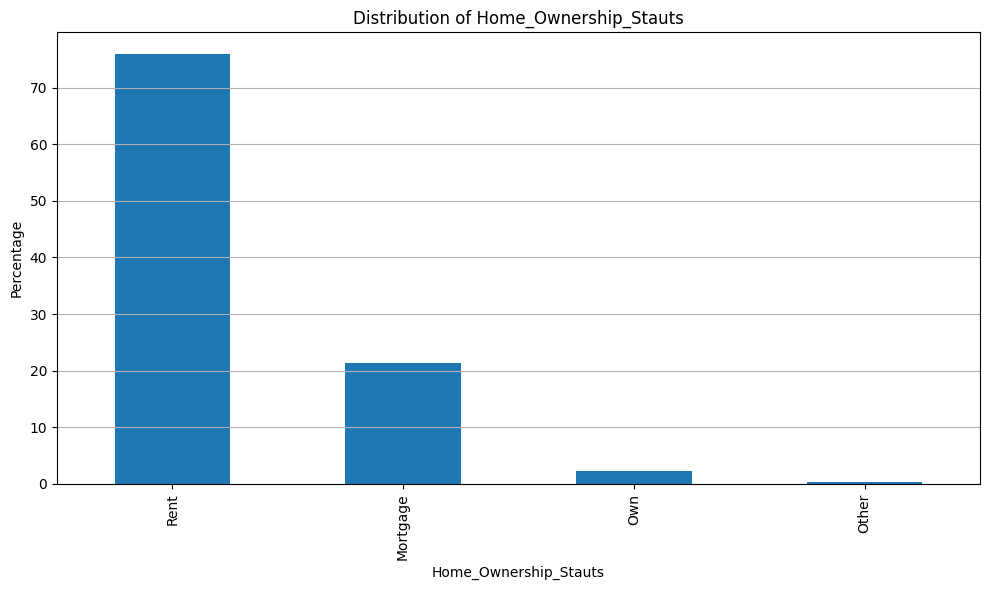



Describe:
count     10000
unique        4
top        Rent
freq       7595
Name: Home_Ownership_Stauts, dtype: object


Group Analysis for Loan_Amount
Column Name: Loan_Amount


Values Percentage:
Loan_Amount
10000    6.91
5000     5.28
15000    5.17
12000    4.62
20000    4.43
         ... 
4011     0.01
2005     0.01
3980     0.01
15492    0.01
3343     0.01
Name: proportion, Length: 1781, dtype: float64






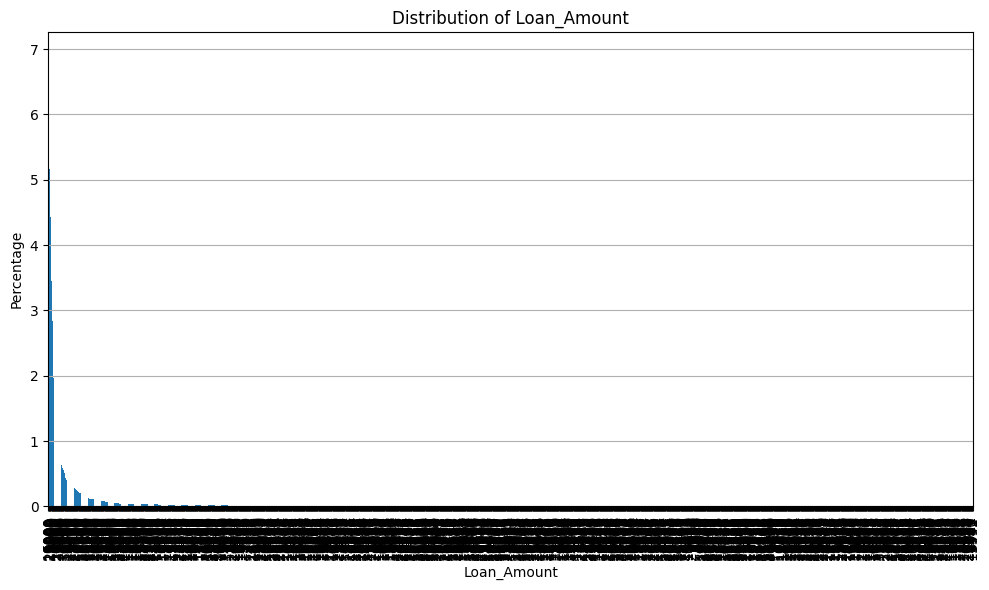



Describe:
count    10000.000000
mean     10855.689800
std       7111.701674
min        900.000000
25%       5000.000000
50%       9750.000000
75%      15000.000000
max      35000.000000
Name: Loan_Amount, dtype: float64


Group Analysis for Loan_Purpose
Column Name: Loan_Purpose


Values Percentage:
Loan_Purpose
Medical               23.78
Debt Consolidation    21.63
Education             15.52
Personal              15.21
Home Improvement      12.58
Venture               11.28
Name: proportion, dtype: float64






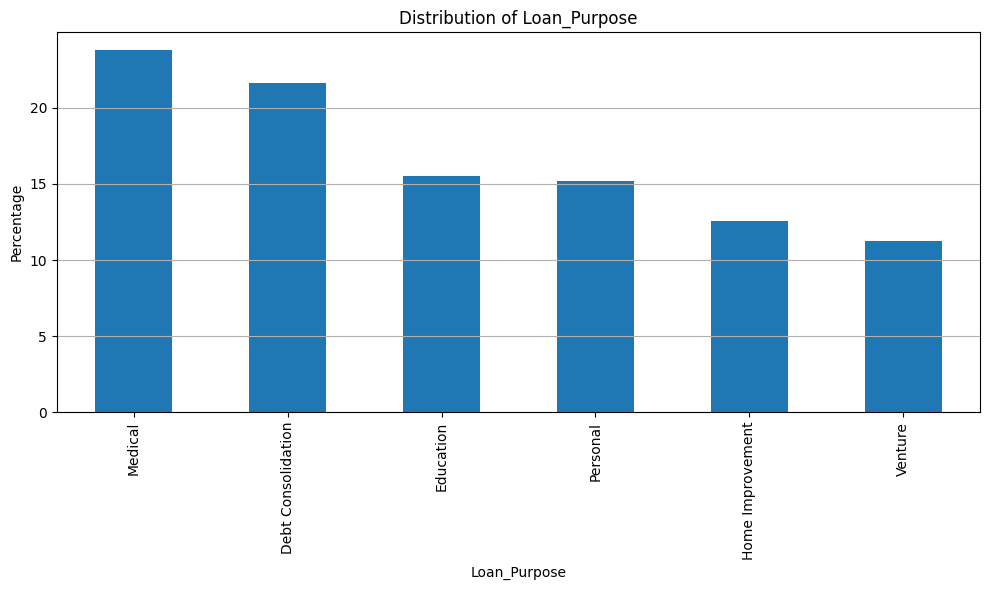



Describe:
count       10000
unique          6
top       Medical
freq         2378
Name: Loan_Purpose, dtype: object


Group Analysis for Loan_Interest_Rate
Column Name: Loan_Interest_Rate


Values Percentage:
Loan_Interest_Rate
11.01    6.85
14.96    1.21
10.99    1.21
15.62    1.18
7.90     0.97
         ... 
6.83     0.01
19.11    0.01
19.62    0.01
6.07     0.01
16.60    0.01
Name: proportion, Length: 1096, dtype: float64






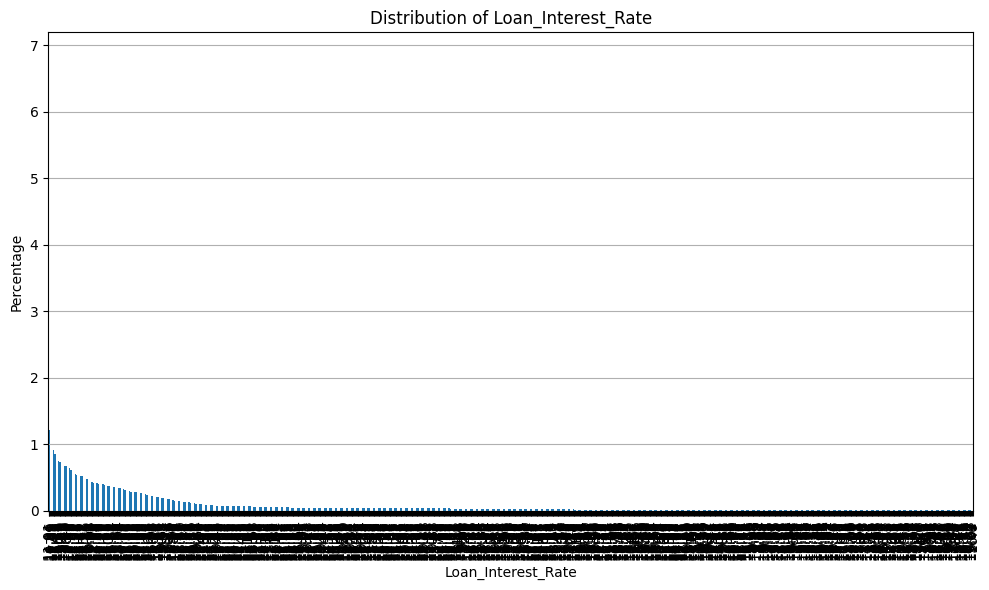



Describe:
count    10000.000000
mean        12.856794
std          3.068512
min          5.420000
25%         10.990000
50%         12.980000
75%         15.230000
max         20.000000
Name: Loan_Interest_Rate, dtype: float64


Group Analysis for Loan_Percentage_Income
Column Name: Loan_Percentage_Income


Values Percentage:
Loan_Percentage_Income
28    6.06
27    4.68
26    4.35
25    3.68
13    3.48
8     3.48
14    3.36
12    3.34
15    3.31
9     3.00
7     2.99
17    2.96
16    2.95
6     2.84
10    2.80
19    2.80
30    2.80
11    2.77
21    2.60
18    2.57
22    2.40
31    2.39
5     2.37
20    2.19
32    2.08
33    2.02
4     2.02
24    1.98
34    1.96
23    1.94
3     1.77
38    1.18
35    1.17
36    1.15
37    1.13
2     0.83
41    0.68
40    0.61
39    0.60
42    0.52
43    0.50
44    0.36
46    0.17
45    0.17
47    0.16
1     0.13
48    0.13
49    0.11
51    0.08
54    0.08
50    0.07
53    0.06
52    0.05
55    0.03
56    0.03
62    0.02
61    0.02
0     0.01
59    0.0

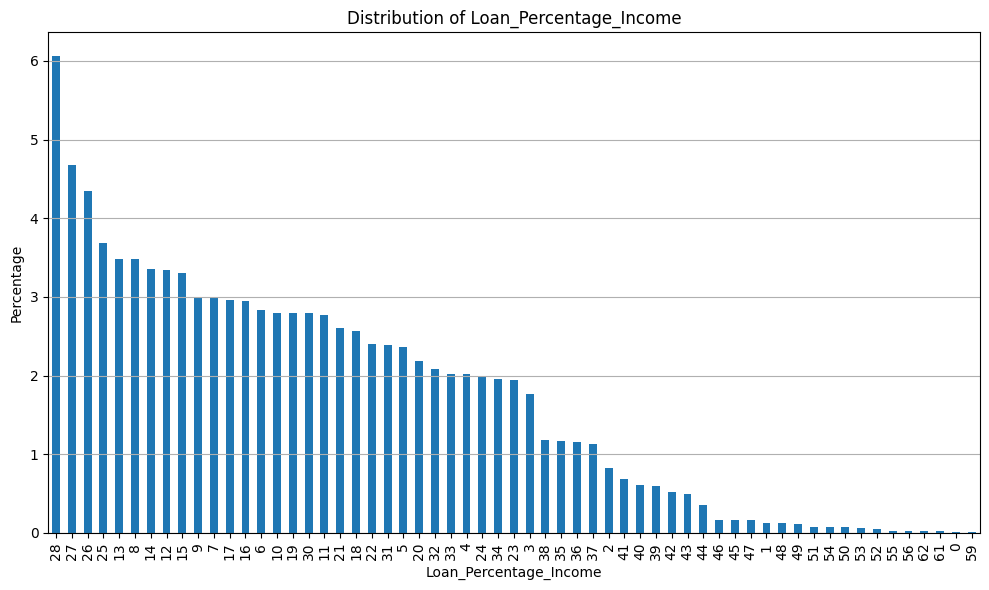



Describe:
count    10000.000000
mean        20.222700
std         10.628292
min          0.000000
25%         11.000000
50%         20.000000
75%         28.000000
max         62.000000
Name: Loan_Percentage_Income, dtype: float64


Group Analysis for Credit_History
Column Name: Credit_History


Values Percentage:
Credit_History
4     19.52
3     18.93
2     15.51
5      6.77
7      6.39
6      6.34
8      6.12
9      5.51
10     5.02
11     1.54
12     1.47
14     1.34
13     1.30
15     1.26
16     1.18
17     0.88
20     0.14
22     0.10
28     0.09
27     0.08
19     0.07
24     0.07
21     0.07
18     0.06
30     0.06
29     0.06
25     0.05
23     0.04
26     0.03
Name: proportion, dtype: float64






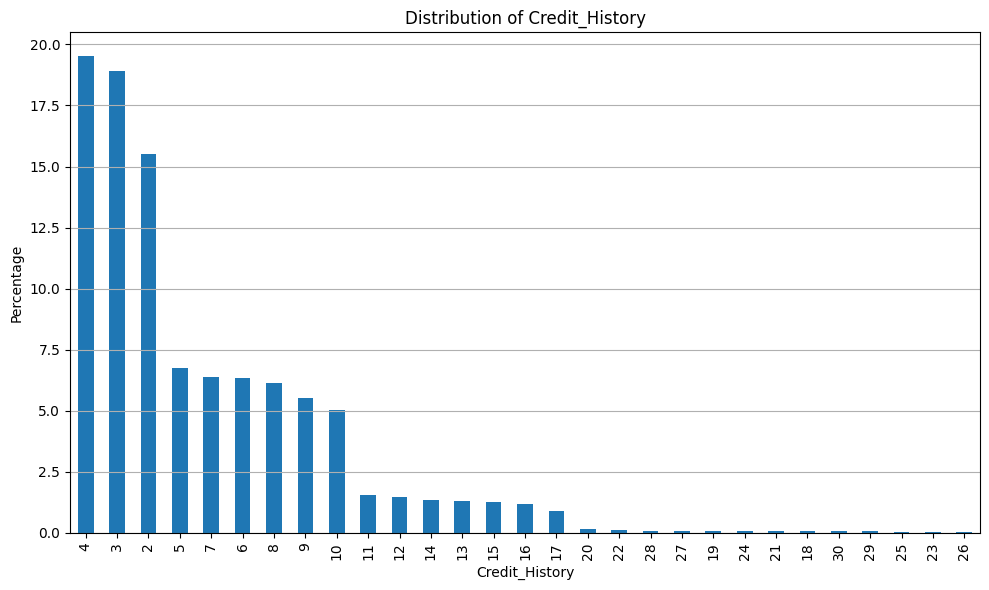



Describe:
count    10000.000000
mean         5.759700
std          3.904674
min          2.000000
25%          3.000000
50%          4.000000
75%          8.000000
max         30.000000
Name: Credit_History, dtype: float64


Group Analysis for Credit_Score
Column Name: Credit_Score


Values Percentage:
Credit_Score
656    1.05
637    1.01
646    0.97
658    0.95
647    0.94
       ... 
457    0.01
753    0.01
446    0.01
754    0.01
767    0.01
Name: proportion, Length: 296, dtype: float64






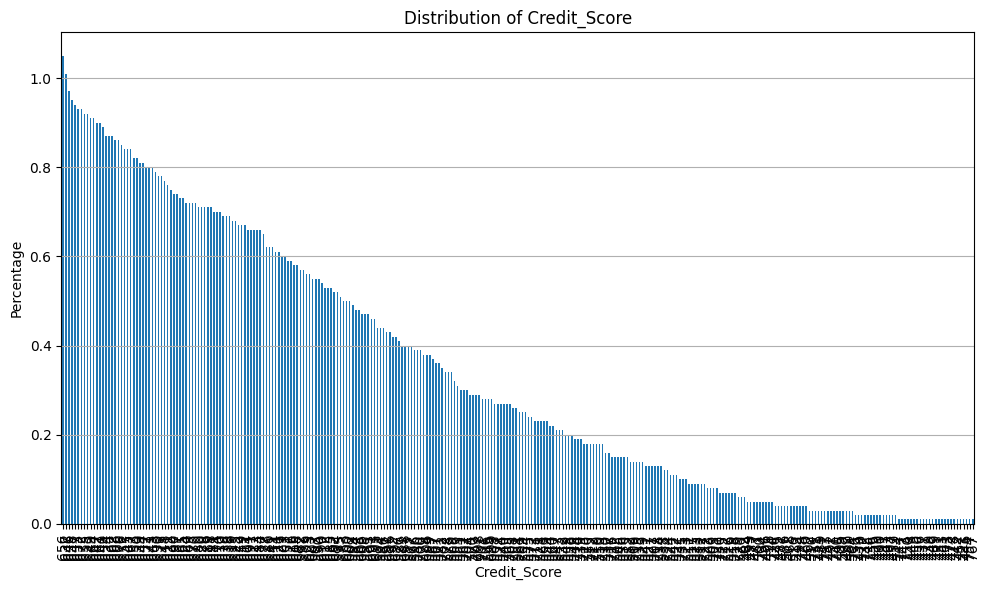



Describe:
count    10000.000000
mean       631.887200
std         50.293485
min        431.000000
25%        601.000000
50%        639.000000
75%        669.000000
max        767.000000
Name: Credit_Score, dtype: float64


Group Analysis for Previous_Loan
Column Name: Previous_Loan


Values Percentage:
Previous_Loan
No    100.0
Name: proportion, dtype: float64






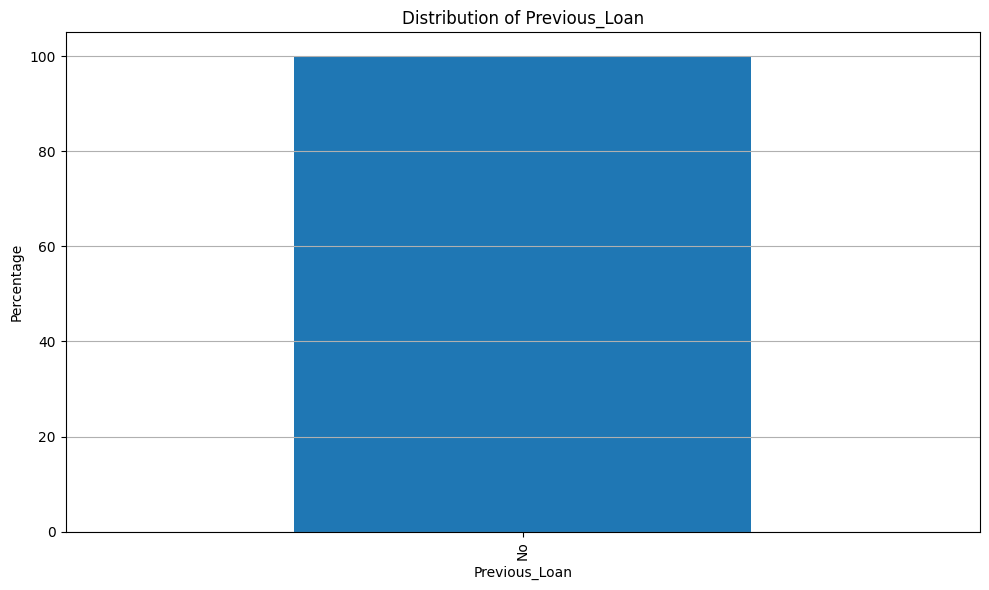



Describe:
count     10000
unique        1
top          No
freq      10000
Name: Previous_Loan, dtype: object


Group Analysis for Loan_Status
Column Name: Loan_Status


Values Percentage:
Loan_Status
1    100.0
Name: proportion, dtype: float64






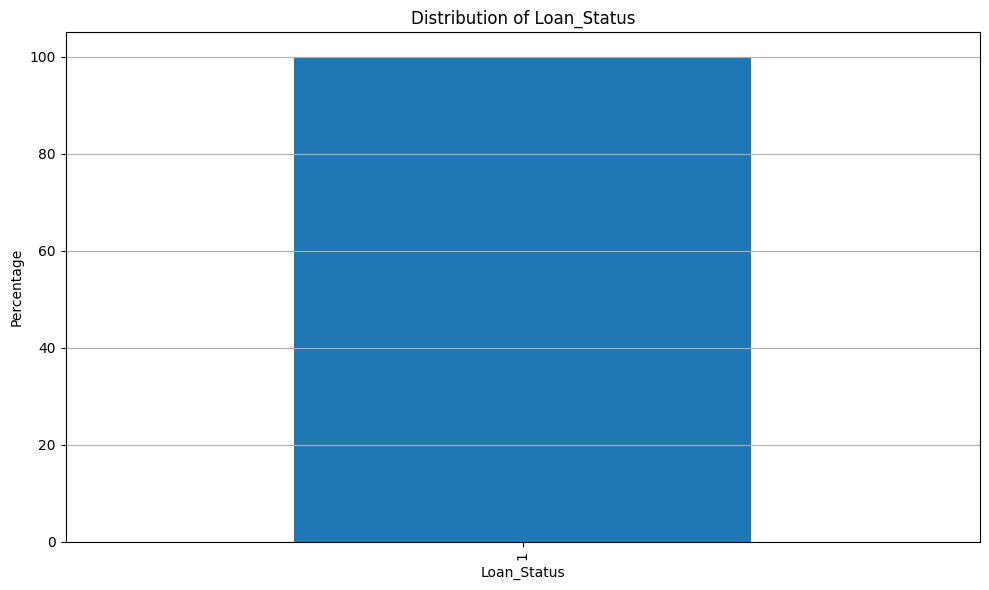



Describe:
count    10000.0
mean         1.0
std          0.0
min          1.0
25%          1.0
50%          1.0
75%          1.0
max          1.0
Name: Loan_Status, dtype: float64


Group Analysis for _LoanStatus
Column Name: _LoanStatus


Values Percentage:
_LoanStatus
Paid    100.0
Name: proportion, dtype: float64






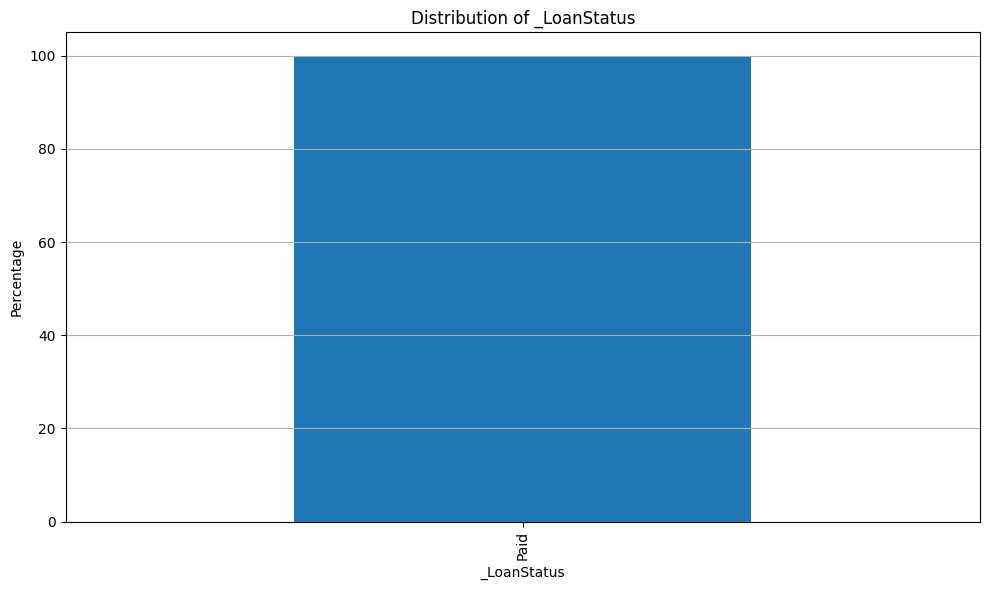



Describe:
count     10000
unique        1
top        Paid
freq      10000
Name: _LoanStatus, dtype: object


Group Analysis for cluster
Column Name: cluster


Values Percentage:
cluster
1    100.0
Name: proportion, dtype: float64






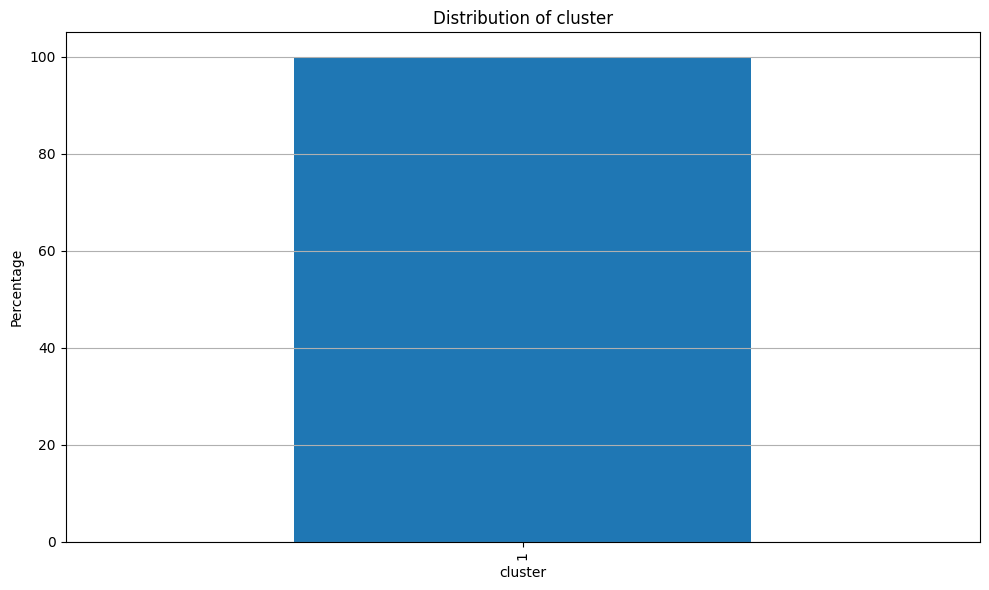



Describe:
count    10000.0
mean         1.0
std          0.0
min          1.0
25%          1.0
50%          1.0
75%          1.0
max          1.0
Name: cluster, dtype: float64




In [ ]:
for col in group_B.columns:
    print(f"Group Analysis for {col}")
    print('='*50)
    print(f'Column Name: {col}')
    print('\n')

    value_counts = group_B[col].value_counts(normalize=True) * 100
    print(f"Values Percentage:\n{value_counts}")
    print('\n')
    print('='*50)
    print('\n')

    plt.figure(figsize=(10, 6))
    value_counts.plot(kind='bar')
    plt.title(f'Distribution of {col}')
    plt.xlabel(col)
    plt.ylabel('Percentage')
    plt.grid(axis='y')
    plt.tight_layout()
    plt.show()

    print('\n')
    print('='*50)
    print(f'Describe:\n{group_B[col].describe()}')
    print('\n')
    print('='*50)

In [ ]:
group_B.describe()

,Age,Yearly_Income,Years_Of_Employment,Loan_Amount,Loan_Interest_Rate,Loan_Percentage_Income,Credit_History,Credit_Score,Loan_Status,cluster
count,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.0,10000.0
mean,27.521300,59886.096900,5.178000,10855.689800,12.856794,20.222700,5.759700,631.887200,1.0,1.0
std,5.939063,45338.315604,5.913207,7111.701674,3.068512,10.628292,3.904674,50.293485,0.0,0.0
min,20.000000,8000.000000,0.000000,900.000000,5.420000,0.000000,2.000000,431.000000,1.0,1.0
25%,23.000000,36841.750000,1.000000,5000.000000,10.990000,11.000000,3.000000,601.000000,1.0,1.0
50%,26.000000,50629.000000,3.000000,9750.000000,12.980000,20.000000,4.000000,639.000000,1.0,1.0
75%,30.000000,71888.250000,8.000000,15000.000000,15.230000,28.000000,8.000000,669.000000,1.0,1.0
max,70.000000,845636.000000,47.000000,35000.000000,20.000000,62.000000,30.000000,767.000000,1.0,1.0


## Group C

In [ ]:
group_C

,Age,Gender,Education_Level,Yearly_Income,Years_Of_Employment,Home_Ownership_Stauts,Loan_Amount,Loan_Purpose,Loan_Interest_Rate,Loan_Percentage_Income,Credit_History,Credit_Score,Previous_Loan,Loan_Status,_LoanStatus,cluster
1,21,Female,High School,12282,0,Own,1000,Education,11.14,8,2,504,Yes,0,Defaulted,2
14,23,Female,Associate,138998,0,Rent,35000,Education,7.90,25,4,583,No,0,Defaulted,2
15,23,Female,Master,600891,5,Mortgage,30000,Debt Consolidation,10.65,5,3,670,Yes,0,Defaulted,2
23,24,Female,Bachelor,13866,0,Own,1500,Personal,7.29,11,3,600,Yes,0,Defaulted,2
33,25,Female,High School,368115,3,Rent,24250,Debt Consolidation,13.85,7,3,567,Yes,0,Defaulted,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
42101,27,Female,High School,107051,2,Mortgage,24000,Medical,11.21,22,5,611,Yes,0,Defaulted,2
42102,28,Female,Associate,36900,6,Rent,2000,Venture,5.77,5,6,526,Yes,0,Defaulted,2
42104,25,Female,Bachelor,64146,2,Mortgage,7200,Venture,10.28,11,3,625,Yes,0,Defaulted,2
42106,28,Female,High School,110291,7,Rent,13453,Venture,13.29,12,6,631,Yes,0,Defaulted,2


Group Analysis for Age
Column Name: Age


Values Percentage:
Age
23    11.530117
24    11.440786
25    10.139102
22     9.099030
26     8.167432
27     6.904033
28     6.106432
29     5.698060
30     4.753701
31     3.905054
32     3.088310
33     2.928790
21     2.571465
34     2.341756
35     1.901480
37     1.531394
36     1.531394
38     1.142164
39     0.893313
40     0.880551
41     0.555130
43     0.484941
42     0.453037
44     0.338183
45     0.274375
47     0.248851
46     0.216947
48     0.146759
49     0.108474
50     0.102093
51     0.089331
53     0.070189
52     0.057427
54     0.051046
20     0.044666
55     0.038285
56     0.031904
57     0.019142
61     0.019142
58     0.019142
66     0.012762
60     0.012762
62     0.012762
64     0.006381
73     0.006381
69     0.006381
59     0.006381
76     0.006381
65     0.006381
Name: proportion, dtype: float64






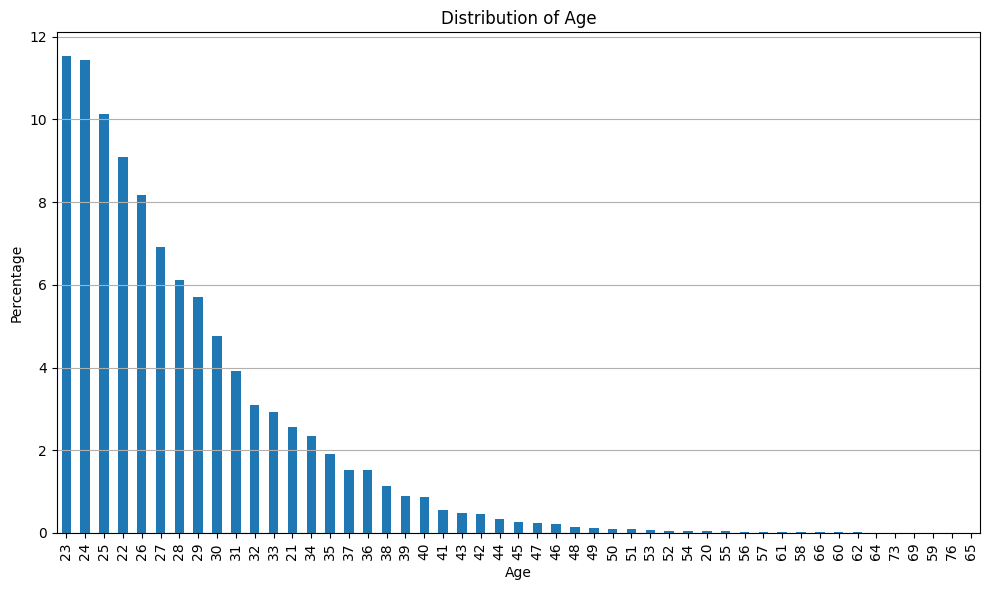



Describe:
count    15672.000000
mean        27.691552
std          5.592477
min         20.000000
25%         24.000000
50%         26.000000
75%         30.000000
max         76.000000
Name: Age, dtype: float64


Group Analysis for Gender
Column Name: Gender


Values Percentage:
Gender
Female    100.0
Name: proportion, dtype: float64






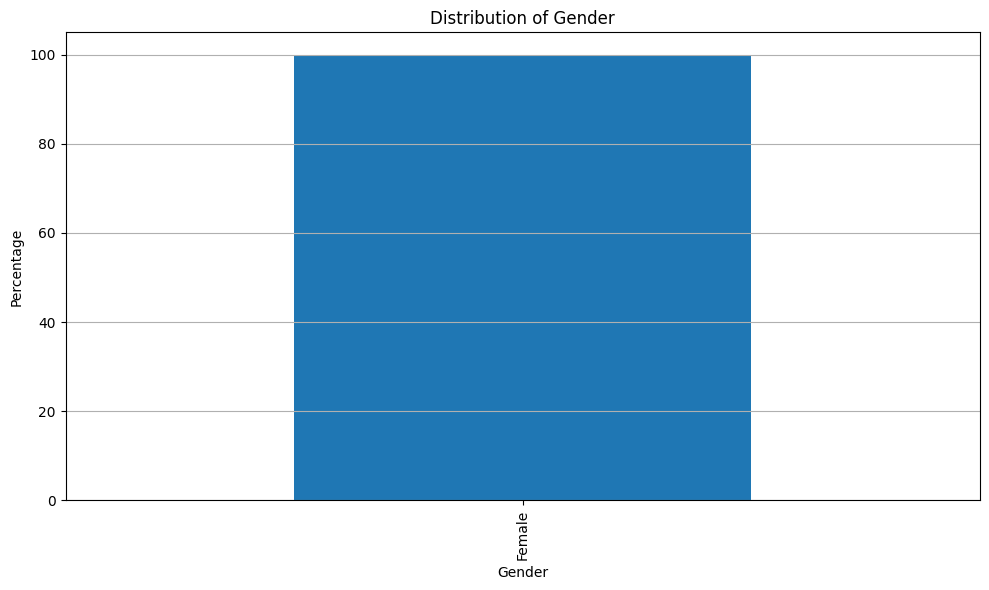



Describe:
count      15672
unique         1
top       Female
freq       15672
Name: Gender, dtype: object


Group Analysis for Education_Level
Column Name: Education_Level


Values Percentage:
Education_Level
Bachelor       29.683512
Associate      26.633486
High School    26.518632
Master         15.786115
Doctorate       1.378254
Name: proportion, dtype: float64






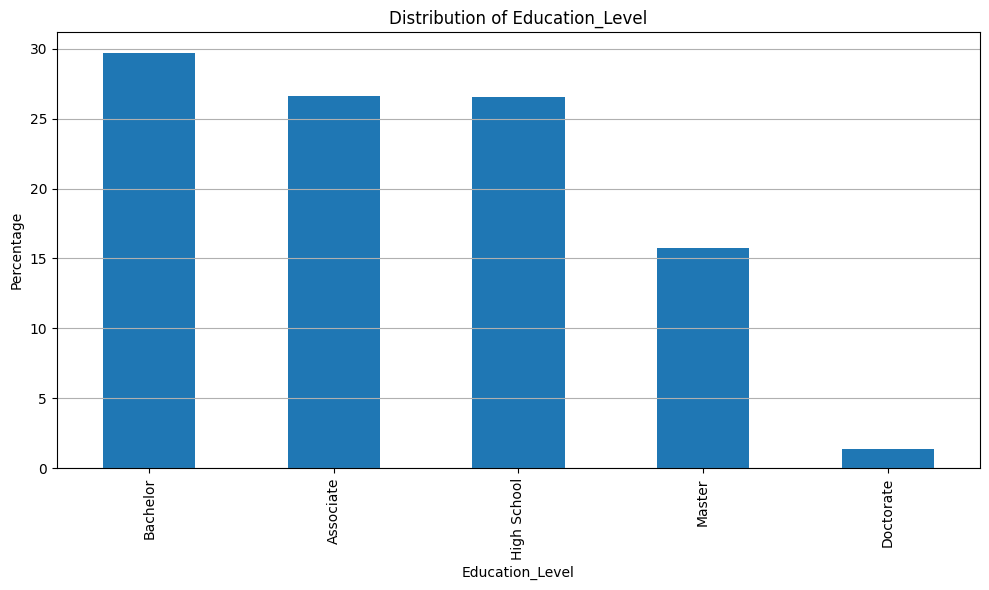



Describe:
count        15672
unique           5
top       Bachelor
freq          4652
Name: Education_Level, dtype: object


Group Analysis for Yearly_Income
Column Name: Yearly_Income


Values Percentage:
Yearly_Income
60914     0.038285
73002     0.038285
73094     0.031904
73071     0.031904
61096     0.031904
            ...   
183214    0.006381
184582    0.006381
185905    0.006381
185611    0.006381
181307    0.006381
Name: proportion, Length: 13815, dtype: float64






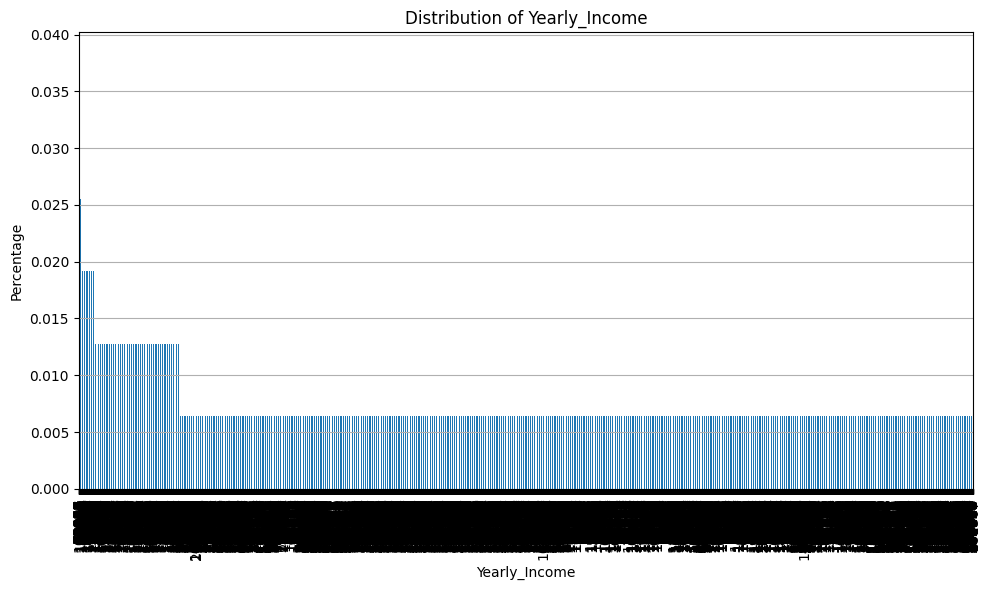



Describe:
count    1.567200e+04
mean     8.472282e+04
std      6.246560e+04
min      9.850000e+03
25%      5.135400e+04
50%      7.285050e+04
75%      1.002682e+05
max      2.280980e+06
Name: Yearly_Income, dtype: float64


Group Analysis for Years_Of_Employment
Column Name: Years_Of_Employment


Values Percentage:
Years_Of_Employment
0     20.578101
2      9.258550
1      8.748086
3      8.645993
4      8.027055
5      6.674324
6      6.399949
7      5.072741
8      4.096478
9      3.834865
10     3.005360
11     2.743747
12     2.150332
13     1.805768
14     1.633486
15     1.263400
16     1.110260
17     0.931598
18     0.765697
19     0.593415
20     0.453037
22     0.357325
21     0.350944
24     0.267994
25     0.216947
23     0.210567
26     0.185043
31     0.095712
27     0.095712
28     0.076570
29     0.070189
34     0.051046
32     0.051046
30     0.038285
38     0.031904
44     0.019142
47     0.012762
36     0.012762
33     0.012762
40     0.012762
39     0.012762
41   

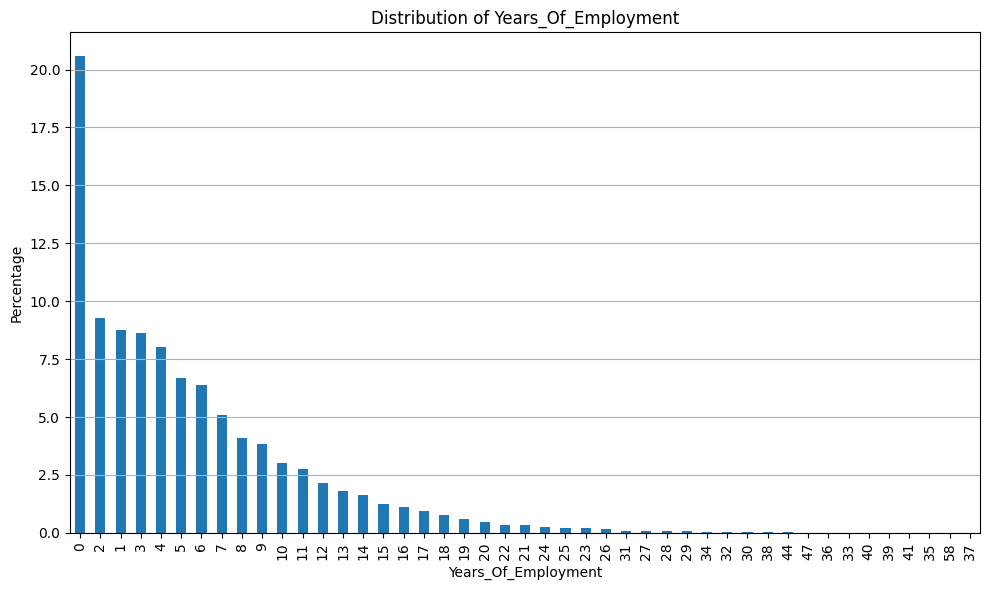



Describe:
count    15672.000000
mean         5.355539
std          5.623574
min          0.000000
25%          1.000000
50%          4.000000
75%          8.000000
max         58.000000
Name: Years_Of_Employment, dtype: float64


Group Analysis for Home_Ownership_Stauts
Column Name: Home_Ownership_Stauts


Values Percentage:
Home_Ownership_Stauts
Mortgage    46.752169
Rent        45.290965
Own          7.746299
Other        0.210567
Name: proportion, dtype: float64






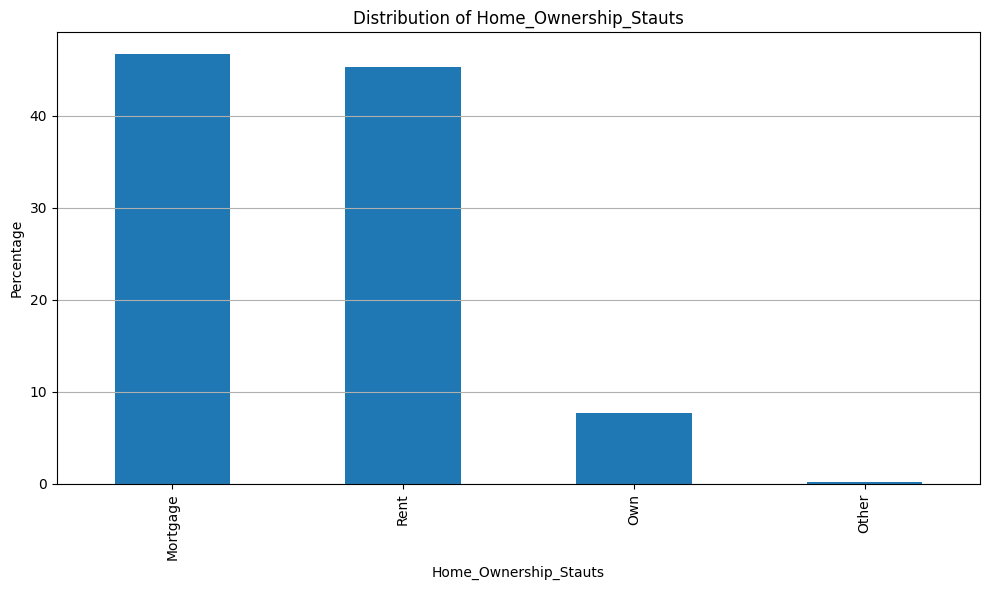



Describe:
count        15672
unique           4
top       Mortgage
freq          7327
Name: Home_Ownership_Stauts, dtype: object


Group Analysis for Loan_Amount
Column Name: Loan_Amount


Values Percentage:
Loan_Amount
10000    8.409903
5000     6.540327
6000     5.940531
12000    5.755487
8000     4.670750
           ...   
1029     0.006381
9581     0.006381
6186     0.006381
8537     0.006381
10993    0.006381
Name: proportion, Length: 1778, dtype: float64






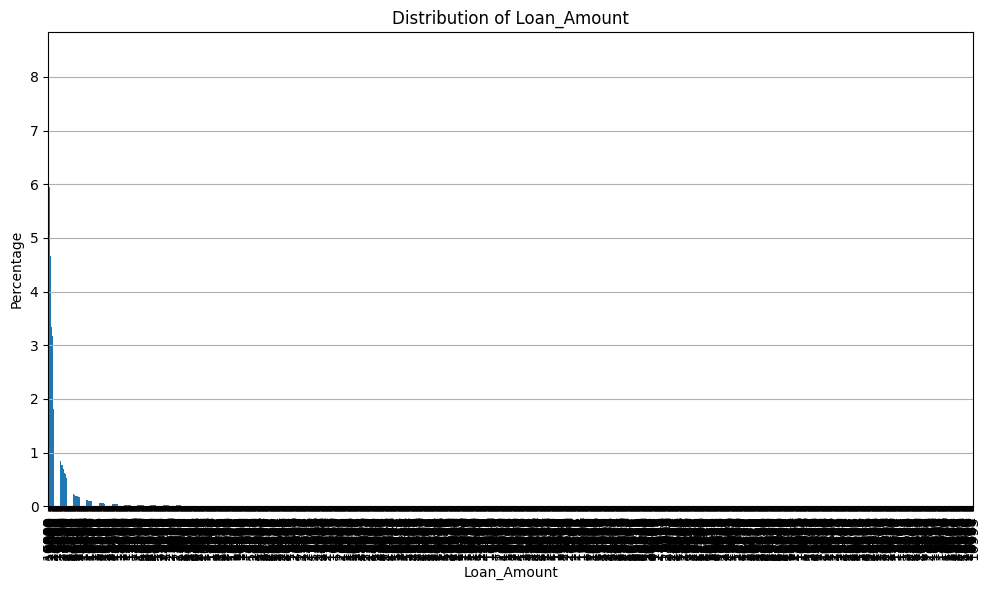



Describe:
count    15672.000000
mean      9129.268568
std       5933.244767
min        500.000000
25%       5000.000000
50%       8000.000000
75%      12000.000000
max      35000.000000
Name: Loan_Amount, dtype: float64


Group Analysis for Loan_Purpose
Column Name: Loan_Purpose


Values Percentage:
Loan_Purpose
Education             21.592649
Venture               19.289178
Medical               17.834354
Personal              17.304747
Debt Consolidation    14.139867
Home Improvement       9.839204
Name: proportion, dtype: float64






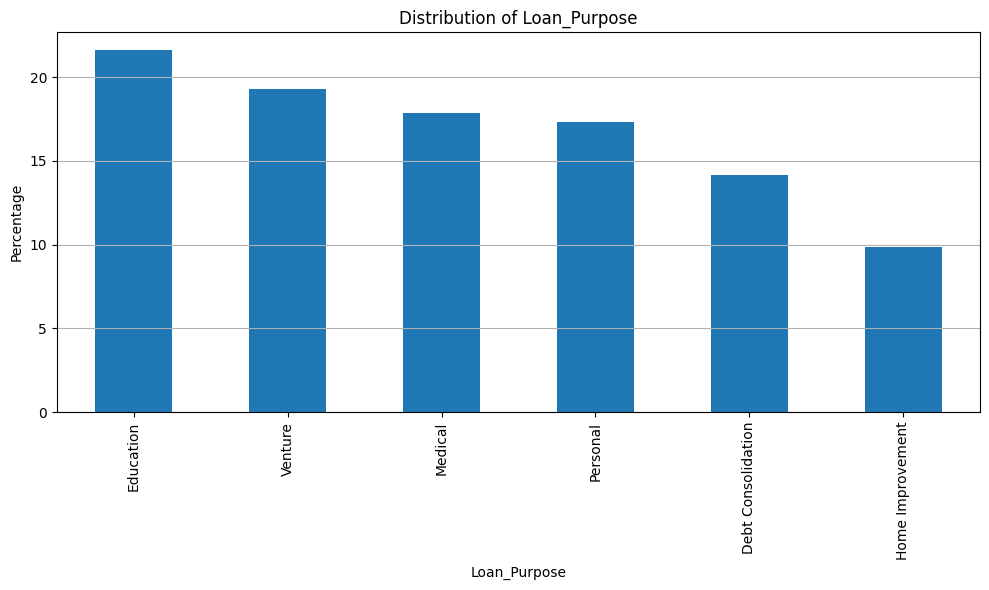



Describe:
count         15672
unique            6
top       Education
freq           3384
Name: Loan_Purpose, dtype: object


Group Analysis for Loan_Interest_Rate
Column Name: Loan_Interest_Rate


Values Percentage:
Loan_Interest_Rate
11.01    7.580398
10.99    2.048239
7.51     1.939765
7.49     1.869576
7.88     1.831291
           ...   
6.36     0.006381
5.80     0.006381
5.74     0.006381
6.52     0.006381
13.78    0.006381
Name: proportion, Length: 1066, dtype: float64






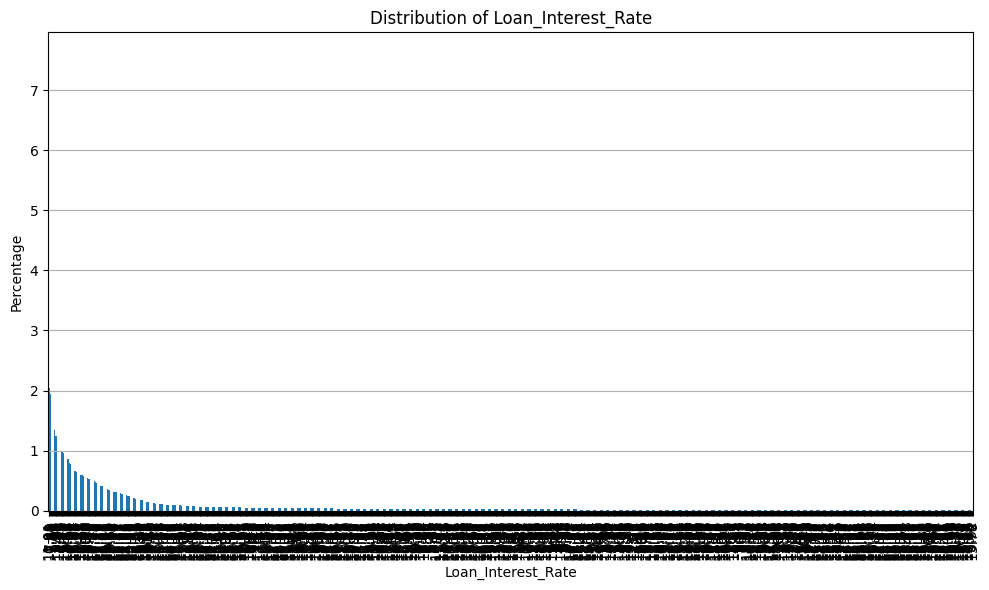



Describe:
count    15672.000000
mean        10.469274
std          2.732215
min          5.420000
25%          7.900000
50%         10.850000
75%         12.230000
max         20.000000
Name: Loan_Interest_Rate, dtype: float64


Group Analysis for Loan_Percentage_Income
Column Name: Loan_Percentage_Income


Values Percentage:
Loan_Percentage_Income
7     6.438234
8     6.265952
10    5.883104
9     5.691679
6     5.583206
5     5.564063
11    5.468351
12    5.308831
4     5.123788
14    4.779224
13    4.338948
15    4.096478
16    4.083716
3     3.834865
17    3.177642
18    2.979837
19    2.756508
20    2.743747
2     2.316233
21    2.201378
22    1.952527
23    1.767483
24    1.473966
25    0.982644
28    0.976263
1     0.803982
27    0.574273
26    0.561511
30    0.370087
32    0.299898
33    0.229709
31    0.223328
36    0.172282
34    0.140378
37    0.127616
35    0.114855
41    0.102093
39    0.082950
38    0.063808
40    0.063808
42    0.051046
0     0.051046
43    0.031904
52

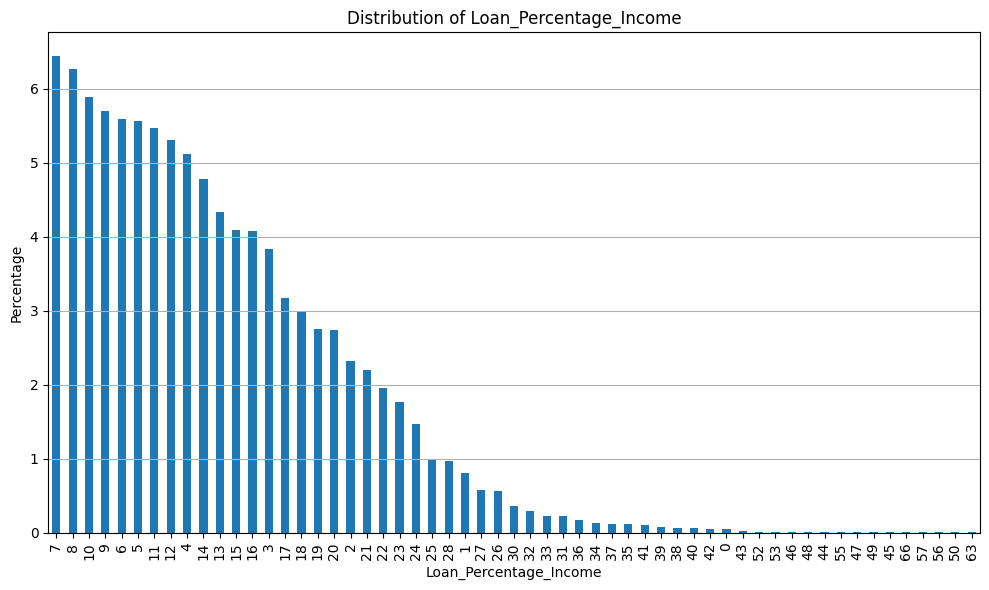



Describe:
count    15672.000000
mean        12.183895
std          7.167219
min          0.000000
25%          7.000000
50%         11.000000
75%         16.000000
max         66.000000
Name: Loan_Percentage_Income, dtype: float64


Group Analysis for Credit_History
Column Name: Credit_History


Values Percentage:
Credit_History
4     19.404033
3     18.370342
2     14.044155
5      6.846605
6      6.750893
8      6.444615
7      6.425472
9      6.297856
10     5.774630
11     1.569678
14     1.391016
12     1.371873
13     1.359112
15     1.237876
17     1.116641
16     1.091118
20     0.063808
28     0.057427
19     0.051046
26     0.044666
18     0.044666
23     0.038285
30     0.038285
22     0.038285
25     0.031904
21     0.025523
24     0.025523
27     0.025523
29     0.019142
Name: proportion, dtype: float64






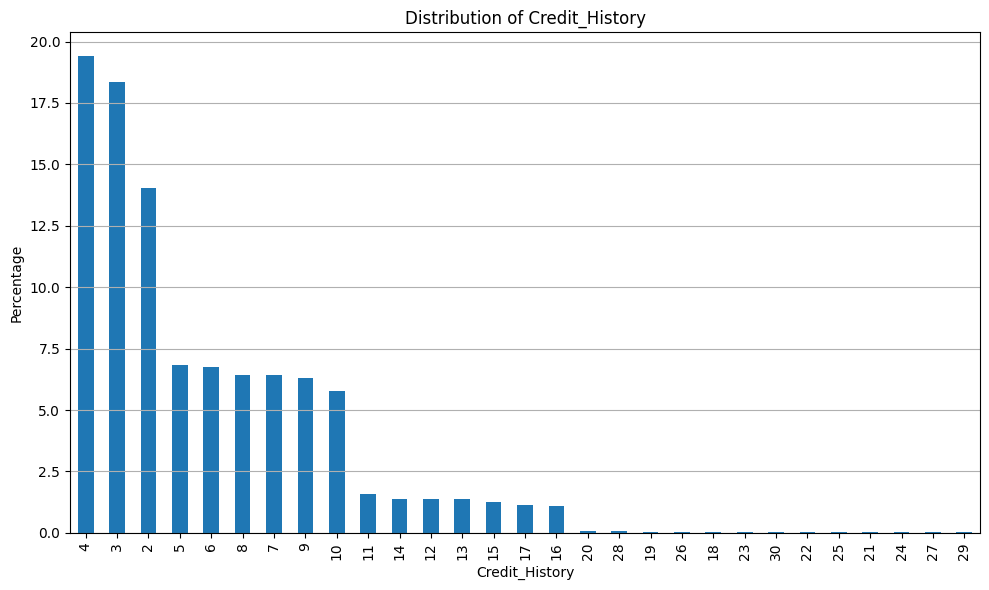



Describe:
count    15672.000000
mean         5.842777
std          3.748597
min          2.000000
25%          3.000000
50%          4.000000
75%          8.000000
max         30.000000
Name: Credit_History, dtype: float64


Group Analysis for Credit_Score
Column Name: Credit_Score


Values Percentage:
Credit_Score
649    1.001787
653    0.957121
652    0.912455
650    0.906075
646    0.906075
         ...   
751    0.006381
419    0.006381
441    0.006381
461    0.006381
439    0.006381
Name: proportion, Length: 301, dtype: float64






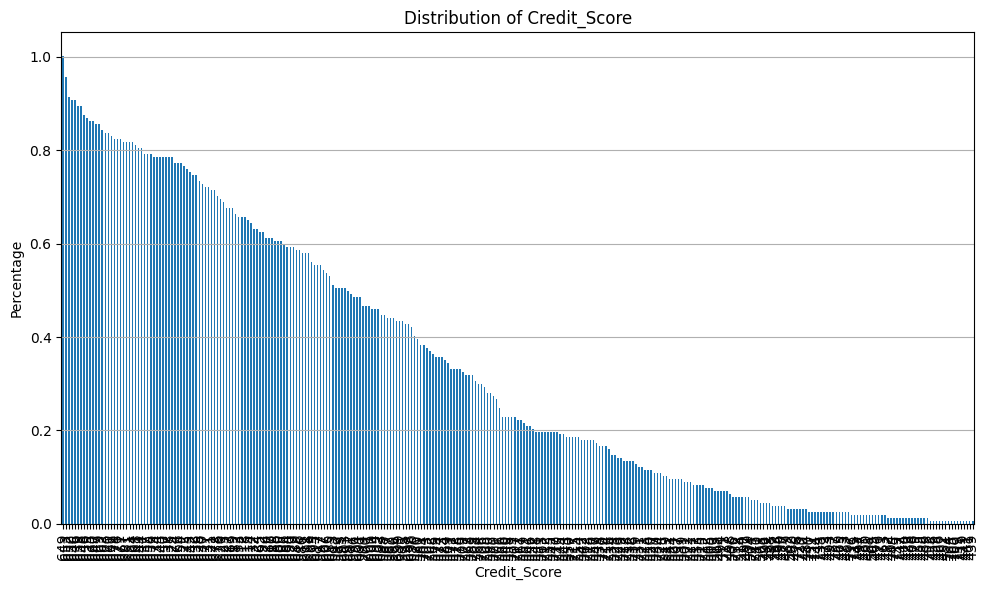



Describe:
count    15672.000000
mean       632.956036
std         50.167570
min        419.000000
25%        602.000000
50%        640.000000
75%        670.000000
max        765.000000
Name: Credit_Score, dtype: float64


Group Analysis for Previous_Loan
Column Name: Previous_Loan


Values Percentage:
Previous_Loan
Yes    65.282032
No     34.717968
Name: proportion, dtype: float64






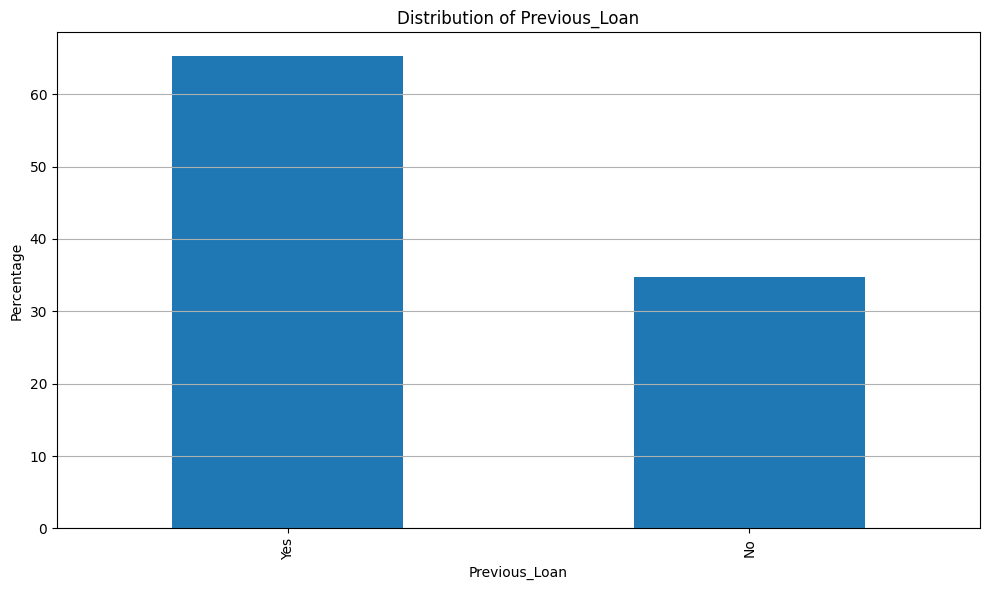



Describe:
count     15672
unique        2
top         Yes
freq      10231
Name: Previous_Loan, dtype: object


Group Analysis for Loan_Status
Column Name: Loan_Status


Values Percentage:
Loan_Status
0    100.0
Name: proportion, dtype: float64






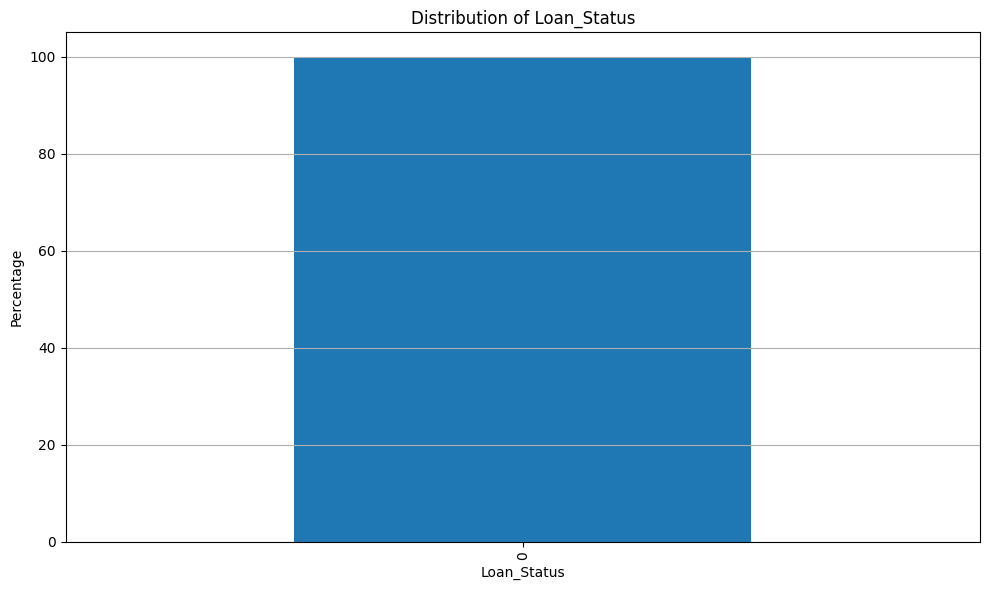



Describe:
count    15672.0
mean         0.0
std          0.0
min          0.0
25%          0.0
50%          0.0
75%          0.0
max          0.0
Name: Loan_Status, dtype: float64


Group Analysis for _LoanStatus
Column Name: _LoanStatus


Values Percentage:
_LoanStatus
Defaulted    100.0
Name: proportion, dtype: float64






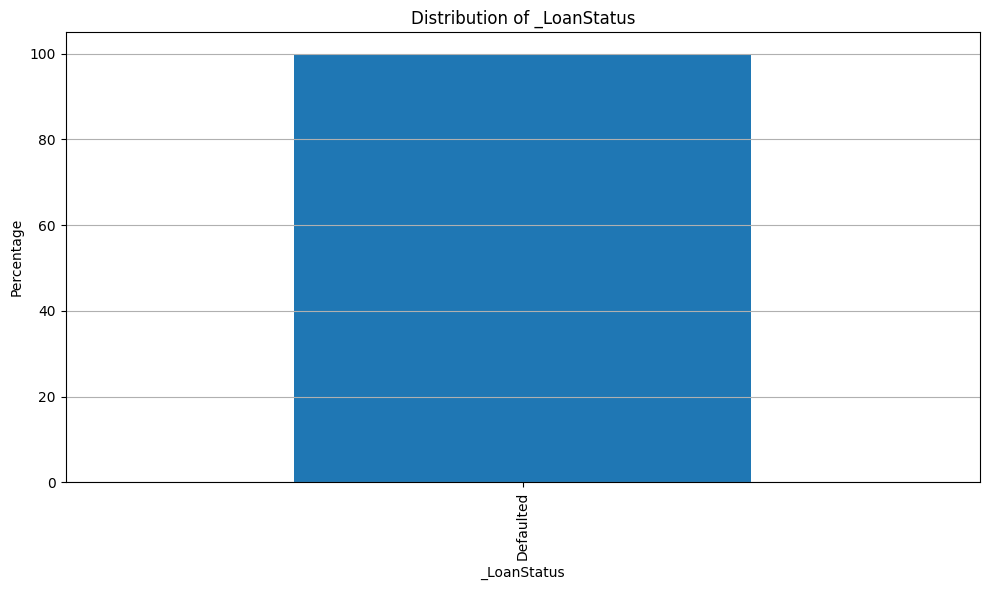



Describe:
count         15672
unique            1
top       Defaulted
freq          15672
Name: _LoanStatus, dtype: object


Group Analysis for cluster
Column Name: cluster


Values Percentage:
cluster
2    100.0
Name: proportion, dtype: float64






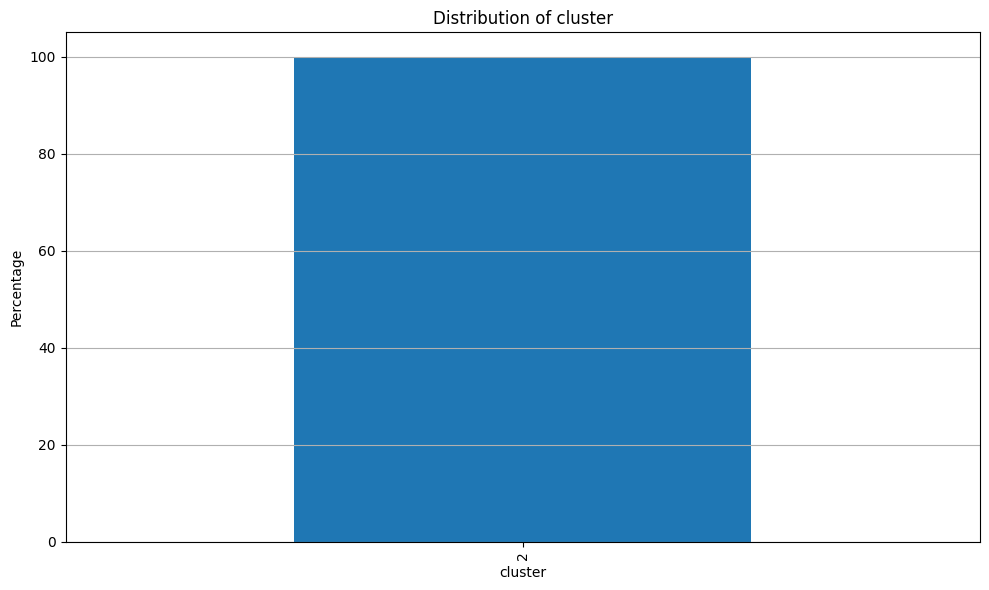



Describe:
count    15672.0
mean         2.0
std          0.0
min          2.0
25%          2.0
50%          2.0
75%          2.0
max          2.0
Name: cluster, dtype: float64




In [ ]:
for col in group_C.columns:
    print(f"Group Analysis for {col}")
    print('='*50)
    print(f'Column Name: {col}')
    print('\n')

    value_counts = group_C[col].value_counts(normalize=True) * 100
    print(f"Values Percentage:\n{value_counts}")
    print('\n')
    print('='*50)
    print('\n')

    plt.figure(figsize=(10, 6))
    value_counts.plot(kind='bar')
    plt.title(f'Distribution of {col}')
    plt.xlabel(col)
    plt.ylabel('Percentage')
    plt.grid(axis='y')
    plt.tight_layout()
    plt.show()

    print('\n')
    print('='*50)
    print(f'Describe:\n{group_C[col].describe()}')
    print('\n')
    print('='*50)

In [ ]:
group_C.describe()

,Age,Yearly_Income,Years_Of_Employment,Loan_Amount,Loan_Interest_Rate,Loan_Percentage_Income,Credit_History,Credit_Score,Loan_Status,cluster
count,15672.000000,1.567200e+04,15672.000000,15672.000000,15672.000000,15672.000000,15672.000000,15672.000000,15672.0,15672.0
mean,27.691552,8.472282e+04,5.355539,9129.268568,10.469274,12.183895,5.842777,632.956036,0.0,2.0
std,5.592477,6.246560e+04,5.623574,5933.244767,2.732215,7.167219,3.748597,50.167570,0.0,0.0
min,20.000000,9.850000e+03,0.000000,500.000000,5.420000,0.000000,2.000000,419.000000,0.0,2.0
25%,24.000000,5.135400e+04,1.000000,5000.000000,7.900000,7.000000,3.000000,602.000000,0.0,2.0
50%,26.000000,7.285050e+04,4.000000,8000.000000,10.850000,11.000000,4.000000,640.000000,0.0,2.0
75%,30.000000,1.002682e+05,8.000000,12000.000000,12.230000,16.000000,8.000000,670.000000,0.0,2.0
max,76.000000,2.280980e+06,58.000000,35000.000000,20.000000,66.000000,30.000000,765.000000,0.0,2.0


# Feature Enginnering

In [ ]:
df.head()

,Age,Gender,Education_Level,Yearly_Income,Years_Of_Employment,Home_Ownership_Stauts,Loan_Amount,Loan_Purpose,Loan_Interest_Rate,Loan_Percentage_Income,Credit_History,Credit_Score,Previous_Loan,Loan_Status,_LoanStatus,cluster
0,22,Female,Master,71948,0,Rent,35000,Personal,16.02,49,3,561,No,1,Paid,1
1,21,Female,High School,12282,0,Own,1000,Education,11.14,8,2,504,Yes,0,Defaulted,2
2,25,Female,High School,12438,3,Mortgage,5500,Medical,12.87,44,3,635,No,1,Paid,1
3,23,Female,Bachelor,79753,0,Rent,35000,Medical,15.23,44,2,675,No,1,Paid,1
4,24,Male,Master,66135,1,Rent,35000,Medical,14.27,53,4,586,No,1,Paid,1


In [ ]:
df['monthly_income'] = round(df['Yearly_Income'] / 12).astype(int)

In [ ]:
df['Credit_Score'].describe()

,Credit_Score
count,44993.000000
mean,632.585713
std,50.402411
min,390.000000
25%,601.000000
50%,640.000000
75%,670.000000
max,784.000000


In [ ]:
round(784/3)

261

In [ ]:
261*2

522

In [ ]:
261+522+1

784

In [ ]:
df['scores'] = pd.cut(df['Credit_Score'], bins=[1, 261, 522, float('inf')], labels=['Low Score', 'Medium Score', 'High Score'], right=False)

In [ ]:
df['Loan_Interest_Rate'].describe()

,Loan_Interest_Rate
count,44993.000000
mean,11.006448
std,2.978985
min,5.420000
25%,8.590000
50%,11.010000
75%,12.990000
max,20.000000


In [ ]:
df['Interest_Rate'] = pd.cut(df['Loan_Interest_Rate'], bins=[1, 10, 20, float('inf')], labels=['Low Interest Rate', 'Medium Interest Rate', 'High Interest Rate'], right=False)

In [ ]:
df['Loan_To_Income_Ratio'] = df['Loan_Amount'] / df['Yearly_Income'] * 100

In [ ]:
df['Monthly_Loan_Payment'] = df['Loan_Amount'] * (df['Loan_Interest_Rate'] / 100) / 12

In [ ]:
df['Loan_Burden_Percentage'] = round(df['Monthly_Loan_Payment'] / df['monthly_income'] * 100)

In [ ]:
df['Employment_To_Age_Ratio'] = round(df['Years_Of_Employment'] / df['Age'] * 100).astype(int)

In [ ]:
df['Credit_Utilization'] = round(df['Loan_Amount'] / df['Credit_History'])

In [ ]:
pd.set_option('display.max_columns', None)

In [ ]:
df['Credit_Utilization'].astype(int)

,Credit_Utilization
0,11667
1,500
2,1833
3,17500
4,8750
...,...
44995,5000
44996,818
44997,277
44998,2000


In [ ]:
df['Credit_Utilization'].describe()

,Credit_Utilization
count,44993.000000
mean,2293.374436
std,2100.719198
min,34.000000
25%,853.000000
50%,1667.000000
75%,3000.000000
max,17500.000000


In [ ]:
df['Age'].describe()

,Age
count,44993.000000
mean,27.748428
std,5.909737
min,20.000000
25%,24.000000
50%,26.000000
75%,30.000000
max,94.000000


In [ ]:
df['Age_Group'] = pd.cut(df['Age'], bins=[20, 25, 35, 50, float('inf')], labels=['Young', 'Adult', 'Middle-Aged', 'Senior'], right=False)

In [ ]:
df.head()

,Age,Gender,Education_Level,Yearly_Income,Years_Of_Employment,Home_Ownership_Stauts,Loan_Amount,Loan_Purpose,Loan_Interest_Rate,Loan_Percentage_Income,Credit_History,Credit_Score,Previous_Loan,Loan_Status,_LoanStatus,cluster,monthly_income,scores,Interest_Rate,Loan_To_Income_Ratio,Monthly_Loan_Payment,Loan_Burden_Percentage,Employment_To_Age_Ratio,Credit_Utilization,Age_Group
0,22,Female,Master,71948,0,Rent,35000,Personal,16.02,49,3,561,No,1,Paid,1,5996,High Score,Medium Interest Rate,48.646245,467.250000,8.0,0,11667.0,Young
1,21,Female,High School,12282,0,Own,1000,Education,11.14,8,2,504,Yes,0,Defaulted,2,1024,Medium Score,Medium Interest Rate,8.141996,9.283333,1.0,0,500.0,Young
2,25,Female,High School,12438,3,Mortgage,5500,Medical,12.87,44,3,635,No,1,Paid,1,1036,High Score,Medium Interest Rate,44.219328,58.987500,6.0,12,1833.0,Adult
3,23,Female,Bachelor,79753,0,Rent,35000,Medical,15.23,44,2,675,No,1,Paid,1,6646,High Score,Medium Interest Rate,43.885496,444.208333,7.0,0,17500.0,Young
4,24,Male,Master,66135,1,Rent,35000,Medical,14.27,53,4,586,No,1,Paid,1,5511,High Score,Medium Interest Rate,52.922053,416.208333,8.0,4,8750.0,Young


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 44993 entries, 0 to 44999
Data columns (total 25 columns):
 #   Column                   Non-Null Count  Dtype   
---  ------                   --------------  -----   
 0   Age                      44993 non-null  int64   
 1   Gender                   44993 non-null  object  
 2   Education_Level          44993 non-null  object  
 3   Yearly_Income            44993 non-null  int64   
 4   Years_Of_Employment      44993 non-null  int64   
 5   Home_Ownership_Stauts    44993 non-null  object  
 6   Loan_Amount              44993 non-null  int64   
 7   Loan_Purpose             44993 non-null  object  
 8   Loan_Interest_Rate       44993 non-null  float64 
 9   Loan_Percentage_Income   44993 non-null  int64   
 10  Credit_History           44993 non-null  int64   
 11  Credit_Score             44993 non-null  int64   
 12  Previous_Loan            44993 non-null  object  
 13  Loan_Status              44993 non-null  int64   
 14  _LoanStatus

In [ ]:
df['cluster'] = df['cluster'].astype(np.int64)

In [ ]:
df = df.astype({'Age_Group': 'object', 'Interest_Rate': 'object', 'scores': 'object'})

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 44993 entries, 0 to 44999
Data columns (total 25 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   Age                      44993 non-null  int64  
 1   Gender                   44993 non-null  object 
 2   Education_Level          44993 non-null  object 
 3   Yearly_Income            44993 non-null  int64  
 4   Years_Of_Employment      44993 non-null  int64  
 5   Home_Ownership_Stauts    44993 non-null  object 
 6   Loan_Amount              44993 non-null  int64  
 7   Loan_Purpose             44993 non-null  object 
 8   Loan_Interest_Rate       44993 non-null  float64
 9   Loan_Percentage_Income   44993 non-null  int64  
 10  Credit_History           44993 non-null  int64  
 11  Credit_Score             44993 non-null  int64  
 12  Previous_Loan            44993 non-null  object 
 13  Loan_Status              44993 non-null  int64  
 14  _LoanStatus              44

In [ ]:
df.isna().sum()

,0
Age,0
Gender,0
Education_Level,0
Yearly_Income,0
Years_Of_Employment,0
Home_Ownership_Stauts,0
Loan_Amount,0
Loan_Purpose,0
Loan_Interest_Rate,0
Loan_Percentage_Income,0


In [ ]:
df.duplicated().sum()

np.int64(0)

## Modeling Feature Enginnering

In [ ]:
models = [LogisticRegression(), DecisionTreeClassifier(), RandomForestClassifier(), GradientBoostingClassifier(), AdaBoostClassifier(), BaggingClassifier(), ExtraTreesClassifier(), KNeighborsClassifier(), XGBClassifier(), LGBMClassifier()]

In [ ]:
df.head()

,Age,Gender,Education_Level,Yearly_Income,Years_Of_Employment,Home_Ownership_Stauts,Loan_Amount,Loan_Purpose,Loan_Interest_Rate,Loan_Percentage_Income,Credit_History,Credit_Score,Previous_Loan,Loan_Status,_LoanStatus,cluster,monthly_income,scores,Interest_Rate,Loan_To_Income_Ratio,Monthly_Loan_Payment,Loan_Burden_Percentage,Employment_To_Age_Ratio,Credit_Utilization,Age_Group
0,22,Female,Master,71948,0,Rent,35000,Personal,16.02,49,3,561,No,1,Paid,1,5996,High Score,Medium Interest Rate,48.646245,467.250000,8.0,0,11667.0,Young
1,21,Female,High School,12282,0,Own,1000,Education,11.14,8,2,504,Yes,0,Defaulted,2,1024,Medium Score,Medium Interest Rate,8.141996,9.283333,1.0,0,500.0,Young
2,25,Female,High School,12438,3,Mortgage,5500,Medical,12.87,44,3,635,No,1,Paid,1,1036,High Score,Medium Interest Rate,44.219328,58.987500,6.0,12,1833.0,Adult
3,23,Female,Bachelor,79753,0,Rent,35000,Medical,15.23,44,2,675,No,1,Paid,1,6646,High Score,Medium Interest Rate,43.885496,444.208333,7.0,0,17500.0,Young
4,24,Male,Master,66135,1,Rent,35000,Medical,14.27,53,4,586,No,1,Paid,1,5511,High Score,Medium Interest Rate,52.922053,416.208333,8.0,4,8750.0,Young


In [ ]:
cor = df.corr(numeric_only=True)
cor.round(2)

,Age,Yearly_Income,Years_Of_Employment,Loan_Amount,Loan_Interest_Rate,Loan_Percentage_Income,Credit_History,Credit_Score,Loan_Status,cluster,monthly_income,Loan_To_Income_Ratio,Monthly_Loan_Payment,Loan_Burden_Percentage,Employment_To_Age_Ratio,Credit_Utilization
Age,1.00,0.14,0.95,0.05,0.01,-0.04,0.88,0.17,-0.02,-0.02,0.14,-0.04,0.05,-0.03,0.88,-0.38
Yearly_Income,0.14,1.00,0.13,0.31,-0.00,-0.29,0.13,0.03,-0.17,-0.02,1.00,-0.29,0.27,-0.24,0.14,0.14
Years_Of_Employment,0.95,0.13,1.00,0.05,0.02,-0.04,0.84,0.18,-0.02,-0.01,0.13,-0.04,0.04,-0.03,0.96,-0.36
Loan_Amount,0.05,0.31,0.05,1.00,0.15,0.59,0.04,0.01,0.11,-0.01,0.31,0.59,0.91,0.56,0.05,0.68
Loan_Interest_Rate,0.01,-0.00,0.02,0.15,1.00,0.13,0.02,0.01,0.33,0.01,-0.00,0.13,0.46,0.46,0.02,0.10
Loan_Percentage_Income,-0.04,-0.29,-0.04,0.59,0.13,1.00,-0.03,-0.01,0.38,0.02,-0.29,1.00,0.55,0.88,-0.04,0.45
Credit_History,0.88,0.13,0.84,0.04,0.02,-0.03,1.00,0.15,-0.01,-0.01,0.13,-0.03,0.04,-0.02,0.79,-0.48
Credit_Score,0.17,0.03,0.18,0.01,0.01,-0.01,0.15,1.00,-0.01,0.00,0.03,-0.01,0.01,-0.00,0.18,-0.07
Loan_Status,-0.02,-0.17,-0.02,0.11,0.33,0.38,-0.01,-0.01,1.00,0.05,-0.17,0.39,0.21,0.44,-0.02,0.09
cluster,-0.02,-0.02,-0.01,-0.01,0.01,0.02,-0.01,0.00,0.05,1.00,-0.02,0.02,0.00,0.02,-0.01,-0.00


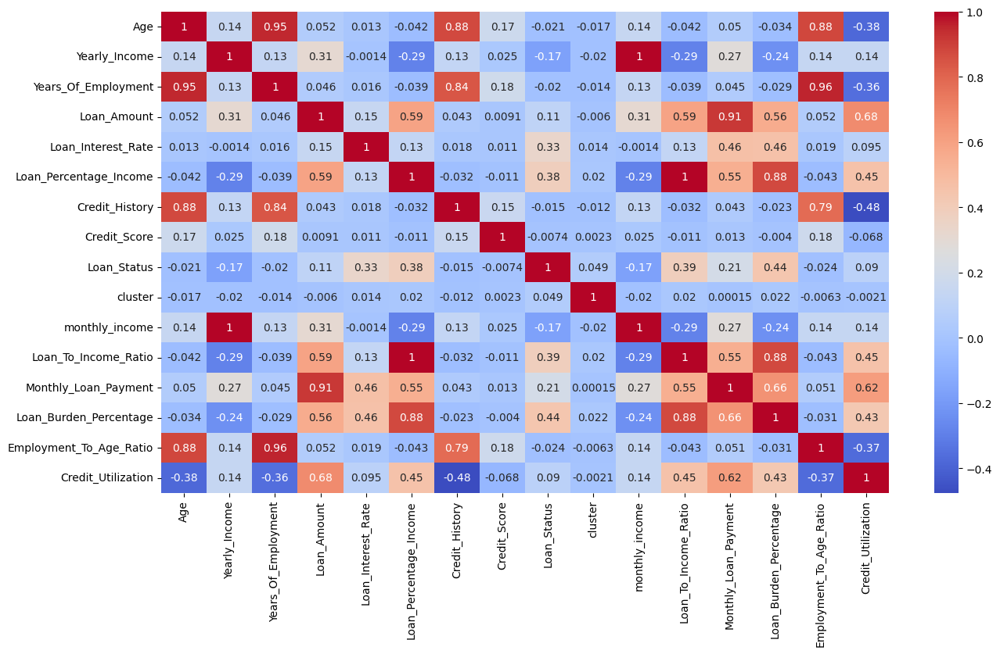

In [ ]:
plt.figure(figsize=(15, 8))
sns.heatmap(cor, cmap='coolwarm', annot=True);

## With Clusters

In [ ]:
drop_from_ml = ['Loan_Status',	'_LoanStatus']
X = df.drop(columns = drop_from_ml)
y = df['Loan_Status']

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, random_state = 42)

In [ ]:
for col in ['scores','Education_Level','Interest_Rate']:
    print('='*50)
    print(f'Column Name: {col}')
    print(f'Unique Values: {df[col].unique()}')
    print(f'Number of Unique Values: {df[col].nunique()}')
    print(f'Value Counts: {df[col].value_counts()}')

Column Name: scores
Unique Values: ['High Score' 'Medium Score']
Number of Unique Values: 2
Value Counts: scores
High Score      43763
Medium Score     1230
Name: count, dtype: int64
Column Name: Education_Level
Unique Values: ['Master' 'High School' 'Bachelor' 'Associate' 'Doctorate']
Number of Unique Values: 5
Value Counts: Education_Level
Bachelor       13396
Associate      12026
High School    11970
Master          6980
Doctorate        621
Name: count, dtype: int64
Column Name: Interest_Rate
Unique Values: ['Medium Interest Rate' 'Low Interest Rate' 'High Interest Rate']
Number of Unique Values: 3
Value Counts: Interest_Rate
Medium Interest Rate    29094
Low Interest Rate       15815
High Interest Rate         84
Name: count, dtype: int64


In [ ]:
ord_cols = ['Education_Level','scores','Interest_Rate']

print("Ordinal Columns:", ord_cols)

Education = {'High School','Associate', 'Bachelor', 'Master', 'Doctorate'}

Scores = {'Medium Score', 'High Score'}

Interest = {'Low Interest Rate', 'Medium Interest Rate', 'High Interest Rate'}

ordinal_category_orders = [Education, Scores, Interest]

ord_encoder = OrdinalEncoder(categories=ordinal_category_orders)

scaler_ord = StandardScaler()

ord_pipe = make_pipeline(ord_encoder, scaler_ord)

ord_tuple = ('ordinal', ord_pipe, ord_cols)

ord_tuple

Ordinal Columns: ['Education_Level', 'scores', 'Interest_Rate']


('ordinal',
 Pipeline(steps=[('ordinalencoder',
                  OrdinalEncoder(categories=[{'Associate', 'Bachelor',
                                              'Doctorate', 'High School',
                                              'Master'},
                                             {'Medium Score', 'High Score'},
                                             {'High Interest Rate',
                                              'Low Interest Rate',
                                              'Medium Interest Rate'}])),
                 ('standardscaler', StandardScaler())]),
 ['Education_Level', 'scores', 'Interest_Rate'])

In [ ]:
ohe_cols = X_train.select_dtypes('object').drop(columns=ord_cols).columns
ohe_encoder = OneHotEncoder(drop='first', sparse_output=False)
cat_pipe = make_pipeline(ohe_encoder)
cat_tuple = ('cat',cat_pipe, ohe_cols)
cat_tuple

('cat',
 Pipeline(steps=[('onehotencoder',
                  OneHotEncoder(drop='first', sparse_output=False))]),
 Index(['Gender', 'Home_Ownership_Stauts', 'Loan_Purpose', 'Previous_Loan',
        'Age_Group'],
       dtype='object'))

In [ ]:
num_cols = X_train.select_dtypes('number').columns
scaler = StandardScaler()
num_pipe = make_pipeline(scaler)
num_tuple = ('num',num_pipe, num_cols)
num_tuple

('num',
 Pipeline(steps=[('standardscaler', StandardScaler())]),
 Index(['Age', 'Yearly_Income', 'Years_Of_Employment', 'Loan_Amount',
        'Loan_Interest_Rate', 'Loan_Percentage_Income', 'Credit_History',
        'Credit_Score', 'cluster', 'monthly_income', 'Loan_To_Income_Ratio',
        'Monthly_Loan_Payment', 'Loan_Burden_Percentage',
        'Employment_To_Age_Ratio', 'Credit_Utilization'],
       dtype='object'))

In [ ]:
preprocessor  = ColumnTransformer([num_tuple,cat_tuple],verbose_feature_names_out=True)

LogisticRegression
----------------------------------------------------------------------
 Classification Metrics: Training Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.93      0.94      0.93     26236
           1       0.78      0.75      0.76      7508

    accuracy                           0.90     33744
   macro avg       0.85      0.84      0.85     33744
weighted avg       0.90      0.90      0.90     33744



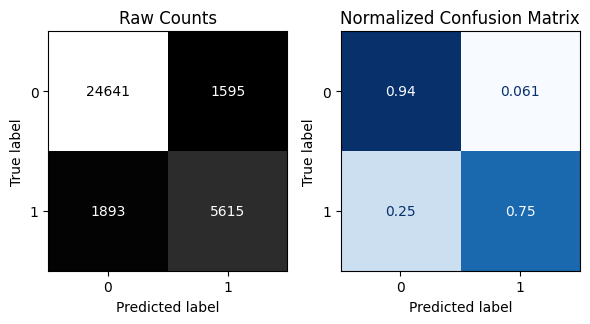


----------------------------------------------------------------------
 Classification Metrics: Test Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.93      0.94      0.94      8757
           1       0.78      0.75      0.77      2492

    accuracy                           0.90     11249
   macro avg       0.86      0.84      0.85     11249
weighted avg       0.90      0.90      0.90     11249



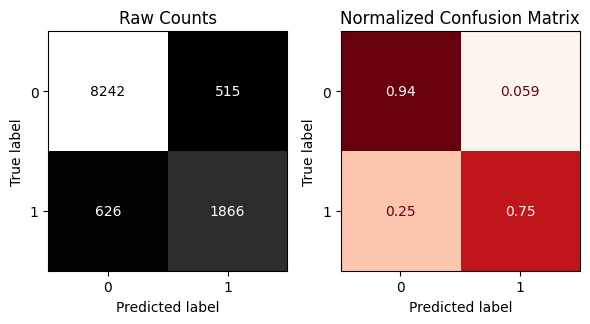

DecisionTreeClassifier
----------------------------------------------------------------------
 Classification Metrics: Training Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     26236
           1       1.00      1.00      1.00      7508

    accuracy                           1.00     33744
   macro avg       1.00      1.00      1.00     33744
weighted avg       1.00      1.00      1.00     33744



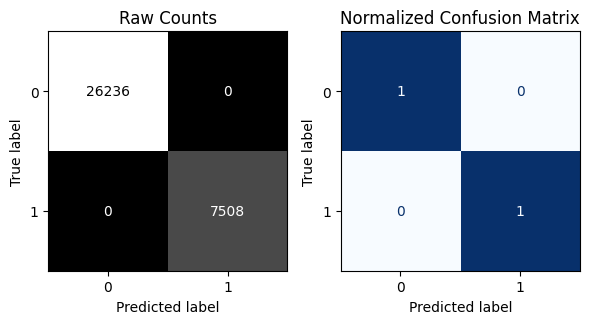


----------------------------------------------------------------------
 Classification Metrics: Test Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       1.00      1.00      1.00      8757
           1       1.00      1.00      1.00      2492

    accuracy                           1.00     11249
   macro avg       1.00      1.00      1.00     11249
weighted avg       1.00      1.00      1.00     11249



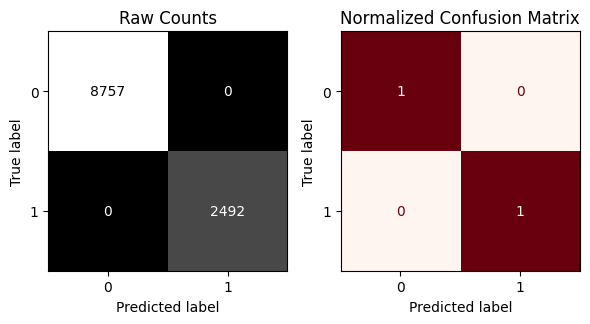

RandomForestClassifier
----------------------------------------------------------------------
 Classification Metrics: Training Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     26236
           1       1.00      1.00      1.00      7508

    accuracy                           1.00     33744
   macro avg       1.00      1.00      1.00     33744
weighted avg       1.00      1.00      1.00     33744



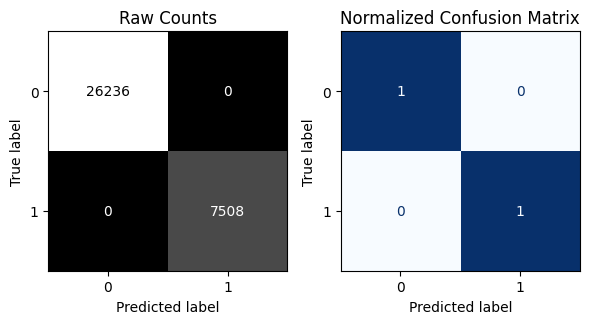


----------------------------------------------------------------------
 Classification Metrics: Test Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       1.00      1.00      1.00      8757
           1       1.00      1.00      1.00      2492

    accuracy                           1.00     11249
   macro avg       1.00      1.00      1.00     11249
weighted avg       1.00      1.00      1.00     11249



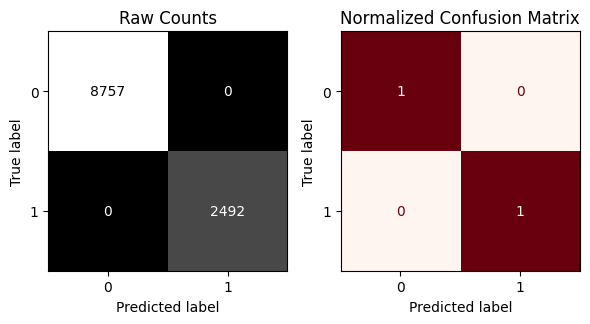

GradientBoostingClassifier
----------------------------------------------------------------------
 Classification Metrics: Training Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     26236
           1       1.00      1.00      1.00      7508

    accuracy                           1.00     33744
   macro avg       1.00      1.00      1.00     33744
weighted avg       1.00      1.00      1.00     33744



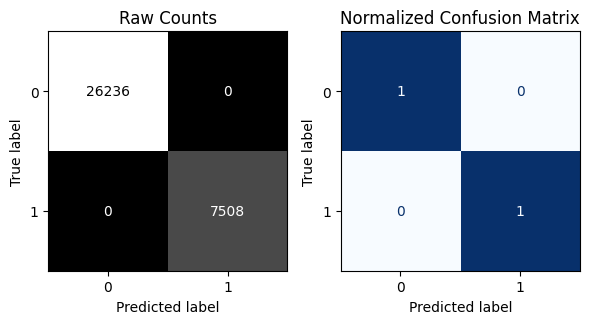


----------------------------------------------------------------------
 Classification Metrics: Test Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       1.00      1.00      1.00      8757
           1       1.00      1.00      1.00      2492

    accuracy                           1.00     11249
   macro avg       1.00      1.00      1.00     11249
weighted avg       1.00      1.00      1.00     11249



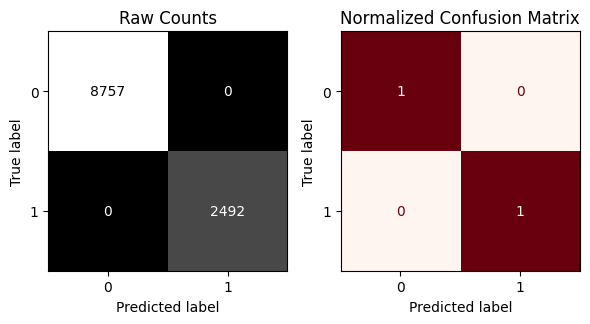

AdaBoostClassifier
----------------------------------------------------------------------
 Classification Metrics: Training Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     26236
           1       1.00      1.00      1.00      7508

    accuracy                           1.00     33744
   macro avg       1.00      1.00      1.00     33744
weighted avg       1.00      1.00      1.00     33744



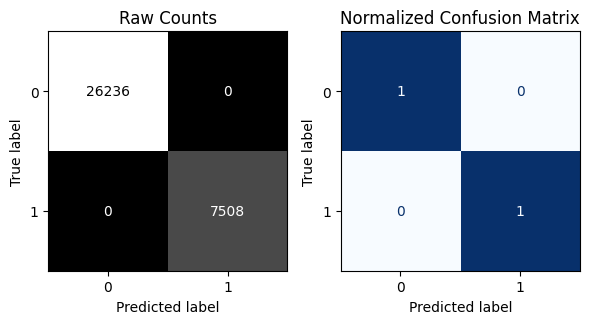


----------------------------------------------------------------------
 Classification Metrics: Test Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       1.00      1.00      1.00      8757
           1       1.00      1.00      1.00      2492

    accuracy                           1.00     11249
   macro avg       1.00      1.00      1.00     11249
weighted avg       1.00      1.00      1.00     11249



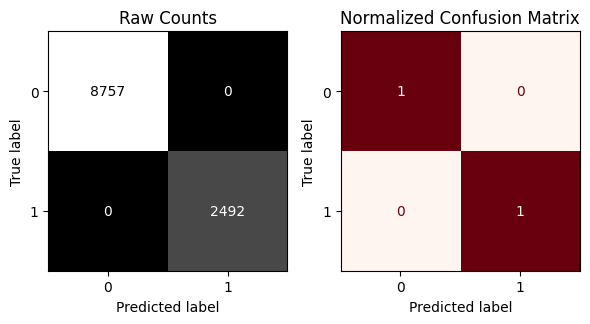

BaggingClassifier
----------------------------------------------------------------------
 Classification Metrics: Training Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     26236
           1       1.00      1.00      1.00      7508

    accuracy                           1.00     33744
   macro avg       1.00      1.00      1.00     33744
weighted avg       1.00      1.00      1.00     33744



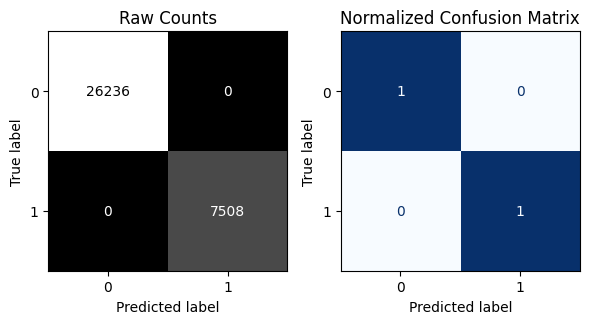


----------------------------------------------------------------------
 Classification Metrics: Test Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       1.00      1.00      1.00      8757
           1       1.00      1.00      1.00      2492

    accuracy                           1.00     11249
   macro avg       1.00      1.00      1.00     11249
weighted avg       1.00      1.00      1.00     11249



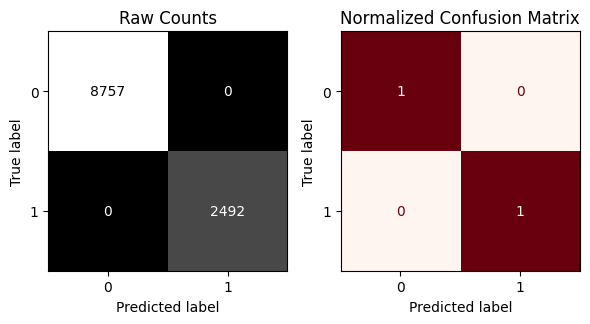

ExtraTreesClassifier
----------------------------------------------------------------------
 Classification Metrics: Training Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     26236
           1       1.00      1.00      1.00      7508

    accuracy                           1.00     33744
   macro avg       1.00      1.00      1.00     33744
weighted avg       1.00      1.00      1.00     33744



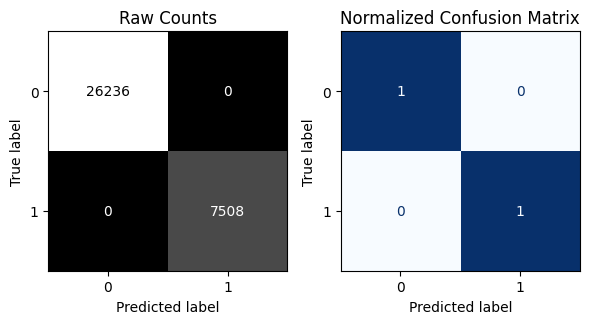


----------------------------------------------------------------------
 Classification Metrics: Test Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       1.00      1.00      1.00      8757
           1       1.00      1.00      1.00      2492

    accuracy                           1.00     11249
   macro avg       1.00      1.00      1.00     11249
weighted avg       1.00      1.00      1.00     11249



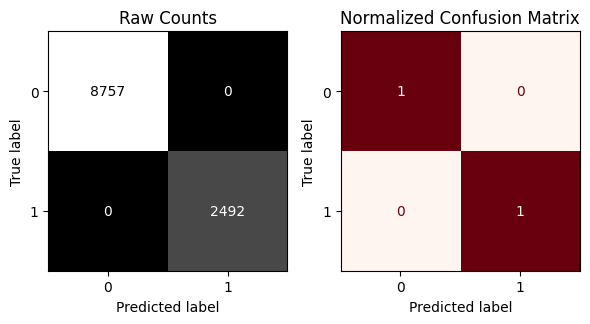

KNeighborsClassifier
----------------------------------------------------------------------
 Classification Metrics: Training Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.99      1.00      1.00     26236
           1       0.99      0.98      0.98      7508

    accuracy                           0.99     33744
   macro avg       0.99      0.99      0.99     33744
weighted avg       0.99      0.99      0.99     33744



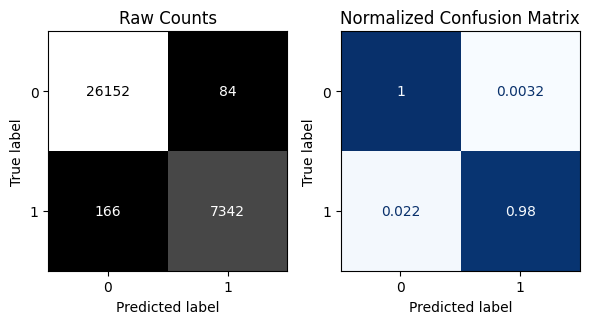


----------------------------------------------------------------------
 Classification Metrics: Test Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.99      0.99      0.99      8757
           1       0.98      0.96      0.97      2492

    accuracy                           0.99     11249
   macro avg       0.98      0.98      0.98     11249
weighted avg       0.99      0.99      0.99     11249



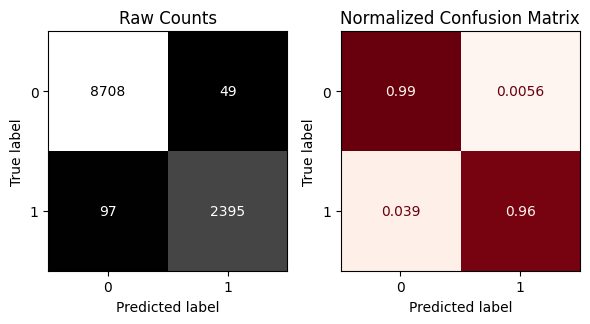

XGBClassifier
----------------------------------------------------------------------
 Classification Metrics: Training Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     26236
           1       1.00      1.00      1.00      7508

    accuracy                           1.00     33744
   macro avg       1.00      1.00      1.00     33744
weighted avg       1.00      1.00      1.00     33744



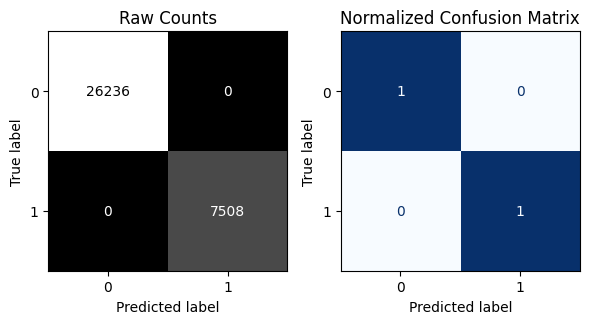


----------------------------------------------------------------------
 Classification Metrics: Test Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       1.00      1.00      1.00      8757
           1       1.00      1.00      1.00      2492

    accuracy                           1.00     11249
   macro avg       1.00      1.00      1.00     11249
weighted avg       1.00      1.00      1.00     11249



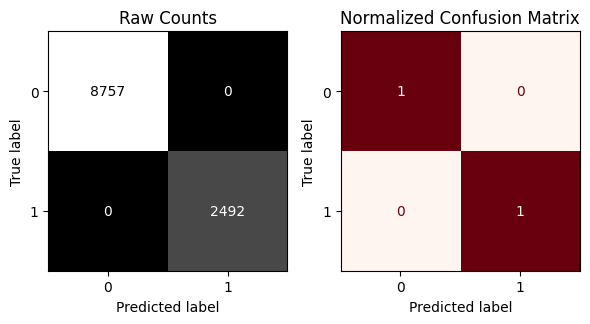

LGBMClassifier
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 7508, number of negative: 26236
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.005044 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2309
[LightGBM] [Info] Number of data points in the train set: 33744, number of used features: 28
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.222499 -> initscore=-1.251163
[LightGBM] [Info] Start training from score -1.251163
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posi

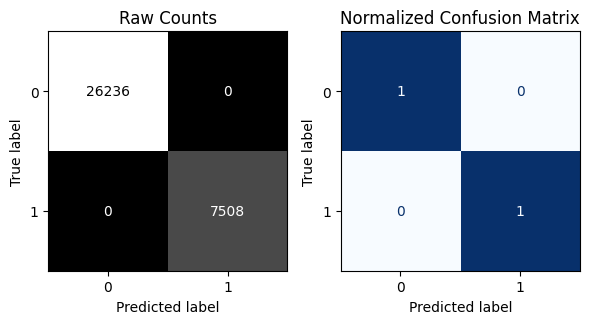


----------------------------------------------------------------------
 Classification Metrics: Test Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       1.00      1.00      1.00      8757
           1       1.00      1.00      1.00      2492

    accuracy                           1.00     11249
   macro avg       1.00      1.00      1.00     11249
weighted avg       1.00      1.00      1.00     11249



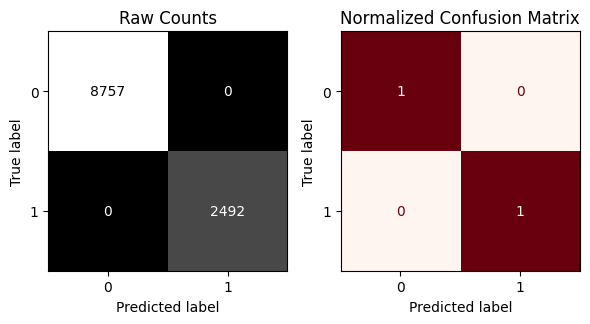

In [ ]:
for model in models:
  print('==='*30)
  print(model.__class__.__name__)
  model_pipe = make_pipeline(preprocessor, model)
  model_pipe.fit(X_train, y_train)
  evaluate_classification(model_pipe, X_train, y_train, X_test, y_test)
  print('==='*30)

## Without Clusters

In [ ]:
drop_from_ml = ['Loan_Status',	'_LoanStatus','cluster']
X = df.drop(columns = drop_from_ml)
y = df['Loan_Status']

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, random_state = 42)

In [ ]:
for col in ['scores','Education_Level','Interest_Rate']:
    print('='*50)
    print(f'Column Name: {col}')
    print(f'Unique Values: {df[col].unique()}')
    print(f'Number of Unique Values: {df[col].nunique()}')
    print(f'Value Counts: {df[col].value_counts()}')

Column Name: scores
Unique Values: ['High Score' 'Medium Score']
Number of Unique Values: 2
Value Counts: scores
High Score      43763
Medium Score     1230
Name: count, dtype: int64
Column Name: Education_Level
Unique Values: ['Master' 'High School' 'Bachelor' 'Associate' 'Doctorate']
Number of Unique Values: 5
Value Counts: Education_Level
Bachelor       13396
Associate      12026
High School    11970
Master          6980
Doctorate        621
Name: count, dtype: int64
Column Name: Interest_Rate
Unique Values: ['Medium Interest Rate' 'Low Interest Rate' 'High Interest Rate']
Number of Unique Values: 3
Value Counts: Interest_Rate
Medium Interest Rate    29094
Low Interest Rate       15815
High Interest Rate         84
Name: count, dtype: int64


In [ ]:
ord_cols = ['Education_Level','scores','Interest_Rate']

print("Ordinal Columns:", ord_cols)

Education = {'High School','Associate', 'Bachelor', 'Master', 'Doctorate'}

Scores = {'Medium Score', 'High Score'}

Interest = {'Low Interest Rate', 'Medium Interest Rate', 'High Interest Rate'}

ordinal_category_orders = [Education, Scores, Interest]

ord_encoder = OrdinalEncoder(categories=ordinal_category_orders)

scaler_ord = StandardScaler()

ord_pipe = make_pipeline(ord_encoder, scaler_ord)

ord_tuple = ('ordinal', ord_pipe, ord_cols)

ord_tuple

Ordinal Columns: ['Education_Level', 'scores', 'Interest_Rate']


('ordinal',
 Pipeline(steps=[('ordinalencoder',
                  OrdinalEncoder(categories=[{'Associate', 'Bachelor',
                                              'Doctorate', 'High School',
                                              'Master'},
                                             {'Medium Score', 'High Score'},
                                             {'High Interest Rate',
                                              'Low Interest Rate',
                                              'Medium Interest Rate'}])),
                 ('standardscaler', StandardScaler())]),
 ['Education_Level', 'scores', 'Interest_Rate'])

In [ ]:
ohe_cols = X_train.select_dtypes('object').drop(columns=ord_cols).columns
ohe_encoder = OneHotEncoder(drop='first', sparse_output=False)
cat_pipe = make_pipeline(ohe_encoder)
cat_tuple = ('cat',cat_pipe, ohe_cols)
cat_tuple

('cat',
 Pipeline(steps=[('onehotencoder',
                  OneHotEncoder(drop='first', sparse_output=False))]),
 Index(['Gender', 'Home_Ownership_Stauts', 'Loan_Purpose', 'Previous_Loan',
        'Age_Group'],
       dtype='object'))

In [ ]:
num_cols = X_train.select_dtypes('number').columns
scaler = StandardScaler()
num_pipe = make_pipeline(scaler)
num_tuple = ('num',num_pipe, num_cols)
num_tuple

('num',
 Pipeline(steps=[('standardscaler', StandardScaler())]),
 Index(['Age', 'Yearly_Income', 'Years_Of_Employment', 'Loan_Amount',
        'Loan_Interest_Rate', 'Loan_Percentage_Income', 'Credit_History',
        'Credit_Score', 'monthly_income', 'Loan_To_Income_Ratio',
        'Monthly_Loan_Payment', 'Loan_Burden_Percentage',
        'Employment_To_Age_Ratio', 'Credit_Utilization'],
       dtype='object'))

In [ ]:
preprocessor  = ColumnTransformer([num_tuple,cat_tuple],verbose_feature_names_out=True)

LogisticRegression
----------------------------------------------------------------------
 Classification Metrics: Training Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.93      0.94      0.93     26236
           1       0.78      0.75      0.76      7508

    accuracy                           0.90     33744
   macro avg       0.85      0.84      0.85     33744
weighted avg       0.90      0.90      0.90     33744



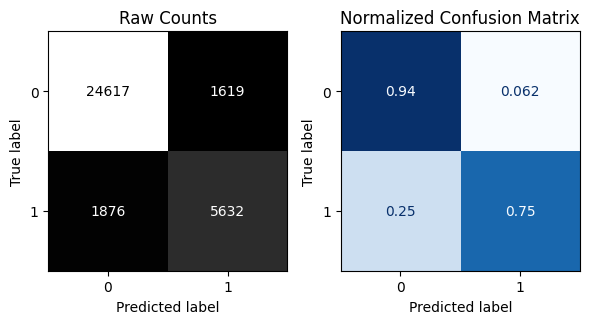


----------------------------------------------------------------------
 Classification Metrics: Test Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.93      0.94      0.94      8757
           1       0.79      0.75      0.77      2492

    accuracy                           0.90     11249
   macro avg       0.86      0.85      0.85     11249
weighted avg       0.90      0.90      0.90     11249



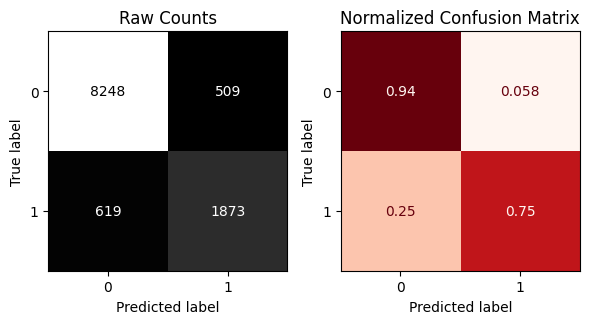

DecisionTreeClassifier
----------------------------------------------------------------------
 Classification Metrics: Training Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     26236
           1       1.00      1.00      1.00      7508

    accuracy                           1.00     33744
   macro avg       1.00      1.00      1.00     33744
weighted avg       1.00      1.00      1.00     33744



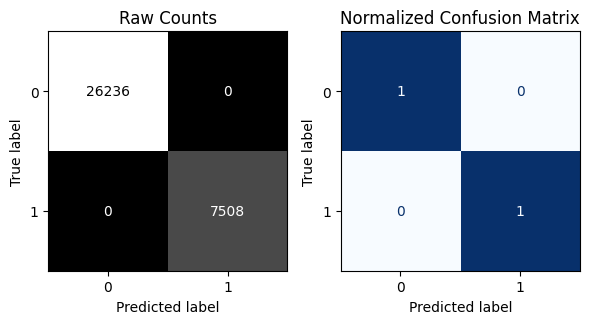


----------------------------------------------------------------------
 Classification Metrics: Test Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.94      0.94      0.94      8757
           1       0.77      0.78      0.78      2492

    accuracy                           0.90     11249
   macro avg       0.86      0.86      0.86     11249
weighted avg       0.90      0.90      0.90     11249



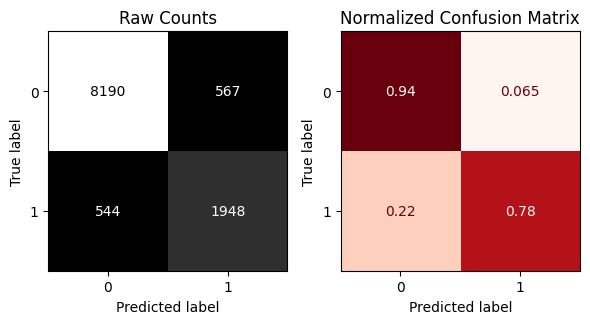

RandomForestClassifier
----------------------------------------------------------------------
 Classification Metrics: Training Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     26236
           1       1.00      1.00      1.00      7508

    accuracy                           1.00     33744
   macro avg       1.00      1.00      1.00     33744
weighted avg       1.00      1.00      1.00     33744



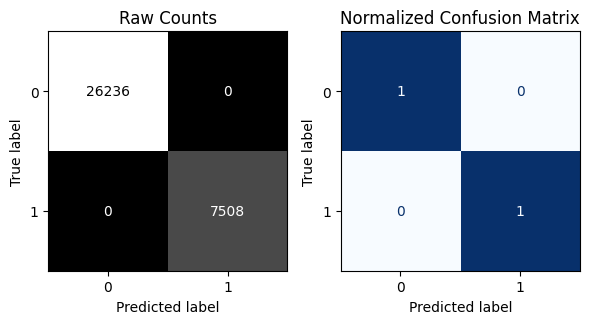


----------------------------------------------------------------------
 Classification Metrics: Test Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.94      0.97      0.96      8757
           1       0.90      0.78      0.83      2492

    accuracy                           0.93     11249
   macro avg       0.92      0.88      0.89     11249
weighted avg       0.93      0.93      0.93     11249



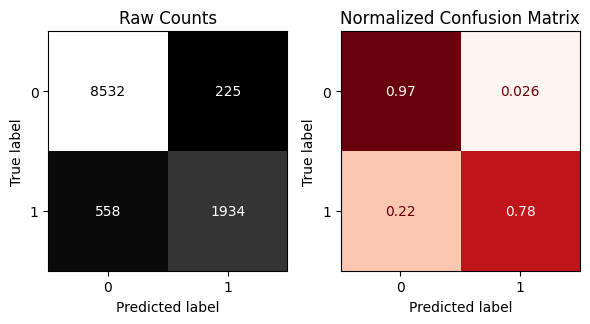

GradientBoostingClassifier
----------------------------------------------------------------------
 Classification Metrics: Training Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.94      0.97      0.95     26236
           1       0.88      0.77      0.82      7508

    accuracy                           0.93     33744
   macro avg       0.91      0.87      0.89     33744
weighted avg       0.92      0.93      0.92     33744



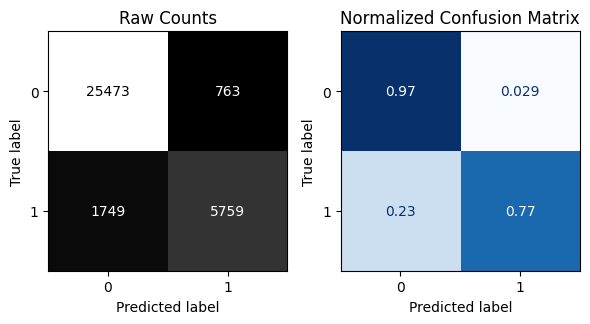


----------------------------------------------------------------------
 Classification Metrics: Test Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.93      0.97      0.95      8757
           1       0.88      0.76      0.81      2492

    accuracy                           0.92     11249
   macro avg       0.91      0.86      0.88     11249
weighted avg       0.92      0.92      0.92     11249



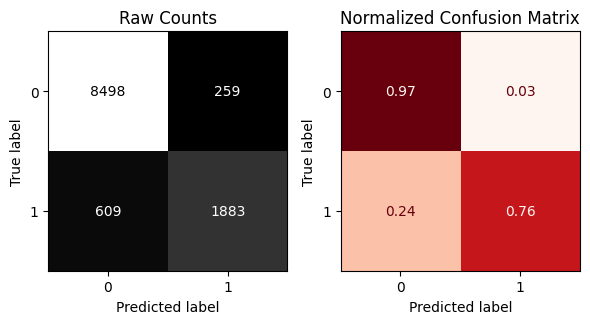

AdaBoostClassifier
----------------------------------------------------------------------
 Classification Metrics: Training Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.93      0.95      0.94     26236
           1       0.82      0.74      0.77      7508

    accuracy                           0.90     33744
   macro avg       0.87      0.84      0.86     33744
weighted avg       0.90      0.90      0.90     33744



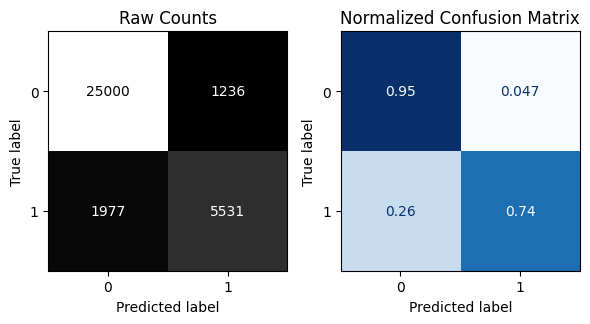


----------------------------------------------------------------------
 Classification Metrics: Test Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.92      0.95      0.94      8757
           1       0.81      0.72      0.76      2492

    accuracy                           0.90     11249
   macro avg       0.87      0.84      0.85     11249
weighted avg       0.90      0.90      0.90     11249



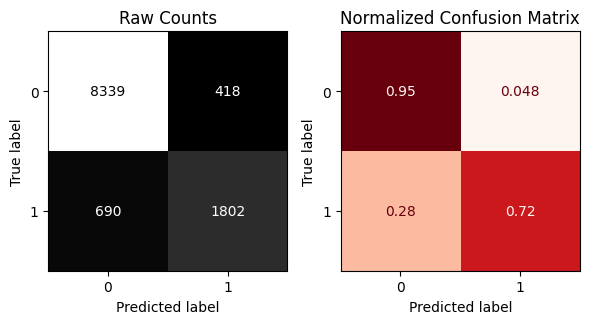

BaggingClassifier
----------------------------------------------------------------------
 Classification Metrics: Training Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.99      1.00      1.00     26236
           1       1.00      0.98      0.99      7508

    accuracy                           0.99     33744
   macro avg       1.00      0.99      0.99     33744
weighted avg       0.99      0.99      0.99     33744



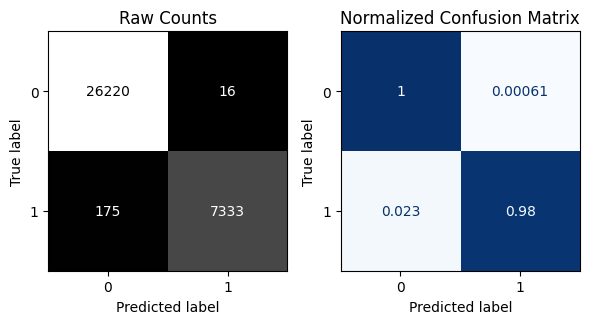


----------------------------------------------------------------------
 Classification Metrics: Test Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.93      0.97      0.95      8757
           1       0.88      0.76      0.82      2492

    accuracy                           0.92     11249
   macro avg       0.91      0.87      0.88     11249
weighted avg       0.92      0.92      0.92     11249



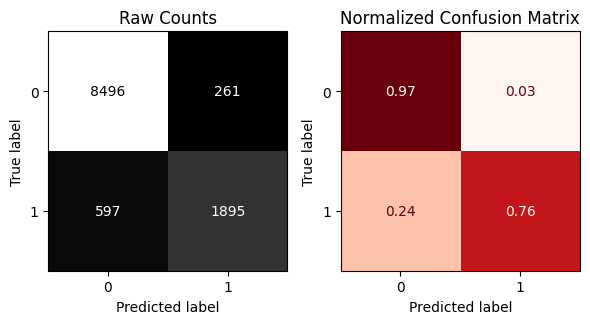

ExtraTreesClassifier
----------------------------------------------------------------------
 Classification Metrics: Training Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     26236
           1       1.00      1.00      1.00      7508

    accuracy                           1.00     33744
   macro avg       1.00      1.00      1.00     33744
weighted avg       1.00      1.00      1.00     33744



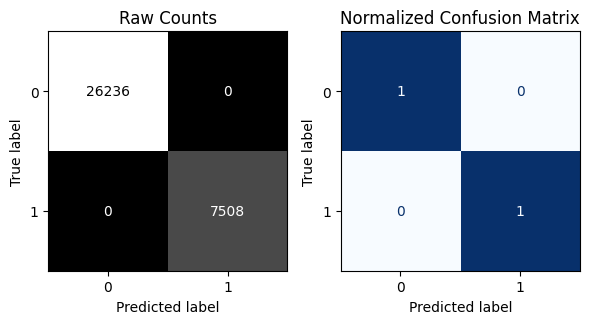


----------------------------------------------------------------------
 Classification Metrics: Test Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.94      0.97      0.95      8757
           1       0.89      0.76      0.82      2492

    accuracy                           0.93     11249
   macro avg       0.91      0.87      0.89     11249
weighted avg       0.92      0.93      0.92     11249



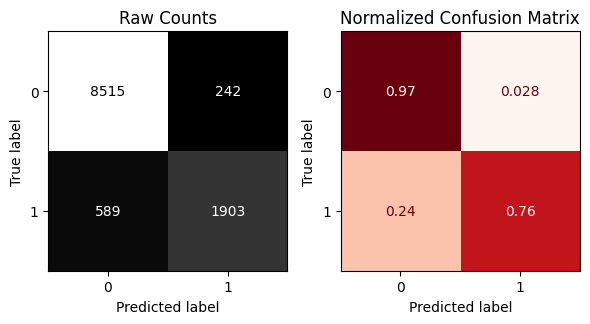

KNeighborsClassifier
----------------------------------------------------------------------
 Classification Metrics: Training Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.94      0.97      0.95     26236
           1       0.88      0.79      0.83      7508

    accuracy                           0.93     33744
   macro avg       0.91      0.88      0.89     33744
weighted avg       0.93      0.93      0.93     33744



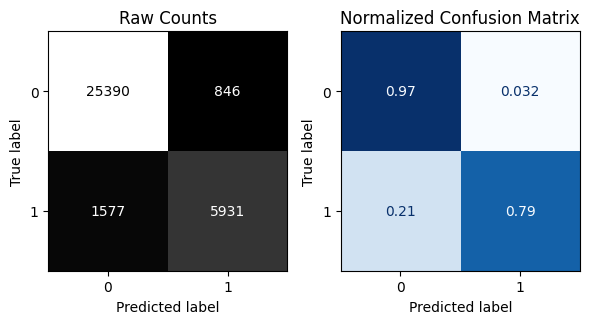


----------------------------------------------------------------------
 Classification Metrics: Test Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.92      0.95      0.93      8757
           1       0.80      0.71      0.75      2492

    accuracy                           0.90     11249
   macro avg       0.86      0.83      0.84     11249
weighted avg       0.89      0.90      0.89     11249



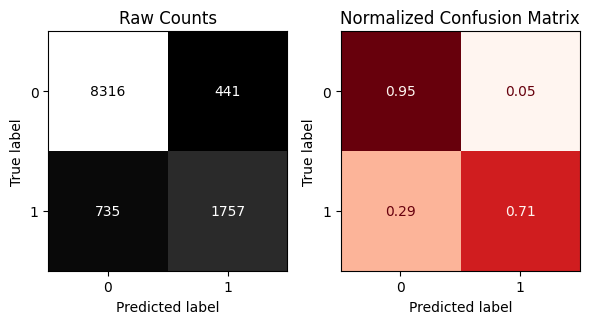

XGBClassifier
----------------------------------------------------------------------
 Classification Metrics: Training Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.97      0.99      0.98     26236
           1       0.97      0.91      0.94      7508

    accuracy                           0.97     33744
   macro avg       0.97      0.95      0.96     33744
weighted avg       0.97      0.97      0.97     33744



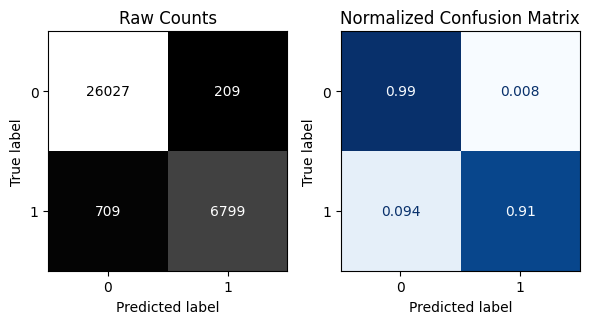


----------------------------------------------------------------------
 Classification Metrics: Test Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.95      0.97      0.96      8757
           1       0.89      0.81      0.85      2492

    accuracy                           0.94     11249
   macro avg       0.92      0.89      0.90     11249
weighted avg       0.93      0.94      0.93     11249



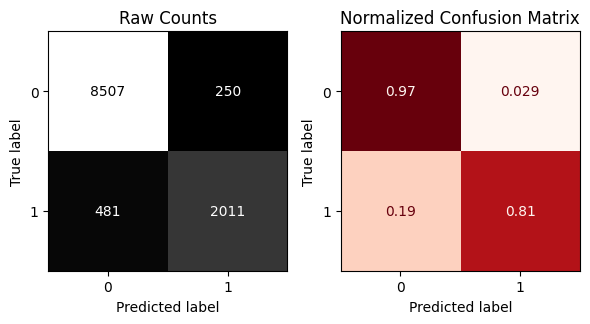

LGBMClassifier
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 7508, number of negative: 26236
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002056 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2305
[LightGBM] [Info] Number of data points in the train set: 33744, number of used features: 27
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.222499 -> initscore=-1.251163
[LightGBM] [Info] Start training from score -1.251163
----------------------------------------------------------------------
 Classification Metrics: Training Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.95      0.98      0.97     26236
           1       0.94      0.83      0.88      7508

   

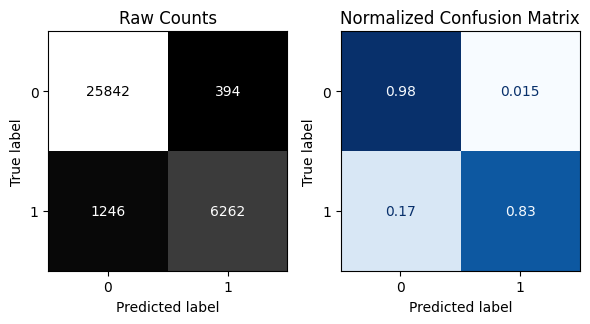


----------------------------------------------------------------------
 Classification Metrics: Test Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.94      0.97      0.96      8757
           1       0.89      0.78      0.83      2492

    accuracy                           0.93     11249
   macro avg       0.92      0.88      0.90     11249
weighted avg       0.93      0.93      0.93     11249



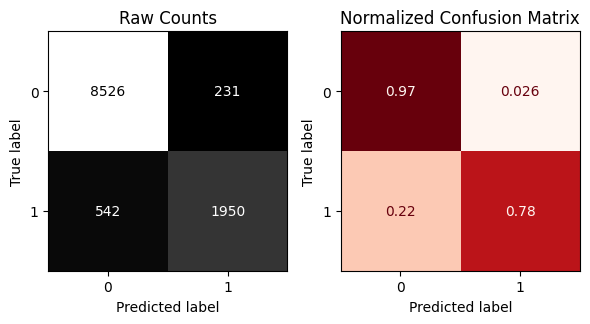

In [ ]:
for model in models:
  print('==='*30)
  print(model.__class__.__name__)
  model_pipe = make_pipeline(preprocessor, model)
  model_pipe.fit(X_train, y_train)
  evaluate_classification(model_pipe, X_train, y_train, X_test, y_test)
  print('==='*30)

# Features Selection

In [ ]:
!pip install collinearity

In [ ]:
from collinearity import SelectNonCollinear
from sklearn.feature_selection import f_classif

In [ ]:
selector = SelectNonCollinear(correlation_threshold = 0.78, scoring = f_classif)

In [ ]:
X_train_tf = preprocessor.fit_transform(X_train)
X_test_tf = preprocessor.transform(X_test)

In [ ]:
selector.fit(X_train_tf.values, y_train.values)

In [ ]:
non_collinear = selector.get_support()
non_collinear[:5]

[False, True, False, False, True]

In [ ]:
non_collinear.count(True)

20

In [ ]:
non_collinear.count(False)

7

In [ ]:
non_collinear_series = pd.Series(selector.get_support(), index=X_train_tf.columns)
non_collinear_series

,0
num__Age,False
num__Yearly_Income,True
num__Years_Of_Employment,False
num__Loan_Amount,False
num__Loan_Interest_Rate,True
num__Loan_Percentage_Income,False
num__Credit_History,False
num__Credit_Score,True
num__monthly_income,False
num__Loan_To_Income_Ratio,False


In [ ]:
training_data_to_keep = X_train_tf.values[:, non_collinear]

columns = np.array(X_train_tf.columns)[non_collinear]

X_train_no_corr = pd.DataFrame(training_data_to_keep, columns = columns)


In [ ]:
X_train_no_corr

,num__Yearly_Income,num__Loan_Interest_Rate,num__Credit_Score,num__Monthly_Loan_Payment,num__Loan_Burden_Percentage,num__Employment_To_Age_Ratio,num__Credit_Utilization,cat__Gender_Male,cat__Home_Ownership_Stauts_Other,cat__Home_Ownership_Stauts_Own,cat__Home_Ownership_Stauts_Rent,cat__Loan_Purpose_Education,cat__Loan_Purpose_Home Improvement,cat__Loan_Purpose_Medical,cat__Loan_Purpose_Personal,cat__Loan_Purpose_Venture,cat__Previous_Loan_Yes,cat__Age_Group_Middle-Aged,cat__Age_Group_Senior,cat__Age_Group_Young
0,1.016511,-1.877394,-1.660071,-0.887485,-1.324685,1.129843,-0.773583,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.263640,-0.126726,1.378048,1.112843,0.367606,1.475408,-0.185808,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
2,-0.110693,-1.678761,0.603625,-0.774622,-0.478540,-1.150886,-0.257314,1.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
3,0.286822,1.004475,-1.282788,1.702093,1.213751,-0.528869,3.198781,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0
4,0.579301,1.004475,0.305771,1.702093,0.367606,0.024035,-0.138138,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
33739,0.134572,-0.136826,0.345485,-0.395734,-0.478540,-1.150886,0.576916,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
33740,0.675124,1.341142,-1.243074,0.818264,-0.478540,1.060730,0.033952,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
33741,0.141305,1.203108,0.980908,3.032926,2.059896,-1.150886,2.880820,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0
33742,1.922764,0.122407,0.385199,1.413259,-0.478540,-0.597982,1.291970,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0


In [ ]:
test_data_to_keep = X_test_tf.values[:, non_collinear]

X_test_no_corr = pd.DataFrame(test_data_to_keep, columns = columns)

In [ ]:
cor_X = X_train_no_corr.corr(numeric_only=True)
cor_X.round(2)

,num__Yearly_Income,num__Loan_Interest_Rate,num__Credit_Score,num__Monthly_Loan_Payment,num__Loan_Burden_Percentage,num__Employment_To_Age_Ratio,num__Credit_Utilization,cat__Gender_Male,cat__Home_Ownership_Stauts_Other,cat__Home_Ownership_Stauts_Own,cat__Home_Ownership_Stauts_Rent,cat__Loan_Purpose_Education,cat__Loan_Purpose_Home Improvement,cat__Loan_Purpose_Medical,cat__Loan_Purpose_Personal,cat__Loan_Purpose_Venture,cat__Previous_Loan_Yes,cat__Age_Group_Middle-Aged,cat__Age_Group_Senior,cat__Age_Group_Young
num__Yearly_Income,1.00,-0.01,0.03,0.27,-0.24,0.14,0.14,0.01,0.01,-0.05,-0.24,-0.02,0.05,-0.05,0.02,0.01,0.09,0.08,0.04,-0.12
num__Loan_Interest_Rate,-0.01,1.00,0.01,0.46,0.46,0.02,0.09,0.01,0.02,-0.02,0.14,-0.02,0.02,0.01,-0.00,-0.01,-0.18,0.01,0.01,-0.01
num__Credit_Score,0.03,0.01,1.00,0.01,-0.01,0.18,-0.07,0.00,-0.00,0.00,-0.01,-0.01,0.01,-0.00,0.01,0.01,-0.18,0.10,0.08,-0.11
num__Monthly_Loan_Payment,0.27,0.46,0.01,1.00,0.66,0.05,0.62,0.01,0.02,-0.03,-0.07,-0.01,0.05,-0.02,0.00,-0.00,-0.11,0.02,0.01,-0.06
num__Loan_Burden_Percentage,-0.24,0.46,-0.01,0.66,1.00,-0.03,0.42,0.01,0.02,0.03,0.15,-0.01,-0.00,0.03,-0.01,-0.00,-0.23,-0.02,-0.01,0.03
num__Employment_To_Age_Ratio,0.14,0.02,0.18,0.05,-0.03,1.00,-0.37,0.00,-0.01,0.00,-0.04,-0.08,0.07,0.02,0.02,-0.01,-0.03,0.60,0.27,-0.63
num__Credit_Utilization,0.14,0.09,-0.07,0.62,0.42,-0.37,1.00,0.01,0.02,-0.02,-0.07,0.04,-0.01,-0.03,-0.01,0.01,-0.03,-0.25,-0.08,0.30
cat__Gender_Male,0.01,0.01,0.00,0.01,0.01,0.00,0.01,1.00,0.00,-0.00,-0.01,0.00,0.00,-0.00,-0.00,-0.00,-0.00,0.01,0.01,0.01
cat__Home_Ownership_Stauts_Other,0.01,0.02,-0.00,0.02,0.02,-0.01,0.02,0.00,1.00,-0.01,-0.06,-0.01,-0.00,-0.00,-0.00,0.01,-0.01,0.00,-0.00,0.02
cat__Home_Ownership_Stauts_Own,-0.05,-0.02,0.00,-0.03,0.03,0.00,-0.02,-0.00,-0.01,1.00,-0.28,0.01,0.01,-0.02,0.00,0.09,0.05,0.01,-0.00,0.02


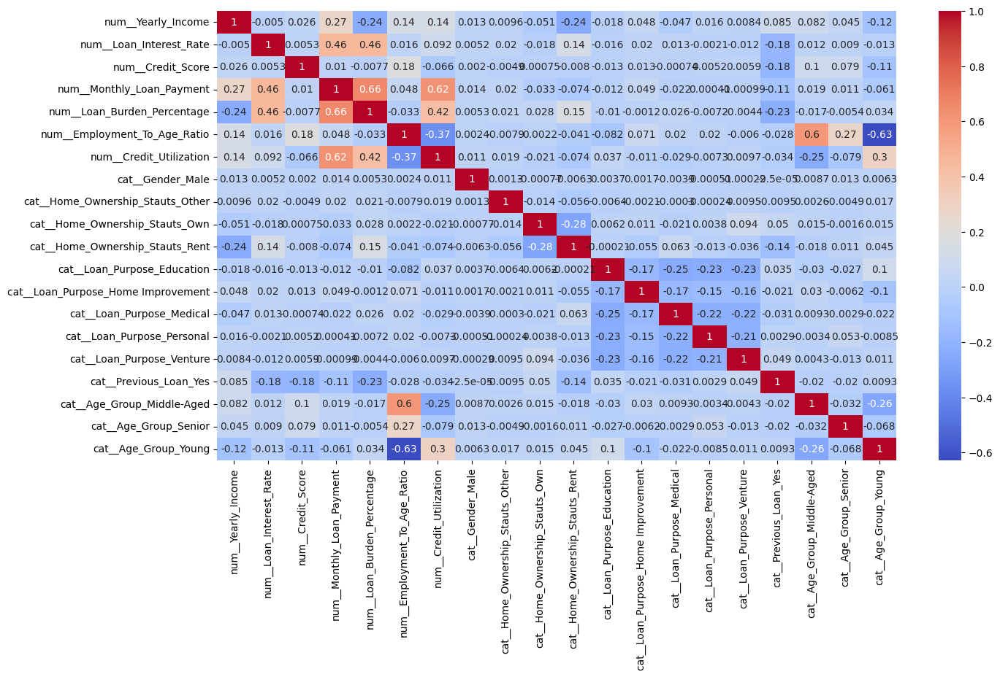

In [ ]:
plt.figure(figsize=(15, 8))
sns.heatmap(cor_X, cmap='coolwarm', annot=True);

LogisticRegression
----------------------------------------------------------------------
 Classification Metrics: Training Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.92      0.94      0.93     26236
           1       0.76      0.72      0.74      7508

    accuracy                           0.89     33744
   macro avg       0.84      0.83      0.83     33744
weighted avg       0.89      0.89      0.89     33744



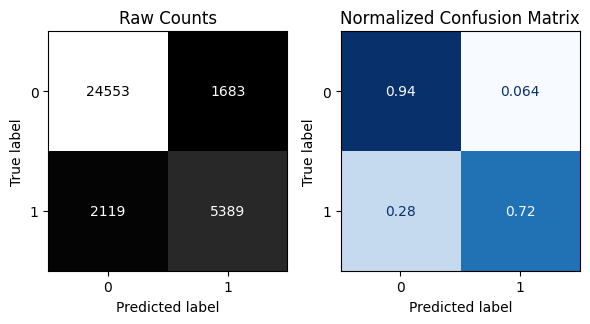


----------------------------------------------------------------------
 Classification Metrics: Test Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.92      0.94      0.93      8757
           1       0.77      0.72      0.74      2492

    accuracy                           0.89     11249
   macro avg       0.84      0.83      0.84     11249
weighted avg       0.89      0.89      0.89     11249



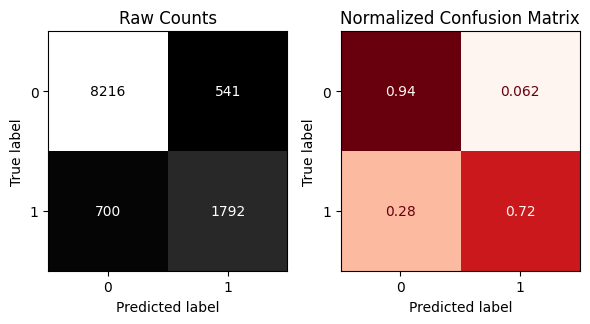

DecisionTreeClassifier
----------------------------------------------------------------------
 Classification Metrics: Training Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     26236
           1       1.00      1.00      1.00      7508

    accuracy                           1.00     33744
   macro avg       1.00      1.00      1.00     33744
weighted avg       1.00      1.00      1.00     33744



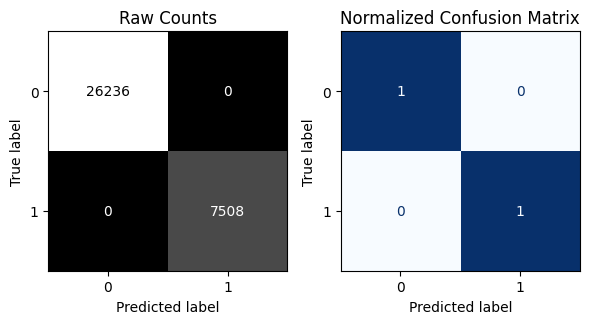


----------------------------------------------------------------------
 Classification Metrics: Test Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.93      0.93      0.93      8757
           1       0.76      0.77      0.76      2492

    accuracy                           0.89     11249
   macro avg       0.84      0.85      0.85     11249
weighted avg       0.89      0.89      0.89     11249



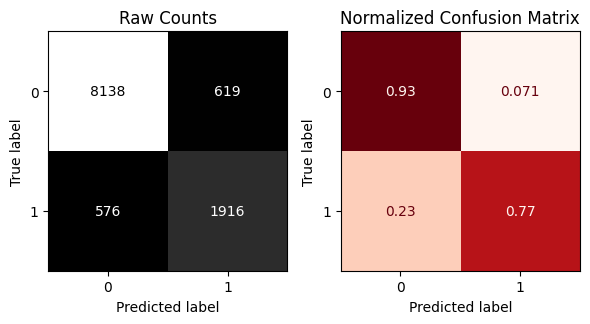

RandomForestClassifier
----------------------------------------------------------------------
 Classification Metrics: Training Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     26236
           1       1.00      1.00      1.00      7508

    accuracy                           1.00     33744
   macro avg       1.00      1.00      1.00     33744
weighted avg       1.00      1.00      1.00     33744



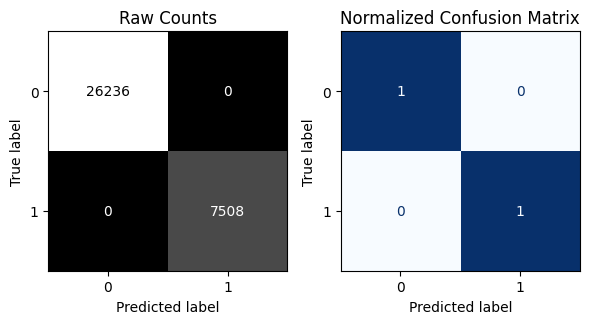


----------------------------------------------------------------------
 Classification Metrics: Test Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.94      0.97      0.95      8757
           1       0.87      0.78      0.82      2492

    accuracy                           0.92     11249
   macro avg       0.90      0.87      0.89     11249
weighted avg       0.92      0.92      0.92     11249



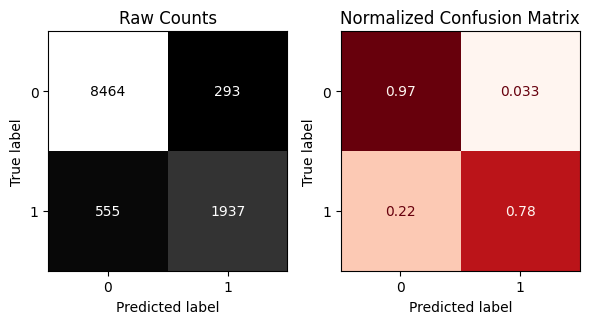

GradientBoostingClassifier
----------------------------------------------------------------------
 Classification Metrics: Training Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.94      0.96      0.95     26236
           1       0.85      0.77      0.81      7508

    accuracy                           0.92     33744
   macro avg       0.89      0.86      0.88     33744
weighted avg       0.92      0.92      0.92     33744



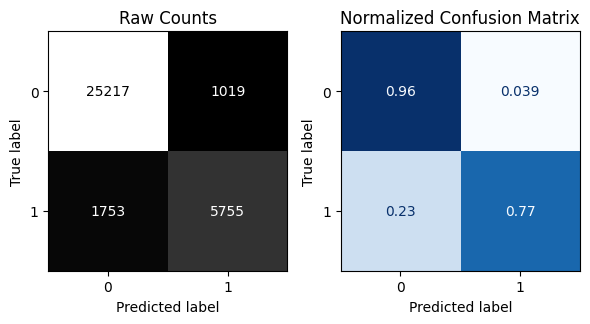


----------------------------------------------------------------------
 Classification Metrics: Test Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.93      0.96      0.95      8757
           1       0.85      0.75      0.80      2492

    accuracy                           0.92     11249
   macro avg       0.89      0.86      0.87     11249
weighted avg       0.91      0.92      0.91     11249



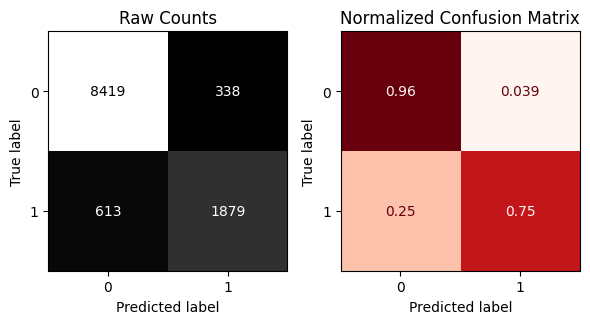

AdaBoostClassifier
----------------------------------------------------------------------
 Classification Metrics: Training Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.92      0.96      0.94     26236
           1       0.82      0.71      0.76      7508

    accuracy                           0.90     33744
   macro avg       0.87      0.83      0.85     33744
weighted avg       0.90      0.90      0.90     33744



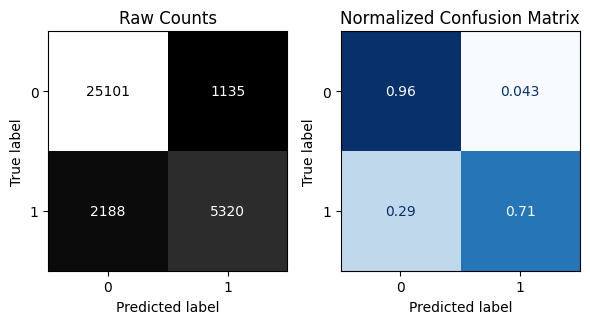


----------------------------------------------------------------------
 Classification Metrics: Test Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.92      0.96      0.94      8757
           1       0.82      0.70      0.76      2492

    accuracy                           0.90     11249
   macro avg       0.87      0.83      0.85     11249
weighted avg       0.90      0.90      0.90     11249



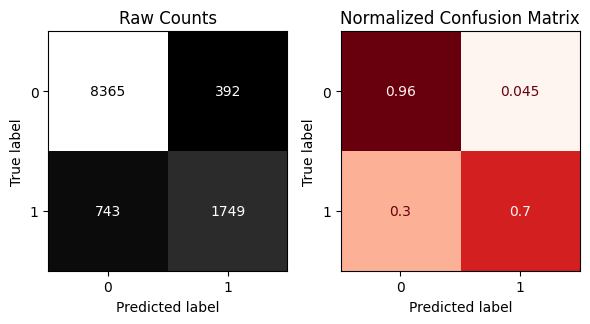

BaggingClassifier
----------------------------------------------------------------------
 Classification Metrics: Training Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.99      1.00      1.00     26236
           1       1.00      0.98      0.99      7508

    accuracy                           0.99     33744
   macro avg       1.00      0.99      0.99     33744
weighted avg       0.99      0.99      0.99     33744



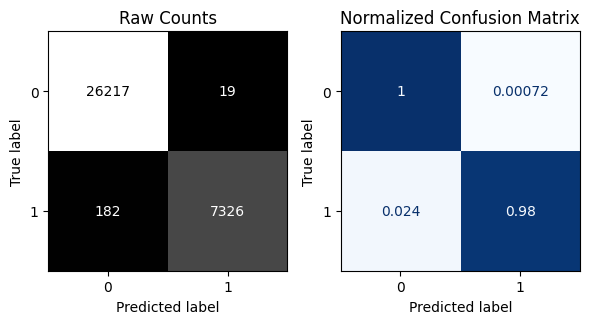


----------------------------------------------------------------------
 Classification Metrics: Test Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.93      0.96      0.95      8757
           1       0.86      0.76      0.81      2492

    accuracy                           0.92     11249
   macro avg       0.90      0.86      0.88     11249
weighted avg       0.92      0.92      0.92     11249



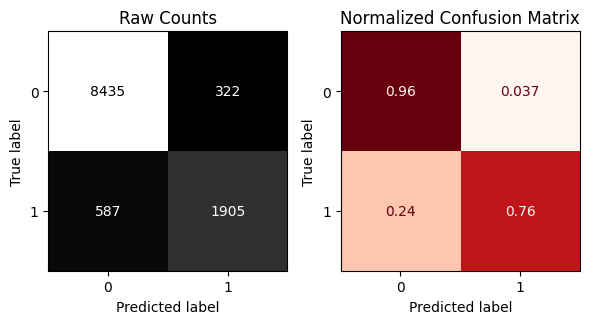

ExtraTreesClassifier
----------------------------------------------------------------------
 Classification Metrics: Training Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     26236
           1       1.00      1.00      1.00      7508

    accuracy                           1.00     33744
   macro avg       1.00      1.00      1.00     33744
weighted avg       1.00      1.00      1.00     33744



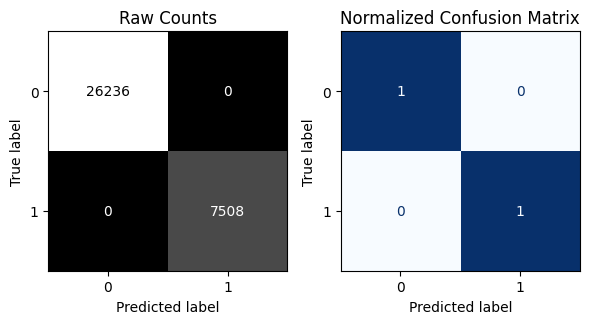


----------------------------------------------------------------------
 Classification Metrics: Test Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.93      0.96      0.94      8757
           1       0.84      0.75      0.79      2492

    accuracy                           0.91     11249
   macro avg       0.89      0.85      0.87     11249
weighted avg       0.91      0.91      0.91     11249



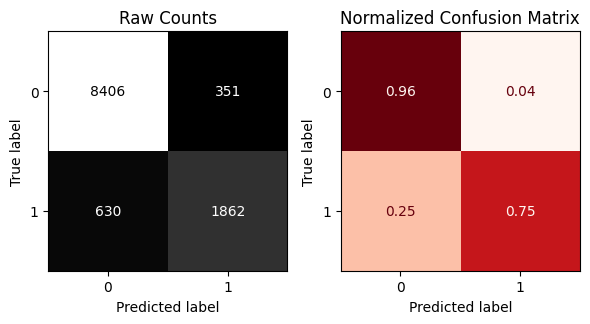

KNeighborsClassifier
----------------------------------------------------------------------
 Classification Metrics: Training Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.94      0.97      0.95     26236
           1       0.87      0.79      0.83      7508

    accuracy                           0.93     33744
   macro avg       0.91      0.88      0.89     33744
weighted avg       0.93      0.93      0.93     33744



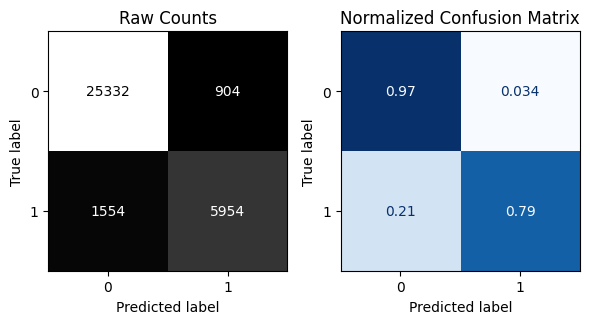


----------------------------------------------------------------------
 Classification Metrics: Test Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.92      0.94      0.93      8757
           1       0.78      0.71      0.74      2492

    accuracy                           0.89     11249
   macro avg       0.85      0.83      0.84     11249
weighted avg       0.89      0.89      0.89     11249



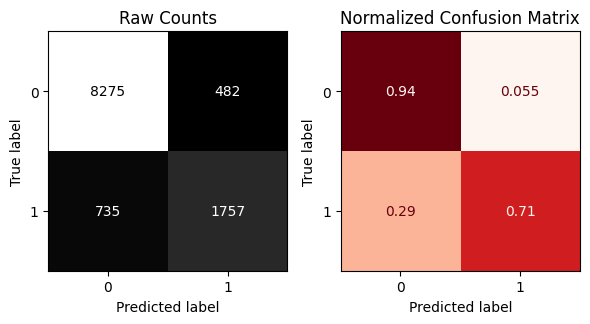

XGBClassifier
----------------------------------------------------------------------
 Classification Metrics: Training Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.97      0.99      0.98     26236
           1       0.95      0.89      0.92      7508

    accuracy                           0.97     33744
   macro avg       0.96      0.94      0.95     33744
weighted avg       0.97      0.97      0.97     33744



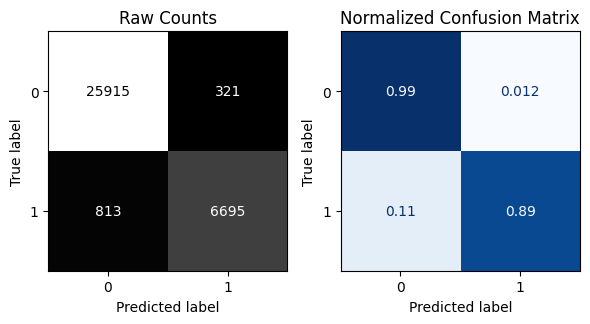


----------------------------------------------------------------------
 Classification Metrics: Test Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.94      0.97      0.96      8757
           1       0.87      0.80      0.83      2492

    accuracy                           0.93     11249
   macro avg       0.91      0.88      0.89     11249
weighted avg       0.93      0.93      0.93     11249



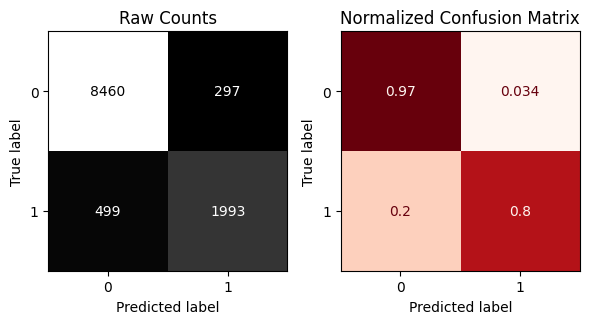

LGBMClassifier
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 7508, number of negative: 26236
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001399 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1347
[LightGBM] [Info] Number of data points in the train set: 33744, number of used features: 20
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.222499 -> initscore=-1.251163
[LightGBM] [Info] Start training from score -1.251163
----------------------------------------------------------------------
 Classification Metrics: Training Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.95      0.98      0.96     26236
           1       0.91      0.83      0.87      7508

   

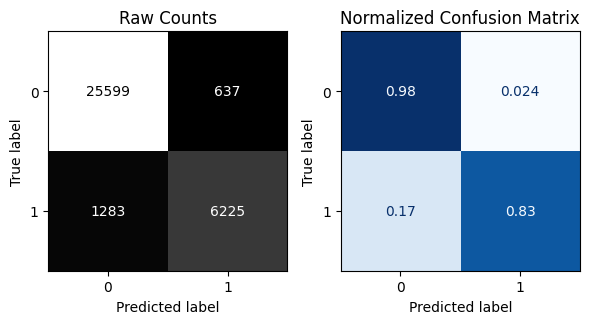


----------------------------------------------------------------------
 Classification Metrics: Test Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.94      0.96      0.95      8757
           1       0.86      0.79      0.82      2492

    accuracy                           0.93     11249
   macro avg       0.90      0.88      0.89     11249
weighted avg       0.92      0.93      0.92     11249



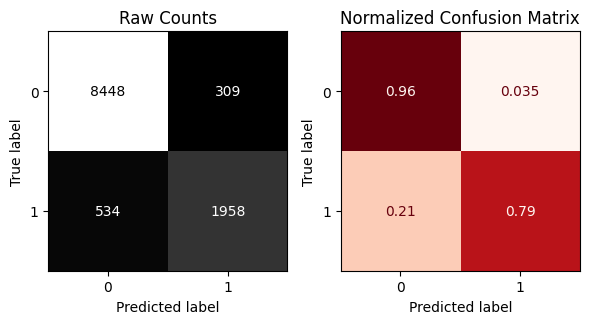

In [ ]:
for model in models:
  print('==='*30)
  print(model.__class__.__name__)
  model.fit(X_train_no_corr, y_train)
  evaluate_classification(model,X_train_no_corr, y_train, X_test_no_corr, y_test)
  print('==='*30)

## Thresuhold feature selection model

In [ ]:
xgb_model = XGBClassifier(learning_rate=0.5, max_depth=10, max_features=0.35000000000000003, min_samples_leaf=3, min_samples_split=8, n_estimators=100, subsample=1.0, random_state=42,  probability=True)

In [ ]:
thresholded_model = ThresholdedClassifier(model=xgb_model, threshold=0.25)

In [ ]:
thresholded_model.fit(X_train_no_corr, y_train)

/usr/local/lib/python3.11/dist-packages/xgboost/core.py:158: UserWarning: [07:48:33] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "max_features", "min_samples_leaf", "min_samples_split", "probability" } are not used.

  warnings.warn(smsg, UserWarning)


ThresholdedClassifier(model=XGBClassifier(base_score=None, booster=None,
                                          callbacks=None,
                                          colsample_bylevel=None,
                                          colsample_bynode=None,
                                          colsample_bytree=None, device=None,
                                          early_stopping_rounds=None,
                                          enable_categorical=False,
                                          eval_metric=None, feature_types=None,
                                          gamma=None, grow_policy=None,
                                          importance_type=None,
                                          interaction_constraints=None,
                                          learning_rate=0.5, max_bin=None,
                                          max_cat_threshold=None,
                                          max_cat_to_onehot=None,
                                          max_delta_step=None, max_depth=10,
                                          max_features=0.35000000000000003,
                                          max_leaves=None,
                                          min_child_weight=None,
                                          min_samples_leaf=3,
                                          min_samples_split=8, missing=nan,
                                          monotone_constraints=None,
                                          multi_strategy=None, n_estimators=100, ...),
                      threshold=0.25)

----------------------------------------------------------------------
 Classification Metrics: Training Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     26236
           1       1.00      1.00      1.00      7508

    accuracy                           1.00     33744
   macro avg       1.00      1.00      1.00     33744
weighted avg       1.00      1.00      1.00     33744



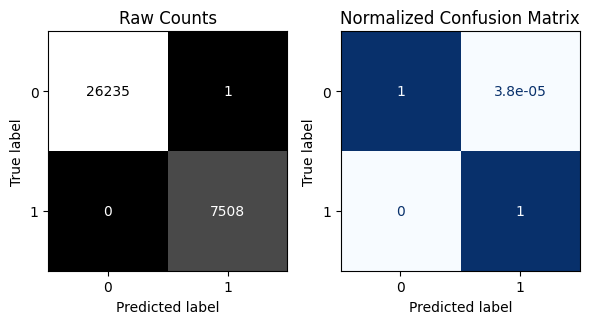


----------------------------------------------------------------------
 Classification Metrics: Test Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.96      0.93      0.95      8757
           1       0.79      0.86      0.82      2492

    accuracy                           0.92     11249
   macro avg       0.87      0.90      0.88     11249
weighted avg       0.92      0.92      0.92     11249



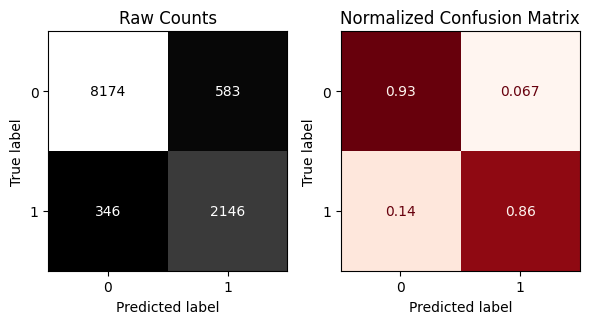

In [ ]:
evaluate_classification(thresholded_model, X_train_no_corr, y_train, X_test_no_corr, y_test)

# Deep Learning

## NN Imports

In [ ]:
import tensorflow as tf
from tensorflow.keras import Sequential # type: ignore
from tensorflow.keras import metrics # type: ignore
from tensorflow.keras.layers import Dense, Dropout # type: ignore
from tensorflow.keras.callbacks import EarlyStopping  # type: ignore
from keras import optimizers

In [ ]:
from sklearn import set_config
set_config(transform_output='pandas')
np.random.seed(42)
tf.random.set_seed(42)
tf.keras.utils.set_random_seed(42)

In [ ]:
def plot_history(history, figsize=(6,12), marker='o'):

    # Get list of metrics from history
    metrics = [c for c in history.history if not c.startswith('val_')]

    ## Separate row for each metric
    fig, axes = plt.subplots(nrows=len(metrics),figsize=figsize)


    # For each metric
    for i, metric_name in enumerate(metrics):
        # Get the axis for the current metric
        if len(metrics)==1:
            ax = axes
        else:
            ax = axes[i]

        # Get metric from history.history
        metric_values = history.history[metric_name]
        # Get epochs from history
        epochs = history.epoch

        # Plot the training metric
        ax.plot(epochs, metric_values, label=metric_name, marker=marker)

        ## Check if val_{metric} exists. if so, plot:
        val_metric_name = f"val_{metric_name}"
        if val_metric_name in history.history:
            # Get validation values and plot
            metric_values = history.history[val_metric_name]
            ax.plot(epochs,metric_values,label=val_metric_name, marker=marker)

        # Final subplot adjustments
        ax.legend()
        ax.set_title(metric_name)
    fig.tight_layout()
    return fig, axes

## Modeling

### Inspectation

In [ ]:
X_train = preprocessor.fit_transform(X_train)
X_test = preprocessor.transform(X_test)

In [ ]:
X_train.shape

(33744, 18)

In [ ]:
X_train.head()

,num__Age,num__Yearly_Income,num__Years_Of_Employment,num__Loan_Amount,num__Loan_Interest_Rate,num__Loan_Percentage_Income,num__Credit_History,num__Credit_Score,cat__Gender_Male,cat__Home_Ownership_Stauts_Other,cat__Home_Ownership_Stauts_Own,cat__Home_Ownership_Stauts_Rent,cat__Loan_Purpose_Education,cat__Loan_Purpose_Home Improvement,cat__Loan_Purpose_Medical,cat__Loan_Purpose_Personal,cat__Loan_Purpose_Venture,cat__Previous_Loan_Yes
27005,0.384140,1.016511,0.782979,-0.565201,-1.877394,-1.144090,0.811581,-1.660071,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
25130,1.062952,0.263640,1.290830,1.503756,-0.126726,0.694655,1.069937,1.378048,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0
38008,-0.803780,-0.110693,-0.909861,-0.406051,-1.678761,-0.454560,-0.480199,0.603625,1.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0
1043,-0.803780,0.286822,-0.571293,1.344606,1.004475,0.464812,-0.996910,-1.282788,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0
26140,0.384140,0.579301,-0.063441,1.344606,1.004475,0.120047,0.811581,0.305771,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0


In [ ]:
X_train.shape[1]

18

In [ ]:
input_shape = X_train.shape[1]

In [ ]:
y_train.value_counts(normalize=True)*100

,proportion
Loan_Status,
0,77.750119
1,22.249881


## Model 1

In [ ]:
def build_model():
    # Instantiate Model
    model = Sequential()

    # First hidden layer
    model.add(Dense(20,input_dim =input_shape,activation = 'relu'))

    # Second hidden layer
    model.add(Dense(10,activation = 'relu'))

    model.add(Dense(1, activation = 'sigmoid'))

    # Compile Model
    model.compile(loss = 'bce', optimizer = 'adam', metrics=['accuracy', metrics.Precision(), metrics.Recall(),tf.keras.metrics.F1Score(name='f1_score', dtype=None, threshold=0.5)])
    return model

In [ ]:
clf_model = build_model()

/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


In [ ]:
clf_model.summary()

Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense_3 (Dense)                 │ (None, 20)             │           380 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_4 (Dense)                 │ (None, 10)             │           210 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_5 (Dense)                 │ (None, 1)              │            11 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 601 (2.35 KB)

 Trainable params: 601 (2.35 KB)

 Non-trainable params: 0 (0.00 B)

In [ ]:
history = clf_model.fit(X_train, y_train,validation_split=0.2,epochs=50)

Epoch 1/50
844/844 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - accuracy: 0.7699 - f1_score: 0.4082 - loss: 0.4483 - precision_1: 0.5198 - recall_1: 0.3484 - val_accuracy: 0.8987 - val_f1_score: 0.7691 - val_loss: 0.2247 - val_precision_1: 0.7866 - val_recall_1: 0.7523
Epoch 2/50
844/844 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - accuracy: 0.9027 - f1_score: 0.7760 - loss: 0.2140 - precision_1: 0.7944 - recall_1: 0.7585 - val_accuracy: 0.9055 - val_f1_score: 0.7839 - val_loss: 0.2132 - val_precision_1: 0.8046 - val_recall_1: 0.7642
Epoch 3/50
844/844 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - accuracy: 0.9070 - f1_score: 0.7857 - loss: 0.2038 - precision_1: 0.8049 - recall_1: 0.7675 - val_accuracy: 0.9075 - val_f1_score: 0.7889 - val_loss: 0.2082 - val_precision_1: 0.8086 - val_recall_1: 0.7701
Epoch 4/50
844/844 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - accuracy: 0.9088 - f1_score: 0.7899 - loss: 0.1994 - precision_1: 0.8088 - recall_1: 0.7719 - val_accuracy: 0.9092 - val_f1_score: 0.7919 - val_loss: 0.2056 - val_pre

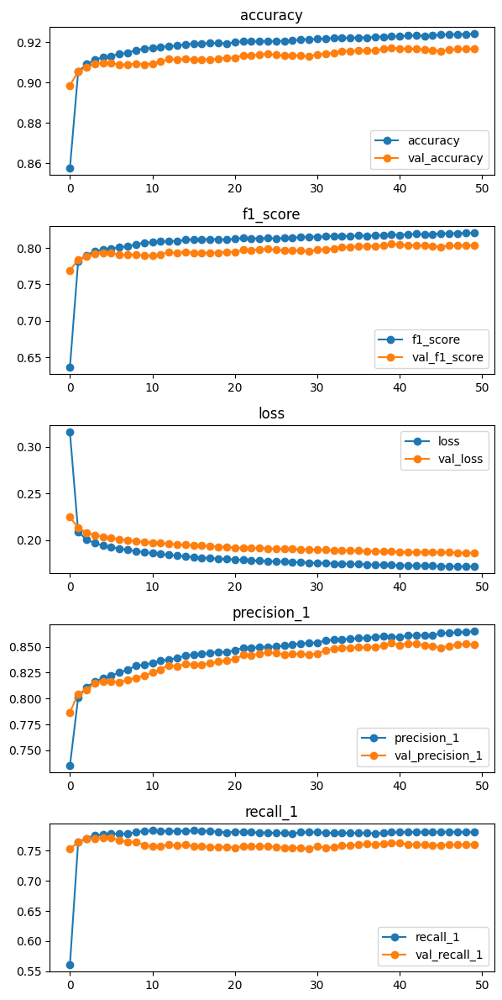

In [ ]:
plot_history(history);

In [ ]:
y_pred_test = clf_model.predict(X_test)
y_pred_test[:5]

352/352 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step


array([[8.39451134e-01],
       [3.60252189e-10],
       [7.70078152e-02],
       [1.61688745e-01],
       [1.11127375e-11]], dtype=float32)

In [ ]:
y_pred_test = np.round(y_pred_test)
y_pred_test[:5]

array([[1.],
       [0.],
       [0.],
       [0.],
       [0.]], dtype=float32)

              precision    recall  f1-score   support

           0       0.93      0.97      0.95      8757
           1       0.86      0.75      0.80      2492

    accuracy                           0.92     11249
   macro avg       0.90      0.86      0.88     11249
weighted avg       0.92      0.92      0.92     11249



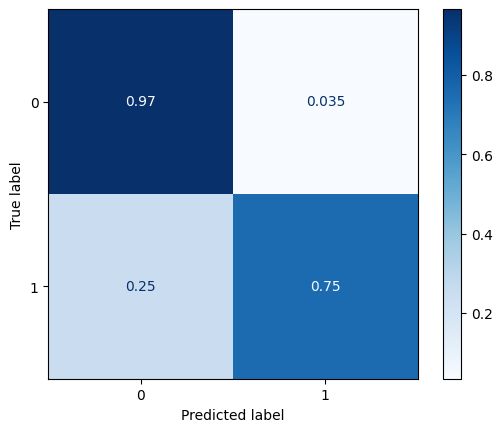

In [ ]:
print(classification_report(y_test, y_pred_test))
ConfusionMatrixDisplay.from_predictions(y_test, y_pred_test, cmap='Blues',normalize='true');

## Model 2

In [ ]:
def build_model_2():
    # Instantiate Model
    model = Sequential()

    # First hidden layer
    model.add(Dense(20,input_dim =input_shape,activation = 'relu'))
    model.add(Dropout(0.2))

    # Second hidden layer
    model.add(Dense(10,activation = 'relu'))
    model.add(Dropout(0.2))

    model.add(Dense(1, activation = 'sigmoid'))

    # Compile Model
    model.compile(loss = 'bce', optimizer = 'adam', metrics=['accuracy', metrics.Precision(), metrics.Recall(),tf.keras.metrics.F1Score(name='f1_score', dtype=None, threshold=0.5)])
    return model

In [ ]:
clf_model_2 = build_model_2()

/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


In [ ]:
clf_model_2.summary()

Model: "sequential_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense_6 (Dense)                 │ (None, 20)             │           380 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 20)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_7 (Dense)                 │ (None, 10)             │           210 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 10)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_8 (Dense)                 │ (None, 1)              │            11 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 601 (2.35 KB)

 Trainable params: 601 (2.35 KB)

 Non-trainable params: 0 (0.00 B)

In [ ]:
history_2 = clf_model_2.fit(X_train, y_train,validation_split=0.2,epochs=60)

Epoch 1/60
844/844 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - accuracy: 0.7929 - f1_score: 0.5273 - loss: 0.4491 - precision_2: 0.5684 - recall_2: 0.5030 - val_accuracy: 0.8907 - val_f1_score: 0.7538 - val_loss: 0.2407 - val_precision_2: 0.7615 - val_recall_2: 0.7464
Epoch 2/60
844/844 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - accuracy: 0.8883 - f1_score: 0.7395 - loss: 0.2575 - precision_2: 0.7686 - recall_2: 0.7128 - val_accuracy: 0.8972 - val_f1_score: 0.7677 - val_loss: 0.2215 - val_precision_2: 0.7782 - val_recall_2: 0.7576
Epoch 3/60
844/844 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - accuracy: 0.8944 - f1_score: 0.7550 - loss: 0.2377 - precision_2: 0.7794 - recall_2: 0.7327 - val_accuracy: 0.9010 - val_f1_score: 0.7766 - val_loss: 0.2148 - val_precision_2: 0.7866 - val_recall_2: 0.7668
Epoch 4/60
844/844 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - accuracy: 0.8999 - f1_score: 0.7665 - loss: 0.2297 - precision_2: 0.7969 - recall_2: 0.7385 - val_accuracy: 0.9016 - val_f1_score: 0.7767 - val_loss: 0.2118 - val_pre

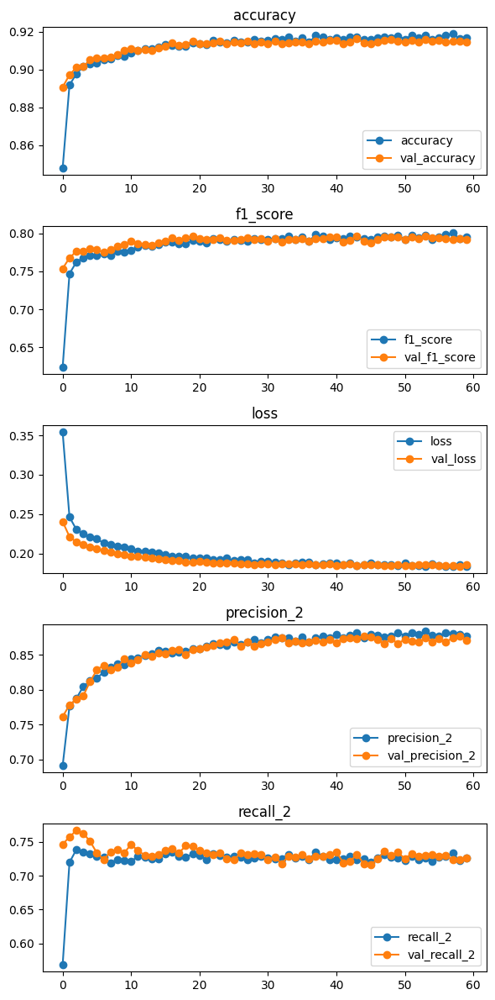

In [ ]:
plot_history(history_2);

In [ ]:
y_pred_test = clf_model_2.predict(X_test)
y_pred_test[:5]

352/352 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step


array([[8.2922024e-01],
       [1.5706988e-19],
       [9.4398543e-02],
       [2.3664962e-01],
       [1.2388748e-21]], dtype=float32)

In [ ]:
y_pred_test = np.round(y_pred_test)
y_pred_test[:5]

array([[1.],
       [0.],
       [0.],
       [0.],
       [0.]], dtype=float32)

              precision    recall  f1-score   support

           0       0.93      0.97      0.95      8757
           1       0.89      0.73      0.80      2492

    accuracy                           0.92     11249
   macro avg       0.91      0.85      0.88     11249
weighted avg       0.92      0.92      0.92     11249



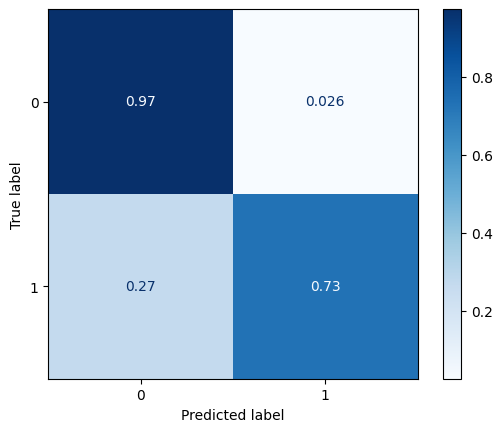

In [ ]:
print(classification_report(y_test, y_pred_test))
ConfusionMatrixDisplay.from_predictions(y_test, y_pred_test, cmap='Blues',normalize='true');

## Model 3

In [ ]:
def build_model_3():
    # Instantiate Model
    model = Sequential()

    # First hidden layer
    model.add(Dense(20,input_dim =input_shape,activation = 'relu'))
    model.add(Dropout(0.2))

    # Second hidden layer
    model.add(Dense(10,activation = 'relu'))
    model.add(Dropout(0.2))

    # Third hidden layer
    model.add(Dense(5, activation = 'relu'))

    model.add(Dense(1, activation = 'sigmoid'))

    # Compile Model
    model.compile(loss = 'bce', optimizer = 'adam', metrics=['accuracy', metrics.Precision(), metrics.Recall(),tf.keras.metrics.F1Score(name='f1_score', dtype=None, threshold=0.5)])
    return model

In [ ]:
clf_model_3 = build_model_3()

/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


In [ ]:
clf_model_3.summary()

Model: "sequential_3"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense_9 (Dense)                 │ (None, 20)             │           380 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_2 (Dropout)             │ (None, 20)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_10 (Dense)                │ (None, 10)             │           210 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_3 (Dropout)             │ (None, 10)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_11 (Dense)                │ (None, 5)              │            55 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_12 (Dense)                │ (None, 1)              │             6 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 651 (2.54 KB)

 Trainable params: 651 (2.54 KB)

 Non-trainable params: 0 (0.00 B)

In [ ]:
history_3 = clf_model_3.fit(X_train, y_train,validation_split=0.2,epochs=100)

Epoch 1/100
844/844 ━━━━━━━━━━━━━━━━━━━━ 13s 7ms/step - accuracy: 0.7887 - f1_score: 0.1345 - loss: 0.4686 - precision_3: 0.5017 - recall_3: 0.0840 - val_accuracy: 0.8878 - val_f1_score: 0.7496 - val_loss: 0.2671 - val_precision_3: 0.7508 - val_recall_3: 0.7483
Epoch 2/100
844/844 ━━━━━━━━━━━━━━━━━━━━ 6s 7ms/step - accuracy: 0.8832 - f1_score: 0.7380 - loss: 0.2655 - precision_3: 0.7371 - recall_3: 0.7393 - val_accuracy: 0.8929 - val_f1_score: 0.7616 - val_loss: 0.2244 - val_precision_3: 0.7604 - val_recall_3: 0.7629
Epoch 3/100
844/844 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - accuracy: 0.8934 - f1_score: 0.7569 - loss: 0.2368 - precision_3: 0.7680 - recall_3: 0.7461 - val_accuracy: 0.9001 - val_f1_score: 0.7752 - val_loss: 0.2167 - val_precision_3: 0.7830 - val_recall_3: 0.7675
Epoch 4/100
844/844 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - accuracy: 0.8971 - f1_score: 0.7614 - loss: 0.2268 - precision_3: 0.7852 - recall_3: 0.7391 - val_accuracy: 0.9041 - val_f1_score: 0.7806 - val_loss: 0.2113 - va

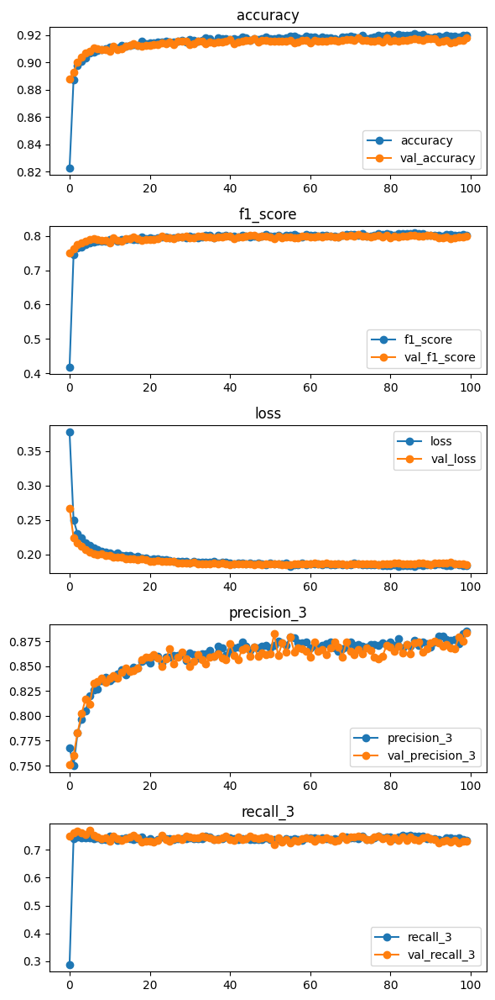

In [ ]:
plot_history(history_3);

In [ ]:
y_pred_test = clf_model_3.predict(X_test)
y_pred_test[:5]

352/352 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step


array([[9.4215691e-01],
       [2.2519118e-14],
       [2.2746347e-01],
       [2.7437046e-01],
       [1.6026480e-14]], dtype=float32)

In [ ]:
y_pred_test = np.round(y_pred_test)
y_pred_test[:5]

array([[1.],
       [0.],
       [0.],
       [0.],
       [0.]], dtype=float32)

              precision    recall  f1-score   support

           0       0.93      0.97      0.95      8757
           1       0.89      0.73      0.80      2492

    accuracy                           0.92     11249
   macro avg       0.91      0.85      0.88     11249
weighted avg       0.92      0.92      0.92     11249



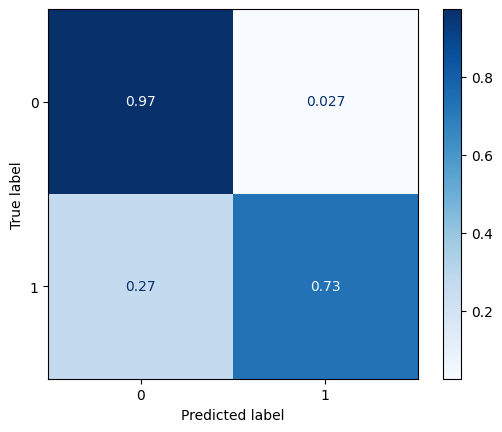

In [ ]:
print(classification_report(y_test, y_pred_test))
ConfusionMatrixDisplay.from_predictions(y_test, y_pred_test, cmap='Blues',normalize='true');

## Model 4

In [ ]:
def build_model_4():
    # Instantiate Model
    model = Sequential()

    # First hidden layer
    model.add(Dense(20,input_dim =input_shape,activation = 'relu'))
    model.add(Dropout(0.2))

    # Second hidden layer
    model.add(Dense(15,activation = 'relu'))
    model.add(Dropout(0.2))

    # Third hidden layer
    model.add(Dense(10, activation = 'relu'))

    # Fourth hidden layer
    model.add(Dense(5, activation = 'relu'))

    model.add(Dense(1, activation = 'sigmoid'))

    # Compile Model
    model.compile(loss = 'bce', optimizer = 'adam', metrics=['accuracy', metrics.Precision(), metrics.Recall(),tf.keras.metrics.F1Score(name='f1_score', dtype=None, threshold=0.5)])
    return model

In [ ]:
clf_model_4 = build_model_4()

/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


In [ ]:
clf_model_4.summary()

Model: "sequential_4"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense_13 (Dense)                │ (None, 20)             │           380 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_4 (Dropout)             │ (None, 20)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_14 (Dense)                │ (None, 15)             │           315 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_5 (Dropout)             │ (None, 15)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_15 (Dense)                │ (None, 10)             │           160 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_16 (Dense)                │ (None, 5)              │            55 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_17 (Dense)                │ (None, 1)              │             6 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 916 (3.58 KB)

 Trainable params: 916 (3.58 KB)

 Non-trainable params: 0 (0.00 B)

In [ ]:
history_4 = clf_model_4.fit(X_train, y_train,validation_split=0.2,epochs=70)

Epoch 1/70
844/844 ━━━━━━━━━━━━━━━━━━━━ 9s 6ms/step - accuracy: 0.8031 - f1_score: 0.3587 - loss: 0.4424 - precision_4: 0.5986 - recall_4: 0.2746 - val_accuracy: 0.8877 - val_f1_score: 0.7598 - val_loss: 0.2391 - val_precision_4: 0.7302 - val_recall_4: 0.7919
Epoch 2/70
844/844 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - accuracy: 0.8810 - f1_score: 0.7349 - loss: 0.2558 - precision_4: 0.7287 - recall_4: 0.7417 - val_accuracy: 0.8938 - val_f1_score: 0.7664 - val_loss: 0.2267 - val_precision_4: 0.7563 - val_recall_4: 0.7768
Epoch 3/70
844/844 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - accuracy: 0.8929 - f1_score: 0.7557 - loss: 0.2338 - precision_4: 0.7667 - recall_4: 0.7452 - val_accuracy: 0.8985 - val_f1_score: 0.7777 - val_loss: 0.2196 - val_precision_4: 0.7645 - val_recall_4: 0.7913
Epoch 4/70
844/844 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - accuracy: 0.8971 - f1_score: 0.7629 - loss: 0.2272 - precision_4: 0.7823 - recall_4: 0.7447 - val_accuracy: 0.9035 - val_f1_score: 0.7836 - val_loss: 0.2125 - val_pre

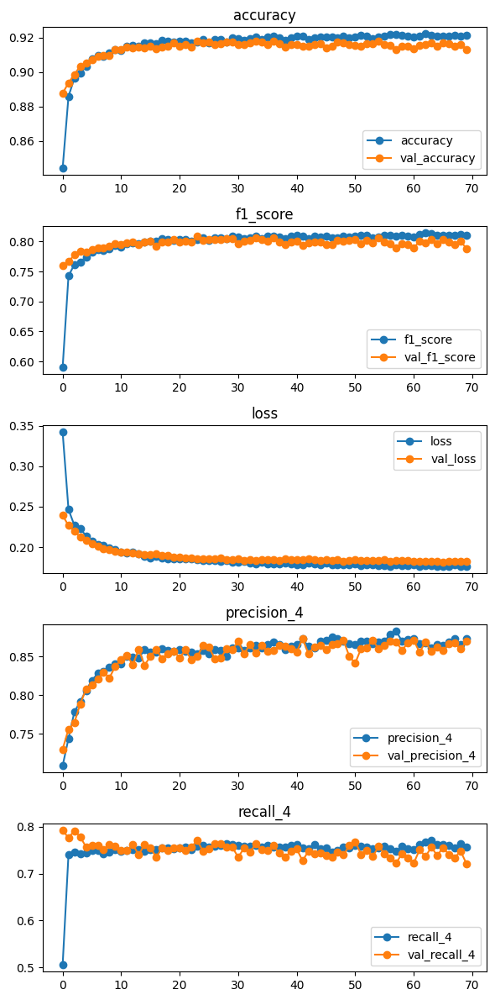

In [ ]:
plot_history(history_4);

In [ ]:
y_pred_test = clf_model_4.predict(X_test)
y_pred_test[:5]

352/352 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step


array([[8.9587045e-01],
       [1.7295362e-12],
       [1.0344507e-01],
       [2.0301908e-01],
       [5.5622964e-15]], dtype=float32)

In [ ]:
y_pred_test = np.round(y_pred_test)
y_pred_test[:5]

array([[1.],
       [0.],
       [0.],
       [0.],
       [0.]], dtype=float32)

              precision    recall  f1-score   support

           0       0.93      0.98      0.95      8757
           1       0.89      0.73      0.80      2492

    accuracy                           0.92     11249
   macro avg       0.91      0.85      0.88     11249
weighted avg       0.92      0.92      0.92     11249



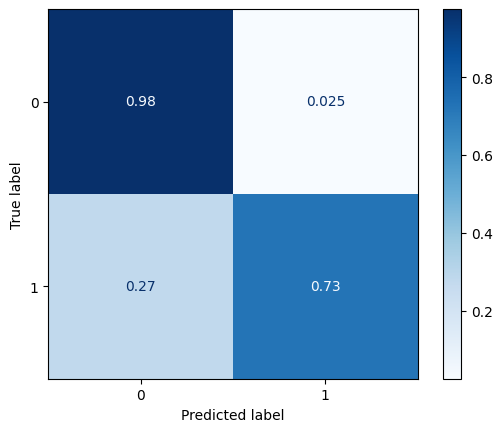

In [ ]:
print(classification_report(y_test, y_pred_test))
ConfusionMatrixDisplay.from_predictions(y_test, y_pred_test, cmap='Blues',normalize='true');

## Model 5 (Tunning)

In [ ]:
#!pip install keras-tuner

In [ ]:
from keras_tuner import HyperParameters as hp
import keras_tuner as kt

In [ ]:
folder = 'KerasTuner/'
os.makedirs(folder, exist_ok=True)

In [ ]:
def build_model5(hp):
    # Instantiate Model
    model = Sequential()

    # First hidden layer
    model.add(Dense(20,input_dim =input_shape,activation = 'relu'))

    model.add(Dense(units=hp.Int('units', min_value=1, max_value=50, step=2),activation = 'relu'))

    model.add(Dropout(hp.Float(name="dropout_value", min_value=0.0, max_value=0.9, step=0.1)))

    model.add(Dense(units=hp.Int('units', min_value=1, max_value=50, step=2),activation = 'relu'))

    model.add(Dropout(hp.Float(name="dropout_value", min_value=0.0, max_value=0.9, step=0.1)))

    model.add(Dense(1, activation = 'sigmoid'))

    # Tune the learning rate for the optimizer
    learning_rate = hp.Choice('learning_rate', values=[1e-5, 1e-4, 1e-3, 3e-3, 1e-2, 3e-1, 1.0, 3.0, 10.0])

    # Optimizer choice with learning rate

    optimizer = hp.Choice('optimizer', ['rmsprop', 'nadam', 'adam'])
    if optimizer == 'adam':
        optimizer_instance = optimizers.Adam(learning_rate=learning_rate)
    elif optimizer == 'rmsprop':
        optimizer_instance = optimizers.RMSprop(learning_rate=learning_rate)
    elif optimizer == 'nadam':
        optimizer_instance = optimizers.Nadam(learning_rate=learning_rate)

    # Compile Model
    model.compile(optimizer=optimizer_instance,loss='bce',metrics=['accuracy',tf.keras.metrics.Recall(name='recall'),tf.keras.metrics.Precision(name='precision'),tf.keras.metrics.F1Score(name='F1Score',threshold=0.5)])
    return model

### Loss Tune

In [ ]:
tuner1 = kt.Hyperband(build_model5,objective='val_loss',max_epochs=100,directory=folder,overwrite = True,seed = 42,
project_name='losse_tuning')

/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


In [ ]:
early_stop = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)

In [ ]:
epochs = 100
tuner1.search(X_train, y_train,  epochs=epochs,validation_split=0.2, callbacks = [early_stop])

Trial 254 Complete [00h 00m 53s]
val_loss: 0.35538268089294434

Best val_loss So Far: 0.18330258131027222
Total elapsed time: 02h 22m 25s


In [ ]:
best_hps1=tuner1.get_best_hyperparameters()[0]
best_hps1.values

{'units': 7,
 'dropout_value': 0.1,
 'learning_rate': 0.003,
 'optimizer': 'adam',
 'tuner/epochs': 34,
 'tuner/initial_epoch': 12,
 'tuner/bracket': 4,
 'tuner/round': 3,
 'tuner/trial_id': '0139'}

In [ ]:
best_model1 = tuner1.get_best_models()[0]
best_model1.summary()

/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/usr/local/lib/python3.11/dist-packages/keras/src/saving/saving_lib.py:757: UserWarning: Skipping variable loading for optimizer 'adam', because it has 2 variables whereas the saved optimizer has 18 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense (Dense)                   │ (None, 20)             │           380 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 7)              │           147 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 7)              │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 7)              │            56 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 7)              │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_3 (Dense)                 │ (None, 1)              │             8 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 591 (2.31 KB)

 Trainable params: 591 (2.31 KB)

 Non-trainable params: 0 (0.00 B)

In [ ]:
result1 = best_model1.evaluate(X_test, y_test, return_dict=True)
result1

352/352 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - F1Score: 0.8173 - accuracy: 0.9227 - loss: 0.1722 - precision: 0.8832 - recall: 0.7607


{'F1Score': 0.807841420173645,
 'accuracy': 0.9207040667533875,
 'loss': 0.1767999529838562,
 'precision': 0.8720930218696594,
 'recall': 0.7524077296257019}

In [ ]:
y_pred2 = best_model1.predict(X_test)

352/352 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step


In [ ]:
y_pred_test2 = np.round(y_pred2)
y_pred_test2[:5]

array([[1.],
       [0.],
       [0.],
       [0.],
       [0.]], dtype=float32)

              precision    recall  f1-score   support

           0       0.93      0.97      0.95      8757
           1       0.87      0.75      0.81      2492

    accuracy                           0.92     11249
   macro avg       0.90      0.86      0.88     11249
weighted avg       0.92      0.92      0.92     11249



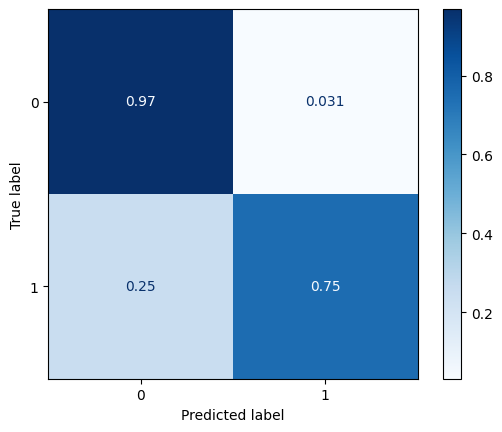

In [ ]:
print(classification_report(y_test,y_pred_test2))
ConfusionMatrixDisplay.from_predictions(y_test, y_pred_test2, cmap='Blues',normalize='true');

### Accuracy Tune

In [ ]:
tuner4 = kt.Hyperband(build_model5,objective='val_accuracy',max_epochs=100,directory=folder,overwrite = True,seed = 42,
project_name='accuracy_tuning')

/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


In [ ]:
epochs = 100
tuner4.search(X_train, y_train,  epochs=epochs,validation_split=0.2, callbacks = [early_stop])

Trial 254 Complete [00h 00m 49s]
val_accuracy: 0.7756704688072205

Best val_accuracy So Far: 0.9190991520881653
Total elapsed time: 02h 30m 47s


In [ ]:
best_hps4=tuner4.get_best_hyperparameters()[0]
best_hps4.values

{'units': 25,
 'dropout_value': 0.2,
 'learning_rate': 0.003,
 'optimizer': 'nadam',
 'tuner/epochs': 34,
 'tuner/initial_epoch': 12,
 'tuner/bracket': 4,
 'tuner/round': 3,
 'tuner/trial_id': '0135'}

In [ ]:
best_model4 = tuner4.get_best_models()[0]
best_model4.summary()

/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/usr/local/lib/python3.11/dist-packages/keras/src/saving/saving_lib.py:757: UserWarning: Skipping variable loading for optimizer 'nadam', because it has 2 variables whereas the saved optimizer has 19 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense (Dense)                   │ (None, 20)             │           380 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 25)             │           525 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 25)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 25)             │           650 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 25)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_3 (Dense)                 │ (None, 1)              │            26 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 1,581 (6.18 KB)

 Trainable params: 1,581 (6.18 KB)

 Non-trainable params: 0 (0.00 B)

In [ ]:
result4 = best_model4.evaluate(X_test, y_test, return_dict=True)
result4

352/352 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - F1Score: 0.8191 - accuracy: 0.9213 - loss: 0.1737 - precision: 0.8571 - recall: 0.7845


{'F1Score': 0.8131683468818665,
 'accuracy': 0.9207929372787476,
 'loss': 0.17680108547210693,
 'precision': 0.851559042930603,
 'recall': 0.7780898809432983}

In [ ]:
y_pred4 = best_model4.predict(X_test)

352/352 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step


In [ ]:
y_pred_test4 = np.round(y_pred4)
y_pred_test4[:5]

array([[1.],
       [0.],
       [0.],
       [0.],
       [0.]], dtype=float32)

              precision    recall  f1-score   support

           0       0.94      0.96      0.95      8757
           1       0.85      0.78      0.81      2492

    accuracy                           0.92     11249
   macro avg       0.89      0.87      0.88     11249
weighted avg       0.92      0.92      0.92     11249



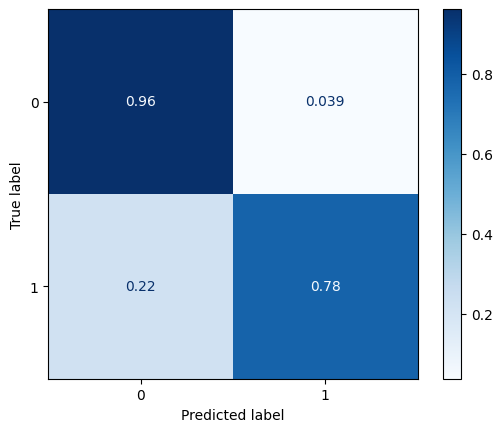

In [ ]:
print(classification_report(y_test,y_pred_test4))
ConfusionMatrixDisplay.from_predictions(y_test, y_pred_test4, cmap='Blues',normalize='true');

# Hyper-Modeling

In [ ]:
from tensorflow.keras.layers import Dense, Layer # type: ignore
class SklearnModelLayer(Layer):
    def __init__(self, sklearn_model, **kwargs):
        self.sklearn_model = sklearn_model
        super().__init__(**kwargs)

    def build(self, input_shape):
        super().build(input_shape)

    def call(self, inputs, training=None):
        # Use the inputs directly
        def sklearn_predict(x):
            x_np = x.numpy()
            # Use predict_proba for probabilities
            preds = self.sklearn_model.predict_proba(x_np)[:, 1].reshape(-1, 1)
            return preds.astype(np.float32)

        result = tf.py_function(
            func=sklearn_predict,
            inp=[inputs],
            Tout=tf.float32
        )
        result.set_shape((None, 1))
        return result

In [ ]:
def build_hyper_model():

    model = XGBClassifier(learning_rate=0.5, max_depth=10, max_features=0.35000000000000003, min_samples_leaf=3, min_samples_split=8, n_estimators=100, subsample=1.0, random_state=42,  probability=True)
    ml_model = ThresholdedClassifier(model=model, threshold=0.25)
    ml_model.fit(X_train, y_train)

    inputs = tf.keras.Input(shape=(input_shape,))

    nn_features = Dense(20, activation='relu')(inputs)
    nn_features = Dense(25, activation='relu')(nn_features)
    nn_dropout = Dropout(0.2)(nn_features)
    nn_features = Dense(25, activation='relu')(nn_features)
    nn_dropout = Dropout(0.2)(nn_features)

    nn_output = Dense(1, activation='relu')(nn_features)

    rf_output = SklearnModelLayer(ml_model)(inputs)

    combined = tf.keras.layers.Concatenate()([nn_output, rf_output])

    outputs = Dense(1, activation='sigmoid')(combined)

    model = tf.keras.Model(inputs=inputs, outputs=outputs)

    model.compile(
        loss='binary_crossentropy',
        optimizer=optimizers.Nadam(learning_rate=0.003),
        metrics=['accuracy', tf.keras.metrics.Precision(),
                 tf.keras.metrics.Recall(), tf.keras.metrics.F1Score(name='f1_score', dtype=None, threshold=0.50)]
    )
    return model

In [ ]:
hyper_model = build_hyper_model()
hyper_model.summary()

/usr/local/lib/python3.11/dist-packages/xgboost/core.py:158: UserWarning: [07:07:10] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "max_features", "min_samples_leaf", "min_samples_split", "probability" } are not used.

  warnings.warn(smsg, UserWarning)


Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 18)        │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense (Dense)       │ (None, 20)        │        380 │ input_layer[0][0] │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_1 (Dense)     │ (None, 25)        │        525 │ dense[0][0]       │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_2 (Dense)     │ (None, 25)        │        650 │ dense_1[0][0]     │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_3 (Dense)     │ (None, 1)         │         26 │ dense_2[0][0]     │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ sklearn_model_layer │ (None, 1)         │          0 │ input_layer[0][0] │
│ (SklearnModelLayer) │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ concatenate         │ (None, 2)         │          0 │ dense_3[0][0],    │
│ (Concatenate)       │                   │            │ sklearn_model_la… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_4 (Dense)     │ (None, 1)         │          3 │ concatenate[0][0] │
└─────────────────────┴───────────────────┴────────────┴───────────────────┘

 Total params: 1,584 (6.19 KB)

 Trainable params: 1,584 (6.19 KB)

 Non-trainable params: 0 (0.00 B)

In [ ]:
history_5 = hyper_model.fit(X_train, y_train,validation_split=0.2,epochs=70,callbacks = [early_stop])

Epoch 1/70
844/844 ━━━━━━━━━━━━━━━━━━━━ 11s 9ms/step - accuracy: 0.8138 - f1_score: 0.3932 - loss: 0.3619 - precision: 0.5013 - recall: 0.3287 - val_accuracy: 0.9366 - val_f1_score: 0.8634 - val_loss: 0.1598 - val_precision: 0.8352 - val_recall: 0.8937
Epoch 2/70
844/844 ━━━━━━━━━━━━━━━━━━━━ 5s 6ms/step - accuracy: 0.9535 - f1_score: 0.8932 - loss: 0.1365 - precision: 0.9144 - recall: 0.8732 - val_accuracy: 0.9730 - val_f1_score: 0.9399 - val_loss: 0.0943 - val_precision: 0.9405 - val_recall: 0.9392
Epoch 3/70
844/844 ━━━━━━━━━━━━━━━━━━━━ 8s 10ms/step - accuracy: 0.9840 - f1_score: 0.9633 - loss: 0.0803 - precision: 0.9793 - recall: 0.9479 - val_accuracy: 0.9910 - val_f1_score: 0.9798 - val_loss: 0.0583 - val_precision: 0.9840 - val_recall: 0.9756
Epoch 4/70
844/844 ━━━━━━━━━━━━━━━━━━━━ 7s 6ms/step - accuracy: 0.9958 - f1_score: 0.9904 - loss: 0.0495 - precision: 0.9966 - recall: 0.9844 - val_accuracy: 0.9979 - val_f1_score: 0.9954 - val_loss: 0.0375 - val_precision: 0.9967 - val_recal

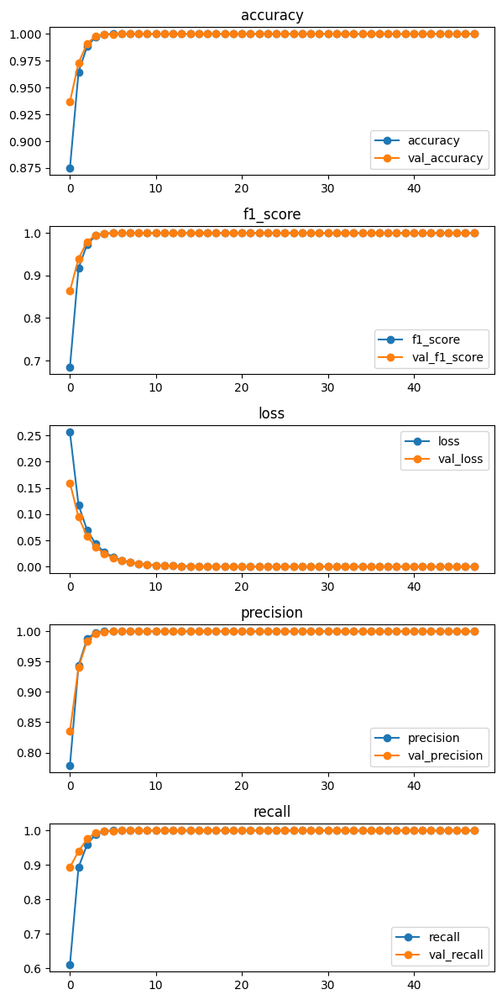

In [ ]:
plot_history(history_5);

In [ ]:
y_pred_test5 = hyper_model.predict(X_test)
y_pred_test5[:5]

352/352 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step


array([[9.9999970e-01],
       [1.2961885e-11],
       [2.8493517e-07],
       [1.8112276e-02],
       [7.9095376e-12]], dtype=float32)

In [ ]:
y_pred_test5 = np.round(y_pred_test5)
y_pred_test5[:5]

array([[1.],
       [0.],
       [0.],
       [0.],
       [0.]], dtype=float32)

              precision    recall  f1-score   support

           0       0.95      0.97      0.96      8757
           1       0.87      0.81      0.84      2492

    accuracy                           0.93     11249
   macro avg       0.91      0.89      0.90     11249
weighted avg       0.93      0.93      0.93     11249



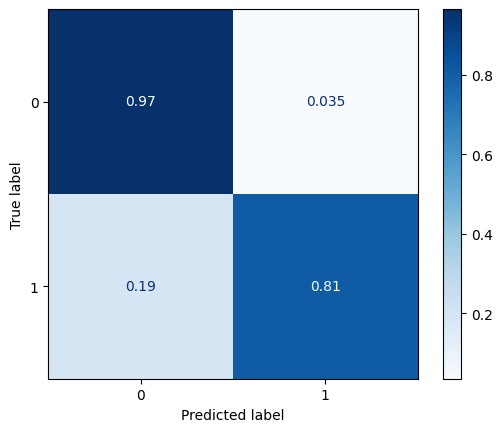

In [ ]:
print(classification_report(y_test, y_pred_test5))
ConfusionMatrixDisplay.from_predictions(y_test, y_pred_test5, cmap='Blues',normalize='true');

In [ ]:
# Evaluate the model on test data
test_results = hyper_model.evaluate(X_test, y_test)
print(f"Test loss: {test_results[0]}")
print(f"Test accuracy: {test_results[1]}")
print(f"Test precision: {test_results[2]}")
print(f"Test recall: {test_results[3]}")
print(f"Test F1 score: {test_results[4]}")

352/352 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - accuracy: 0.9313 - f1_score: 0.8440 - loss: 0.6218 - precision: 0.8733 - recall: 0.8167
Test loss: 0.6547110080718994
Test accuracy: 0.9299493432044983
Test precision: 0.8678756356239319
Test recall: 0.8065810799598694
Test F1 score: 0.8361064791679382


# Threshold Tunning Neural Hyper Model

In [ ]:
threshold = 0.50

352/352 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step


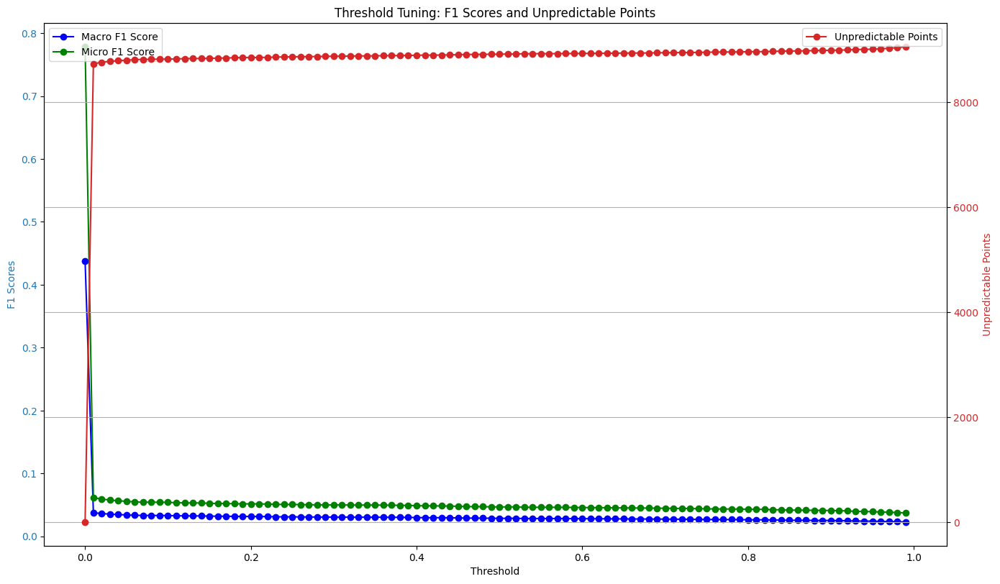

Threshold: 0.00, Macro F1: 0.4377, Micro F1: 0.7785, Unpredictable: 0
Threshold: 0.01, Macro F1: 0.0375, Micro F1: 0.0614, Unpredictable: 8727
Threshold: 0.02, Macro F1: 0.0361, Micro F1: 0.0591, Unpredictable: 8757
Threshold: 0.03, Macro F1: 0.0353, Micro F1: 0.0577, Unpredictable: 8775
Threshold: 0.04, Macro F1: 0.0345, Micro F1: 0.0565, Unpredictable: 8787
Threshold: 0.05, Macro F1: 0.0340, Micro F1: 0.0556, Unpredictable: 8796
Threshold: 0.06, Macro F1: 0.0334, Micro F1: 0.0546, Unpredictable: 8807
Threshold: 0.07, Macro F1: 0.0331, Micro F1: 0.0542, Unpredictable: 8812
Threshold: 0.08, Macro F1: 0.0331, Micro F1: 0.0542, Unpredictable: 8813
Threshold: 0.09, Macro F1: 0.0331, Micro F1: 0.0541, Unpredictable: 8816
Threshold: 0.10, Macro F1: 0.0330, Micro F1: 0.0539, Unpredictable: 8817
Threshold: 0.11, Macro F1: 0.0326, Micro F1: 0.0534, Unpredictable: 8822
Threshold: 0.12, Macro F1: 0.0325, Micro F1: 0.0531, Unpredictable: 8826
Threshold: 0.13, Macro F1: 0.0324, Micro F1: 0.0530, U

In [ ]:
from sklearn.metrics import f1_score

probabilities = hyper_model.predict(X_test)
y_true = y_test
classes = np.array([0, 1])

def convert_probs_to_preds(probabilities, threshold, classes):
    predictions = []
    for prob in probabilities:
        max_prob_class = np.argmax(prob)
        max_prob_value = prob[max_prob_class]

        if max_prob_value > threshold:
            predictions.append(classes[max_prob_class])
        else:
            predictions.append(-1)  # Unpredictable point

    return np.array(predictions)

thresholds = np.arange(0, 1, 0.01)

macro_f1_scores = []
micro_f1_scores = []
unpredictable_counts = []

for thresh in thresholds:
    preds = convert_probs_to_preds(probabilities, thresh, classes)

    # Calculate Macro and Micro F1 scores
    macro_f1 = f1_score(y_test, preds, average='macro', labels=classes, zero_division=0)
    micro_f1 = f1_score(y_test, preds, average='micro', labels=classes, zero_division=0)

    # Count the number of unpredictable data points
    unpredictable_count = np.sum(preds == -1)

    # Append results to the lists
    macro_f1_scores.append(macro_f1)
    micro_f1_scores.append(micro_f1)
    unpredictable_counts.append(unpredictable_count)

# Plotting the results with separate y-axes for F1 scores and unpredictable points
fig, ax1 = plt.subplots(figsize=(14, 8))

# Plot Macro and Micro F1 Scores
color = 'tab:blue'
ax1.set_xlabel('Threshold')
ax1.set_ylabel('F1 Scores', color=color)
ax1.plot(thresholds, macro_f1_scores, label='Macro F1 Score', marker='o', color='blue')
ax1.plot(thresholds, micro_f1_scores, label='Micro F1 Score', marker='o', color='green')
ax1.tick_params(axis='y', labelcolor=color)
ax1.legend(loc='upper left')

# Plot Unpredictable Points on the second y-axis
ax2 = ax1.twinx()
color = 'tab:red'
ax2.set_ylabel('Unpredictable Points', color=color)
ax2.plot(thresholds, unpredictable_counts, label='Unpredictable Points', marker='o', color=color)
ax2.tick_params(axis='y', labelcolor=color)
ax2.legend(loc='upper right')

# Adjust layout and show the plot
fig.tight_layout()
plt.title('Threshold Tuning: F1 Scores and Unpredictable Points')
plt.grid(True)
plt.show()

# Print threshold and corresponding metrics for reference
for thresh, macro_f1, micro_f1, count in zip(thresholds, macro_f1_scores, micro_f1_scores, unpredictable_counts):
    print(f"Threshold: {thresh:.2f}, Macro F1: {macro_f1:.4f}, Micro F1: {micro_f1:.4f}, Unpredictable: {count}")

pred_score = probabilities.max(axis=1)
pred_score[pred_score <threshold]=0

pred_class = probabilities.argmax(axis=1)
pred_class[pred_score==0]=-1

zero_indices = np.where(pred_score == 0)[0]

print(f"\n Orginal index of -1 values: \n\n {zero_indices}")

# Find the index of the maximum Macro F1 score
best_macro_idx = np.argmax(macro_f1_scores)
best_macro_thresh = thresholds[best_macro_idx]
best_macro_f1 = macro_f1_scores[best_macro_idx]

# Find the index of the maximum Micro F1 score
best_micro_idx = np.argmax(micro_f1_scores)
best_micro_thresh = thresholds[best_micro_idx]
best_micro_f1 = micro_f1_scores[best_micro_idx]

# Print the optimal thresholds and corresponding F1 scores
print("\nOptimal Thresholds:\n")
print(f"Optimal Threshold for Macro F1 Score: {best_macro_thresh:.2f}")
print(f"Macro F1 Score at Optimal Threshold: {best_macro_f1:.4f}")

print(f"Optimal Threshold for Micro F1 Score: {best_micro_thresh:.2f}")
print(f"Micro F1 Score at Optimal Threshold: {best_micro_f1:.4f}\n")

print(f"Prediction Scores:\n\n{pred_score}")
print(f"\n Prediction Classes:\n\n{pred_class}")

# Reinforcement Learning Modeling

## Imports

In [ ]:
import gym
from gym import spaces
import numpy as np
import itertools
import random
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import StandardScaler, MinMaxScaler, RobustScaler, OneHotEncoder, OrdinalEncoder
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from xgboost import XGBClassifier
from sklearn.svm import SVC
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score
import pandas as pd
import torch
import torch.nn as nn
import torch.optim as optim
import random
from collections import deque
from sklearn.datasets import load_iris
from sklearn.model_selection import train_test_split
import pandas as pd
import matplotlib.pyplot as plt


## Env

In [ ]:
class AutoMLPipelineEnv(gym.Env):
    def __init__(self, search_space, X_train, y_train, X_test, y_test, max_trials=100):
        super().__init__()
        self.search_space = search_space
        self.X_train, self.y_train = X_train, y_train
        self.X_test, self.y_test = X_test, y_test
        self.max_trials = max_trials

        self.scalers = search_space["scaler"]
        self.encoders = search_space["encoder"]
        self.classifiers = search_space["classifier"]
        self.hp_space = search_space["hyperparameters"]

        self.total_actions = self._generate_action_space()
        self.action_space = spaces.Discrete(len(self.total_actions))
        self.observation_space = spaces.Box(low=0, high=1, shape=(6,), dtype=np.float32)

        self.trial = 0
        self.last_reward = 0.0
        self.best_reward = 0.0
        self.last_action = None
        self.trial_log = []
        self.best_config = None


    def _generate_action_space(self):
        actions = []
        for scaler in self.scalers:
            for encoder in self.encoders:
                for clf in self.classifiers:
                    hp_grid = list(itertools.product(*self.hp_space[clf].values()))
                    for hp in hp_grid:
                        actions.append((scaler, encoder, clf, dict(zip(self.hp_space[clf].keys(), hp))))
        return actions

    def _get_state(self):
        if self.last_action is None:
            scaler_idx = -1
            encoder_idx = -1
            clf_idx = -1
        else:
            scaler, encoder, clf, _ = self.total_actions[self.last_action]
            scaler_idx = self.scalers.index(scaler)
            encoder_idx = self.encoders.index(encoder)
            clf_idx = self.classifiers.index(clf)

        return np.array([
            self.trial / self.max_trials,
            scaler_idx / len(self.scalers),
            encoder_idx / len(self.encoders),
            clf_idx / len(self.classifiers),
            self.last_reward,
            self.best_reward
        ], dtype=np.float32)

    def _print_info(self, config, reward):
        scaler, encoder, clf, hp = config
        print(f"\nTrial {self.trial}/{self.max_trials}")
        print(f"  Scaler: {scaler}")
        print(f"  Encoder: {encoder}")
        print(f"  Classifier: {clf}")
        print(f"  Hyperparams: {hp}")
        print(f"  Accuracy (Reward): {reward:.4f}")
        print(f"  Best So Far: {self.best_reward:.4f}")

        if self.best_config:
          best_scaler, best_encoder, best_clf, best_hp = self.best_config
          print(f"  Best Config:")
          print(f"    Scaler: {best_scaler}")
          print(f"    Encoder: {best_encoder}")
          print(f"    Classifier: {best_clf}")
          print(f"    Hyperparams: {best_hp}")

    def step(self, action_idx):
        config = self.total_actions[action_idx]
        scaler_name, encoder_name, clf_name, clf_params = config

        scaler_map = {
            "StandardScaler": StandardScaler(),
            "MinMaxScaler": MinMaxScaler(),
            "RobustScaler": RobustScaler(),
            None: "passthrough"
        }
        encoder_map = {
            "OneHotEncoder": OneHotEncoder(handle_unknown="ignore", sparse_output=False),
            "OrdinalEncoder": OrdinalEncoder(),
            None: "passthrough"
        }
        clf_map = {
            "RandomForest": RandomForestClassifier,
            "XGBBoost": XGBClassifier,
            "SVC": SVC,
            "LogisticRegression": LogisticRegression,
            "GradientBoosting": GradientBoostingClassifier
        }

        preprocessor = ColumnTransformer([
            ("scale", scaler_map[scaler_name], self.X_train.select_dtypes(include=np.number).columns),
            ("encode", encoder_map[encoder_name], self.X_train.select_dtypes(include=object).columns)
        ])

        clf = clf_map[clf_name](**clf_params)
        pipeline = Pipeline([("pre", preprocessor), ("clf", clf)])

        try:
            pipeline.fit(self.X_train, self.y_train)
            y_pred = pipeline.predict(self.X_test)
            reward = accuracy_score(self.y_test, y_pred)
        except Exception:
            reward = 0.0

        self.last_reward = reward

        if reward > self.best_reward:
          self.best_reward = reward
          self.best_config = config

        self.trial += 1
        self.last_action = action_idx

        # Store more detailed information in trial_log for DataFrame creation
        trial_info = {
            'trial': self.trial,
            'episode': self.current_episode,  # Add this to track episode
            'scaler': scaler_name,
            'encoder': encoder_name,
            'classifier': clf_name,
            'hyperparameters': str(clf_params),  # Convert dict to string for DataFrame
            'accuracy': reward,
            'best_so_far': self.best_reward
        }
        self.trial_log.append(trial_info)

        self._print_info(config, reward)

        done = self.trial >= self.max_trials
        return self._get_state(), reward, done, {"config": config}

    def reset(self):
        self.trial = 0
        self.last_reward = 0.0
        self.best_reward = 0.0
        self.last_action = None
        return self._get_state()

    def set_episode(self, episode):
        # Add this method to track the current episode
        self.current_episode = episode

    def get_results_df(self):
        # Create DataFrame from trial_log
        return pd.DataFrame(self.trial_log)

## DQNN

In [ ]:
class DQN(nn.Module):
    def __init__(self, state_dim, action_dim):
        super().__init__()
        self.model = nn.Sequential(
            nn.Linear(state_dim, 128),
            nn.ReLU(),
            nn.Linear(128, action_dim)
        )

    def forward(self, x):
        return self.model(x)

In [ ]:
class DQNAgent:
    def __init__(self, state_dim, action_dim, lr=1e-3, gamma=0.99, epsilon=1.0, epsilon_min=0.1, epsilon_decay=0.995):
        self.model = DQN(state_dim, action_dim)
        self.target_model = DQN(state_dim, action_dim)
        self.target_model.load_state_dict(self.model.state_dict())
        self.optimizer = optim.Adam(self.model.parameters(), lr=lr)
        self.loss_fn = nn.MSELoss()
        self.memory = deque(maxlen=5000)
        self.gamma = gamma
        self.epsilon = epsilon
        self.epsilon_min = epsilon_min
        self.epsilon_decay = epsilon_decay
        self.batch_size = 64

    def act(self, state):
        if random.random() < self.epsilon:
            return random.randint(0, self.model.model[-1].out_features - 1)
        with torch.no_grad():
            state_tensor = torch.FloatTensor(state).unsqueeze(0)
            return torch.argmax(self.model(state_tensor)).item()

    def remember(self, state, action, reward, next_state, done):
        self.memory.append((state, action, reward, next_state, done))

    def train_step(self):
        if len(self.memory) < self.batch_size:
            return

        batch = random.sample(self.memory, self.batch_size)
        states, actions, rewards, next_states, dones = zip(*batch)

        states_tensor = torch.FloatTensor(states)
        actions_tensor = torch.LongTensor(actions).unsqueeze(1)
        rewards_tensor = torch.FloatTensor(rewards)
        next_states_tensor = torch.FloatTensor(next_states)
        dones_tensor = torch.BoolTensor(dones)

        q_values = self.model(states_tensor).gather(1, actions_tensor).squeeze()
        with torch.no_grad():
            next_q_values = self.target_model(next_states_tensor).max(1)[0]
        target_q = rewards_tensor + self.gamma * next_q_values * (~dones_tensor)

        loss = self.loss_fn(q_values, target_q)

        self.optimizer.zero_grad()
        loss.backward()
        self.optimizer.step()

    def update_target_network(self):
        self.target_model.load_state_dict(self.model.state_dict())

    def decay_epsilon(self):
        self.epsilon = max(self.epsilon_min, self.epsilon * self.epsilon_decay)
        print(f"Epsilon: {self.epsilon}")

## Search Space

In [ ]:
search_space = {
    "scaler": ["StandardScaler", "MinMaxScaler", "RobustScaler", None],
    "encoder": ["OneHotEncoder", "OrdinalEncoder", None],
    "classifier": ["RandomForest", "XGBBoost", "SVC", "LogisticRegression", "GradientBoosting"],
    "hyperparameters": {
        "RandomForest": {
            "n_estimators": range(20,250),
            "max_depth": [None,range(1,10)],
            "min_samples_split": [2,3,4,5],
            "bootstrap": [True],
            "n_jobs": [-1],
            "random_state": [42]
        },
        "XGBBoost": {
            "n_estimators": range(10,250),
            "max_depth": [3],
            "learning_rate": [0.1,0.001,0.3,0.003],
            "subsample": [1.0],
            "random_state": [42]
        },
        "SVC": {
            "C": [1.0,None],
            "kernel": ["rbf"],
            "gamma": ["scale"],
            "random_state": [42]
        },
        "LogisticRegression": {
            "C": [1.0],
            "penalty": ["l2"],
            "solver": ["lbfgs"],
            "random_state": [42],
            "max_iter": [10000]
        },
        "GradientBoosting": {
            "n_estimators": range(20,250),
            "learning_rate": [0.1,0.001,0.3,0.003],
            "max_depth": [2,3,4,5],
            "random_state": [42]
        }
    }
}

## RL Modeling

In [ ]:
# Initialize environment and agent
env = AutoMLPipelineEnv(search_space, X_train, y_train, X_test, y_test, max_trials=10)
agent = DQNAgent(state_dim=env.observation_space.shape[0], action_dim=env.action_space.n)

In [ ]:
reward_curve = []

# Training loop
episodes = 100
for ep in range(episodes):
    print(f"\n=== EPISODE {ep+1}/{episodes} ===")
    state = env.reset()
    env.set_episode(ep+1)
    done = False
    episode_reward = 0

    while not done:
        action = agent.act(state)
        next_state, reward, done, _ = env.step(action)
        agent.remember(state, action, reward, next_state, done)
        agent.train_step()
        state = next_state
        episode_reward += reward

    reward_curve.append(episode_reward)
    agent.update_target_network()
    agent.decay_epsilon()


=== EPISODE 1/100 ===

Trial 1/10
  Scaler: MinMaxScaler
  Encoder: OrdinalEncoder
  Classifier: XGBBoost
  Hyperparams: {'n_estimators': 95, 'max_depth': 3, 'learning_rate': 0.3, 'subsample': 1.0, 'random_state': 42}
  Accuracy (Reward): 0.9277
  Best So Far: 0.9277
  Best Config:
    Scaler: MinMaxScaler
    Encoder: OrdinalEncoder
    Classifier: XGBBoost
    Hyperparams: {'n_estimators': 95, 'max_depth': 3, 'learning_rate': 0.3, 'subsample': 1.0, 'random_state': 42}

Trial 2/10
  Scaler: MinMaxScaler
  Encoder: None
  Classifier: GradientBoosting
  Hyperparams: {'n_estimators': 174, 'learning_rate': 0.001, 'max_depth': 2, 'random_state': 42}
  Accuracy (Reward): 0.0000
  Best So Far: 0.9277
  Best Config:
    Scaler: MinMaxScaler
    Encoder: OrdinalEncoder
    Classifier: XGBBoost
    Hyperparams: {'n_estimators': 95, 'max_depth': 3, 'learning_rate': 0.3, 'subsample': 1.0, 'random_state': 42}

Trial 3/10
  Scaler: StandardScaler
  Encoder: OneHotEncoder
  Classifier: GradientBoos

<ipython-input-49-a4e5381fbe23>:32: UserWarning: Creating a tensor from a list of numpy.ndarrays is extremely slow. Please consider converting the list to a single numpy.ndarray with numpy.array() before converting to a tensor. (Triggered internally at /pytorch/torch/csrc/utils/tensor_new.cpp:254.)
  states_tensor = torch.FloatTensor(states)


Streaming output truncated to the last 5000 lines.

Trial 5/10
  Scaler: None
  Encoder: OrdinalEncoder
  Classifier: GradientBoosting
  Hyperparams: {'n_estimators': 70, 'learning_rate': 0.1, 'max_depth': 2, 'random_state': 42}
  Accuracy (Reward): 0.9140
  Best So Far: 0.9310
  Best Config:
    Scaler: None
    Encoder: OrdinalEncoder
    Classifier: GradientBoosting
    Hyperparams: {'n_estimators': 132, 'learning_rate': 0.3, 'max_depth': 5, 'random_state': 42}

Trial 6/10
  Scaler: MinMaxScaler
  Encoder: None
  Classifier: RandomForest
  Hyperparams: {'n_estimators': 52, 'max_depth': None, 'min_samples_split': 2, 'bootstrap': True, 'n_jobs': -1, 'random_state': 42}
  Accuracy (Reward): 0.0000
  Best So Far: 0.9310
  Best Config:
    Scaler: None
    Encoder: OrdinalEncoder
    Classifier: GradientBoosting
    Hyperparams: {'n_estimators': 132, 'learning_rate': 0.3, 'max_depth': 5, 'random_state': 42}

Trial 7/10
  Scaler: StandardScaler
  Encoder: OneHotEncoder
  Classifier: Gradi

In [ ]:
results_df = env.get_results_df()

# Display the results
print("\n=== SEARCH RESULTS ===")
display(results_df)


=== SEARCH RESULTS ===


,trial,episode,scaler,encoder,classifier,hyperparameters,accuracy,best_so_far
0,1,1,MinMaxScaler,OrdinalEncoder,XGBBoost,"{'n_estimators': 95, 'max_depth': 3, 'learning...",0.927727,0.927727
1,2,1,MinMaxScaler,None,GradientBoosting,"{'n_estimators': 174, 'learning_rate': 0.001, ...",0.000000,0.927727
2,3,1,StandardScaler,OneHotEncoder,GradientBoosting,"{'n_estimators': 146, 'learning_rate': 0.001, ...",0.778469,0.927727
3,4,1,StandardScaler,None,GradientBoosting,"{'n_estimators': 45, 'learning_rate': 0.003, '...",0.000000,0.927727
4,5,1,MinMaxScaler,None,GradientBoosting,"{'n_estimators': 178, 'learning_rate': 0.1, 'm...",0.000000,0.927727
...,...,...,...,...,...,...,...,...
995,6,100,None,OrdinalEncoder,GradientBoosting,"{'n_estimators': 70, 'learning_rate': 0.1, 'ma...",0.914037,0.914037
996,7,100,RobustScaler,OneHotEncoder,GradientBoosting,"{'n_estimators': 215, 'learning_rate': 0.001, ...",0.778469,0.914037
997,8,100,None,None,GradientBoosting,"{'n_estimators': 149, 'learning_rate': 0.3, 'm...",0.000000,0.914037
998,9,100,None,OrdinalEncoder,GradientBoosting,"{'n_estimators': 70, 'learning_rate': 0.1, 'ma...",0.914037,0.914037


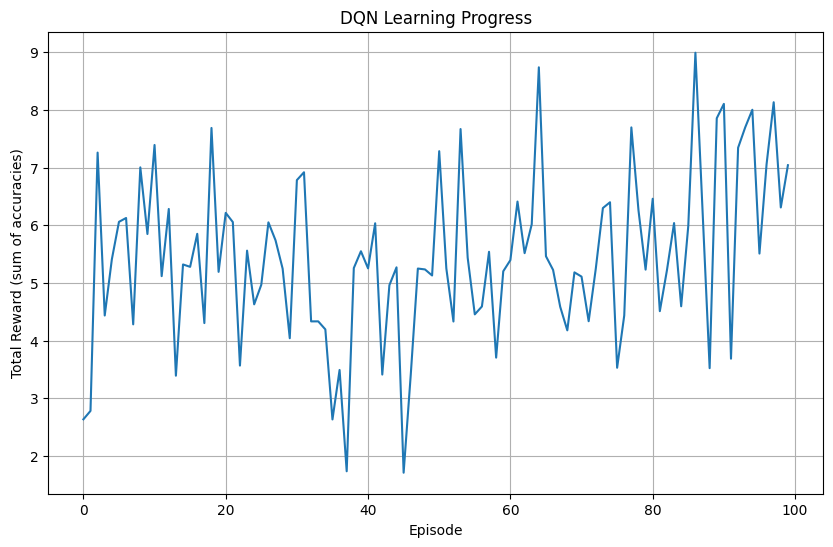

In [ ]:
# Plot learning progress
plt.figure(figsize=(10, 6))
plt.plot(reward_curve)
plt.xlabel("Episode")
plt.ylabel("Total Reward (sum of accuracies)")
plt.title("DQN Learning Progress")
plt.grid(True)
plt.savefig('learning_progress.png')
plt.show()

In [ ]:
results_df['accuracy'].max()

0.9343941683705218

In [ ]:
# Display the best configuration found
best_idx = results_df['accuracy'].idxmax()
best_config = results_df.iloc[best_idx]
print("\n=== BEST CONFIGURATION ===")
print(best_config)


=== BEST CONFIGURATION ===
trial                                                              2
episode                                                           61
scaler                                                  RobustScaler
encoder                                                OneHotEncoder
classifier                                          GradientBoosting
hyperparameters    {'n_estimators': 230, 'learning_rate': 0.3, 'm...
accuracy                                                    0.934394
best_so_far                                                 0.934394
Name: 601, dtype: object


In [ ]:
best_config['hyperparameters']

"{'n_estimators': 230, 'learning_rate': 0.3, 'max_depth': 5, 'random_state': 42}"

----------------------------------------------------------------------
 Classification Metrics: Training Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.98      1.00      0.99     26236
           1       0.99      0.94      0.97      7508

    accuracy                           0.99     33744
   macro avg       0.99      0.97      0.98     33744
weighted avg       0.99      0.99      0.98     33744



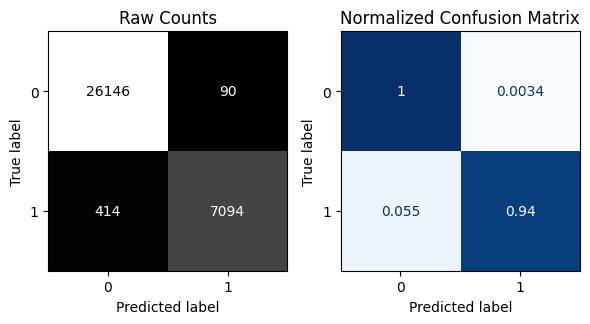


----------------------------------------------------------------------
 Classification Metrics: Test Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.95      0.97      0.96      8757
           1       0.88      0.81      0.85      2492

    accuracy                           0.93     11249
   macro avg       0.92      0.89      0.90     11249
weighted avg       0.93      0.93      0.93     11249



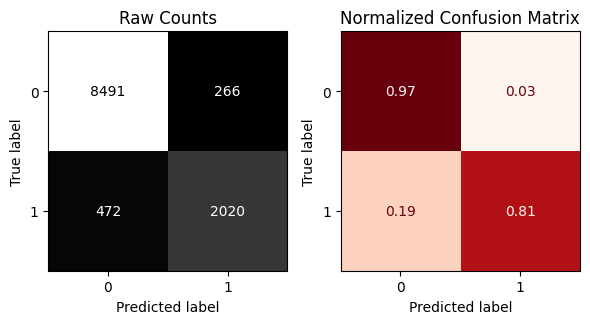

In [ ]:
preprocessor = ColumnTransformer([
    ("scale", RobustScaler(), X_train.select_dtypes(include=np.number).columns),
    ("encode",OneHotEncoder(handle_unknown="ignore", sparse_output=False), X_train.select_dtypes(include=object).columns)
])

gb = GradientBoostingClassifier(n_estimators=230, learning_rate=0.3, max_depth=5, random_state=42)

pipeline = Pipeline([("pre", preprocessor), ("clf", gb)])

# Fit and evaluate
pipeline.fit(X_train, y_train)
evaluate_classification(pipeline, X_train, y_train, X_test, y_test)

In [ ]:
print("Accuracy: ", accuracy_score(y_test, pipeline.predict(X_test)))

Accuracy:  0.9343941683705218


# Chosen Model

* Data = No Feature Enginnering, No Feature Selection
* Preprosses = Pre 2
* Model = XGBoost
* HyperParam =

(learning_rate=0.5, max_depth=10, max_features=0.35000000000000003, min_samples_leaf=3, min_samples_split=8, n_estimators=100 subsample=1.0, random_state=42,  probability=True)
* Threshold = .25
* Score = 93% Accuracy on test

----------------------------------------------------------------------
 Classification Metrics: Training Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     26236
           1       1.00      1.00      1.00      7508

    accuracy                           1.00     33744
   macro avg       1.00      1.00      1.00     33744
weighted avg       1.00      1.00      1.00     33744



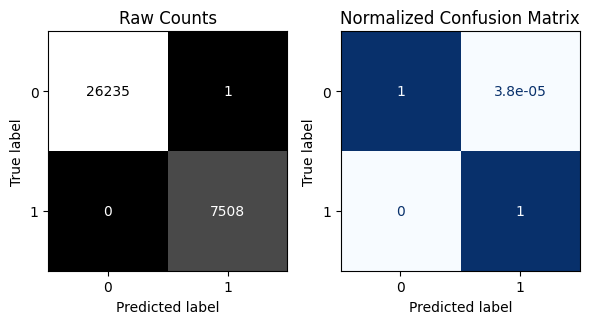


----------------------------------------------------------------------
 Classification Metrics: Test Data
----------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.96      0.94      0.95      8757
           1       0.81      0.87      0.84      2492

    accuracy                           0.93     11249
   macro avg       0.89      0.90      0.89     11249
weighted avg       0.93      0.93      0.93     11249



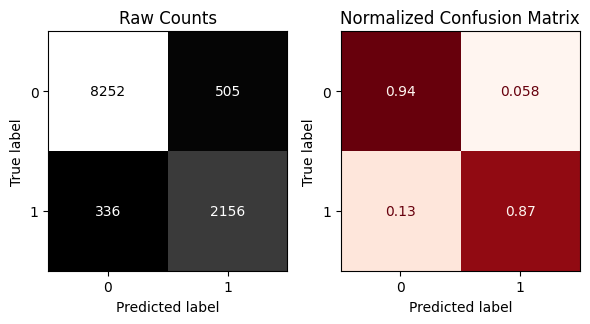

In [ ]:
evaluate_classification(thresholded_model, X_train, y_train, X_test, y_test)

In [ ]:
import joblib
joblib.dump(thresholded_model, 'Xgb_with_threshold_Bank_Loan_Approval_Prediction.pkl')

['Xgb_with_threshold_Bank_Loan_Approval_Prediction.pkl']